In [2]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'

from matplotlib.dates import date2num
import matplotlib.dates as mdates
import matplotlib.patches as mpatches
from datetime import datetime
import xarray as xr
import netCDF4 as nc
import glob
import math
import subprocess
from matplotlib import colormaps
import plotly.graph_objs as go

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import seaborn as sns
import csv
import pandas as pd
from scipy.optimize import curve_fit
from math import prod

import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT
from metpy.units import units
from metpy.calc import dewpoint_from_relative_humidity
#from metpy.io import get_test_data

import sys, os
import requests
import pyart

import warnings
warnings.simplefilter("ignore", RuntimeWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)

#%matplotlib notebook

plt.style.use('default')


#import dask
#from dask.distributed import Client, progress, wait
#dask.config.config.get('distributed').get('dashboard').update({'link':'{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'})
#client = Client()
#client

#dask.config.set(scheduler='threads', num_workers=2)

from dask.distributed import Client
import dask

# Dashboard config for JupyterHub (optional)
dask.config.config.get('distributed').get('dashboard').update({
    'link': '{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'
})

# Start Dask client with controlled resources
client = Client(n_workers=4, threads_per_worker=2, memory_limit='20GB') # This will use 4*2=8 CPU threads
#client



## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [3]:
import numpy as np
import warnings

np.seterr(divide='ignore', invalid='ignore')
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [4]:

file_path='/work/bk1415/b382718/output/mc3e/nested_run/icon_output/continental_ccn/latent_heat/sull_ds'
ds_nosip = xr.open_mfdataset(f'{file_path}/nosip/mc3e_2mom/NWP_*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_4sip = xr.open_mfdataset(f'{file_path}/4sip/mc3e_2mom/NWP_*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_icongrid = xr.open_mfdataset(f'{file_path}/4sip/mc3e_2mom/ICONCONST_icongrid_DOM04_ML_0001.nc', chunks={'time': 4, 'height': 10}, parallel=True)


/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and

In [5]:

grid_mc3e = xr.open_dataset(f'{file_path}/4sip/mc3e_2mom/domain4_DOM04.nc');

clon_deg = np.degrees(grid_mc3e.clon)
clat_deg = np.degrees(grid_mc3e.clat)

print(clon_deg.min().values); print(clon_deg.max().values);
print(clat_deg.min().values); print(clat_deg.max().values);

okla_x, okla_y = np.array([-98., 37.])
#print(okla_x), print(okla_y)
dx_deg = 1.; dy_deg = 1.
left_bound = okla_x - dx_deg
right_bound = okla_x + dx_deg
top_bound = okla_y + dy_deg
bottom_bound = okla_y - dy_deg

print(left_bound), print(right_bound)
print(top_bound), print(bottom_bound)

window_cell = (
    (grid_mc3e.clat >= np.deg2rad(bottom_bound))
    & (grid_mc3e.clat <= np.deg2rad(top_bound))
    & (grid_mc3e.clon >= np.deg2rad(left_bound))
    & (grid_mc3e.clon <= np.deg2rad(right_bound))
).values

(window_cell_indices,) = np.where(window_cell)

# select cells matching with the area of interest (windows_cell_indices:: matching to that with the area sampled by the aircraft)
window_vertex_indices = (np.unique(grid_mc3e.vertex_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_vertex_indices ::',window_vertex_indices)

# select edges matching with the area of interest (corresponding to the windows_cell_indices)
window_edge_indices = (np.unique(grid_mc3e.edge_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_edge_indices ::',window_edge_indices)

selected_indices = xr.Dataset(
    {
        "cell": ("cell", window_cell_indices),
        "vertex": ("vertex", window_vertex_indices),
        "edge": ("edge", window_edge_indices),
    }
)

vars_to_renumber = {
    "cell": [
        "adjacent_cell_of_edge",
        "cells_of_vertex",
        "neighbor_cell_index",
    ],
    "vertex": ["vertex_of_cell", "edge_vertices", "vertices_of_vertex"],
    "edge": ["edge_of_cell", "edges_of_vertex"],
}

def reindex_grid(grid, indices, vars_to_renumber):
    new_grid = grid.load().isel(
        cell=indices.cell, vertex=indices.vertex, edge=indices.edge
    )
    for dim, idx in indices.coords.items():
        renumbering = np.full(grid.dims[dim], -2, dtype="int")
        renumbering[idx] = np.arange(len(idx))
        for name in vars_to_renumber[dim]:
            new_grid[name].data = renumbering[new_grid[name].data - 1] + 1
    return new_grid


new_grid_mc3e = reindex_grid(grid_mc3e, selected_indices, vars_to_renumber)

mask=np.isin(ds_4sip['ncells'], selected_indices.cell)
mask_cells = mask


-99.03552665544457
-94.96409774195314
32.964920475901934
37.03531286609763
-99.0
-97.0
38.0
36.0
window_vertex_indices :: [    3     6    16 ... 27924 27928 27933]
window_edge_indices :: [   12    13    14 ... 79031 79032 79033]


In [6]:

ds_nosip['w_vel'] = -1.*ds_nosip.omega/(9.8*ds_nosip.rho)
ds_nosip['tempc'] = ds_nosip.temp-273.16;
ds_nosip['lwc_gperm3']  = ds_nosip.qc*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tqi'] = ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['tq'] = ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['ciwc_gperm3'] = ds_nosip.qi*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tiwc_gperm3'] = (ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['twc_gperm3'] = (ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['cdnc_percm3'] = ds_nosip.qnc*ds_nosip.rho*1.e-6  # perkg to percm3
ds_nosip['inc_perl'] = (ds_nosip.qni+ds_nosip.qns+ds_nosip.qng+ds_nosip.qnh)*ds_nosip.rho*1.e-3 # perkg to perl
ds_nosip['inp_perl'] = (ds_nosip.d_qni_het)*ds_nosip.rho*1.e-3 # perkg to perl

ds_4sip['w_vel'] = -1.*ds_4sip.omega/(9.8*ds_4sip.rho)
ds_4sip['tempc'] = ds_4sip.temp-273.16;
ds_4sip['lwc_gperm3']  = ds_4sip.qc*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tqi'] = ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['tq'] = ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['ciwc_gperm3'] = ds_4sip.qi*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tiwc_gperm3'] = (ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['twc_gperm3'] = (ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['cdnc_percm3'] = ds_4sip.qnc*ds_4sip.rho*1.e-6  # perkg to percm3
ds_4sip['inc_perl'] = (ds_4sip.qni+ds_4sip.qns+ds_4sip.qng+ds_4sip.qnh)*ds_4sip.rho*1.e-3 # perkg to perl
ds_4sip['inp_perl'] = (ds_4sip.d_qni_het)*ds_4sip.rho*1.e-3 # perkg to perl

#==========================================
# Geometric height at half level (z_ifc)
#==========================================

z_ifc_2d = ds_icongrid['z_ifc']
z_ifc_2d = z_ifc_2d.rename({'height':'height_2'})

time = ds_4sip['time']
z_ifc_3d = z_ifc_2d.expand_dims(time=time)
z_ifc_3d = z_ifc_3d.transpose('time', 'height_2', 'ncells')
ds_4sip = ds_4sip.assign(z_ifc=z_ifc_3d)
ds_nosip = ds_nosip.assign(z_ifc=z_ifc_3d)


In [7]:

aircraft_starttime='2011-05-11T16:30:00.000000000'
aircraft_endtime='2011-05-11T21:00:00.000000000'

#ds_nosip_new = ds_nosip.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))
#ds_4sip_new = ds_4sip.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))
#ds_norf_new = ds_norf.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))
#ds_nohm_new = ds_nohm.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))
#ds_nobr_new = ds_nobr.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))
#ds_nosb_new = ds_nosb.sel(ncells=mask,time=slice(aircraft_starttime, aircraft_endtime))


In [8]:
mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

variables = [mean_tempc_nosip, mean_tempc_4sip]
numpy_variables = [var.values for var in variables]

mean_tempc_nosip = numpy_variables[0]
mean_tempc_4sip = numpy_variables[1]

variables = [mean_ht_nosip, mean_ht_4sip]
numpy_variables = [var.values for var in variables]

mean_ht_nosip = numpy_variables[0]
mean_ht_4sip = numpy_variables[1]

## Wind shear

In [8]:

du_4sip = ds_4sip.u.diff('height')
dv_4sip = ds_4sip.v.diff('height')
dz_4sip = -1*ds_4sip.z_mc.diff('height')

wind_shear_4sip = np.sqrt(du_4sip**2. + dv_4sip**2.)/dz_4sip

du_nosip = ds_nosip.u.diff('height')
dv_nosip = ds_nosip.v.diff('height')
dz_nosip = -1*ds_nosip.z_mc.diff('height')

wind_shear_nosip = np.sqrt(du_nosip**2. + dv_nosip**2.)/dz_nosip



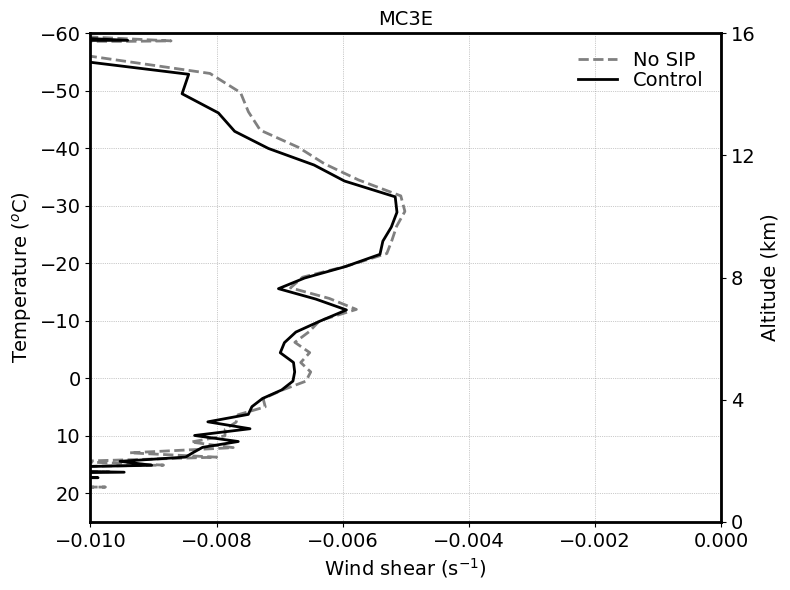

In [9]:

mean_wind_shear_4sip = wind_shear_4sip.mean(dim=('time', 'ncells'))
mean_wind_shear_nosip = wind_shear_nosip.mean(dim=('time', 'ncells'))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_wind_shear_4sip, mean_tempc_4sip[:-1], 'k-', linewidth=lnwdth, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-0.01, 0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Wind shear (s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.tight_layout()
plt.show()


## Freezing and Homogeneous level 

In [29]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

## SIP process rate

In [21]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = 1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel > thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_het_4sip = (ds_4sip.d_qni_het.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')
mean_qni_het_4sip = mean_qni_het_4sip/dt_hours.mean('time')


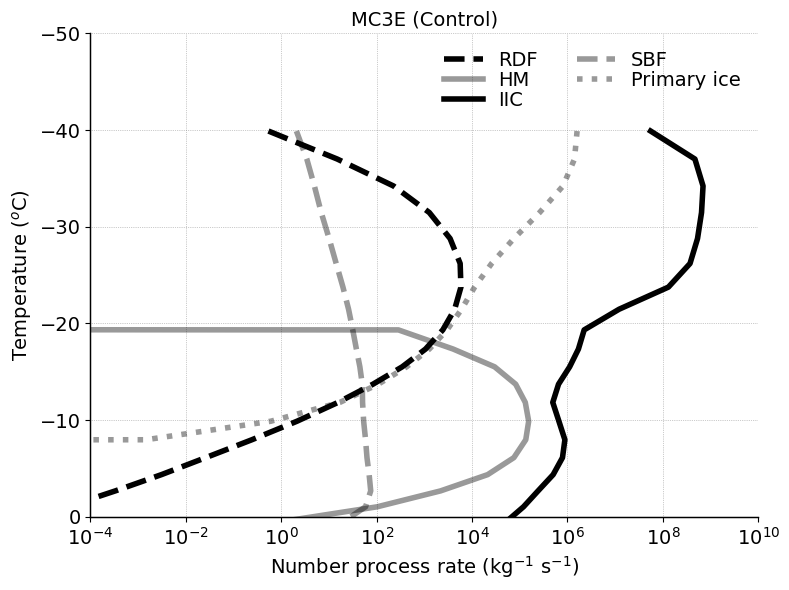

In [25]:

sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

mean_qni_rf_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_hm_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_br_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_sb_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_het_4sip[mean_tempc_4sip_sorted < -40.] = np.nan


fontsize=14;
lnwdth=4;
alpha=0.6;
alp1=1;
alp1=1;
alp2=0.4;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
#plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
#plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
#plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp1, linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp2, linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp1, linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp2, linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_het_4sip*fact, mean_tempc_4sip_sorted, ':', color='k', alpha=alp2, linewidth=lnwdth, label='Primary ice')

#plt2.plot(mean_qni_tot_sec_4sip/dt_hours*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -50)
#plt2.set_ylim(0.5, 14)
plt2.set_yticks([])

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
#plt1.set_yticks([0, -10, -20, -30, -40, -50, -60])
#plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=2, loc='best')

plt.title('MC3E (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Microphysical properties

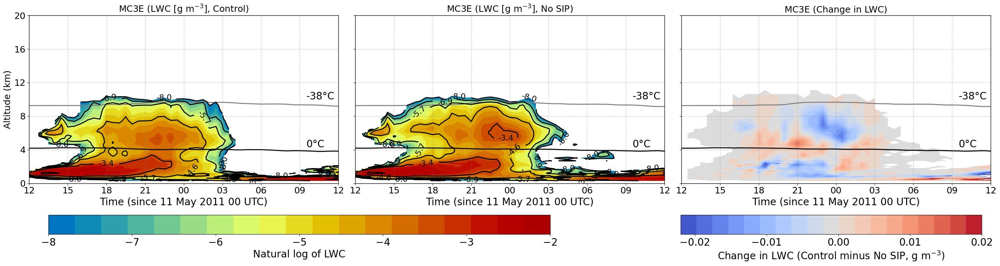

In [30]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.022, 0.02, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.02, -0.01, 0, 0.01, 0.02], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


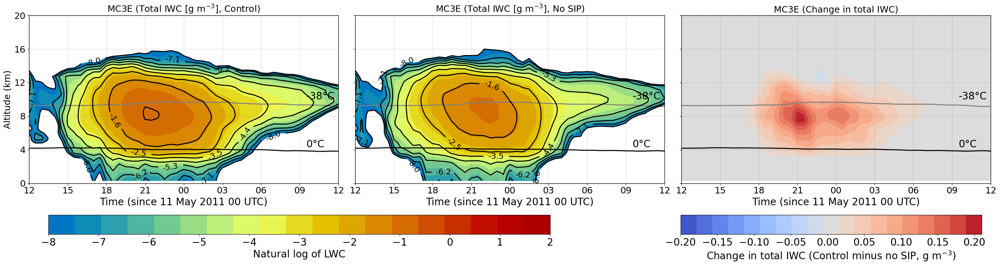

In [32]:

import matplotlib.lines as mlines

sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]


mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip > 0.0001, np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, 2, 20)
#lev1 = np.linspace(0, 0.1, 20)
#lev2 = np.linspace(0.0001, 0.16, 20)
lev2 = np.linspace(-0.2, 0.21, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[0, 0.04, 0.08, 0.12, 0.16], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.2, -0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15, 0.2], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus no SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


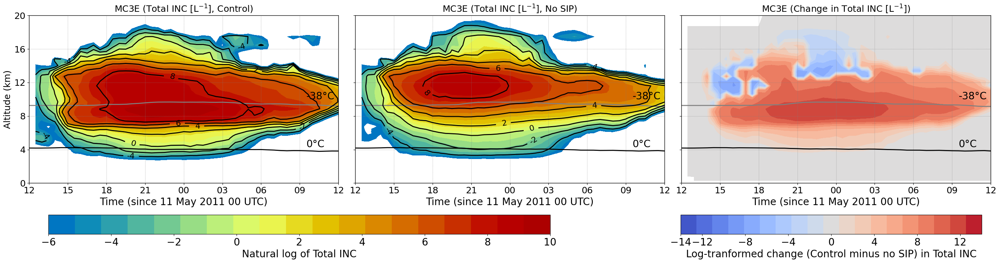

In [33]:

import matplotlib.lines as mlines

def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)


mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-14, 14, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-14, -12, -8, -4, 0, 4, 8, 12, 16], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-tranformed change (Control minus no SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


## Latent heat

In [18]:


r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_4sip = ds_4sip.qv;
cv_m_4sip  = cv_d*(1. + 0.97*q_vap_4sip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
                      )

cond_latent_heat_4sip = (lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) 
dep_latent_heat_4sip  = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep)
rime_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + 
                                            ds_4sip.d_qr_rime_s + ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh)
satad_latent_heat_4sip = (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2)
homhet_latent_heat_4sip = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet)
rain_freez_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf)
evap_latent_heat_4sip = (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap)
melt_latent_heat_4sip = (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_4sip = (1./1800.) * np.gradient(tot_latent_heating_4sip, axis=0) # w.r.t. time
tot_latent_heating_kperd_4sip = tot_latent_heating_kpers_4sip * 86400.
mean_tot_latent_heating_kperd_4sip = np.mean(tot_latent_heating_kperd_4sip, axis=(0,2))
ds_4sip['tot_lhr_kperd'] = (ds_4sip.tempc.dims, tot_latent_heating_kperd_4sip)


## LHR condensation
cond_latent_heat_kpers_4sip = (1./1800.) * np.gradient(cond_latent_heat_4sip, axis=0) # w.r.t. time
cond_latent_heat_kperd_4sip = cond_latent_heat_kpers_4sip * 86400.
mean_cond_latent_heat_kperd_4sip = np.mean(cond_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['cond_lhr_kperd'] = (ds_4sip.tempc.dims, cond_latent_heat_kperd_4sip)

## LHR deposition
dep_latent_heat_kpers_4sip = (1./1800.) * np.gradient(dep_latent_heat_4sip, axis=0) # w.r.t. time
dep_latent_heat_kperd_4sip = dep_latent_heat_kpers_4sip * 86400.
mean_dep_latent_heat_kperd_4sip = np.mean(dep_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['dep_lhr_kperd'] = (ds_4sip.tempc.dims, dep_latent_heat_kperd_4sip)

## LHR riming
rime_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rime_latent_heat_4sip, axis=0) # w.r.t. time
rime_latent_heat_kperd_4sip = rime_latent_heat_kpers_4sip * 86400.
mean_rime_latent_heat_kperd_4sip = np.mean(rime_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rime_lhr_kperd'] = (ds_4sip.tempc.dims, rime_latent_heat_kperd_4sip)

## LHR saturation adjustment
satad_latent_heat_kpers_4sip = (1./1800.) * np.gradient(satad_latent_heat_4sip, axis=0) # w.r.t. time
satad_latent_heat_kperd_4sip = satad_latent_heat_kpers_4sip * 86400.
mean_satad_latent_heat_kperd_4sip = np.mean(satad_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['satad_lhr_kperd'] = (ds_4sip.tempc.dims, satad_latent_heat_kperd_4sip)

## LHR homhet
homhet_latent_heat_kpers_4sip = (1./1800.) * np.gradient(homhet_latent_heat_4sip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_4sip = homhet_latent_heat_kpers_4sip * 86400.
mean_homhet_latent_heat_kperd_4sip = np.mean(homhet_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['homhet_lhr_kperd'] = (ds_4sip.tempc.dims, homhet_latent_heat_kperd_4sip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rain_freez_latent_heat_4sip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_4sip = rain_freez_latent_heat_kpers_4sip * 86400.
mean_rain_freez_latent_heat_kperd_4sip = np.mean(rain_freez_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rainfreez_lhr_kperd'] = (ds_4sip.tempc.dims, rain_freez_latent_heat_kperd_4sip)

## LHR evaporation
evap_latent_heat_kpers_4sip = (1./1800.) * np.gradient(evap_latent_heat_4sip, axis=0) # w.r.t. time
evap_latent_heat_kperd_4sip = evap_latent_heat_kpers_4sip * 86400.
mean_evap_latent_heat_kperd_4sip = np.mean(evap_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['evap_lhr_kperd'] = (ds_4sip.tempc.dims, evap_latent_heat_kperd_4sip)

## LHR melting
melt_latent_heat_kpers_4sip = (1./1800.) * np.gradient(melt_latent_heat_4sip, axis=0) # w.r.t. time
melt_latent_heat_kperd_4sip = melt_latent_heat_kpers_4sip * 86400.
mean_melt_latent_heat_kperd_4sip = np.mean(melt_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['melt_lhr_kperd'] = (ds_4sip.tempc.dims, melt_latent_heat_kperd_4sip)


In [19]:
r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_nosip = ds_nosip.qv;
cv_m_nosip  = cv_d*(1. + 0.97*q_vap_nosip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_nosip = ((lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep) + # deposition
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s + ds_nosip.d_qr_rime_s +
                                     ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet) +
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)      # melting
                      )

cond_latent_heat_nosip = (lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc)
dep_latent_heat_nosip  = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep)
rime_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s +
                                            ds_nosip.d_qr_rime_s + ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh)
satad_latent_heat_nosip = (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2)
homhet_latent_heat_nosip = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet)
rain_freez_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf)
evap_latent_heat_nosip = (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap)
melt_latent_heat_nosip = (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_nosip = (1./1800.) * np.gradient(tot_latent_heating_nosip, axis=0) # w.r.t. time
tot_latent_heating_kperd_nosip = tot_latent_heating_kpers_nosip * 86400.
mean_tot_latent_heating_kperd_nosip = np.mean(tot_latent_heating_kperd_nosip, axis=(0,2))
ds_nosip['tot_lhr_kperd'] = (ds_nosip.tempc.dims, tot_latent_heating_kperd_nosip)


## LHR condensation
cond_latent_heat_kpers_nosip = (1./1800.) * np.gradient(cond_latent_heat_nosip, axis=0) # w.r.t. time
cond_latent_heat_kperd_nosip = cond_latent_heat_kpers_nosip * 86400.
mean_cond_latent_heat_kperd_nosip = np.mean(cond_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['cond_lhr_kperd'] = (ds_nosip.tempc.dims, cond_latent_heat_kperd_nosip)

## LHR deposition
dep_latent_heat_kpers_nosip = (1./1800.) * np.gradient(dep_latent_heat_nosip, axis=0) # w.r.t. time
dep_latent_heat_kperd_nosip = dep_latent_heat_kpers_nosip * 86400.
mean_dep_latent_heat_kperd_nosip = np.mean(dep_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['dep_lhr_kperd'] = (ds_nosip.tempc.dims, dep_latent_heat_kperd_nosip)

## LHR riming
rime_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rime_latent_heat_nosip, axis=0) # w.r.t. time
rime_latent_heat_kperd_nosip = rime_latent_heat_kpers_nosip * 86400.
mean_rime_latent_heat_kperd_nosip = np.mean(rime_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rime_lhr_kperd'] = (ds_nosip.tempc.dims, rime_latent_heat_kperd_nosip)

## LHR saturation adjustment
satad_latent_heat_kpers_nosip = (1./1800.) * np.gradient(satad_latent_heat_nosip, axis=0) # w.r.t. time
satad_latent_heat_kperd_nosip = satad_latent_heat_kpers_nosip * 86400.
mean_satad_latent_heat_kperd_nosip = np.mean(satad_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['satad_lhr_kperd'] = (ds_nosip.tempc.dims, satad_latent_heat_kperd_nosip)

## LHR homhet
homhet_latent_heat_kpers_nosip = (1./1800.) * np.gradient(homhet_latent_heat_nosip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_nosip = homhet_latent_heat_kpers_nosip * 86400.
mean_homhet_latent_heat_kperd_nosip = np.mean(homhet_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['homhet_lhr_kperd'] = (ds_nosip.tempc.dims, homhet_latent_heat_kperd_nosip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rain_freez_latent_heat_nosip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_nosip = rain_freez_latent_heat_kpers_nosip * 86400.
mean_rain_freez_latent_heat_kperd_nosip = np.mean(rain_freez_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rainfreez_lhr_kperd'] = (ds_nosip.tempc.dims, rain_freez_latent_heat_kperd_nosip)

## LHR evaporation
evap_latent_heat_kpers_nosip = (1./1800.) * np.gradient(evap_latent_heat_nosip, axis=0) # w.r.t. time
evap_latent_heat_kperd_nosip = evap_latent_heat_kpers_nosip * 86400.
mean_evap_latent_heat_kperd_nosip = np.mean(evap_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['evap_lhr_kperd'] = (ds_nosip.tempc.dims, evap_latent_heat_kperd_nosip)

## LHR melting
melt_latent_heat_kpers_nosip = (1./1800.) * np.gradient(melt_latent_heat_nosip, axis=0) # w.r.t. time
melt_latent_heat_kperd_nosip = melt_latent_heat_kpers_nosip * 86400.
mean_melt_latent_heat_kperd_nosip = np.mean(melt_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['melt_lhr_kperd'] = (ds_nosip.tempc.dims, melt_latent_heat_kperd_nosip)


In [34]:



#==================================================================================================
mean_tot_lhr_kperd_4sip = ds_4sip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_4sip = (ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                 ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values)

mean_tot_lhr_kperd_nosip = ds_nosip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_nosip = (ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                  ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values)
#==================================================================================================

del_lhr_kperd_nosip = mean_tot_lhr_kperd_4sip-mean_tot_lhr_kperd_nosip

per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_tot_lhr_kperd_4sip


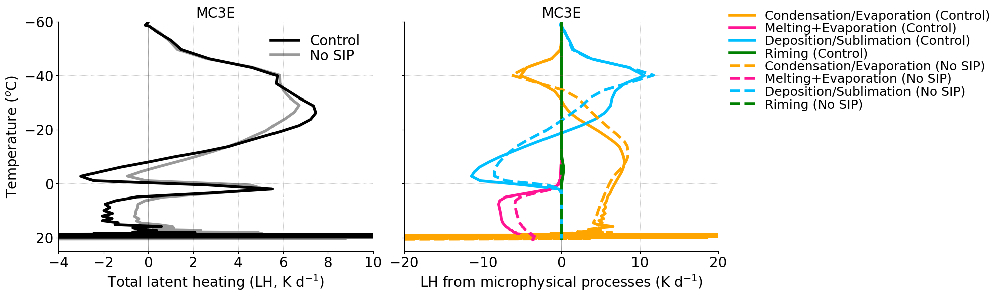

In [35]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20., 20)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-16, -14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1., 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


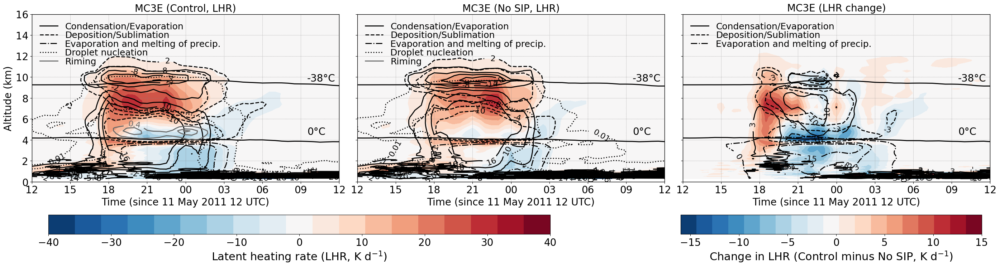

In [37]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.tot_lhr_kperd.mean(dim=('ncells'))-ds_nosip.tot_lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=2.0;
alp1=0.3;

lev1 = np.linspace(-40, 40, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-16, 15, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)#grey

plt.text(ds_4sip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('MC3E (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contour_levels = np.arange(-20, 20.5, 6)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')

#contour_levels = np.arange(-10, 20.5, 10)
#contour_levels = np.arange(-10, 20.5, 8)
contour_levels = np.arange(-10, 10.5, 6)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.linspace(-2.5, 2.5, 8) #np.arange(-3.5, 3.5, 1.)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contour_levels = np.arange(-20, 20.5, 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')

#contour_levels = np.arange(-10, 20.5, 10)
#contour_levels = np.arange(-10, 20.5, 8)
contour_levels = np.arange(-10, 10.5, 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.linspace(-2.5, 2.5, 8) #np.arange(-3.5, 3.5, 1)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.02, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-40, -30, -20, -10, 0, 10, 20, 30, 40])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-10.5, 10.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.linspace(-10.5, 10.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 3) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-30, -20, -10, 0, 10, 20, 30])
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-15, -10, -5, 0, 5, 10, 15])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


## Cloud radiative heating rates (CRH)

In [8]:
#============ CRH calculation

#Source: https://github.com/aikovoigt/nawdex-hackathon/blob/master/postprocessing/calc_heatingrates.py

def calc_heatingrates(ds):
    # expected input: xarray dataset that besides the radiative fluxes contains height at interface levels, air density and specific humidity
    # specific heat at constant volume for dry air and water vapor
    pcd = 1004.64 - 287.04
    pcv = 1869.46 - 461.51

    
    #z_ifc = 
    # geometric thickness of full levels, label='lower' for xr.diff is important for correct result
    dz_full = -1*ds['z_mc'].diff(dim='height', n=1, label='lower').rename('dz_full')#.rename({'height_ifc': 'height'})
    #dz_full = -1*ds['z_ifc'].diff(dim='height_ifc', n=1, label='upper').rename('dz_full').rename({'height_2': 'height'})
    # mass of air
    pmair = ds['rho'] * dz_full
    # conversion factor for flux divergence to heating rate
    zconv = 1.0/(pmair*(pcd+(pcv-pcd)*ds['qv']))
    # calculate radiative heating rates from radiative fluxes, use "\_fromflux" to indicate that these were from fluxes
    ds['ddt_temp_radsw_fromflux'] = ( 
        -1*ds['swflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlw_fromflux'] = ( 
        -1*ds['lwflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radswclr_fromflux'] = ( 
        -1*ds['swflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlwclr_fromflux'] = ( 
        -1*ds['lwflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )

    # Total radiative temperature tendency (clr+cld)
    ds['ddt_temp_radtot_fromflux'] = (ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux'])

    # Clear-sky radiative temperature tendency (clr)
    ds['ddt_temp_radtot_clr_fromflux'] = (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux'])

    # Net Cloud-radiative heating
    ds['total_crh'] = ((ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux']) -
                       (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux']))

    # SW Cloud-radiative heating
    ds['crh_sw'] = ds['ddt_temp_radsw_fromflux'] - ds['ddt_temp_radswclr_fromflux']
    # Net Cloud-radiative heating
    ds['crh_lw'] = ds['ddt_temp_radlw_fromflux'] - ds['ddt_temp_radlwclr_fromflux']
    
    return ds


In [9]:
# Net radiative flux (Net flux) = downward − upward
# Total radiative tendency = SW + LW

#toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)

ds_4sip['swflxall'] = ds_4sip.swflx_dn - ds_4sip.swflx_up
ds_4sip['swflxclr'] = ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr
ds_4sip['lwflxall'] = ds_4sip.lwflx_dn - ds_4sip.lwflx_up
ds_4sip['lwflxclr'] = ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr

ds_4sip['tot_rad_ddt_temp'] = ds_4sip.ddt_temp_radlw + ds_4sip.ddt_temp_radsw

ds_nosip['swflxall'] = ds_nosip.swflx_dn - ds_nosip.swflx_up
ds_nosip['swflxclr'] = ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr
ds_nosip['lwflxall'] = ds_nosip.lwflx_dn - ds_nosip.lwflx_up
ds_nosip['lwflxclr'] = ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr


ds_nosip['tot_rad_ddt_temp'] = ds_nosip.ddt_temp_radlw + ds_nosip.ddt_temp_radsw

ds_4sip = calc_heatingrates(ds_4sip)
ds_nosip = calc_heatingrates(ds_nosip)



In [10]:

mean_tot_crh_kperd_4sip = 86400*ds_4sip.total_crh.mean(dim=('time','ncells')).values # K/s to K/d
mean_tot_crh_kperd_nosip = 86400*ds_nosip.total_crh.mean(dim=('time','ncells')).values

mean_sw_crh_kperd_4sip = 86400*ds_4sip.crh_sw.mean(dim=('time','ncells')).values # K/s to K/d
mean_sw_crh_kperd_nosip = 86400*ds_nosip.crh_sw.mean(dim=('time','ncells')).values

mean_lw_crh_kperd_4sip = 86400*ds_4sip.crh_lw.mean(dim=('time','ncells')).values # K/s to K/d
mean_lw_crh_kperd_nosip = 86400*ds_nosip.crh_lw.mean(dim=('time','ncells')).values

std_tot_crh_kperd_4sip = 86400 * ds_4sip.total_crh.std(dim=('time', 'ncells')).values
std_tot_crh_kperd_nosip = 86400 * ds_nosip.total_crh.std(dim=('time', 'ncells')).values

n_count = ds_4sip.sizes['time'] * ds_4sip.sizes['ncells'] 
se_tot_crh_kperd_4sip = 86400 * (std_tot_crh_kperd_4sip / np.sqrt(n_count))#.values
se_tot_crh_kperd_nosip = 86400 * (std_tot_crh_kperd_nosip / np.sqrt(n_count))#.values


/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/numpy_compat.py:56: RuntimeWarning: invalid value encountered in divide
  x = np.divide(x1, x2, out)


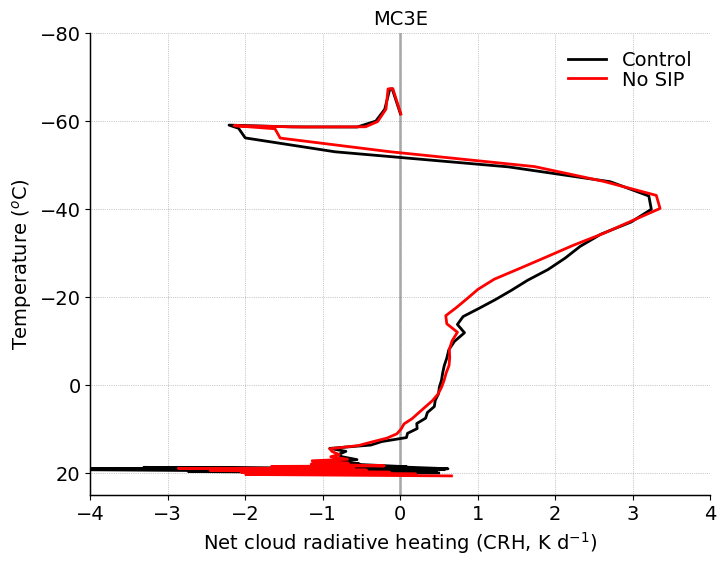

In [13]:
from scipy.ndimage import uniform_filter1d

mean_tot_crh_kperd_4sip_smoothed = uniform_filter1d(mean_tot_crh_kperd_4sip, size=3)
mean_tot_crh_kperd_nosip_smoothed = uniform_filter1d(mean_tot_crh_kperd_nosip, size=3)

sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]

fnt=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

#plt1.errorbar(mean_tot_crh_kperd_4sip, mean_tempc_4sip, yerr=std_tot_crh_kperd_4sip)

#plt1.fill_betweenx(mean_tempc_4sip, (mean_tot_crh_kperd_4sip-std_tot_crh_kperd_4sip),(mean_tot_crh_kperd_4sip+std_tot_crh_kperd_4sip), color='k', alpha=0.2)
#plt1.fill_betweenx(mean_tempc_nosip, (mean_tempc_nosip-std_tot_crh_kperd_nosip), (mean_tempc_nosip+std_tot_crh_kperd_nosip), color='r', alpha=0.2)#, label='ICON $\pm$ 1 STD DEV')
                 
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt2.plot(mean_tot_crh_kperd_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 4)
plt1.set_ylim(25, -80)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-1, -0.5, 0, 0.5, 1])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

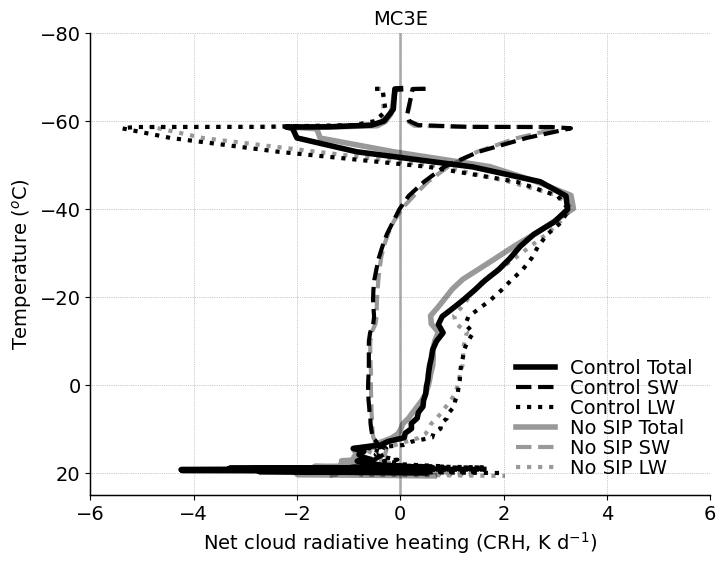

In [13]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

#plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control Total')
plt1.plot(mean_sw_crh_kperd_4sip, mean_tempc_4sip_sorted, '--', color='k', linewidth=lnwdth-1, label='Control SW ')
plt1.plot(mean_lw_crh_kperd_4sip, mean_tempc_4sip_sorted, ':', color='k', linewidth=lnwdth-1, label='Control LW')
plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'k-', linewidth=lnwdth, alpha=0.4, label='No SIP Total')
plt1.plot(mean_sw_crh_kperd_nosip, mean_tempc_nosip_sorted, '--', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP SW')
plt1.plot(mean_lw_crh_kperd_nosip, mean_tempc_nosip_sorted, ':', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP LW')

#plt1.errorbar(mean_tot_crh_kperd_4sip, mean_tempc_4sip, yerr=std_tot_crh_kperd_4sip)

#plt1.fill_betweenx(mean_tempc_4sip, (mean_tot_crh_kperd_4sip-std_tot_crh_kperd_4sip),(mean_tot_crh_kperd_4sip+std_tot_crh_kperd_4sip), color='k', alpha=0.2)
#plt1.fill_betweenx(mean_tempc_nosip, (mean_tempc_nosip-std_tot_crh_kperd_nosip), (mean_tempc_nosip+std_tot_crh_kperd_nosip), color='r', alpha=0.2)#, label='ICON $\pm$ 1 STD DEV')
                 
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_crh_kperd_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-6, 6)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

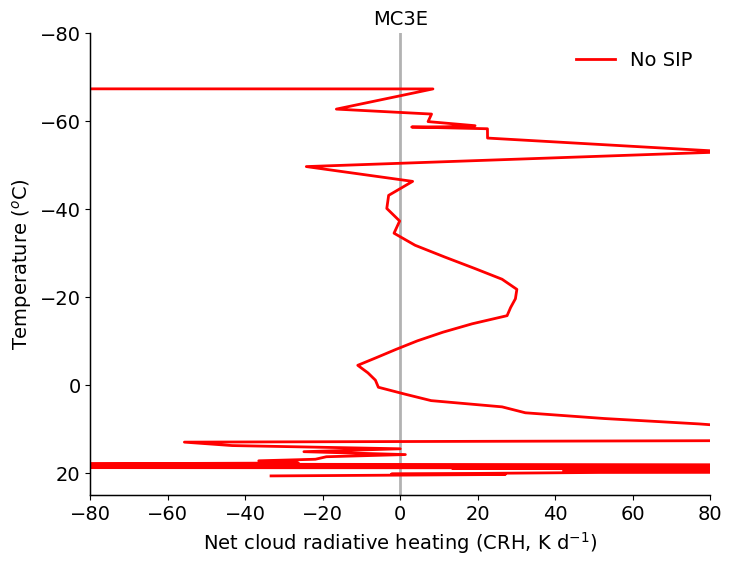

In [15]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')
plt1.plot(100*(mean_tot_crh_kperd_4sip-mean_tot_crh_kperd_nosip)/mean_tot_crh_kperd_4sip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')


plt1.set_xlim(-80, 80)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

## Vertical velocity

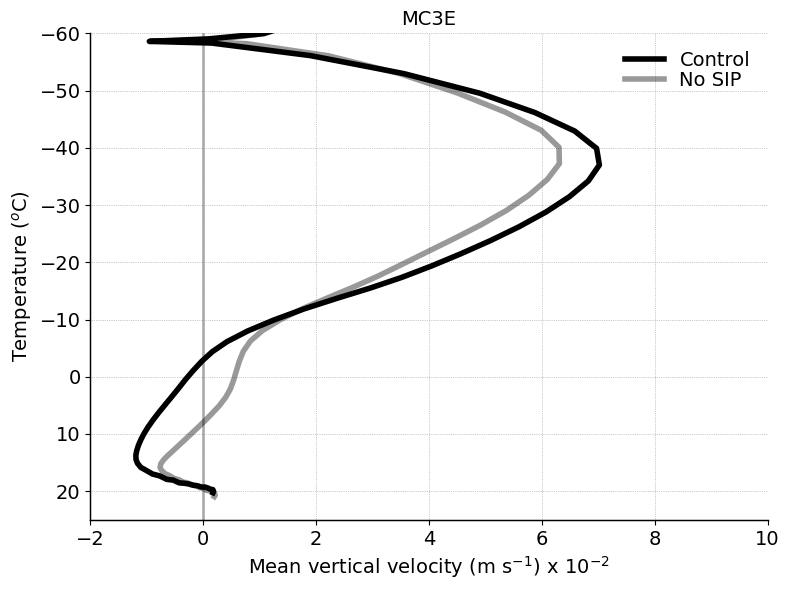

In [39]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]


stime='2011-05-11T15:00:00.000000000'
etime='2011-05-12T00:00:00.000000000'

filt_wvel_4sip = ds_4sip.w_vel.sel(time=slice(stime, etime))
filt_wvel_nosip = ds_nosip.w_vel.sel(time=slice(stime, etime))

fontsize=14;
lnwdth=4;
alpha=0.8;
alp1=1;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*filt_wvel_4sip.mean(dim=('time','ncells')), mean_tempc_4sip_sorted, 'k-', alpha=alp1, linewidth=lnwdth, label='Control')
plt1.plot(fac*filt_wvel_nosip.mean(dim=('time','ncells')), mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-2., 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)
plt2.set_yticks([])

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
#plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Freezing level and cloud top height

In [10]:

## Freezing and cloud top height
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.twc_gperm3 > 1.e-3)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.twc_gperm3 > 1.e-3)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


## Melting level thickness
ds_4sip['tot_q'] = ds_4sip.tq+ds_4sip.qr
mask = (ds_4sip.tempc > -1) & (ds_4sip.tempc < 1.)  & (ds_4sip.twc_gperm3 > 1.e-6) 
mean_melt_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')


/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/reductions.py:654: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/reductions.py:654: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


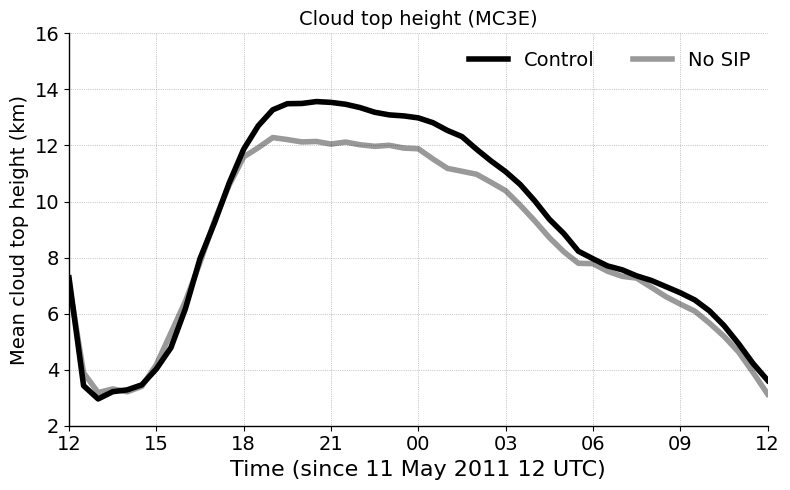

In [11]:

fnt=14;
ln=4;

alp1=1.0;
alp2=0.4;

plt.figure(figsize=(8, 5))
plt.style.use('default')

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', alpha=alp1, linewidth=ln, label='Control')
plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'k-', alpha=alp2, linewidth=ln, label='No SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(2,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (MC3E)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

# Latent heating rate

In [18]:
mean_ht_nosip

array([20.700924 , 18.707628 , 17.459843 , 16.43749  , 15.550726 ,
       14.755354 , 14.032688 , 13.368496 , 12.752986 , 12.179039 ,
       11.641294 , 11.135569 , 10.658536 , 10.207486 ,  9.78018  ,
        9.374736 ,  8.989555 ,  8.623256 ,  8.274639 ,  7.9426465,
        7.6263456,  7.3248935,  7.037529 ,  6.7635603,  6.5023513,
        6.253312 ,  6.015893 ,  5.7895784,  5.5738816,  5.368342 ,
        5.172518 ,  4.9859886,  4.8083487,  4.6392097,  4.4781947,
        4.3249397,  4.1790915,  4.0403085,  3.9082582,  3.782616 ,
        3.6630702,  3.549318 ,  3.4410663,  3.3380342,  3.2399511,
        3.1465588,  3.057612 ,  2.972878 ,  2.8921373,  2.8151875,
        2.741839 ,  2.6719227,  2.6052866,  2.5417995,  2.481353 ,
        2.4238665,  2.3692915,  2.3176157,  2.268876 ,  2.2231715,
        2.1806922,  2.1417646,  2.1069922,  2.0790482,  2.0573509],
      dtype=float32)

In [8]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)

del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip


In [39]:
ds_4sip.lhr_kperd.mean('ncells').max().values

array(390.41284, dtype=float32)

In [ ]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_lhr_kperd_nosip, mean_lhr_kperd_4sip, mean_lhr_kperd_norf, mean_lhr_kperd_nohm, 
             mean_lhr_kperd_nobr, mean_lhr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lhr_kperd_nosip = numpy_variables[0]
mean_lhr_kperd_4sip = numpy_variables[1]
mean_lhr_kperd_norf = numpy_variables[2]
mean_lhr_kperd_nohm = numpy_variables[3]
mean_lhr_kperd_nobr = numpy_variables[4]
mean_lhr_kperd_nosb = numpy_variables[5]


In [9]:



#mean_lhr_kperd_nosip[mean_tempc_nosip < -60] = np.nan
#mean_lhr_kperd_4sip[mean_tempc_4sip < -60] = np.nan
#mean_lhr_kperd_norf[mean_tempc_norf < -60] = np.nan
#mean_lhr_kperd_nohm[mean_tempc_nohm < -60] = np.nan
#mean_lhr_kperd_nobr[mean_tempc_nobr < -60] = np.nan
#mean_lhr_kperd_nosb[mean_tempc_nosb < -60] = np.nan

del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip

per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_lhr_kperd_4sip


#per_del_lhr_kperd_nosip[(mean_tempc_nosip < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan
#per_del_lhr_kperd_norf[(mean_tempc_norf < -50) & (np.abs(per_del_lhr_kperd_norf) > 50)] = np.nan
#per_del_lhr_kperd_nohm[(mean_tempc_nohm < -50) & (np.abs(per_del_lhr_kperd_nohm) > 50)] = np.nan
#per_del_lhr_kperd_nobr[(mean_tempc_nobr < -50) & (np.abs(per_del_lhr_kperd_nobr) > 50)] = np.nan
#per_del_lhr_kperd_nosip[(mean_tempc_nosb < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan


In [7]:


r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_4sip = ds_4sip.qv;
cv_m_4sip  = cv_d*(1. + 0.97*q_vap_4sip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
                      )

cond_latent_heat_4sip = (lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) 
dep_latent_heat_4sip  = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep)
rime_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + 
                                            ds_4sip.d_qr_rime_s + ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh)
satad_latent_heat_4sip = (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2)
homhet_latent_heat_4sip = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet)
rain_freez_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf)
evap_latent_heat_4sip = (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap)
melt_latent_heat_4sip = (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_4sip = (1./1800.) * np.gradient(tot_latent_heating_4sip, axis=0) # w.r.t. time
tot_latent_heating_kperd_4sip = tot_latent_heating_kpers_4sip * 86400.
mean_tot_latent_heating_kperd_4sip = np.mean(tot_latent_heating_kperd_4sip, axis=(0,2))
ds_4sip['tot_lhr_kperd'] = (ds_4sip.tempc.dims, tot_latent_heating_kperd_4sip)


## LHR condensation
cond_latent_heat_kpers_4sip = (1./1800.) * np.gradient(cond_latent_heat_4sip, axis=0) # w.r.t. time
cond_latent_heat_kperd_4sip = cond_latent_heat_kpers_4sip * 86400.
mean_cond_latent_heat_kperd_4sip = np.mean(cond_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['cond_lhr_kperd'] = (ds_4sip.tempc.dims, cond_latent_heat_kperd_4sip)

## LHR deposition
dep_latent_heat_kpers_4sip = (1./1800.) * np.gradient(dep_latent_heat_4sip, axis=0) # w.r.t. time
dep_latent_heat_kperd_4sip = dep_latent_heat_kpers_4sip * 86400.
mean_dep_latent_heat_kperd_4sip = np.mean(dep_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['dep_lhr_kperd'] = (ds_4sip.tempc.dims, dep_latent_heat_kperd_4sip)

## LHR riming
rime_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rime_latent_heat_4sip, axis=0) # w.r.t. time
rime_latent_heat_kperd_4sip = rime_latent_heat_kpers_4sip * 86400.
mean_rime_latent_heat_kperd_4sip = np.mean(rime_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rime_lhr_kperd'] = (ds_4sip.tempc.dims, rime_latent_heat_kperd_4sip)

## LHR saturation adjustment
satad_latent_heat_kpers_4sip = (1./1800.) * np.gradient(satad_latent_heat_4sip, axis=0) # w.r.t. time
satad_latent_heat_kperd_4sip = satad_latent_heat_kpers_4sip * 86400.
mean_satad_latent_heat_kperd_4sip = np.mean(satad_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['satad_lhr_kperd'] = (ds_4sip.tempc.dims, satad_latent_heat_kperd_4sip)

## LHR homhet
homhet_latent_heat_kpers_4sip = (1./1800.) * np.gradient(homhet_latent_heat_4sip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_4sip = homhet_latent_heat_kpers_4sip * 86400.
mean_homhet_latent_heat_kperd_4sip = np.mean(homhet_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['homhet_lhr_kperd'] = (ds_4sip.tempc.dims, homhet_latent_heat_kperd_4sip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rain_freez_latent_heat_4sip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_4sip = rain_freez_latent_heat_kpers_4sip * 86400.
mean_rain_freez_latent_heat_kperd_4sip = np.mean(rain_freez_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rainfreez_lhr_kperd'] = (ds_4sip.tempc.dims, rain_freez_latent_heat_kperd_4sip)

## LHR evaporation
evap_latent_heat_kpers_4sip = (1./1800.) * np.gradient(evap_latent_heat_4sip, axis=0) # w.r.t. time
evap_latent_heat_kperd_4sip = evap_latent_heat_kpers_4sip * 86400.
mean_evap_latent_heat_kperd_4sip = np.mean(evap_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['evap_lhr_kperd'] = (ds_4sip.tempc.dims, evap_latent_heat_kperd_4sip)

## LHR melting
melt_latent_heat_kpers_4sip = (1./1800.) * np.gradient(melt_latent_heat_4sip, axis=0) # w.r.t. time
melt_latent_heat_kperd_4sip = melt_latent_heat_kpers_4sip * 86400.
mean_melt_latent_heat_kperd_4sip = np.mean(melt_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['melt_lhr_kperd'] = (ds_4sip.tempc.dims, melt_latent_heat_kperd_4sip)


In [8]:
r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_nosip = ds_nosip.qv;
cv_m_nosip  = cv_d*(1. + 0.97*q_vap_nosip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_nosip = ((lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep) + # deposition
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s + ds_nosip.d_qr_rime_s +
                                     ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet) +
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)      # melting
                      )

cond_latent_heat_nosip = (lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc)
dep_latent_heat_nosip  = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep)
rime_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s +
                                            ds_nosip.d_qr_rime_s + ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh)
satad_latent_heat_nosip = (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2)
homhet_latent_heat_nosip = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet)
rain_freez_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf)
evap_latent_heat_nosip = (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap)
melt_latent_heat_nosip = (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_nosip = (1./1800.) * np.gradient(tot_latent_heating_nosip, axis=0) # w.r.t. time
tot_latent_heating_kperd_nosip = tot_latent_heating_kpers_nosip * 86400.
mean_tot_latent_heating_kperd_nosip = np.mean(tot_latent_heating_kperd_nosip, axis=(0,2))
ds_nosip['tot_lhr_kperd'] = (ds_nosip.tempc.dims, tot_latent_heating_kperd_nosip)


## LHR condensation
cond_latent_heat_kpers_nosip = (1./1800.) * np.gradient(cond_latent_heat_nosip, axis=0) # w.r.t. time
cond_latent_heat_kperd_nosip = cond_latent_heat_kpers_nosip * 86400.
mean_cond_latent_heat_kperd_nosip = np.mean(cond_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['cond_lhr_kperd'] = (ds_nosip.tempc.dims, cond_latent_heat_kperd_nosip)

## LHR deposition
dep_latent_heat_kpers_nosip = (1./1800.) * np.gradient(dep_latent_heat_nosip, axis=0) # w.r.t. time
dep_latent_heat_kperd_nosip = dep_latent_heat_kpers_nosip * 86400.
mean_dep_latent_heat_kperd_nosip = np.mean(dep_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['dep_lhr_kperd'] = (ds_nosip.tempc.dims, dep_latent_heat_kperd_nosip)

## LHR riming
rime_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rime_latent_heat_nosip, axis=0) # w.r.t. time
rime_latent_heat_kperd_nosip = rime_latent_heat_kpers_nosip * 86400.
mean_rime_latent_heat_kperd_nosip = np.mean(rime_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rime_lhr_kperd'] = (ds_nosip.tempc.dims, rime_latent_heat_kperd_nosip)

## LHR saturation adjustment
satad_latent_heat_kpers_nosip = (1./1800.) * np.gradient(satad_latent_heat_nosip, axis=0) # w.r.t. time
satad_latent_heat_kperd_nosip = satad_latent_heat_kpers_nosip * 86400.
mean_satad_latent_heat_kperd_nosip = np.mean(satad_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['satad_lhr_kperd'] = (ds_nosip.tempc.dims, satad_latent_heat_kperd_nosip)

## LHR homhet
homhet_latent_heat_kpers_nosip = (1./1800.) * np.gradient(homhet_latent_heat_nosip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_nosip = homhet_latent_heat_kpers_nosip * 86400.
mean_homhet_latent_heat_kperd_nosip = np.mean(homhet_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['homhet_lhr_kperd'] = (ds_nosip.tempc.dims, homhet_latent_heat_kperd_nosip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rain_freez_latent_heat_nosip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_nosip = rain_freez_latent_heat_kpers_nosip * 86400.
mean_rain_freez_latent_heat_kperd_nosip = np.mean(rain_freez_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rainfreez_lhr_kperd'] = (ds_nosip.tempc.dims, rain_freez_latent_heat_kperd_nosip)

## LHR evaporation
evap_latent_heat_kpers_nosip = (1./1800.) * np.gradient(evap_latent_heat_nosip, axis=0) # w.r.t. time
evap_latent_heat_kperd_nosip = evap_latent_heat_kpers_nosip * 86400.
mean_evap_latent_heat_kperd_nosip = np.mean(evap_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['evap_lhr_kperd'] = (ds_nosip.tempc.dims, evap_latent_heat_kperd_nosip)

## LHR melting
melt_latent_heat_kpers_nosip = (1./1800.) * np.gradient(melt_latent_heat_nosip, axis=0) # w.r.t. time
melt_latent_heat_kperd_nosip = melt_latent_heat_kpers_nosip * 86400.
mean_melt_latent_heat_kperd_nosip = np.mean(melt_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['melt_lhr_kperd'] = (ds_nosip.tempc.dims, melt_latent_heat_kperd_nosip)


In [9]:



#==================================================================================================
mean_tot_lhr_kperd_4sip = ds_4sip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_4sip = (ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                 ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values)

mean_tot_lhr_kperd_nosip = ds_nosip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_nosip = (ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                  ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values)
#==================================================================================================

del_lhr_kperd_nosip = mean_tot_lhr_kperd_4sip-mean_tot_lhr_kperd_nosip

per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_tot_lhr_kperd_4sip


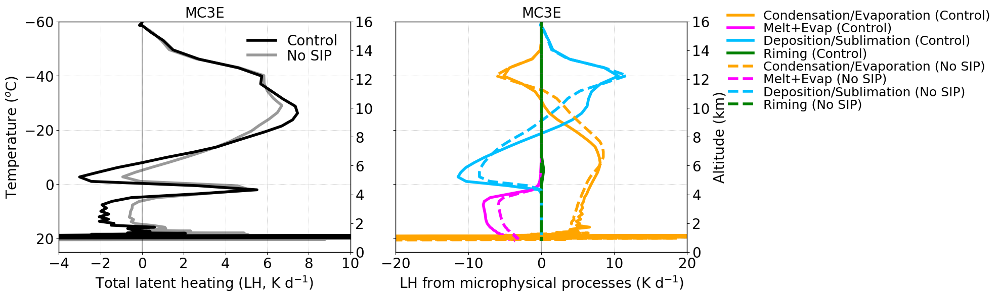

In [33]:



fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip, '-', color='magenta', linewidth=lnwdth, label='Melt+Evap (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip, '--', color='magenta', linewidth=lnwdth, label='Melt+Evap (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20., 20)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-16, -14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1.1, 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [1]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4, 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20., 20)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-16, -14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1., 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


NameError: name 'np' is not defined

In [11]:
np.linspace(2,2,2)

array([2., 2.])

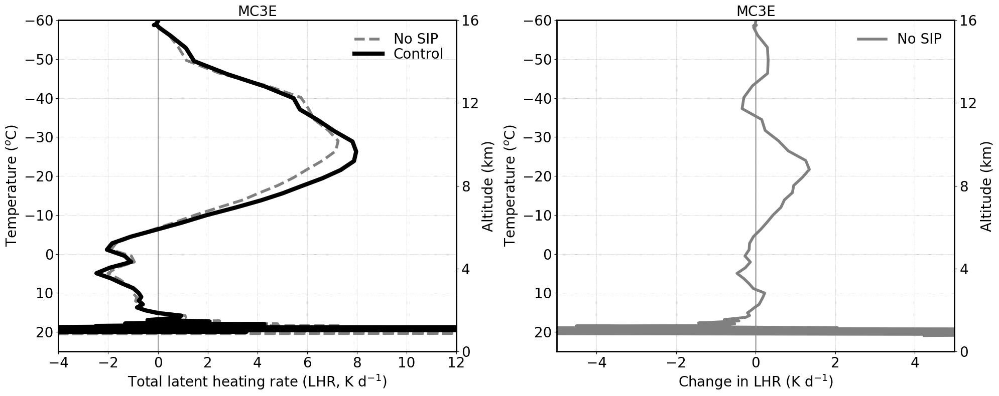

In [12]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 12)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')

plt2.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-5., 5)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-1, -0.5, 0, 0.5, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Change in LHR (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


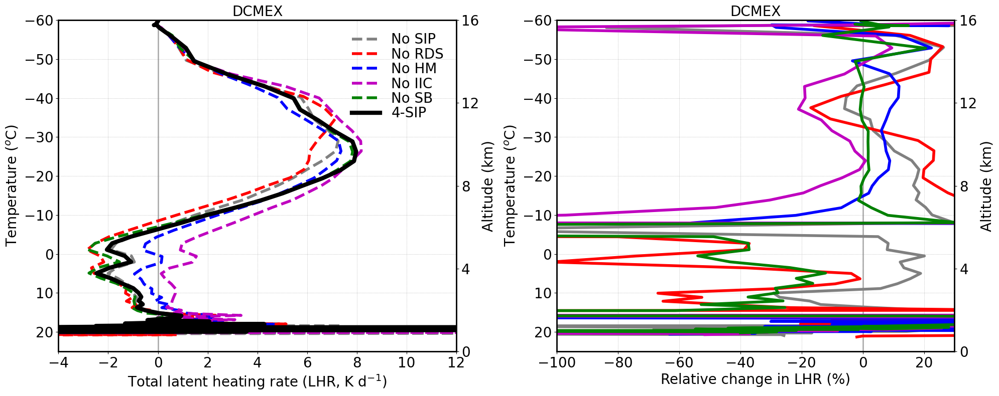

In [16]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 12)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-100., 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('Relative change in LHR (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Freezing and homogeneous level

In [11]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

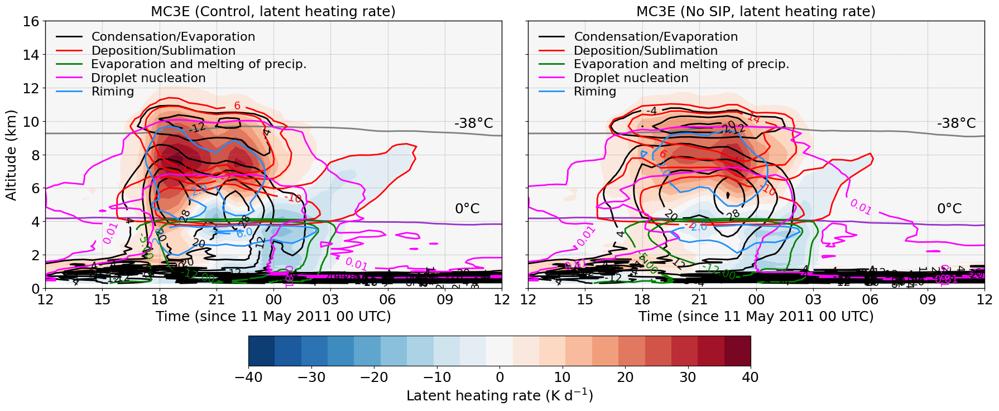

In [15]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-40, 40, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('MC3E (Control, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-10, 20.5, 8)
#contour_levels = np.arange(-10, 20.5, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, columnspacing=0.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-10, 20.5, 8)
#contour_levels = np.arange(-10, 20.5, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, columnspacing=0.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-40, -30, -20, -10, 0, 10, 20, 30, 40])
cbar1.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt+2)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


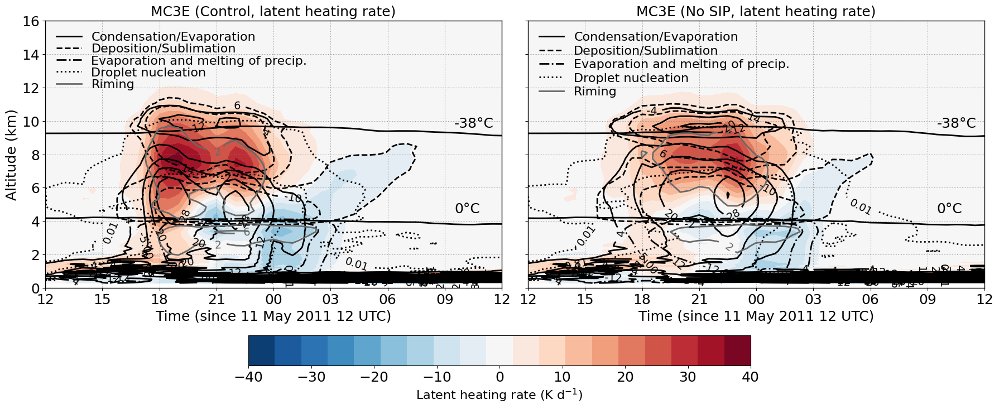

In [15]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=2.0;
alp1=0.3;

lev1 = np.linspace(-40, 40, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('MC3E (Control, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-10, 20.5, 8)
#contour_levels = np.arange(-10, 20.5, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
           ncols=1, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-10, 20.5, 8)
#contour_levels = np.arange(-10, 20.5, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-40, -30, -20, -10, 0, 10, 20, 30, 40])
cbar1.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


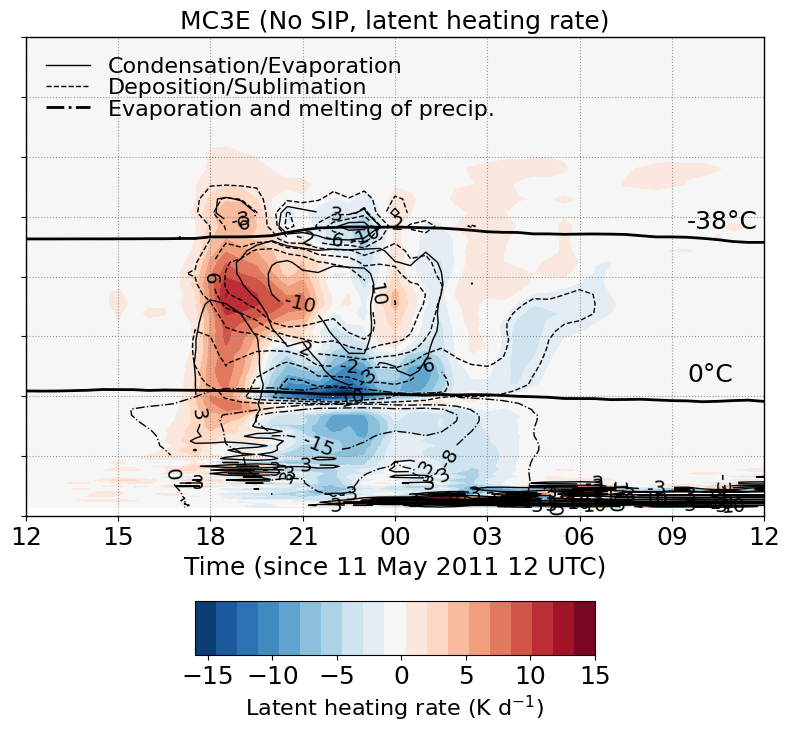

In [30]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec
import colorcet as cc


del_mean_tot_lhr_time_ht = ds_4sip.lhr_kperd.mean(dim=('ncells'))-ds_nosip.lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-30, 30, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-16, 15, 20)

plt.figure(figsize=(8, 6))
plt.style.use('default')

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-10.5, 10.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.linspace(-10.5, 10.5, 6) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 3) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-15, -10, -5, 0, 5, 10, 15])
cbar3.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


In [21]:
print(del_mean_satad_lhr_time_ht.min().values, del_mean_satad_lhr_time_ht.max().values)
print(del_mean_dep_lhr_time_ht.min().values, del_mean_dep_lhr_time_ht.max().values)
print(del_mean_evap_melt_lhr_time_ht.min().values, del_mean_evap_melt_lhr_time_ht.max().values)
print(del_mean_rime_lhr_time_ht.min().values, del_mean_rime_lhr_time_ht.max().values)

-184.56886 201.62212
-15.648188 21.904446
-37.668983 2.3285494
-1.6447055 3.3935833


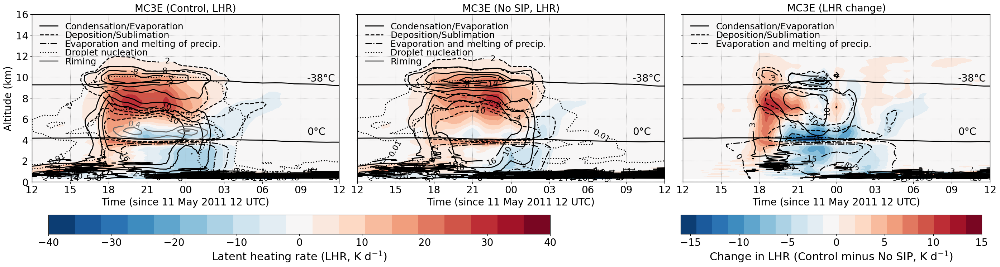

In [66]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.lhr_kperd.mean(dim=('ncells'))-ds_nosip.lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=2.0;
alp1=0.3;

lev1 = np.linspace(-40, 40, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-16, 15, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)#grey

plt.text(ds_4sip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('MC3E (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contour_levels = np.arange(-20, 20.5, 6)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')

#contour_levels = np.arange(-10, 20.5, 10)
#contour_levels = np.arange(-10, 20.5, 8)
contour_levels = np.arange(-10, 10.5, 6)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.linspace(-2.5, 2.5, 8) #np.arange(-3.5, 3.5, 1.)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.arange(-20, 50.5, 8)
#contour_levels = np.arange(-20, 50.5, 10)
contour_levels = np.arange(-20, 20.5, 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')#Saturation adjustment')

#contour_levels = np.arange(-10, 20.5, 10)
#contour_levels = np.arange(-10, 20.5, 8)
contour_levels = np.arange(-10, 10.5, 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
#contour_levels = np.arange(-12, 0., 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln2, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.linspace(-2.5, 2.5, 8) #np.arange(-3.5, 3.5, 1)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.02, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-40, -30, -20, -10, 0, 10, 20, 30, 40])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)#darkorchid
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)#grey

plt.text(ds_nosip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-10.5, 10.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.linspace(-10.5, 10.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 3) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.02, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-30, -20, -10, 0, 10, 20, 30])
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-15, -10, -5, 0, 5, 10, 15])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


In [63]:
np.linspace(-2.5, 2.5, 4)

array([-2.5       , -0.83333333,  0.83333333,  2.5       ])

In [59]:
print(ds_4sip.rime_lhr_kperd.min().values, ds_4sip.rime_lhr_kperd.max().values)

-1.8828737 2221.382


In [20]:
ds_4sip.w_vel.max().values

array(42.82634, dtype=float32)

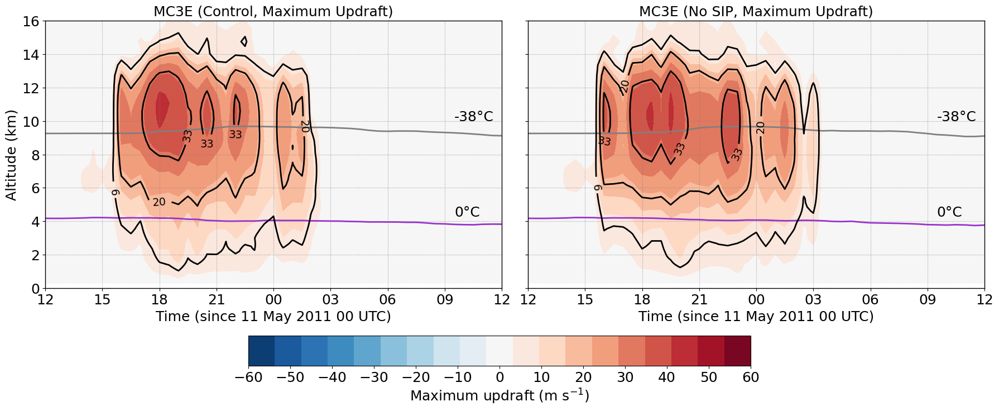

In [23]:

import matplotlib.lines as mlines

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-60, 60, 20)
#lev2 = np.linspace(-0.1, 0.1, 20)
lev2 = np.linspace(-60, 60, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('MC3E (Control, Maximum Updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-60, 60., 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Vertical velocity (m s$^{-1}$)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP, Maximum Updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-60, 60., 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-60, -50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60], orientation='horizontal')
cbar.set_label('Maximum updraft (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()


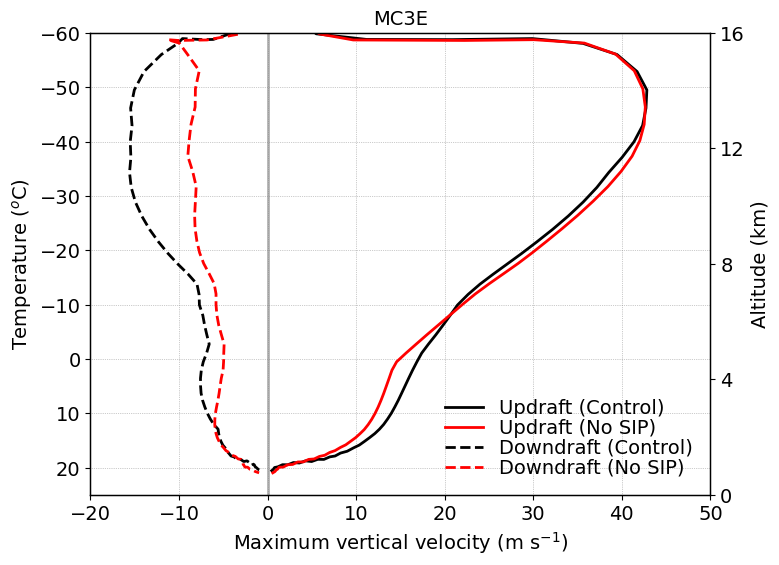

In [18]:

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')


plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.w_vel.max(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Updraft (Control)')
plt1.plot(ds_nosip.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Updraft (No SIP)')


plt1.plot(ds_4sip.w_vel.min(dim=('time','ncells')), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Downdraft (Control)')
plt1.plot(ds_nosip.w_vel.min(dim=('time','ncells')), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Downdraft (No SIP)')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-20, 50)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

In [41]:

mean_cond_lhr_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_4sip = ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values

mean_cond_lhr_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_nosip = ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values


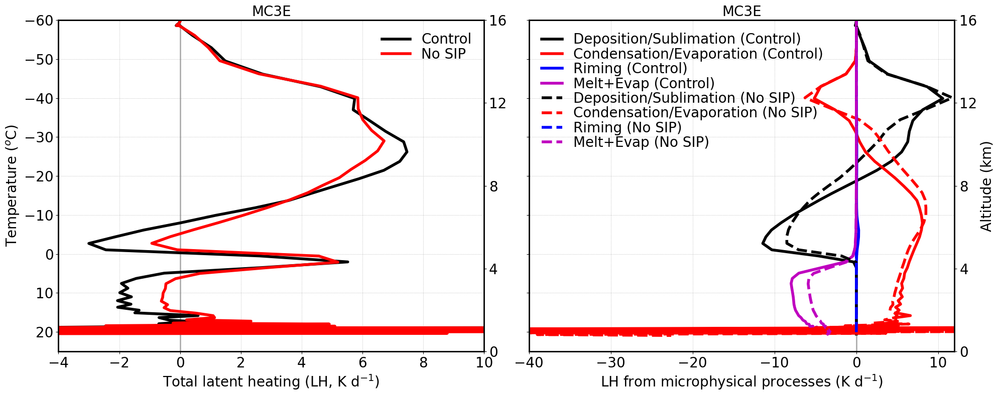

In [42]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dep_lhr_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_satad_lhr_4sip, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_rime_lhr_4sip, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Riming (Control)')
plt1.plot(mean_melt_evap_lhr_4sip, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Melt+Evap (Control)')
#plt1.plot(mean_cond_lhr_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_dep_lhr_nosip, mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_satad_lhr_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_rime_lhr_nosip, mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Riming (No SIP)')
plt1.plot(mean_melt_evap_lhr_nosip, mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Melt+Evap (No SIP)')
#plt1.plot(mean_cond_lhr_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_rime_lhr_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-40., 12)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=1.5, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Microphysical properties

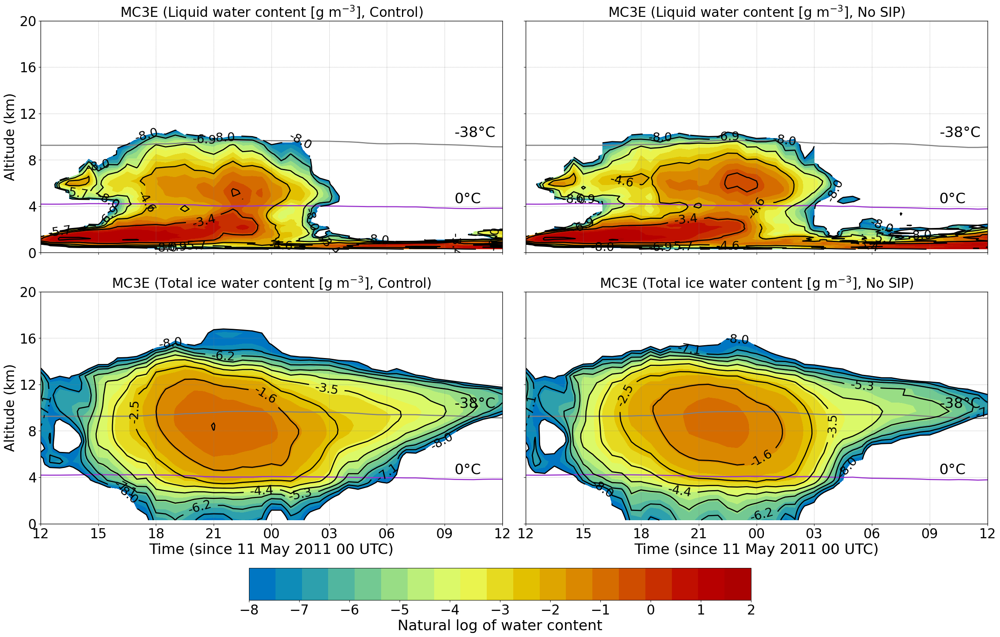

In [40]:

import matplotlib.lines as mlines

fnt=24;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
lev2 = np.linspace(-8, 2, 20)
plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Liquid water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Liquid water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total ice water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total IWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total ice water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar.set_label('Natural log of water content', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


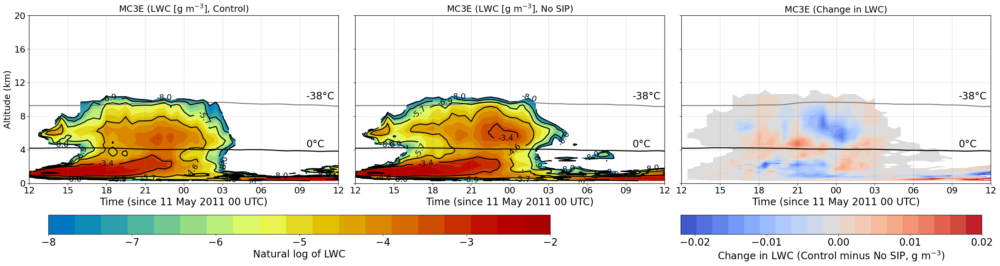

In [44]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.022, 0.02, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.02, -0.01, 0, 0.01, 0.02], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


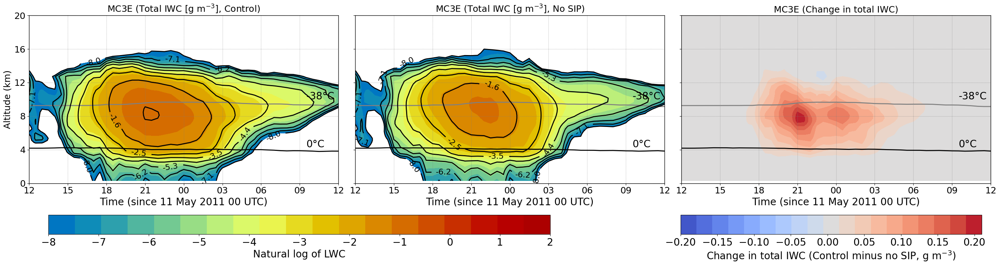

In [48]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip > 0.0001, np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, 2, 20)
#lev1 = np.linspace(0, 0.1, 20)
#lev2 = np.linspace(0.0001, 0.16, 20)
lev2 = np.linspace(-0.2, 0.21, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[0, 0.04, 0.08, 0.12, 0.16], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.2, -0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15, 0.2], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus no SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


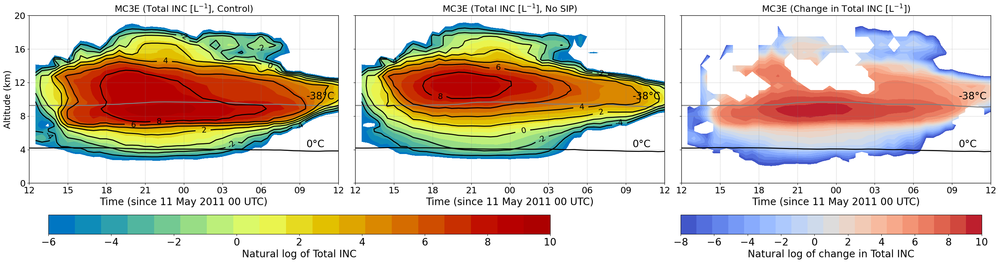

In [24]:

import matplotlib.lines as mlines
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-8, 10, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of change in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [50]:

## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)
    

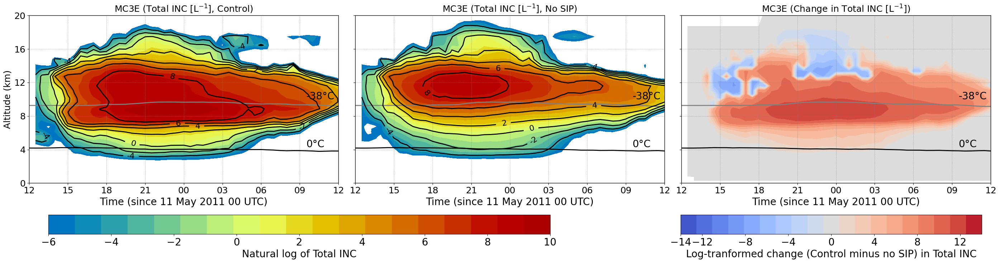

In [52]:

import matplotlib.lines as mlines

def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)


mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-14, 14, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-14, -12, -8, -4, 0, 4, 8, 12, 16], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-tranformed change (Control minus no SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


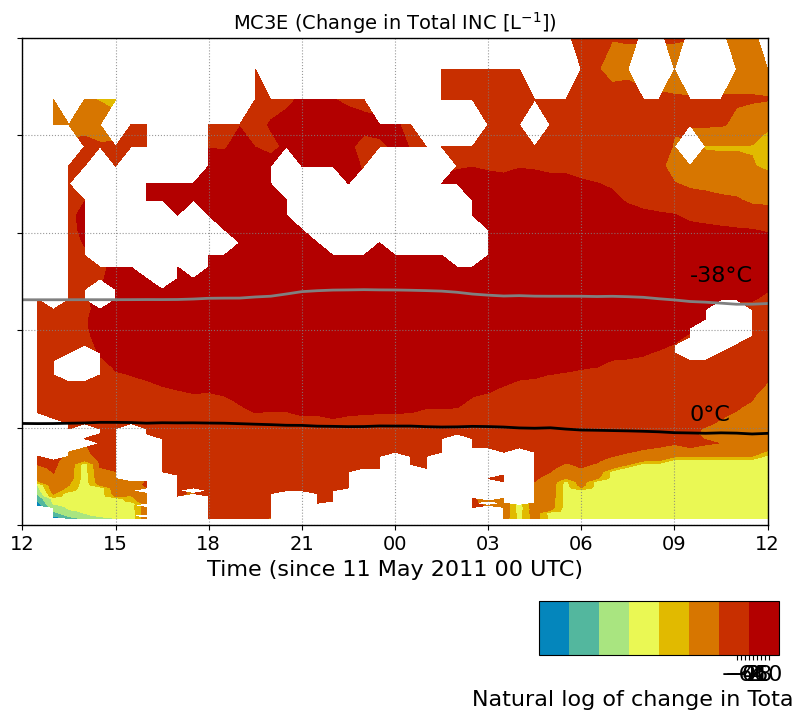

In [14]:
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 12, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-6, 10, 20)

plt.figure(figsize=(8, 6))
plt.style.use('default')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of change in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()

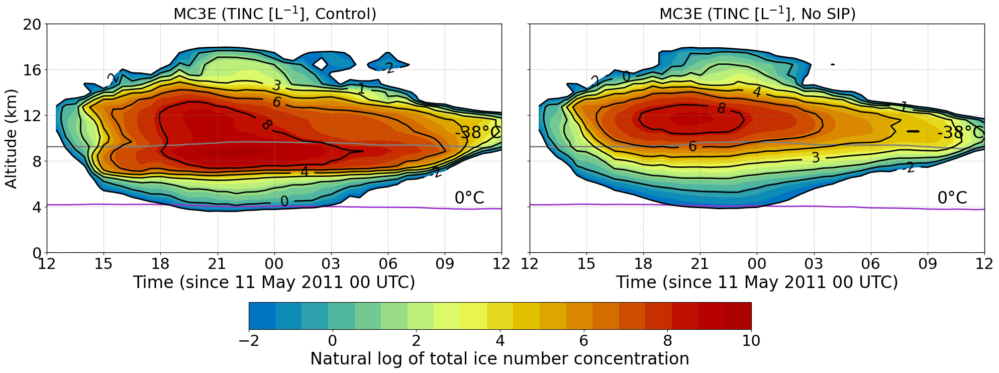

In [42]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-2, 10, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (TINC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-2, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 10, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (TINC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-2, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-2, 0, 2, 4, 6, 8, 10], orientation='horizontal')#ticks=[0, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Natural log of total ice number concentration', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


## Freezing level and cloud top height

In [53]:

## Freezing and cloud top height

mask = (ds_4sip.tempc > -0.5) & (ds_4sip.tempc < 0.5)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.5) & (ds_nosip.tempc < 0.5)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

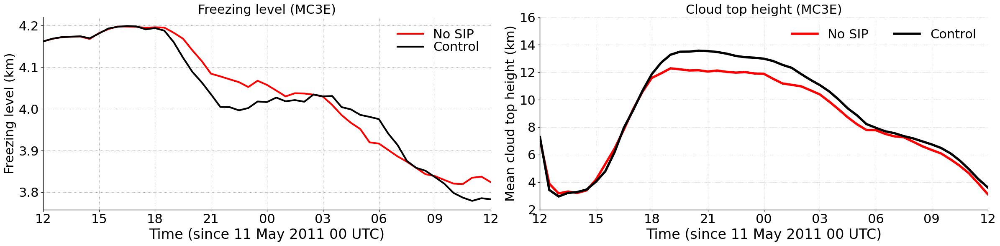

In [54]:



fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
#plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
#plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
#plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
#plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (MC3E)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'r-', color='r', linewidth=lnwdth, label='No SIP')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=lnwdth, label='Control')

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(2,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (MC3E)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

### TOA Radiative Fluxes
#### Calculating CRE
#### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
#### Net CRE = SW_CRE + LW_CRE

In [8]:

#### SIP
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0)
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0)
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_lw_dn_4sip-toa_lw_up_4sip) - (toa_lw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip

surf_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=65)
surf_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=65) 
surf_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=65) 

surf_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=65) 
surf_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=65) 
surf_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=65) 
surf_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=65) 

surf_sw_cre_4sip = (surf_sw_dn_4sip-surf_sw_up_4sip) - (surf_sw_dn_clr_4sip-surf_sw_up_clr_4sip)
surf_lw_cre_4sip = (surf_lw_dn_4sip-surf_lw_up_4sip) - (surf_lw_dn_clr_4sip-surf_lw_up_clr_4sip)
surf_net_cre_4sip = surf_sw_cre_4sip+surf_lw_cre_4sip

ds_4sip['surf_sw_cre'] = surf_sw_cre_4sip
ds_4sip['surf_lw_cre'] = surf_lw_cre_4sip
ds_4sip['surf_net_cre'] = surf_net_cre_4sip


#### No SIP
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0)
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0)
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_lw_dn_nosip-toa_lw_up_nosip) - (toa_lw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip

surf_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=65)
surf_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=65)
surf_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=65)

surf_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=65)
surf_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=65)
surf_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=65)
surf_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=65)

surf_sw_cre_nosip = (surf_sw_dn_nosip-surf_sw_up_nosip) - (surf_sw_dn_clr_nosip-surf_sw_up_clr_nosip)
surf_lw_cre_nosip = (surf_lw_dn_nosip-surf_lw_up_nosip) - (surf_lw_dn_clr_nosip-surf_lw_up_clr_nosip)
surf_net_cre_nosip = surf_sw_cre_nosip+surf_lw_cre_nosip

ds_nosip['surf_sw_cre'] = surf_sw_cre_nosip
ds_nosip['surf_lw_cre'] = surf_lw_cre_nosip
ds_nosip['surf_net_cre'] = surf_net_cre_nosip


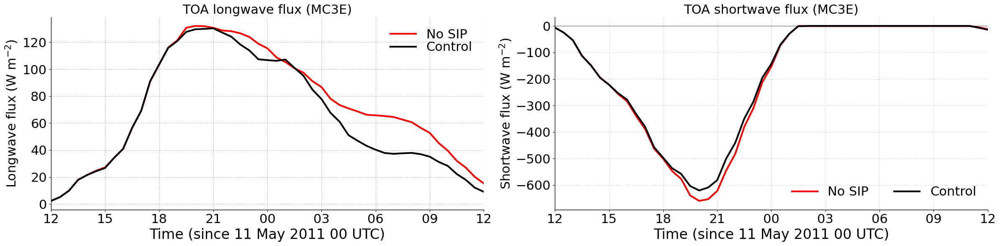

In [9]:


fontsize=22;
fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, ds_4sip.toa_lw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_lw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Longwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA longwave flux (MC3E)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, ds_4sip.toa_sw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_sw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
#plt.ylim(5,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Shortwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA shortwave flux (MC3E)', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [13]:

dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))

acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours

tot_acc_precip_4sip = np.nanmax(ds_4sip.tot_prec.mean('ncells'))
tot_acc_precip_nosip = np.nanmax(ds_nosip.tot_prec.mean('ncells'))

std_tot_precip_4sip = np.nanstd(ds_4sip.tot_prec.mean('ncells'))
std_tot_precip_nosip = np.nanstd(ds_nosip.tot_prec.mean('ncells'))

n_cells = ds_4sip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_4sip = std_tot_precip_4sip / np.sqrt(n_cells)

n_cells = ds_nosip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_nosip = std_tot_precip_nosip / np.sqrt(n_cells)


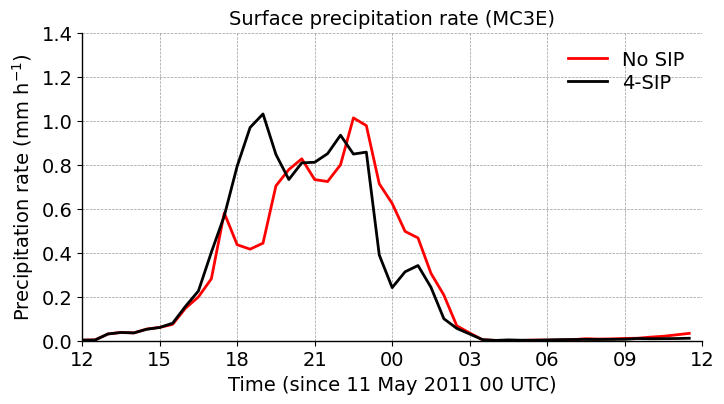

In [12]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))
plt.style.use('default')

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), 'r-', linewidth=lnwdth, label='No SIP')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)

plt.ylabel('Precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 11 May 2011 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 1.4)

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation rate (MC3E)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='best')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))


plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


In [11]:

start_time='2011-05-11T16:00:00.000000000';
end_time='2011-05-12T04:00:00.000000000';

## 4 SIP

## TOA LW
min_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_4sip = std_toa_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

## TOA SW
min_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_4sip = std_toa_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

## TOA NET
min_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_4sip = std_toa_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## Surface LW
min_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_4sip = std_surf_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

## Surface SW
min_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_4sip = std_surf_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

## Surface NET
min_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_4sip = std_surf_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

## No SIP
min_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_nosip = std_toa_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

min_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_nosip = std_toa_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

min_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_nosip = std_toa_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## surface
min_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_nosip = std_surf_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

min_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_nosip = std_surf_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

min_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_nosip = std_surf_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 



In [12]:

#start_time='2011-05-11T12:00:00.000000000';
#end_time='2011-05-12T12:00:00.000000000';

start_time='2011-05-11T16:00:00.000000000';
end_time='2011-05-12T04:00:00.000000000';

low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_4sip = np.nanstd(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_4sip = std_low_cld_cover_4sip / np.sqrt(n_cells)

low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_nosip = np.nanstd(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_nosip = std_low_cld_cover_nosip / np.sqrt(n_cells)

mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_4sip = np.nanstd(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_4sip = std_mid_cld_cover_4sip / np.sqrt(n_cells)

mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_nosip = np.nanstd(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_nosip = std_mid_cld_cover_nosip / np.sqrt(n_cells)

high_cld_cover_4sip = np.nanmean(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_4sip = np.nanstd(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_4sip = std_high_cld_cover_4sip / np.sqrt(n_cells)

high_cld_cover_nosip = np.nanmean(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_nosip = np.nanstd(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_nosip = std_high_cld_cover_nosip / np.sqrt(n_cells)

tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_4sip = np.nanstd(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_4sip = std_tot_cld_cover_4sip / np.sqrt(n_cells)

tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_nosip = np.nanstd(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_nosip = std_tot_cld_cover_nosip / np.sqrt(n_cells)

#low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.mean('plev'))
#low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.mean('plev'))

#mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.mean('plev_2'))
#mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.mean('plev_2'))

#high_cld_cover_4sip = np.nanmean(ds_4sip.clch.mean('plev_3'))
#high_cld_cover_nosip = np.nanmean(ds_nosip.clch.mean('plev_3'))

#tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.mean('ncells'))
#tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.mean('ncells'))


In [14]:

stderr_tot_precip_4sip = stderr_tot_precip_4sip.values
stderr_tot_precip_nosip = stderr_tot_precip_nosip.values

stderr_low_cld_cover_4sip = stderr_low_cld_cover_4sip.values
stderr_low_cld_cover_nosip = stderr_low_cld_cover_nosip.values
stderr_mid_cld_cover_4sip = stderr_mid_cld_cover_4sip.values
stderr_mid_cld_cover_nosip = stderr_mid_cld_cover_nosip.values
stderr_high_cld_cover_4sip = stderr_high_cld_cover_4sip.values
stderr_high_cld_cover_nosip = stderr_high_cld_cover_nosip.values
stderr_tot_cld_cover_4sip = stderr_tot_cld_cover_4sip.values
stderr_tot_cld_cover_nosip = stderr_tot_cld_cover_nosip.values


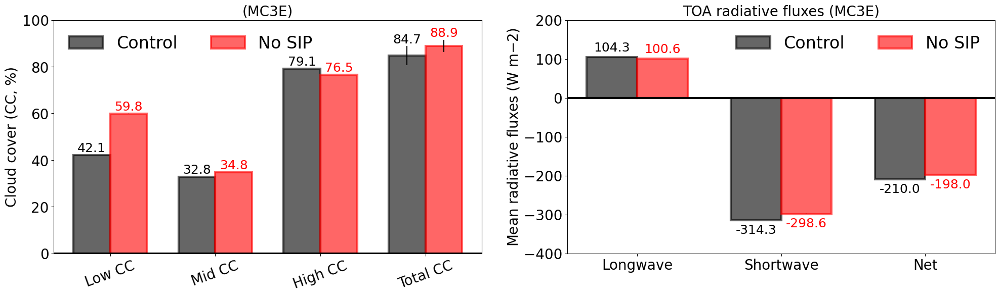

In [16]:

#group_cc_4sip = [tot_acc_precip_4sip, low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
#group_cc_nosip = [tot_acc_precip_nosip, low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

group_cc_4sip = [low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
group_cc_nosip = [low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

#stderr_cc_4sip = [stderr_tot_precip_4sip, stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
#stderr_cc_nosip = [stderr_tot_precip_nosip, stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

stderr_cc_4sip = [stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
stderr_cc_nosip = [stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

#stderr_cc_4sip = [std_tot_precip_4sip, std_low_cld_cover_4sip, std_mid_cld_cover_4sip, std_high_cld_cover_4sip, std_tot_cld_cover_4sip];
#stderr_cc_nosip = [std_tot_precip_nosip, std_low_cld_cover_nosip, std_mid_cld_cover_nosip, std_high_cld_cover_nosip, std_tot_cld_cover_nosip];

group_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

stderr_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
stderr_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
cc_comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_cc - width/2, group_cc_4sip, width, yerr=stderr_cc_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_cc + width/2, group_cc_nosip, width, yerr=stderr_cc_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(0,100)
#ax1.set_ylabel('Accumulated precipitation (mm) \nand cloud cover (CC, %)', fontsize=fnt)
ax1.set_ylabel('Cloud cover (CC, %)', fontsize=fnt)
ax1.set_xticks(x_cc)
ax1.set_xticklabels(cc_comp_groups, rotation=20)
ax1.set_title('(MC3E)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_flux_4sip, width, yerr=stderr_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_flux_nosip, width, yerr=stderr_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-400,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (MC3E)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


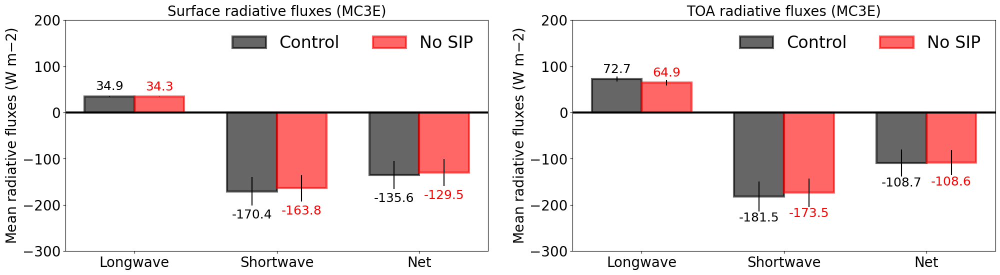

In [56]:

group_surf_flux_4sip = [mean_surf_lw_cre_4sip, mean_surf_sw_cre_4sip, mean_surf_net_cre_4sip]
group_surf_flux_nosip = [mean_surf_lw_cre_nosip, mean_surf_sw_cre_nosip, mean_surf_net_cre_nosip]

err_surf_flux_4sip = [stderr_surf_lw_cre_4sip, stderr_surf_sw_cre_4sip, stderr_surf_net_cre_4sip];
err_surf_flux_nosip = [stderr_surf_lw_cre_nosip, stderr_surf_sw_cre_nosip, stderr_surf_net_cre_nosip];

#err_surf_flux_4sip = [std_surf_lw_cre_4sip, std_surf_sw_cre_4sip, std_surf_net_cre_4sip];
#err_surf_flux_nosip = [std_surf_lw_cre_nosip, std_surf_sw_cre_nosip, std_surf_net_cre_nosip];

group_toa_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_toa_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

err_toa_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
err_toa_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#err_toa_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#err_toa_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_flux - width/2, group_surf_flux_4sip, width, yerr=err_surf_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_flux + width/2, group_surf_flux_nosip, width, yerr=err_surf_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(-300,200)
ax1.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax1.set_xticks(x_flux)
ax1.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax1.set_title('Surface radiative fluxes (MC3E)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_toa_flux_4sip, width, yerr=err_toa_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_toa_flux_nosip, width, yerr=err_toa_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-300,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (MC3E)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)


ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


In [55]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre

In [26]:

print(ds_4sip.net_sw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_sw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_lw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_lw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_tot_cre.mean(dim=('ncells')).min().values, ds_4sip.net_tot_cre.mean(dim=('ncells')).max().values)

-763.644 0.0
2.0318153 210.6731
-623.84186 149.82724


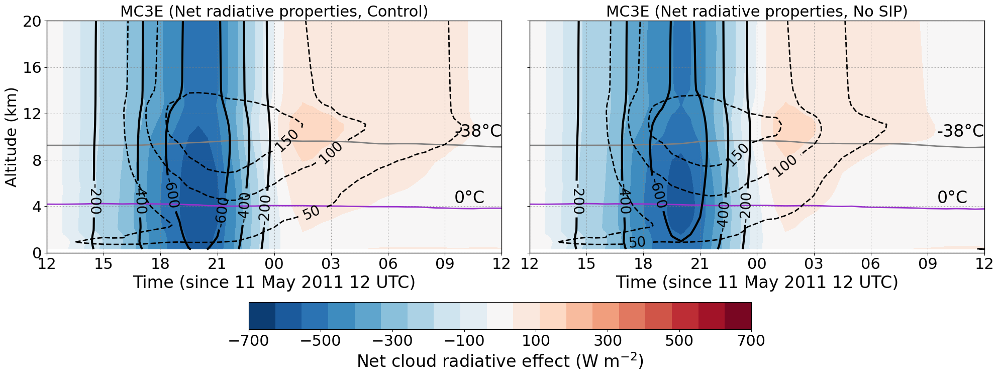

In [30]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-700, 700, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Net radiative properties, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-800, 0, 200)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(0, 200, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Net radiative properties, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-800, 0, 200)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(0, 200, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-750, -600, -450, -300, -150, 0, 150, 300, 450, 600, 750], orientation='horizontal')
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-700, -500, -300, -100, 100, 300, 500, 700], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


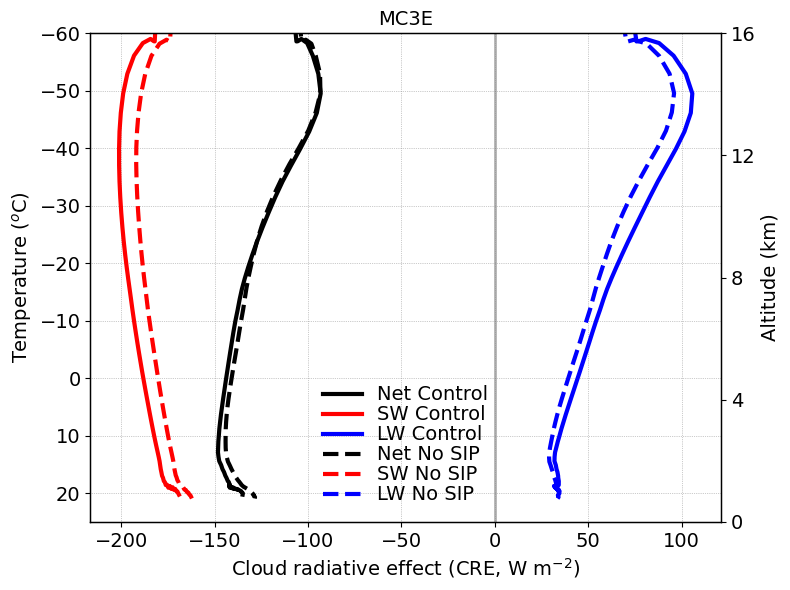

In [56]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Net Control')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='SW Control')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='LW Control')

plt1.plot(ds_nosip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Net No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='SW No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='LW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-5., 5)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-1, -0.5, 0, 0.5, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


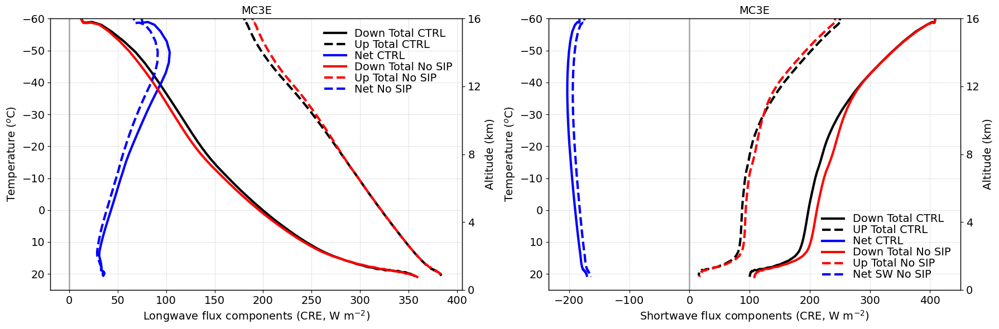

In [14]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Up Total CTRL')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-80., 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-1, -0.5, 0, 0.5, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Longwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='UP Total CTRL')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net SW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-80., 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-1, -0.5, 0, 0.5, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Shortwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)
plt.tight_layout()
plt.show()


In [8]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre


In [9]:

def lwc_netcre_ht_avg(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
    netcre_mean = netcre_interp.mean(dim=height)

    return lwc_mean, netcre_mean

def lwc_swcre_ht_avg(ds, lwc_var='lwc_gperm3', swcre_var='net_sw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average    
    swcre_interp = ds[swcre_var].interp({height2: ds[height]})
    swcre_mean = swcre_interp.mean(dim=height)

    return lwc_mean, swcre_mean

def lwc_lwcre_ht_avg(ds, lwc_var='lwc_gperm3', lwcre_var='net_lw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    lwcre_interp = ds[lwcre_var].interp({height2: ds[height]})
    lwcre_mean = lwcre_interp.mean(dim=height)

    return lwc_mean, lwcre_mean




def iwc_ht_avg(ds, iwc_var='tiwc_gperm3', height='height'):
    # Average over height for lwc
    iwc_mean = ds[iwc_var].mean(dim=height)

    return iwc_mean


def cdnc_ht_avg(ds, cdnc_var='cdnc_percm3', height='height'):
    # Average over height for lwc
    cdnc_mean = ds[cdnc_var].mean(dim=height)

    return cdnc_mean

def tinc_ht_avg(ds, tinc_var='inc_perl', height='height'):
    # Average over height for lwc
    tinc_mean = ds[tinc_var].mean(dim=height)

    return tinc_mean


#def average_over_height(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
#    # Average over height for lwc
#    lwc_mean = ds[lwc_var].mean(dim=height)#
#
#    # Interpolate net CRE to match height, then average
#    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
#    netcre_mean = netcre_interp.mean(dim=height)
#
#    return lwc_mean, netcre_mean



In [80]:

lwc_4sip, netcre_4sip = lwc_netcre_ht_avg(ds_4sip)
lwc_nosip, netcre_nosip = lwc_netcre_ht_avg(ds_nosip)

lwc_4sip, swcre_4sip = lwc_swcre_ht_avg(ds_4sip)
lwc_nosip, swcre_nosip = lwc_swcre_ht_avg(ds_nosip)

lwc_4sip, lwcre_4sip = lwc_lwcre_ht_avg(ds_4sip)
lwc_nosip, lwcre_nosip = lwc_lwcre_ht_avg(ds_nosip)


# Flatten to 1D
lwc_4sip = lwc_4sip.values.flatten()
netcre_4sip = netcre_4sip.values.flatten()
swcre_4sip = swcre_4sip.values.flatten()
lwcre_4sip = lwcre_4sip.values.flatten()

lwc_nosip = lwc_nosip.values.flatten()
netcre_nosip = netcre_nosip.values.flatten()
swcre_nosip = swcre_nosip.values.flatten()
lwcre_nosip = lwcre_nosip.values.flatten()


In [85]:

iwc_4sip= iwc_ht_avg(ds_4sip)
iwc_nosip = iwc_ht_avg(ds_nosip)

iwc_4sip = iwc_4sip.values.flatten()
iwc_nosip = iwc_nosip.values.flatten()


In [105]:

cdnc_4sip= cdnc_ht_avg(ds_4sip)
cdnc_nosip = cdnc_ht_avg(ds_nosip)

cdnc_4sip = cdnc_4sip.values.flatten()
cdnc_nosip = cdnc_nosip.values.flatten()

tinc_4sip= tinc_ht_avg(ds_4sip)
tinc_nosip = tinc_ht_avg(ds_nosip)

tinc_4sip = tinc_4sip.values.flatten()
tinc_nosip = tinc_nosip.values.flatten()

In [82]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err


In [106]:
# Filter to reasonable LWC range (e.g., non-zero, realistic values)
mask_lwc_4sip = (lwc_4sip > 1e-3)
mask_lwc_nosip = (lwc_nosip > 1e-3)

mask_iwc_4sip = (iwc_4sip > 1e-3)
mask_iwc_nosip = (iwc_nosip > 1e-3)

mask_cdnc_4sip = (cdnc_4sip > 1e-3)
mask_cdnc_nosip = (cdnc_nosip > 1e-3)

mask_tinc_4sip = (tinc_4sip > 1e-3)
mask_tinc_nosip = (tinc_nosip > 1e-3)

lwc_bins = np.linspace(0, np.nanmax([lwc_4sip, lwc_nosip]), 6)  # ~25 bins
iwc_bins = np.linspace(0, np.nanmax([iwc_4sip, iwc_nosip]), 6)

# CONTROL
binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], netcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], swcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], lwcre_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], netcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], swcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], lwcre_4sip[mask_iwc_4sip], iwc_bins)

binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], cdnc_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], tinc_4sip[mask_iwc_4sip], iwc_bins)

# NO SIP
binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], netcre_nosip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], swcre_4sip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], lwcre_4sip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], netcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], swcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], lwcre_nosip[mask_iwc_nosip], iwc_bins)

binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], cdnc_nosip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], tinc_nosip[mask_iwc_nosip], iwc_bins)


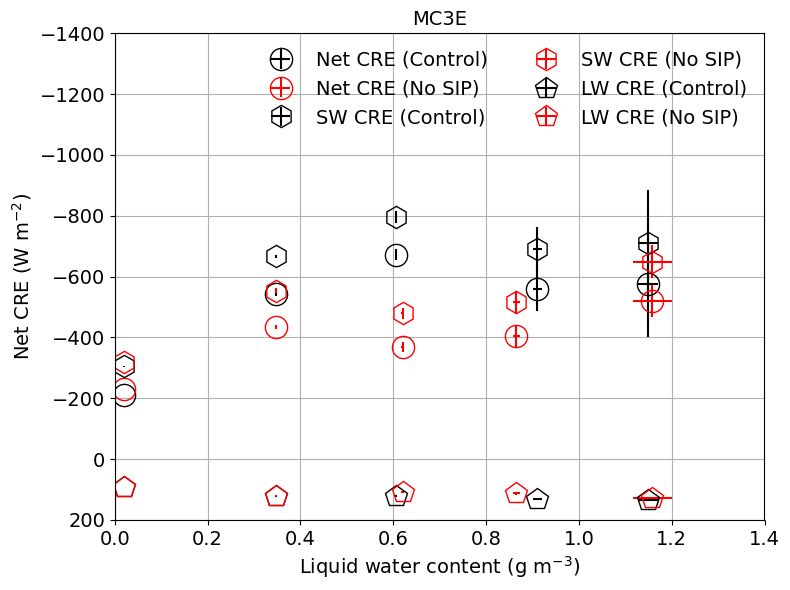

In [90]:

ms=16
fnt=14;
plt.figure(figsize=(8, 6))
plt.style.use('default')

# Plot Control with black error bars
plt.errorbar(binned_lwc_4sip, binned_netcre_4sip, xerr=err_lwc_4sip, yerr=err_netcre_4sip, 
             fmt='o', color='black', markersize=ms, markerfacecolor='none', label='Net CRE (Control)', capsize=0)
plt.errorbar(binned_lwc_nosip, binned_netcre_nosip, xerr=err_lwc_nosip, yerr=err_netcre_nosip, 
             fmt='o', color='red', markersize=ms, markerfacecolor='none', label='Net CRE (No SIP)',capsize=0)

plt.errorbar(binned_lwc_4sip, binned_swcre_4sip, xerr=err_lwc_4sip, yerr=err_swcre_4sip, 
             fmt='h', color='k', markersize=ms, markerfacecolor='none', label='SW CRE (Control)', capsize=0)
plt.errorbar(binned_lwc_nosip, binned_swcre_nosip, xerr=err_lwc_nosip, yerr=err_swcre_nosip, 
             fmt='h', color='r', markersize=ms, markerfacecolor='none', label='SW CRE (No SIP)', capsize=0)

plt.errorbar(binned_lwc_4sip, binned_lwcre_4sip, xerr=err_lwc_4sip, yerr=err_lwcre_4sip, 
             fmt='p', color='k', markersize=ms, markerfacecolor='none', label='LW CRE (Control)', capsize=0)
plt.errorbar(binned_lwc_nosip, binned_lwcre_nosip, xerr=err_lwc_nosip, yerr=err_lwcre_nosip, 
             fmt='p', color='r', markersize=ms, markerfacecolor='none', label='LW CRE (No SIP)', capsize=0)


plt.xlim(0., 1.4)
plt.ylim(200, -1400)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('MC3E', fontsize=fnt)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fnt)

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.5, ncols=2, fontsize=fnt, loc='best')
plt.grid(True)
plt.tight_layout()
plt.show()


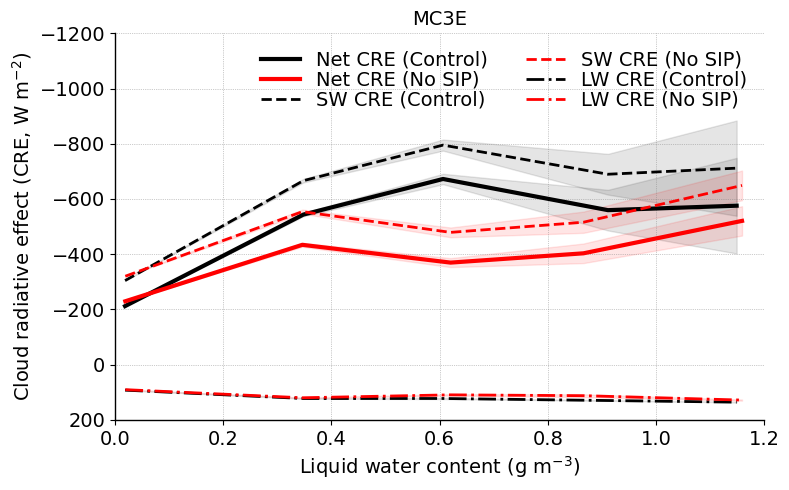

In [94]:
def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

ln1=3;
ln2=2;
fnt=14;

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')

plot_with_shaded_error_lwc_netcre(ax, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

# Repeat for SW and LW

ax.set_xlim(0, 1.2)
ax.set_ylim(200, -1200)

#ax.set_xticks([-1, -0.5, 0, 0.5, 1])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax.set_ylabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fnt)
ax.set_title('MC3E', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


In [122]:
print(binned_netcre_4sip)
print(binned_swcre_4sip)
print(binned_lwcre_4sip)
print(binned_swcre_4sip+binned_lwcre_4sip)

[-211.86384068 -543.38912965 -672.40833705 -559.51327642 -575.61987305]
[-304.37604347 -666.18695015 -795.13868764 -689.58980306 -711.62471008]
[ 92.51220286 122.79782093 122.73035261 130.0765028  136.00489044]
[-211.86384061 -543.38912922 -672.40833503 -559.51330026 -575.61981964]


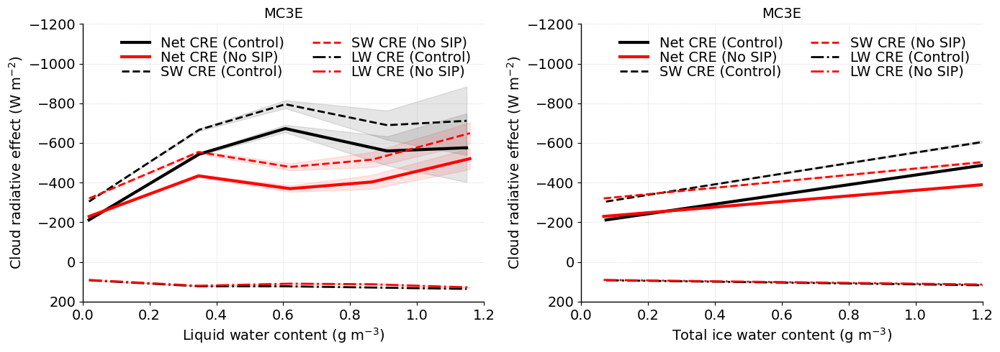

In [120]:

def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax1.set_xlim(0, 1.2)
ax1.set_ylim(200, -1200)
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax1.set_title('MC3E', fontsize=fnt)
ax1.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(200, -1200)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax2.set_title('MC3E', fontsize=fnt)
ax2.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


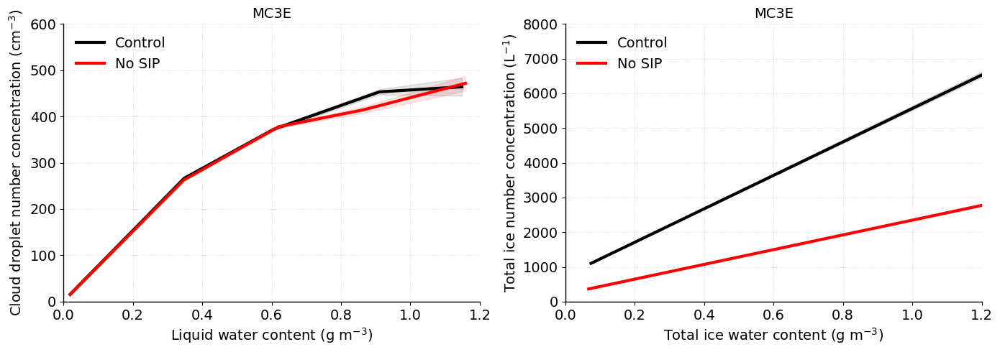

In [121]:

def plot_with_shaded_error_lwc_cdnc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)
    
def plot_with_shaded_error_lwc_tinc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip, 'r', 'No SIP')

ax1.set_xlim(0, 1.2)
ax1.set_ylim(0, 600)
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud droplet number concentration (cm$^{-3}$)', fontsize=fnt)
ax1.set_title('MC3E', fontsize=fnt)
ax1.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip, 'r', 'No SIP')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(0, 8000)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Total ice number concentration (L$^{-1}$)', fontsize=fnt)
ax2.set_title('MC3E', fontsize=fnt)
ax2.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


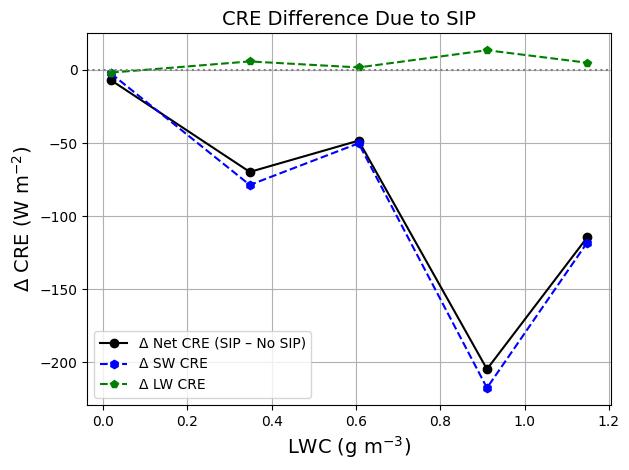

In [39]:
delta_netcre = binned_netcre_4sip - binned_netcre_nosip
delta_swcre = binned_swcre_4sip - binned_swcre_nosip
delta_lwcre = binned_lwcre_4sip - binned_lwcre_nosip

plt.plot(binned_lwc_4sip, delta_netcre, 'o-', color='black', label='Δ Net CRE (SIP – No SIP)')
plt.plot(binned_lwc_4sip, delta_swcre, 'h--', color='blue', label='Δ SW CRE')
plt.plot(binned_lwc_4sip, delta_lwcre, 'p--', color='green', label='Δ LW CRE')
plt.axhline(0, color='gray', linestyle=':')
plt.xlabel('LWC (g m$^{-3}$)', fontsize=fnt)
plt.ylabel('Δ CRE (W m$^{-2}$)', fontsize=fnt)
plt.title('CRE Difference Due to SIP', fontsize=fnt)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [10]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_lwc_4sip = ds_4sip.lwc_gperm3.min().values
max_lwc_4sip = ds_4sip.lwc_gperm3.max().values
#######

n_bin = 30;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
lwc_4sip_bin = np.linspace(min_lwc_4sip, max_lwc_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.values.flatten()
lwc_4sip_flat = ds_4sip.lwc_gperm3.values.flatten()
net_cre_4sip_flat = ds_4sip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_4sip_flat = ds_4sip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_4sip_flat = ds_4sip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_4sip, temp_edges_4sip, lwc_edges_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin))
#######

#######
net_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = net_cre_4sip_flat)[0]
sw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = sw_cre_4sip_flat)[0]
lw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = lw_cre_4sip_flat)[0]
#######

#######
net_cre_temp_lwc_4sip = net_cre_sum_4sip/hist_4sip
sw_cre_temp_lwc_4sip = sw_cre_sum_4sip/hist_4sip
lw_cre_temp_lwc_4sip = lw_cre_sum_4sip/hist_4sip
#######

In [11]:
#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lwc_nosip = ds_nosip.lwc_gperm3.min().values
max_lwc_nosip = ds_nosip.lwc_gperm3.max().values
#######

n_bin = 30;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
lwc_nosip_bin = np.linspace(min_lwc_nosip, max_lwc_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
lwc_nosip_flat = ds_nosip.lwc_gperm3.values.flatten()
net_cre_nosip_flat = ds_nosip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_nosip_flat = ds_nosip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_nosip_flat = ds_nosip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_nosip, temp_edges_nosip, lwc_edges_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin))
#######

#######
net_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = net_cre_nosip_flat)[0]
sw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = sw_cre_nosip_flat)[0]
lw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = lw_cre_nosip_flat)[0]
#######

#######
net_cre_temp_lwc_nosip = net_cre_sum_nosip/hist_nosip
sw_cre_temp_lwc_nosip = sw_cre_sum_nosip/hist_nosip
lw_cre_temp_lwc_nosip = lw_cre_sum_nosip/hist_nosip


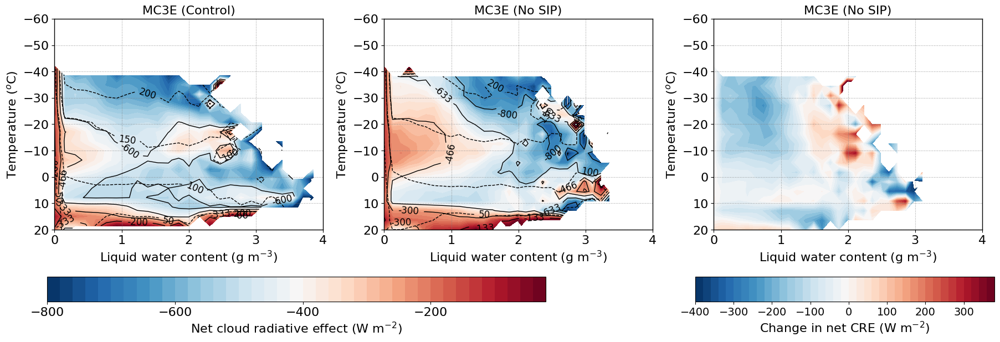

In [26]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.arange(-800, 0, 20)
lev2 = np.arange(-800, 0, 20)
lev3 = np.arange(-300, 200, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

#im = axes[0].imshow(net_cre_temp_lwc_4sip, extent=[lwc_4sip_bin[0], lwc_4sip_bin[-1], temp_4sip_bin[0], temp_4sip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap=cmap)
#axes[0].set_title('Net CRE [Control]', fontsize=fontsize)

#contours = axes[0].contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#axes[0].clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')

#cnt1=plt.imshow(net_cre_temp_lwc_4sip, extent=[lwc_4sip_bin[0], lwc_4sip_bin[-1], temp_4sip_bin[0], temp_4sip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

cnt1=plt.contourf(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-600, 200., 7)
contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], sw_cre_temp_lwc_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], lw_cre_temp_lwc_4sip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

#cnt2=plt.imshow(net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

cnt2=plt.contourf(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_nosip, levels=lev1, cmap='RdBu_r')
#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_nosip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-800, 200., 7)
contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], sw_cre_temp_lwc_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], lw_cre_temp_lwc_nosip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[-800, -600, -400, -200, 0], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.arange(-400, 400, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400], orientation='horizontal')
cbar.set_label('Change in net CRE (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [28]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [29]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').min().values
max_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 12;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
lhr_4sip_bin = np.linspace(min_lhr_4sip, max_lhr_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.mean('ncells').values.flatten()
lhr_4sip_flat = ds_4sip.lhr_kperd.mean('ncells').values.flatten()
wvel_4sip_flat = ds_4sip.w_vel.max('ncells').values.flatten()


#######
hist_4sip, temp_edges_4sip, wvel_edges_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin))
#######

#######
wvel_sum_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin), weights = wvel_4sip_flat)[0]
#######

#######
wvel_temp_lhr_4sip = wvel_sum_4sip/hist_4sip
#######

In [38]:

#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').min().values
max_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 100;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
lhr_nosip_bin = np.linspace(min_lhr_nosip, max_lhr_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.mean('ncells').values.flatten()
lhr_nosip_flat = ds_nosip.lhr_kperd.mean('ncells').values.flatten()
wvel_nosip_flat = ds_nosip.w_vel.max('ncells').values.flatten()


#######
hist_nosip, temp_edges_nosip, wvel_edges_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin))
#######

#######
wvel_sum_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin), weights = wvel_nosip_flat)[0]
#######

#######
wvel_temp_lhr_nosip = wvel_sum_nosip/hist_nosip
#######


ValueError: operands could not be broadcast together with shapes (12,12) (100,100) 

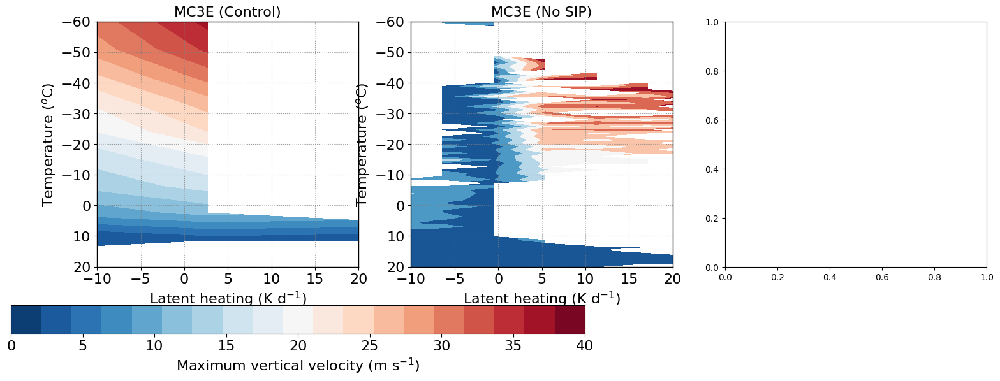

In [39]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.linspace(0, 40, 20)
lev2 = np.arange(0, 40, 20)
lev3 = np.arange(-40, 40, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

cnt1=plt.contourf(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

cnt2=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, cmap='RdBu_r')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[0, 5, 10, 15, 20, 25, 30, 35, 40], orientation='horizontal')
cbar.set_label('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.linspace(-6, 6, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_4sip-wvel_temp_lhr_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


plt.xlim(-10, 20)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (Control minus No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-6, -4, -2, 0, 2, 4, 6], orientation='horizontal')
cbar.set_label('Change in maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [8]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [61]:
ds_4sip.tempc[24,:55,200].values

array([-5.9661163e+01, -6.8620407e+01, -6.8405594e+01, -6.1316605e+01,
       -5.7633484e+01, -5.8770340e+01, -5.9296768e+01, -5.8749985e+01,
       -5.7888809e+01, -5.5188843e+01, -5.1727158e+01, -4.8470551e+01,
       -4.5169830e+01, -4.2358124e+01, -3.9464432e+01, -3.6569839e+01,
       -3.3744080e+01, -3.1119385e+01, -2.8879974e+01, -2.6635254e+01,
       -2.4060257e+01, -2.1311890e+01, -1.8619019e+01, -1.6060181e+01,
       -1.3727112e+01, -1.1733673e+01, -1.0019440e+01, -8.2662964e+00,
       -6.5442810e+00, -5.0096130e+00, -3.6963806e+00, -2.1811829e+00,
       -1.9498596e+00,  2.7862549e-02,  1.0447693e+00,  1.9501343e+00,
        3.7113953e+00,  5.3862610e+00,  7.1075134e+00,  8.7991943e+00,
        9.8801880e+00,  1.1391724e+01,  1.2340027e+01,  1.3778168e+01,
        1.3889252e+01,  1.5172607e+01,  1.6450806e+01,  1.7265411e+01,
        1.8422150e+01,  1.9562744e+01,  1.9418182e+01,  2.0446838e+01,
        1.9441101e+01,  2.0449341e+01,  1.9568024e+01], dtype=float32)

In [42]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def wvel_lhr_ncells_avg(ds, w_var='w_vel', lhr_var='lhr_kperd', height='height', ncells='ncells', time='time'):
    w_mean = ds[w_var][:,:50,:].mean(dim=ncells)
    w_min = ds[w_var][:,:50,:].min(dim=ncells)
    w_max = ds[w_var][:,:50,:].max(dim=ncells)
    lhr_mean = ds[lhr_var][:,:50,:].mean(dim=ncells) 
    lhr_min = ds[lhr_var][:,:50,:].min(dim=ncells)
    lhr_max = ds[lhr_var][:,:50,:].max(dim=ncells)
    return lhr_mean, lhr_min, lhr_max, w_mean, w_min, w_max 


def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err
    

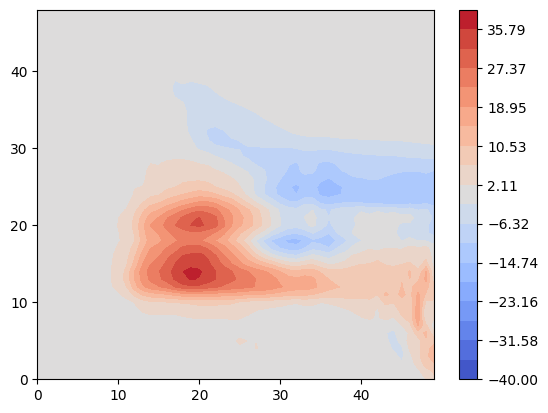

In [48]:

lhr_mean_4sip, lhr_min_4sip, lhr_max_4sip, wvel_mean_4sip, wvel_min_4sip, wvel_max_4sip = wvel_lhr_ncells_avg(ds_4sip)
plt.contourf(lhr_mean_4sip, cmap='coolwarm', levels=np.linspace(-40,40,20))
plt.colorbar()

In [43]:

lhr_mean_4sip, lhr_min_4sip, lhr_max_4sip, wvel_mean_4sip, wvel_min_4sip, wvel_max_4sip = wvel_lhr_ncells_avg(ds_4sip)
lhr_mean_nosip, lhr_min_nosip, lhr_max_nosip, wvel_mean_nosip, wvel_min_nosip, wvel_max_nosip = wvel_lhr_ncells_avg(ds_nosip)

# Flatten to 1D
lhr_mean_4sip = lhr_mean_4sip.values.flatten()
lhr_min_4sip = lhr_min_4sip.values.flatten()
lhr_max_4sip = lhr_max_4sip.values.flatten()
wvel_mean_4sip = wvel_mean_4sip.values.flatten()
wvel_min_4sip = wvel_min_4sip.values.flatten()
wvel_max_4sip = wvel_max_4sip.values.flatten()

lhr_mean_nosip = lhr_mean_nosip.values.flatten()
lhr_min_nosip = lhr_min_nosip.values.flatten()
lhr_max_nosip = lhr_max_nosip.values.flatten()
wvel_mean_nosip = wvel_mean_nosip.values.flatten()
wvel_min_nosip = wvel_min_nosip.values.flatten()
wvel_max_nosip = wvel_max_nosip.values.flatten()


In [44]:
np.max(lhr_mean_4sip)

np.float32(36.82053)

In [45]:

mask_lhr_mean_4sip = (lhr_mean_4sip > -40)
mask_lhr_mean_nosip = (lhr_mean_nosip > -40)

mask_lhr_min_4sip = (lhr_min_4sip > -40)
mask_lhr_min_nosip = (lhr_min_nosip > -40)

lhr_mean_bins = np.linspace(0, np.nanmax([lhr_mean_4sip, lhr_mean_nosip]), 10)  # ~25 bins
lhr_min_bins = np.linspace(0, np.nanmin([lhr_min_4sip, lhr_min_nosip]), 10)

binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_mean_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_mean_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_min_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_min_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_max_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_max_nosip[mask_lhr_mean_nosip], lhr_mean_bins)



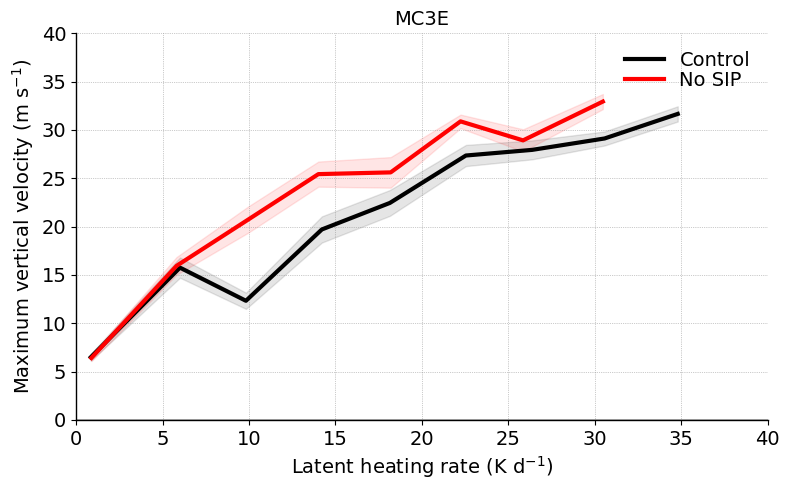

In [55]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


ax.axhline(y=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'W$_{min}$ (Control)')
#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'W$_{min}$ (No SIP)')

#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'W$_{avg}$ (Control)')
#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'W$_{avg}$ (No SIP)')


# Repeat for SW and LW

ax.set_xlim(0, 40)
ax.set_ylim(0, 40)

##ax.set_xticks([0, 4, 8, 12, 16, 20])
#ax.set_yticks([0, 2, 4, 6, 8, 10, 12])
##ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('MC3E', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


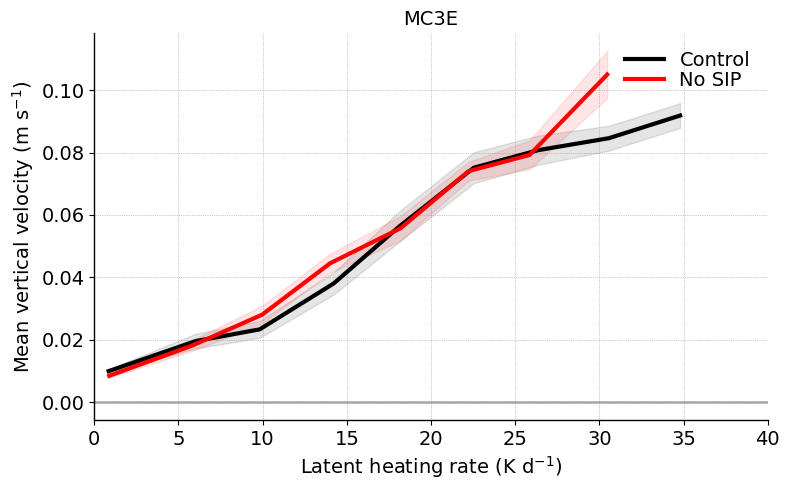

In [51]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


ax.axhline(y=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'Control')
#plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'W$_{min}$ (Control)')
#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'W$_{min}$ (No SIP)')

plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'No SIP')


# Repeat for SW and LW

ax.set_xlim(0, 40)
#ax.set_ylim(0, 40)

##ax.set_xticks([0, 4, 8, 12, 16, 20])
#ax.set_yticks([0, 2, 4, 6, 8, 10, 12])
##ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('MC3E', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


In [ ]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [35]:
ds_4sip.time

<xarray.DataArray 'time' (time: 49)> Size: 392B
array(['2011-05-11T12:00:00.000000000', '2011-05-11T12:30:00.000000000',
       '2011-05-11T13:00:00.000000000', '2011-05-11T13:30:00.000000000',
       '2011-05-11T14:00:00.000000000', '2011-05-11T14:30:00.000000000',
       '2011-05-11T15:00:00.000000000', '2011-05-11T15:30:00.000000000',
       '2011-05-11T16:00:00.000000000', '2011-05-11T16:30:00.000000000',
       '2011-05-11T17:00:00.000000000', '2011-05-11T17:30:00.000000000',
       '2011-05-11T18:00:00.000000000', '2011-05-11T18:30:00.000000000',
       '2011-05-11T19:00:00.000000000', '2011-05-11T19:30:00.000000000',
       '2011-05-11T20:00:00.000000000', '2011-05-11T20:30:00.000000000',
       '2011-05-11T21:00:00.000000000', '2011-05-11T21:30:00.000000000',
       '2011-05-11T22:00:00.000000000', '2011-05-11T22:30:00.000000000',
       '2011-05-11T23:00:00.000000000', '2011-05-11T23:30:00.000000000',
       '2011-05-12T00:00:00.000000000', '2011-05-12T00:30:00.000000000',
       '2011-05-12T01:00:00.000000000', '2011-05-12T01:30:00.000000000',
       '2011-05-12T02:00:00.000000000', '2011-05-12T02:30:00.000000000',
       '2011-05-12T03:00:00.000000000', '2011-05-12T03:30:00.000000000',
       '2011-05-12T04:00:00.000000000', '2011-05-12T04:30:00.000000000',
       '2011-05-12T05:00:00.000000000', '2011-05-12T05:30:00.000000000',
       '2011-05-12T06:00:00.000000000', '2011-05-12T06:30:00.000000000',
       '2011-05-12T07:00:00.000000000', '2011-05-12T07:30:00.000000000',
       '2011-05-12T08:00:00.000000000', '2011-05-12T08:30:00.000000000',
       '2011-05-12T09:00:00.000000000', '2011-05-12T09:30:00.000000000',
       '2011-05-12T10:00:00.000000000', '2011-05-12T10:30:00.000000000',
       '2011-05-12T11:00:00.000000000', '2011-05-12T11:30:00.000000000',
       '2011-05-12T12:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 392B 2011-05-11T12:00:00 ... 2011-05-12T12...
Attributes:
    standard_name:  time
    axis:           T

In [40]:
import numpy as np
from scipy.stats import pearsonr

def calc_lhr_wvel_correlation(lhr_kperd, w_vel):
    time, height, ncells = lhr_kperd.shape
    corr_profile = np.zeros(height)
    for z in range(height):
        lh_flat = lhr_kperd[:, z, :].flatten()
        w_flat = w_vel[:, z, :].flatten()
        mask = ~np.isnan(lh_flat) & ~np.isnan(w_flat)
        if np.sum(mask) > 0:  # this can be higher, arbitrary threshold
            corr_profile[z], _ = pearsonr(lh_flat[mask], w_flat[mask])
        else:
            corr_profile[z] = np.nan
    return corr_profile

stime='2011-05-11T15:00:00.000000000'
etime='2011-05-12T00:00:00.000000000'
ds_4sip_new = ds_4sip.sel(time=slice(stime, etime))
ds_nosip_new = ds_nosip.sel(time=slice(stime, etime))
corr_lhr_wvel_4sip = calc_lhr_wvel_correlation(ds_4sip_new['lhr_kperd'].values, ds_4sip_new['w_vel'].values)
corr_lhr_wvel_nosip = calc_lhr_wvel_correlation(ds_nosip_new['lhr_kperd'].values, ds_nosip_new['w_vel'].values)


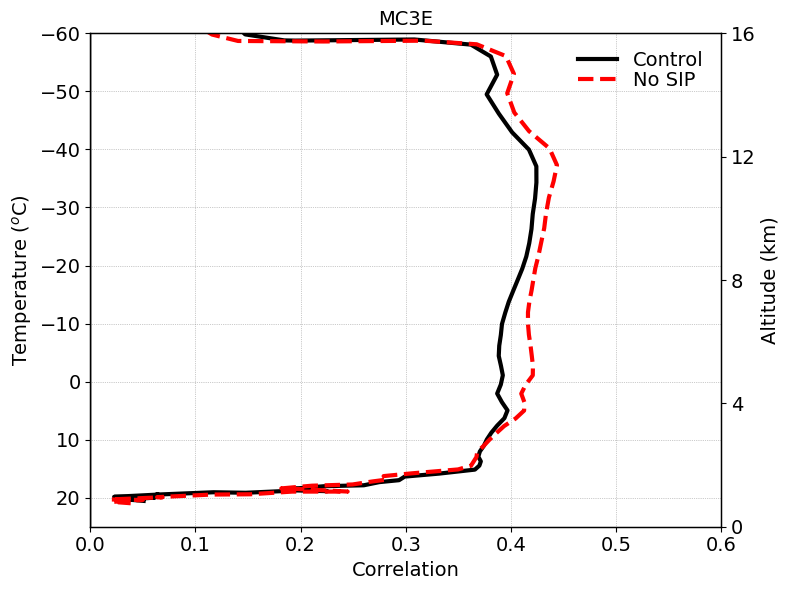

In [41]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(corr_lhr_wvel_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)

plt1.set_xlim(0., 0.6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Correlation', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [20]:
ds_4sip.tempc[20,25,200].values

array(-11.98999, dtype=float32)

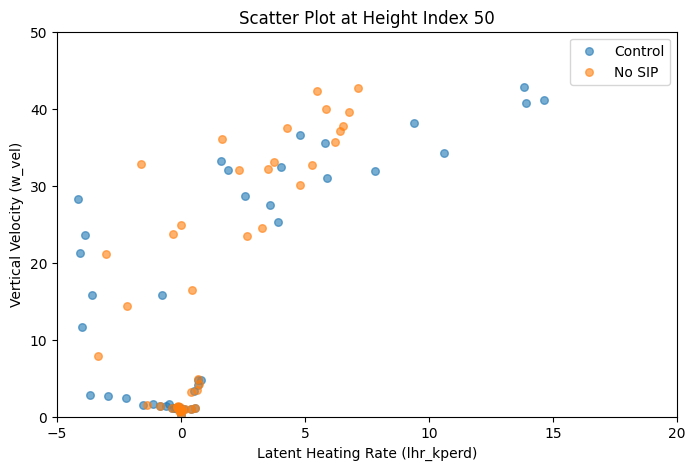

In [28]:
import numpy as np
import matplotlib.pyplot as plt

z_idx = 50  # Example: use height index 10 (choose relevant layer for your case)

# Flatten time and ncells for the selected height
lh_4sip = ds_4sip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_4sip = ds_4sip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()
lh_nosip = ds_nosip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_nosip = ds_nosip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()

# Optional: mask invalid data
mask_4sip = (~np.isnan(lh_4sip)) & (~np.isnan(w_4sip))
mask_nosip = (~np.isnan(lh_nosip)) & (~np.isnan(w_nosip))

plt.figure(figsize=(8, 5))
plt.scatter(lh_4sip[mask_4sip], w_4sip[mask_4sip], s=30, alpha=0.6, label='Control')
plt.scatter(lh_nosip[mask_nosip], w_nosip[mask_nosip], s=30, alpha=0.6, label='No SIP')

plt.xlim(-5,20)
plt.ylim(0,50)
plt.xlabel('Latent Heating Rate (lhr_kperd)')
plt.ylabel('Vertical Velocity (w_vel)')
plt.title('Scatter Plot at Height Index {}'.format(z_idx))
plt.legend()
plt.show()


In [29]:
from sklearn.linear_model import LinearRegression

def fit_slope(x, y):
    mask = (~np.isnan(x)) & (~np.isnan(y))
    x_ = x[mask].reshape(-1, 1)
    y_ = y[mask]
    model = LinearRegression()
    model.fit(x_, y_)
    slope = model.coef_[0]
    intercept = model.intercept_
    r2 = model.score(x_, y_)
    return slope, intercept, r2

slope_4sip, intercept_4sip, r2_4sip = fit_slope(lh_4sip, w_4sip)
slope_nosip, intercept_nosip, r2_nosip = fit_slope(lh_nosip, w_nosip)

print(f"SIP run:    Slope = {slope_4sip:.4f},  Intercept = {intercept_4sip:.4f},  R² = {r2_4sip:.3f}")
print(f"No SIP run: Slope = {slope_nosip:.4f},  Intercept = {intercept_nosip:.4f},  R² = {r2_nosip:.3f}")


SIP run:    Slope = 2.3461,  Intercept = 10.3017,  R² = 0.507
No SIP run: Slope = 4.5138,  Intercept = 8.9324,  R² = 0.586


In [32]:

lhr_4sip = ds_4sip['lhr_kperd'].values 
wvel_4sip = ds_4sip['w_vel'].values
ntime, nheight, ncells = lhr_4sip.shape

corr_lhr_wvel_4sip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_4sip[t, z, :].flatten()
        w_flat = wvel_4sip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_4sip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



lhr_nosip = ds_nosip['lhr_kperd'].values 
wvel_nosip = ds_nosip['w_vel'].values
ntime, nheight, ncells = lhr_nosip.shape

corr_lhr_wvel_nosip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_nosip[t, z, :].flatten()
        w_flat = wvel_nosip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_nosip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



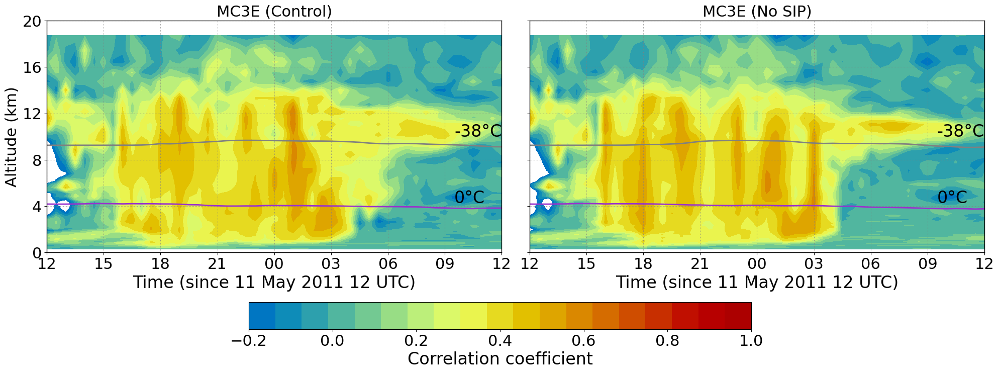

In [34]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-0.2, 1, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 10.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt+2)

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('MC3E (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contour_levels = np.linspace(1, 1200, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-0.2, 0, 0.2, 0.4, 0.6, 0.8, 1], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Correlation coefficient', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


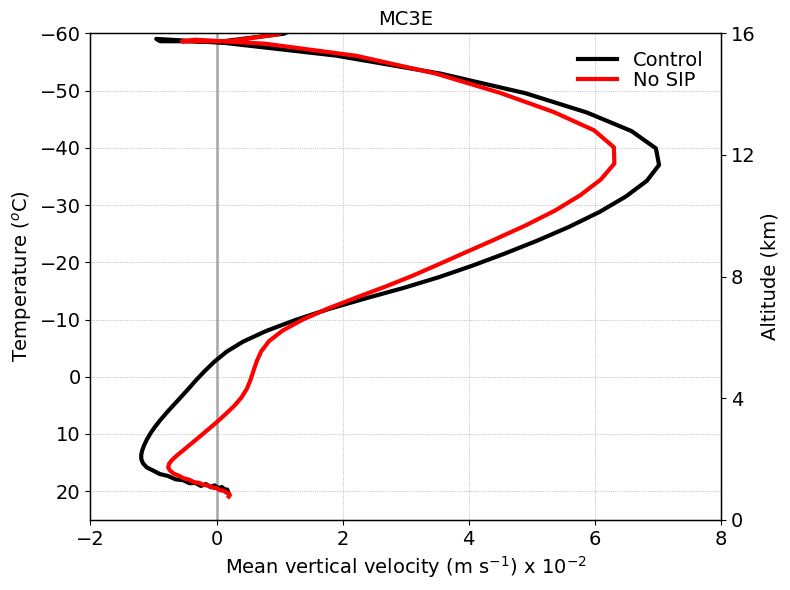

In [57]:

stime='2011-05-11T15:00:00.000000000'
etime='2011-05-12T00:00:00.000000000'

filt_wvel_4sip = ds_4sip.w_vel.sel(time=slice(stime, etime))
filt_wvel_nosip = ds_nosip.w_vel.sel(time=slice(stime, etime))

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*filt_wvel_4sip.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(fac*filt_wvel_nosip.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-2, 8)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


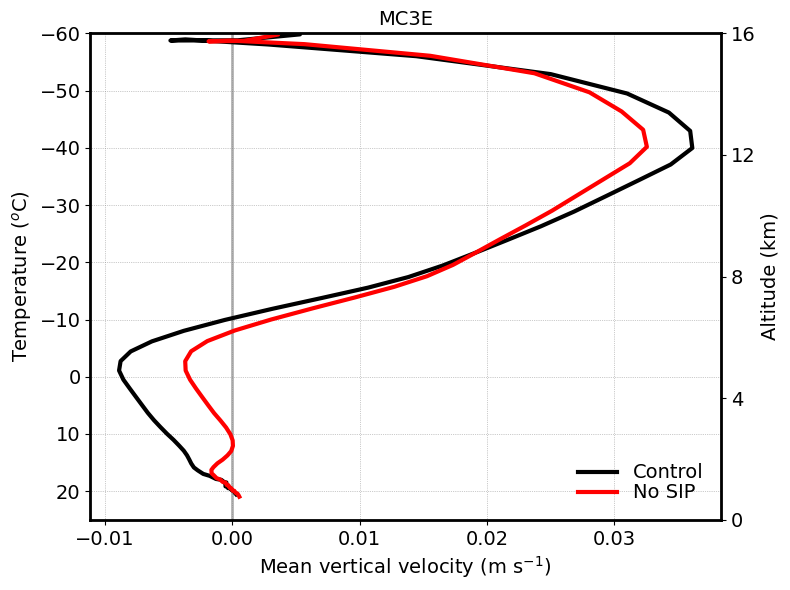

In [9]:

stime='2011-05-11T12:00:00.000000000'
etime='2011-05-12T12:00:00.000000000'

filt_wvel_4sip = ds_4sip.w_vel.sel(time=slice(stime, etime))
filt_wvel_nosip = ds_nosip.w_vel.sel(time=slice(stime, etime))

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(filt_wvel_4sip.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(filt_wvel_nosip.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-2., 3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


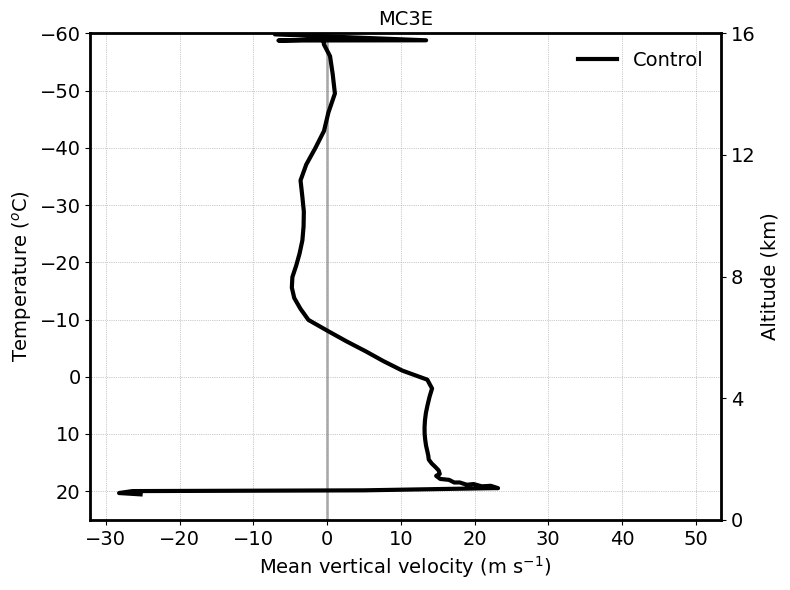

In [53]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(100*(ds_4sip.w_vel.max(dim=('time','ncells'))-ds_nosip.w_vel.max(dim=('time','ncells')))/ds_4sip.w_vel.max(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-2., 3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [27]:
ds_4sip.ddt_temp_radsw

<xarray.DataArray 'ddt_temp_radsw' (time: 49, height: 65, ncells: 63456)> Size: 808MB
dask.array<concatenate, shape=(49, 65, 63456), dtype=float32, chunksize=(1, 65, 63456), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 392B 2011-05-11T12:00:00 ... 2011-05-12T12...
    clon     (ncells) float64 508kB dask.array<chunksize=(63456,), meta=np.ndarray>
    clat     (ncells) float64 508kB dask.array<chunksize=(63456,), meta=np.ndarray>
  * height   (height) float64 520B 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
Dimensions without coordinates: ncells
Attributes:
    standard_name:                ddt_temp_radsw
    long_name:                    short wave radiative temperature tendency
    units:                        K s-1
    param:                        192.4.0
    CDI_grid_type:                unstructured
    number_of_grid_in_reference:  1

## Radiative heating rates

In [31]:

# Radiative heating rate with SIP

dims1 = ds_4sip.tempc.dims
dims2 = ds_4sip.tempc.mean(dim=('time','ncells')).dims
temp_radsw_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.ddt_temp_radsw, axis=0) # w.r.t. time
temp_radsw_kperd_4sip = temp_radsw_kpers_4sip * 86400.
mean_temp_radsw_kperd_4sip = np.mean(temp_radsw_kperd_4sip, axis=(0,2))
ds_4sip['temp_radsw_kpers'] = (dims1, temp_radsw_kpers_4sip)
ds_4sip['temp_radsw_kperd'] = (dims1, temp_radsw_kperd_4sip)

dims1 = ds_4sip.tempc.dims
dims2 = ds_4sip.tempc.mean(dim=('time','ncells')).dims
temp_radlw_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.ddt_temp_radlw, axis=0) # w.r.t. time
temp_radlw_kperd_4sip = temp_radlw_kpers_4sip * 86400.
mean_temp_radlw_kperd_4sip = np.mean(temp_radlw_kperd_4sip, axis=(0,2))
ds_4sip['temp_radlw_kpers'] = (dims1, temp_radlw_kpers_4sip)
ds_4sip['temp_radlw_kperd'] = (dims1, temp_radlw_kperd_4sip)

ds_4sip['tot_radhet_kperd'] = ds_4sip.temp_radsw_kperd+ds_4sip.temp_radlw_kperd
ds_4sip['tot_radhet_kpers'] = ds_4sip.temp_radsw_kpers+ds_4sip.temp_radlw_kpers

# Radiative heating rate with No SIP

dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
temp_radsw_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.ddt_temp_radsw, axis=0) # w.r.t. time
temp_radsw_kperd_nosip = temp_radsw_kpers_nosip * 86400.
mean_temp_radsw_kperd_nosip = np.mean(temp_radsw_kperd_nosip, axis=(0,2))
ds_nosip['temp_radsw_kpers'] = (dims1, temp_radsw_kpers_nosip)
ds_nosip['temp_radsw_kperd'] = (dims1, temp_radsw_kperd_nosip)

dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
temp_radlw_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.ddt_temp_radlw, axis=0) # w.r.t. time
temp_radlw_kperd_nosip = temp_radlw_kpers_nosip * 86400.
mean_temp_radlw_kperd_nosip = np.mean(temp_radlw_kperd_nosip, axis=(0,2))
ds_nosip['temp_radlw_kpers'] = (dims1, temp_radlw_kpers_nosip)
ds_nosip['temp_radlw_kperd'] = (dims1, temp_radlw_kperd_nosip)

ds_nosip['tot_radheat_kperd'] = ds_nosip.temp_radsw_kperd+ds_nosip.temp_radlw_kperd
ds_nosip['tot_radheat_kpers'] = ds_nosip.temp_radsw_kpers+ds_nosip.temp_radlw_kpers


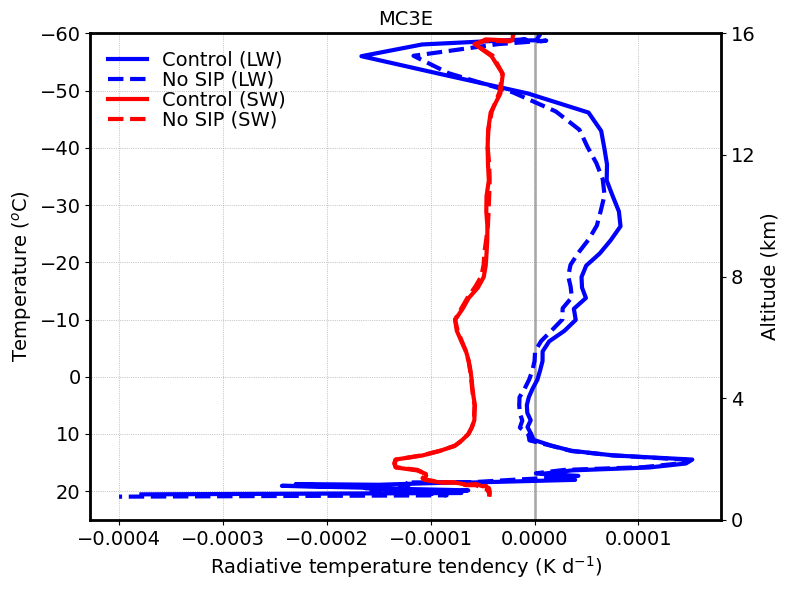

In [35]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.temp_radlw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Control (LW)')
plt1.plot(ds_nosip.temp_radlw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='No SIP (LW)')
plt1.plot(ds_4sip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Control (SW)')
plt1.plot(ds_nosip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP (SW)')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Radiative temperature tendency (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('MC3E', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Standardised regression coefficient

#### A standardized regression coefficient tells How many standard deviations the target variable (y, here TOA net flux)
#### changes for one standard deviation change in the predictor (x_i), holding other variables constant.

In [18]:
from sklearn.ensemble import RandomForestRegressor  # ✅ Required import
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set TOA index
toa_idx = 0

# Extract variables without collapsing time/ncells — preserve data points
clcl_4sip = ds_4sip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_4sip = ds_4sip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_4sip = ds_4sip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_4sip = ds_4sip['clct'].sel(time=slice(start_time, end_time))                                  # (time, ncells)
qc_4sip = ds_4sip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_4sip = ds_4sip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_4sip = ds_4sip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

clcl_nosip = ds_nosip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_nosip = ds_nosip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_nosip = ds_nosip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_nosip = ds_nosip['clct'].sel(time=slice(start_time, end_time))                                   # (time, ncells)
qc_nosip = ds_nosip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_nosip = ds_nosip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_nosip = ds_nosip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

# Compute TOA net flux
net_flux_4sip = (
    (ds_4sip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_4sip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

net_flux_nosip = (
    (ds_nosip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_nosip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

# Build dataframe (flatten all variables)
df_4sip = pd.DataFrame({
    'clcl': clcl_4sip.values.flatten(),
    'clcm': clcm_4sip.values.flatten(),
    'clch': clch_4sip.values.flatten(),
    'clct': clct_4sip.values.flatten(),
    'qc': qc_4sip.values.flatten(),
    'qi': qi_4sip.values.flatten(),
    'qs': qs_4sip.values.flatten(),
    'net_flux': net_flux_4sip.values.flatten()
})

df_nosip = pd.DataFrame({
    'clcl': clcl_nosip.values.flatten(),
    'clcm': clcm_nosip.values.flatten(),
    'clch': clch_nosip.values.flatten(),
    'clct': clct_nosip.values.flatten(),
    'qc': qc_nosip.values.flatten(),
    'qi': qi_nosip.values.flatten(),
    'qs': qs_nosip.values.flatten(),
    'net_flux': net_flux_nosip.values.flatten()
})

# Drop missing values
df_4sip = df_4sip.dropna()
df_nosip = df_nosip.dropna()

# Prepare X and y for regression
X_4sip = df_4sip.drop('net_flux', axis=1).values
y_4sip = df_4sip['net_flux'].values

X_nosip = df_nosip.drop('net_flux', axis=1).values
y_nosip = df_nosip['net_flux'].values

# Standardize predictors
scaler_4sip = StandardScaler()
X_4sip_scaled = scaler_4sip.fit_transform(X_4sip)

scaler_nosip = StandardScaler()
X_nosip_scaled = scaler_nosip.fit_transform(X_nosip)

# Fit regression model
model_4sip = LinearRegression()
model_4sip.fit(X_4sip_scaled, y_4sip)

model_nosip = LinearRegression()
model_nosip.fit(X_nosip_scaled, y_nosip)

# Plot standardized coefficients
coefs_4sip = model_4sip.coef_
features_4sip = df_4sip.drop('net_flux', axis=1).columns

coefs_nosip = model_nosip.coef_
features_nosip = df_nosip.drop('net_flux', axis=1).columns



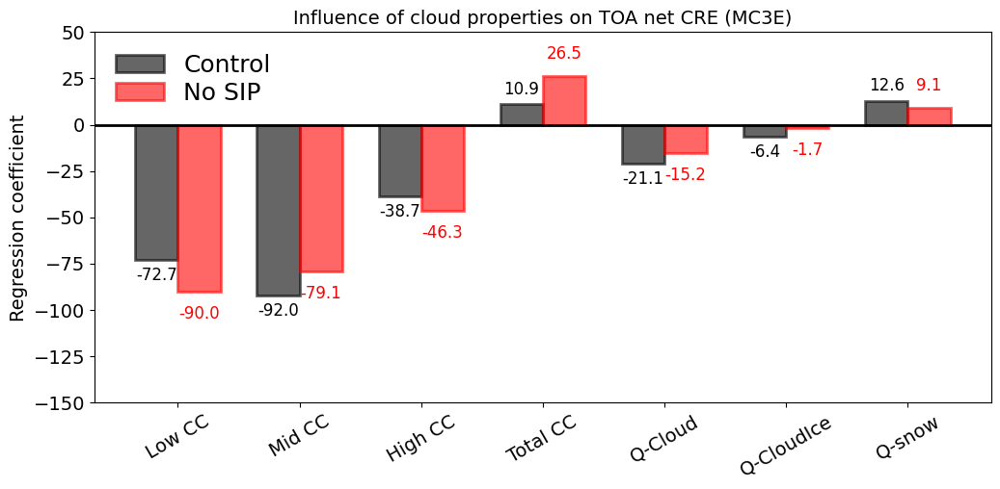

In [23]:

comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-CloudIce', 'Q-snow']

x_feature = np.arange(len(features_4sip))  # base x locations
width = 0.35

fnt=14;
ln=2;

fig, ax = plt.subplots(figsize=(12, 5))#, sharey=False)
plt.style.use('default')

#ax1 = axs[0]

ax.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax.bar(x_feature - width/2, coefs_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax.bar(x_feature + width/2, coefs_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax.bar_label(rects2, padding=10, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax.set_ylim(-150, 50)
ax.set_ylabel('Regression coefficient', fontsize=fnt)
ax.set_xticks(x_feature)
ax.set_xticklabels(comp_groups, rotation=30)
ax.set_title('Influence of cloud properties on TOA net CRE (MC3E)', fontsize=fnt)
ax.tick_params(axis='both', labelsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=1, fontsize=fnt+4, loc='best')

plt.show()

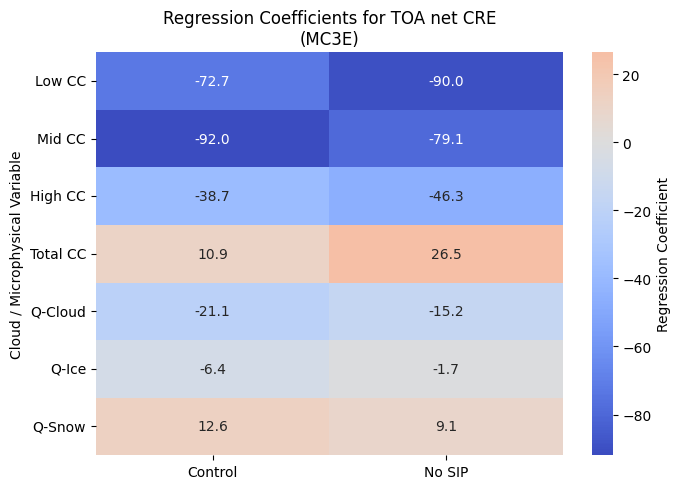

In [24]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Example coefficients
features = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-Ice', 'Q-Snow']


# Create DataFrame for heatmap
df_heat = pd.DataFrame({
    'Control': coefs_4sip,
    'No SIP': coefs_nosip
}, index=features)

# Plot heatmap
plt.figure(figsize=(7, 5))
sns.heatmap(df_heat, annot=True, cmap='coolwarm', center=0, fmt='.1f',
            cbar_kws={'label': 'Regression Coefficient'})

plt.title('Regression Coefficients for TOA net CRE\n(MC3E)')
plt.ylabel('Cloud / Microphysical Variable')
plt.tight_layout()
plt.show()


## Bar plots

In [1]:


start_time = '2011-05-11T15:00:00.000000000'
end_time = '2011-05-12T05:00:00.000000000'

w_vel_4sip = ds_4sip.w_vel.sel(time=slice(start_time, end_time)).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice(start_time, end_time)).values.flatten()

w_bin = (-40, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80)
hist_counts_wvel_4sip, _ = np.histogram(w_vel_4sip, bins=w_bin)
hist_counts_wvel_nosip, _ = np.histogram(w_vel_nosip, bins=w_bin)


lhr_4sip = ds_4sip.lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
lhr_nosip = ds_nosip.lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

#lhr_bin = (-60, -50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80)

lhr_bin = (-60, -50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60)

hist_counts_lhr_4sip, _ = np.histogram(lhr_4sip, bins=lhr_bin)
hist_counts_lhr_nosip, _ = np.histogram(lhr_nosip, bins=lhr_bin)

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip


NameError: name 'ds_4sip' is not defined

In [ ]:

hist_norm_wvel_4sip = hist_counts_wvel_4sip / np.sum(hist_counts_wvel_4sip)
hist_norm_wvel_nosip = hist_counts_wvel_nosip / np.sum(hist_counts_wvel_nosip)
per_hist_count_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip)/hist_counts_wvel_4sip
per_hist_norm_wvel_nosip = 100*(hist_norm_wvel_4sip-hist_norm_wvel_nosip)/hist_norm_wvel_4sip

hist_counts_wvel_4sip_safe = np.where(hist_counts_wvel_4sip == 0, np.nan, hist_counts_wvel_4sip)
hist_ratio_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip) / hist_counts_wvel_4sip#_safe
hist_norm_diff_wvel_nosip = hist_norm_wvel_4sip-hist_norm_wvel_nosip

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_norm_lhr_nosip = 100*(hist_norm_lhr_4sip-hist_norm_lhr_nosip)/hist_norm_lhr_4sip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip

fnt=24;
ln=4;

fig, axs = plt.subplots(1, 2, figsize=(30, 8), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# ⬅️ Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]
ax1.bar(lhr_bin[:-1], hist_counts_lhr_4sip, width=6, align='center',
        edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax1.bar(lhr_bin[:-1], hist_counts_lhr_nosip, width=4., align='center',
        edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax1b = ax1.twinx()
ax1b.bar(lhr_bin[:-1], per_hist_count_lhr_nosip, width=3., align='center',
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax1b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax1.set_xlim(-40, 40)
ax1.set_yscale('log')
ax1.set_ylim(1e0, 1e8)
ax1.set_xticks([-40, -30, -20, -10, 0, 10, 20, 30, 40])
ax1.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax1.set_ylabel('Frequency', fontsize=fnt)

#ax1b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax1b.set_ylim(-20, 100)
#ax1b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax1b.set_yticklabels([])

ax1.set_title('Latent heating (MC3E)', fontsize=fnt)


# Grid, ticks
ax1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
ax1.tick_params(axis='both', labelsize=fnt)
ax1b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax1b.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper right', ncols=1)

for x, y in zip(lhr_bin[:-1], per_hist_count_lhr_nosip):
    if not np.isnan(y):
        #ax1b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt, color='b')
        ax1b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')
        
# ---------------------------------------------
# ➡️ Subplot 2: Vertical velocity (w)
# ---------------------------------------------
ax2 = axs[1]
ax2.bar(w_bin[:-1], hist_counts_wvel_4sip, width=4, align='center', edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax2.bar(w_bin[:-1], hist_counts_wvel_nosip, width=3., align='center', edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax2b = ax2.twinx()
ax2b.bar(w_bin[:-1], per_hist_count_wvel_nosip, width=2.5, align='center', 
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax2b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax2.set_xlim(-15, 35)
ax2.set_xticks([-15, -10., -5, 0, 5, 10, 15, 20, 25, 30, 35])
ax2.set_yscale('log')
ax2.set_ylim(1e0, 1e8)
ax2.set_xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax2.set_ylabel('Frequency', fontsize=fnt)

#ax2b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax2b.set_ylim(-20, 100)
#ax2b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax2b.set_yticklabels([])

ax2.set_title('Vertical velocity (MC3E)', fontsize=fnt)

# Grid, ticks
ax2.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
ax2.tick_params(axis='both', labelsize=fnt+2)
ax2b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax2.get_legend_handles_labels()
lines2, labels2 = ax2b.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')


for x, y in zip(w_bin[:-1], per_hist_count_wvel_nosip):
    if not np.isnan(y):
        #ax2b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt-2, color='b')
        ax2b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')

        
# Layout
plt.tight_layout()
plt.show()


## Time series

In [ ]:

# Control
mask = (ds_4sip.tempc >= -38.) & (ds_4sip.tempc <= 0.) & (ds_4sip.lhr_kperd != 0)

masked_lhr_4sip = ds_4sip.lhr_kperd.where(mask.compute(), drop=True)
tot_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.satad_lhr_kperd.where(mask.compute(), drop=True)
satad_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.dep_lhr_kperd.where(mask.compute(), drop=True)
dep_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.rime_lhr_kperd.where(mask.compute(), drop=True)
rime_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.where(mask.compute(), drop=True)
rainfreez_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

# No SIP
mask = (ds_nosip.tempc >= -38.) & (ds_nosip.tempc <= 0.) & (ds_nosip.lhr_kperd != 0)

masked_lhr_nosip = ds_nosip.lhr_kperd.where(mask.compute(), drop=True)
tot_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.satad_lhr_kperd.where(mask.compute(), drop=True)
satad_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.dep_lhr_kperd.where(mask.compute(), drop=True)
dep_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.rime_lhr_kperd.where(mask.compute(), drop=True)
rime_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.where(mask.compute(), drop=True)
rainfreez_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))


In [ ]:

ln=2
fnt=14

plt.figure(figsize=(10, 5))

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, tot_lhr_mp_4sip, 'k-', linewidth=ln+2, label='Control (Total)')
plt.plot(ds_4sip.time, satad_lhr_mp_4sip, 'k--', linewidth=ln, label='Control (Condensation)')
plt.plot(ds_4sip.time, dep_lhr_mp_4sip, 'k-.', linewidth=ln, label='Control (Deposition)')
plt.plot(ds_4sip.time, rime_lhr_mp_4sip, 'k:', linewidth=ln, label='Control (Riming)')

plt.plot(ds_nosip.time, tot_lhr_mp_nosip, 'r-', linewidth=ln+2, label='No SIP (Total)')
plt.plot(ds_nosip.time, satad_lhr_mp_nosip, 'r--', linewidth=ln, label='No SIP (Condensation)')
plt.plot(ds_nosip.time, dep_lhr_mp_nosip, 'r-.', linewidth=ln, label='No SIP (Deposition)')
plt.plot(ds_nosip.time, rime_lhr_mp_nosip, 'r:', linewidth=ln, label='No SIP (Riming)')

plt.xlabel('Time (since 11 May 2012 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2012, 5, 11, 12, 0) 
end_date = datetime(2012, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(-20,40)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)#, fontweight='bold')
plt.title('Domain averaged latent heating [0 and -38°C, MC3E]', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=3, labelspacing=0.2, fontsize=fnt, ncols=1, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [ ]:

start_time = '2011-05-11T15:00:00.000000000'
end_time = '2011-05-12T05:00:00.000000000'

lhr_4sip = ds_4sip.lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
lhr_nosip = ds_nosip.lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

cond_lhr_4sip = ds_4sip.cond_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
cond_lhr_nosip = ds_nosip.cond_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

satad_lhr_4sip = ds_4sip.satad_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
satad_lhr_nosip = ds_nosip.satad_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

dep_lhr_4sip = ds_4sip.dep_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
dep_lhr_nosip = ds_nosip.dep_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

rime_lhr_4sip = ds_4sip.rime_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
rime_lhr_nosip = ds_nosip.rime_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

melt_lhr_4sip = ds_4sip.melt_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
melt_lhr_nosip = ds_nosip.melt_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

evap_lhr_4sip = ds_4sip.evap_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()
evap_lhr_nosip = ds_nosip.evap_lhr_kperd.sel(time=slice(start_time, end_time)).values.flatten()

melt_evap_lhr_4sip = melt_lhr_4sip+evap_lhr_4sip
melt_evap_lhr_nosip = melt_lhr_nosip+evap_lhr_nosip


In [ ]:

mask_nonzero_4sip = (lhr_4sip != 0.)
mask_nonzero_nosip = (lhr_nosip != 0.)

mask_pos_4sip = (lhr_4sip > 0.)
mask_pos_nosip = (lhr_nosip > 0.)

mask_neg_4sip = (lhr_4sip < 0.)
mask_neg_nosip = (lhr_nosip < 0.)

## Total 
mean_tot_lhr_4sip = np.nanmean(lhr_4sip[mask_nonzero_4sip])
mean_tot_lhr_nosip = np.nanmean(lhr_nosip[mask_nonzero_nosip])

pos_lhr = lhr_4sip[mask_pos_4sip]
neg_lhr = lhr_4sip[mask_neg_4sip]
mean_tot_lhr_pos_4sip=np.nanmean(pos_lhr)
mean_tot_lhr_neg_4sip=np.nanmean(neg_lhr)

pos_lhr = lhr_nosip[mask_pos_nosip]
neg_lhr = lhr_nosip[mask_neg_nosip]
mean_tot_lhr_pos_nosip=np.nanmean(pos_lhr)
mean_tot_lhr_neg_nosip=np.nanmean(neg_lhr)

## CCN activation
mean_cond_lhr_4sip = np.nanmean(cond_lhr_4sip[mask_nonzero_4sip])
mean_cond_lhr_nosip = np.nanmean(cond_lhr_nosip[mask_nonzero_nosip])

pos_lhr = cond_lhr_4sip[mask_pos_4sip]
neg_lhr = cond_lhr_4sip[mask_neg_4sip]
mean_cond_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_cond_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = cond_lhr_nosip[mask_pos_nosip]
neg_lhr = cond_lhr_nosip[mask_neg_nosip]
mean_cond_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_cond_neg_lhr_nosip = np.nanmean(neg_lhr)

## Deposition
mean_dep_lhr_4sip = np.nanmean(dep_lhr_4sip[mask_nonzero_4sip])
mean_dep_lhr_nosip = np.nanmean(dep_lhr_nosip[mask_nonzero_nosip])

pos_lhr = dep_lhr_4sip[mask_pos_4sip]
neg_lhr = dep_lhr_4sip[mask_neg_4sip]
mean_dep_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_dep_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = dep_lhr_nosip[mask_pos_nosip]
neg_lhr = dep_lhr_4sip[mask_neg_nosip]
mean_dep_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_dep_neg_lhr_nosip = np.nanmean(neg_lhr)

## Condensation
mean_satad_lhr_4sip = np.nanmean(satad_lhr_4sip[mask_nonzero_4sip])
mean_satad_lhr_nosip = np.nanmean(satad_lhr_nosip[mask_nonzero_nosip])

pos_lhr = satad_lhr_4sip[mask_pos_4sip]
neg_lhr = satad_lhr_4sip[mask_neg_4sip]
mean_satad_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_satad_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = satad_lhr_nosip[mask_pos_nosip]
neg_lhr = satad_lhr_nosip[mask_neg_nosip]
mean_satad_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_satad_neg_lhr_nosip = np.nanmean(neg_lhr)

## Riming
mean_rime_lhr_4sip = np.nanmean(rime_lhr_4sip[mask_nonzero_4sip])
mean_rime_lhr_nosip = np.nanmean(rime_lhr_nosip[mask_nonzero_nosip])

pos_lhr = rime_lhr_4sip[mask_pos_4sip]
neg_lhr = rime_lhr_4sip[mask_neg_4sip]
mean_rime_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_rime_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = rime_lhr_nosip[mask_pos_nosip]
neg_lhr = rime_lhr_nosip[mask_neg_nosip]
mean_rime_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_rime_neg_lhr_nosip = np.nanmean(neg_lhr)

## Rainfreez
mean_rainfreez_lhr_4sip = np.nanmean(rainfreez_lhr_4sip[mask_nonzero_4sip])
mean_rainfreez_lhr_nosip = np.nanmean(rainfreez_lhr_nosip[mask_nonzero_nosip])

pos_lhr = rainfreez_lhr_4sip[mask_pos_4sip]
neg_lhr = rainfreez_lhr_4sip[mask_neg_4sip]
mean_rainfreez_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_rainfreez_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = rainfreez_lhr_nosip[mask_pos_nosip]
neg_lhr = rainfreez_lhr_nosip[mask_neg_nosip]
mean_rainfreez_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_rainfreez_neg_lhr_nosip = np.nanmean(neg_lhr)

## Homhet
mean_homhet_lhr_4sip = np.nanmean(homhet_lhr_4sip[mask_nonzero_4sip])
mean_homhet_lhr_nosip = np.nanmean(homhet_lhr_nosip[mask_nonzero_nosip])

pos_lhr = homhet_lhr_4sip[mask_pos_4sip]
neg_lhr = homhet_lhr_4sip[mask_neg_4sip]
mean_homhet_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_homhet_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = homhet_lhr_nosip[mask_pos_nosip]
neg_lhr = homhet_lhr_nosip[mask_neg_nosip]
mean_homhet_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_homhet_neg_lhr_nosip = np.nanmean(neg_lhr)

## Melting+evaporation
mean_melt_evap_lhr_4sip = np.nanmean(melt_evap_lhr_4sip[mask_nonzero_4sip])
mean_melt_evap_lhr_nosip = np.nanmean(melt_evap_lhr_nosip[mask_nonzero_nosip])

pos_lhr = melt_evap_lhr_4sip[mask_pos_4sip]
neg_lhr = melt_evap_lhr_4sip[mask_neg_4sip]
mean_melt_evap_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_melt_evap_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = melt_evap_lhr_nosip[mask_pos_nosip]
neg_lhr = melt_evap_lhr_nosip[mask_neg_nosip]
mean_melt_evap_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_melt_evap_neg_lhr_nosip = np.nanmean(neg_lhr)

In [ ]:

mean_all_lhr_comp_4sip = [mean_tot_lhr_4sip, mean_satad_lhr_4sip, mean_dep_lhr_4sip, mean_rime_lhr_4sip, 
                             mean_melt_evap_lhr_4sip]#, mean_cond_lhr_4sip, mean_rainfreez_lhr_4sip, mean_homhet_lhr_4sip]
mean_all_lhr_comp_nosip = [mean_tot_lhr_nosip, mean_satad_lhr_nosip, mean_dep_lhr_nosip, mean_rime_lhr_nosip, 
                              mean_melt_evap_lhr_nosip]#, mean_cond_lhr_nosip, mean_rainfreez_lhr_nosip, mean_homhet_lhr_nosip]

mean_wvel_4sip = np.nanmean(w_vel_4sip)
mean_wvel_nosip = np.nanmean(w_vel_nosip)

mean_wvel_up_4sip = np.nanmean(w_vel_4sip[w_vel_4sip > 0.])
mean_wvel_dn_4sip = np.nanmean(w_vel_4sip[w_vel_4sip < 0.])
mean_wvel_up_nosip = np.nanmean(w_vel_nosip[w_vel_nosip > 0.])
mean_wvel_dn_nosip = np.nanmean(w_vel_nosip[w_vel_nosip < 0.])

groups = ['Updraft', 'Downdraft']

values_wvel_4sip = [mean_wvel_up_4sip, mean_wvel_dn_4sip]
values_wvel_nosip = [mean_wvel_up_nosip, mean_wvel_dn_nosip]

fnt=20;
ln=3;
alp=0.6


lhr_comp_groups = ['Total', 'Condensation', 'Deposition', 'Rime', 'Melt+Evap']#, 'CCN activation', 'Rainfreez', 'Hom+Het']
wvel_groups = ['Updraft', 'Downdraft']
x_lhr = np.arange(len(lhr_comp_groups))  # the label locations
x_wvel = np.arange(len(wvel_groups))  # the label locations

width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_lhr - width/2, mean_all_lhr_comp_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_lhr + width/2, mean_all_lhr_comp_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=12, color='k', fontsize=fnt-2, fmt='%.2f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.2f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
#ax1.set_ylim(-6,6)
ax1.set_ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)
ax1.set_xticks(x_lhr)
ax1.set_xticklabels(lhr_comp_groups, rotation=20)
ax1.set_title('Mean of latent heating (MC3E)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')

        
# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]
ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_wvel - width/2, values_wvel_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_wvel + width/2, values_wvel_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=3, fontsize=fnt, fmt='%.2f')
ax2.bar_label(rects2, padding=3, fontsize=fnt, fmt='%.2f')

# Customization
#ax2.set_ylim(-0.3,0.3)
ax2.set_ylabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax2.set_xticks(x_wvel)
ax2.set_xticklabels(wvel_groups)
ax2.set_title('Domain averaged vertical velocity (MC3E)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)
plt.grid(False)#axis='both', linewidth=ln-1.5, linestyle='-', color='k', alpha=0.7)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')

#plt.tight_layout()
plt.show()


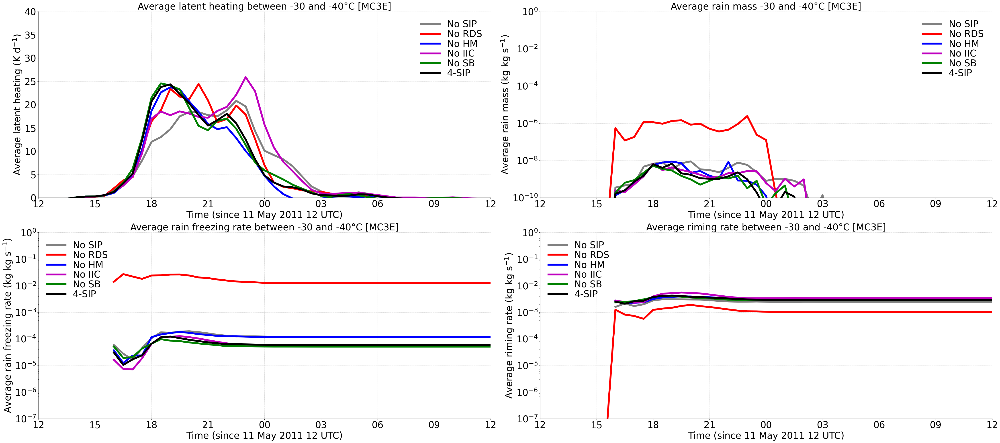

In [29]:

thres_q = 1.e-8;

## Latent heating
mean_lhr_min35_nosip = ds_nosip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_lhr_min35_4sip = ds_4sip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_norf = ds_norf.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nohm = ds_nohm.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nobr = ds_nobr.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nosb = ds_nosb.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Rain mass
mean_qr_min35_nosip = ds_nosip.qr.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_qr_min35_4sip = ds_4sip.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_norf = ds_norf.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nohm = ds_nohm.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nobr = ds_nobr.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nosb = ds_nosb.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Riming rate
mean_dq_tot_rime_min35_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

## Rain freezing rate
sum_dq = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_min35_4sip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_min35_nosip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_min35_norf = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_min35_nohm = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_min35_nobr = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf
mean_dq_rainfreez_min35_nosb = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))


plt.figure(figsize=(45, 20))

lnwdth=6
fontsize=30

plt.subplot(2,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_lhr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_lhr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_lhr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_lhr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_lhr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_lhr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,40)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average latent heating (K d$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average latent heating between -30 and -40°C [MC3E]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_qr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_qr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_qr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_qr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_qr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_qr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-10,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain mass (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain mass -30 and -40°C [MC3E]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,3)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_rainfreez_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_rainfreez_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_rainfreez_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_rainfreez_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_rainfreez_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_rainfreez_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain freezing rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain freezing rate between -30 and -40°C [MC3E]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)




plt.subplot(2,2,4)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_tot_rime_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_tot_rime_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_tot_rime_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_tot_rime_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_tot_rime_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_tot_rime_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average riming rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average riming rate between -30 and -40°C [MC3E]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [12]:

mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.2) & (ds_4sip.tempc < -38.)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.2) & (ds_nosip.tempc < -38.)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_norf.tempc > -0.2) & (ds_norf.tempc < 0.)
mean_freez_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_norf.tempc > -38.2) & (ds_norf.tempc < -38.)
mean_hom_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nohm.tempc > -0.2) & (ds_nohm.tempc < 0.)
mean_freez_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nohm.tempc > -38.2) & (ds_nohm.tempc < -38.)
mean_hom_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nobr.tempc > -0.2) & (ds_nobr.tempc < 0.)
mean_freez_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nobr.tempc > -38.2) & (ds_nobr.tempc < -38.)
mean_hom_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosb.tempc > -0.2) & (ds_nosb.tempc < 0.)
mean_freez_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosb.tempc > -38.2) & (ds_nosb.tempc < -38.)
mean_hom_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))



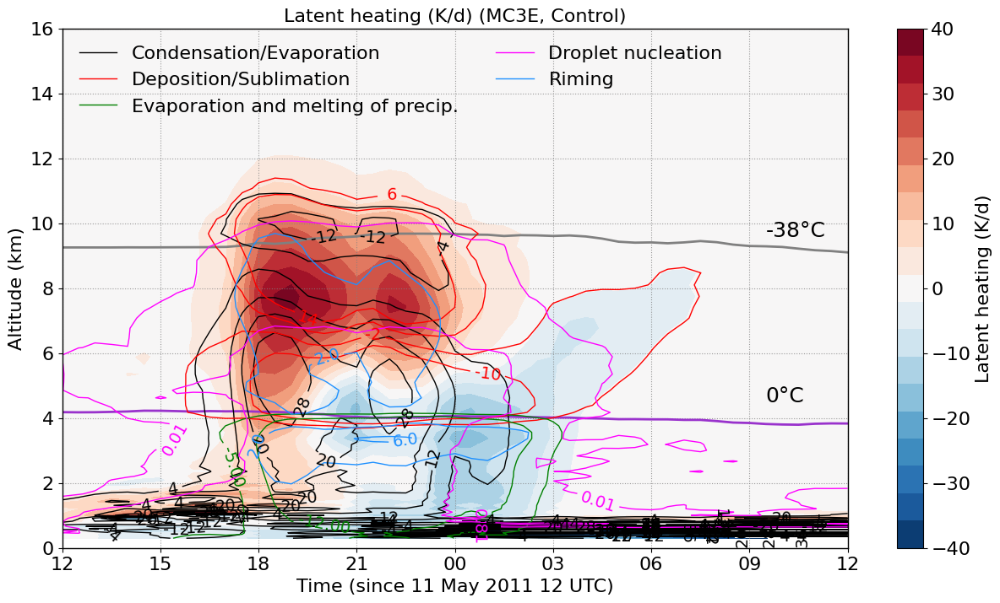

In [31]:

import matplotlib.lines as mlines

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=16;
ln=2;
ln1=1.;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-40, 40, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-40, -30, -20, -10, 0, 10, 20, 30, 40])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-20, 50.5, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-10, 20.5, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 7)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, ncols=2, loc='upper left')




for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


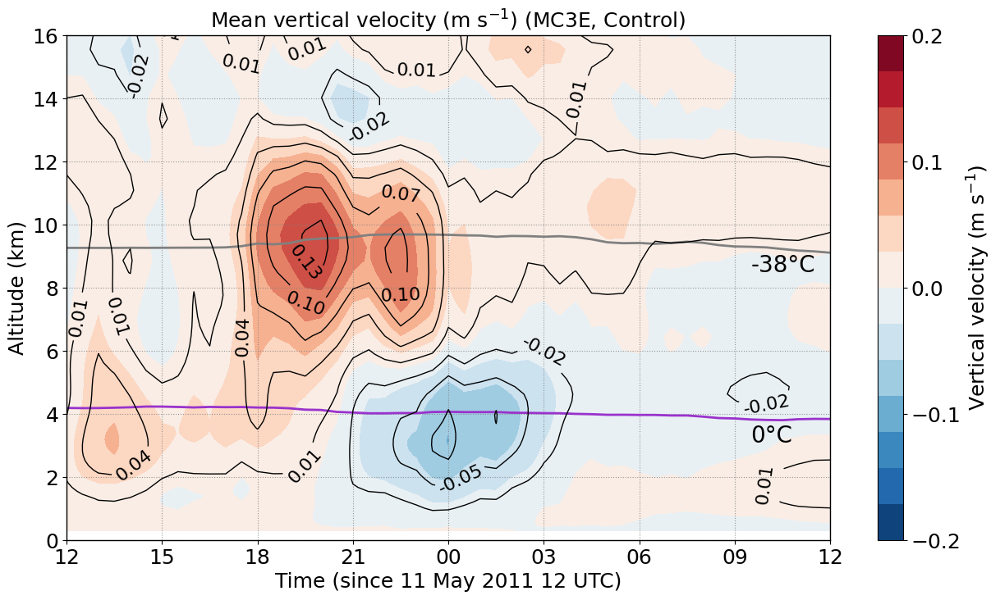

In [26]:

import matplotlib.lines as mlines


fnt=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-0.2, 0.2, 15)

plt.figure(figsize=(15, 8))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Vertical velocity (m s$^{-1}$)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 3.1, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 8.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Mean vertical velocity (m s$^{-1}$) (MC3E, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-0.2, 0.2, 0.03)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not found.
findfont: Font family 'Roboto' not

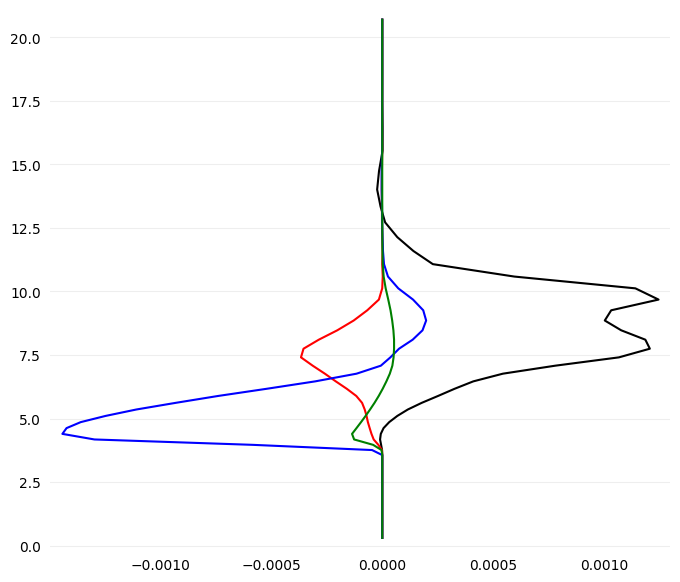

In [10]:
import matplotlib.pyplot as plt

plt.plot(ds_4sip.d_qi_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'k-')
plt.plot(ds_4sip.d_qs_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'r-')
plt.plot(ds_4sip.d_qg_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'b-')
plt.plot(ds_4sip.d_qh_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'g-')

## Cloud top height

In [12]:
thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_norf.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_norf.z_mc.where(cld_mask)
mean_cld_top_ht_norf = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nohm.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nohm.z_mc.where(cld_mask)
mean_cld_top_ht_nohm = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nobr.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nobr.z_mc.where(cld_mask)
mean_cld_top_ht_nobr = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nosb.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nosb.z_mc.where(cld_mask)
mean_cld_top_ht_nosb = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

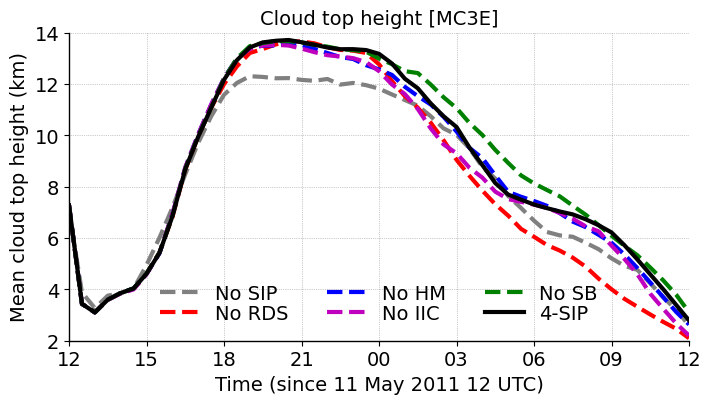

In [13]:




plt.figure(figsize=(8, 4))
plt.style.use('default')

lnwdth=3
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, 1.e-3*mean_cld_top_ht_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, 1.e-3*mean_cld_top_ht_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, 1.e-3*mean_cld_top_ht_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, 1.e-3*mean_cld_top_ht_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.xlim(start_date, end_date)
plt.ylim(2,14)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Mean cloud top height (km)', fontsize=fontsize)#, fontweight='bold')
plt.title('Cloud top height [MC3E]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


## Freezing level

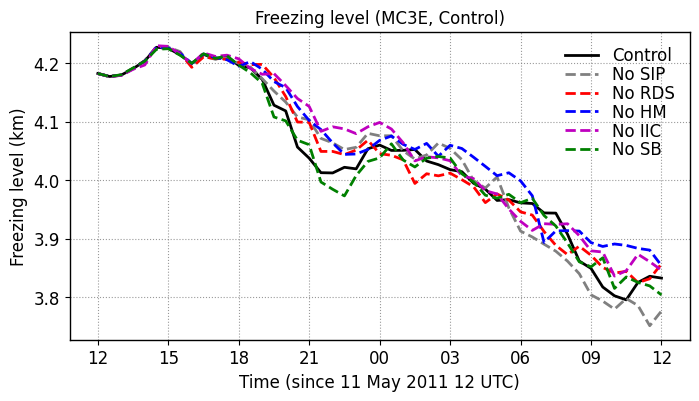

In [ ]:
fnt=12;
ln=2;
plt.figure(figsize=(8,4))
plt.style.use('default')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
plt.plot(ds_nosip.time, mean_freez_lev_nosip, '--', color='grey', linewidth=ln, label='No SIP')
plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (MC3E, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

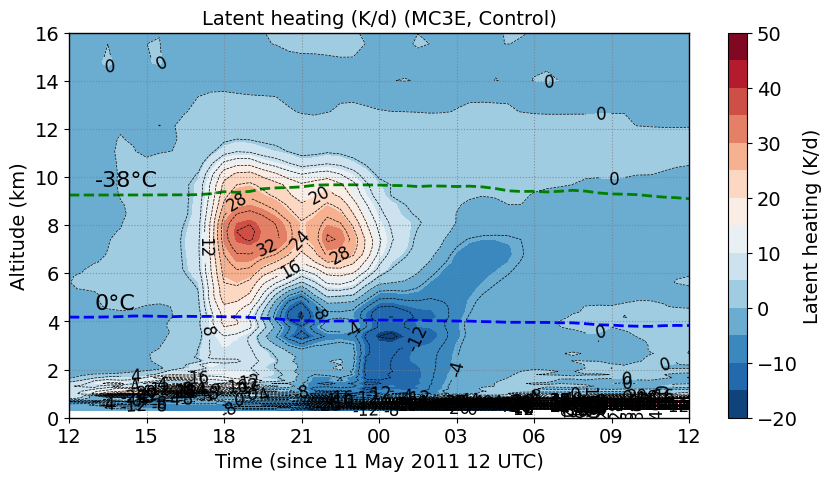

In [76]:
fnt=14;
ln=2;
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'b--', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'g--', linewidth=ln)

plt.text(ds_4sip.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

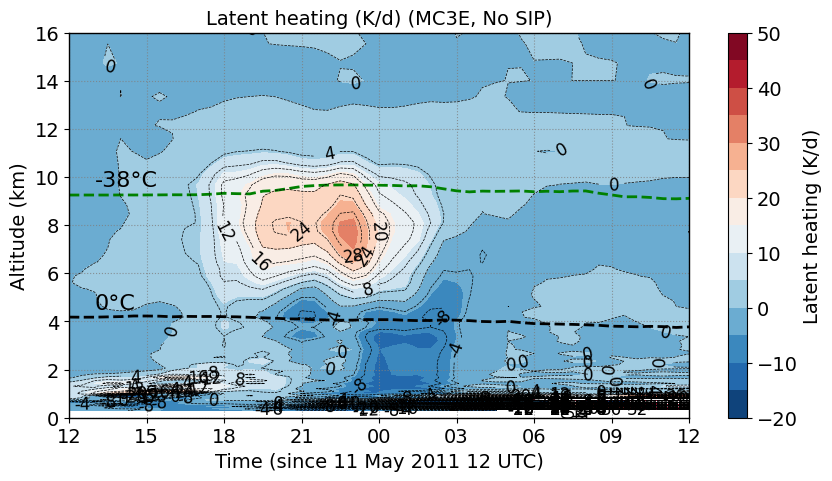

In [77]:
fnt=14;
ln=2;
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'k--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

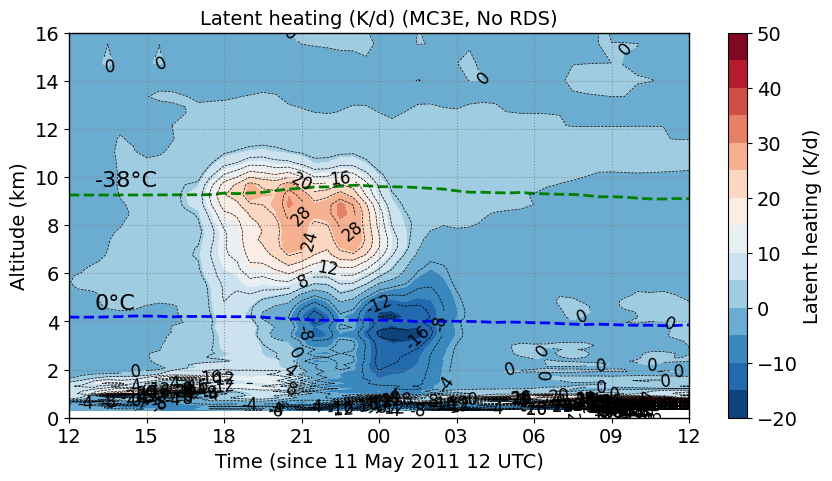

In [78]:
fnt=14;
ln=2;
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'b--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

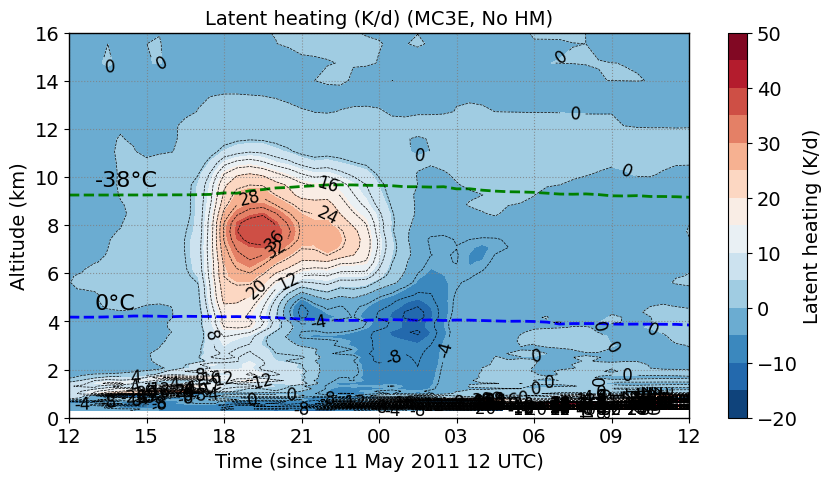

In [79]:
fnt=14;
ln=2;
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [ ]:
fnt=14;
ln=2;
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'b--', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, 'g--', linewidth=ln)

plt.text(ds_nobr.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

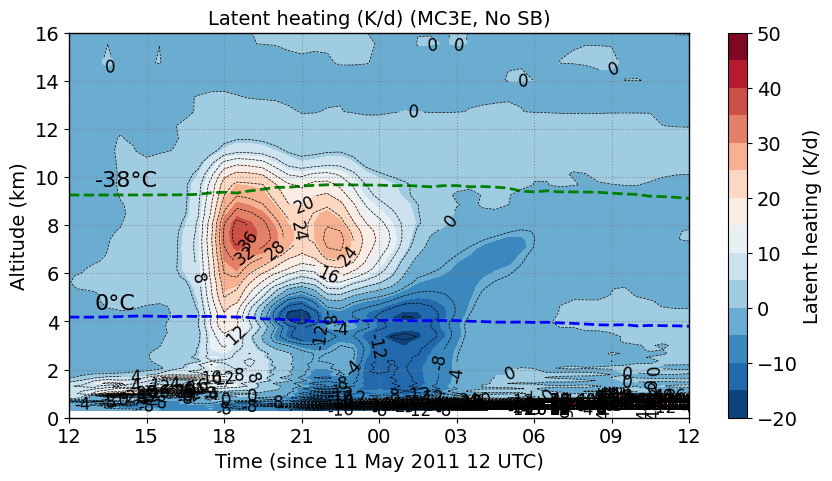

In [81]:
fnt=14
ln=2
lev = np.linspace(-20, 50, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-20, -10, 0, 10, 20, 30, 40, 50])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'b--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[2], 9.6, '-38°C', fontsize=fnt+2)
plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-20, 50.5, 4)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

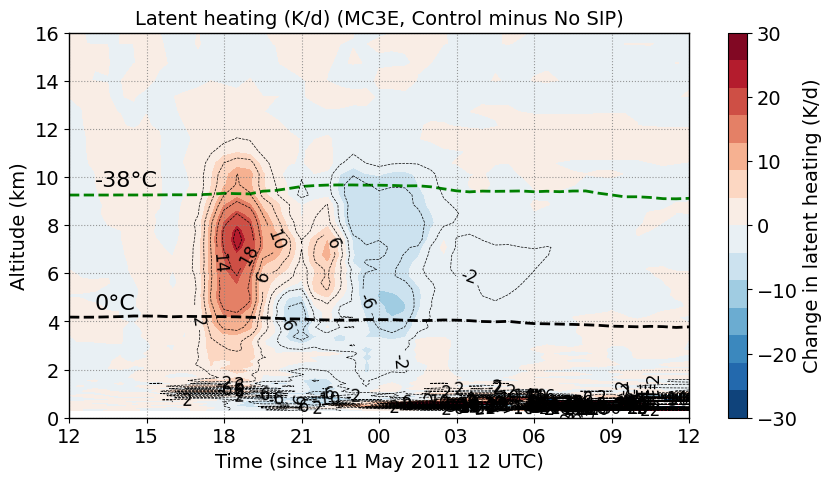

In [12]:
fnt=14;
ln=2;
lev = np.linspace(-30, 30, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Change in latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'k--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 30.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

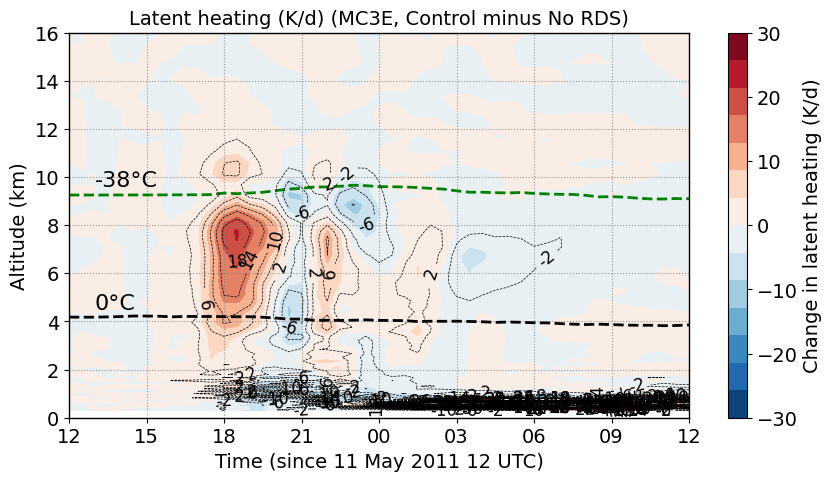

In [13]:
fnt=14;
ln=2;
lev = np.linspace(-30, 30, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Change in latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'k--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control minus No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 30.5, 4)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

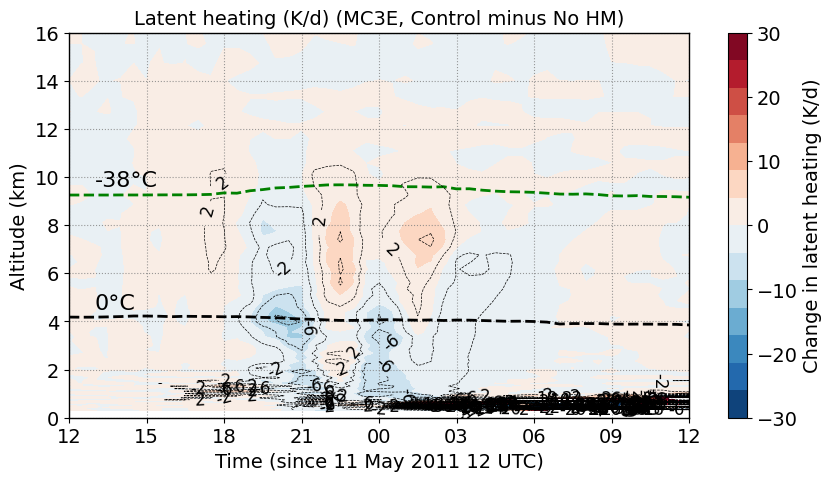

In [14]:
fnt=14;
ln=2;
lev = np.linspace(-30, 30, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Change in latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'k--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control minus No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 30.5, 4)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

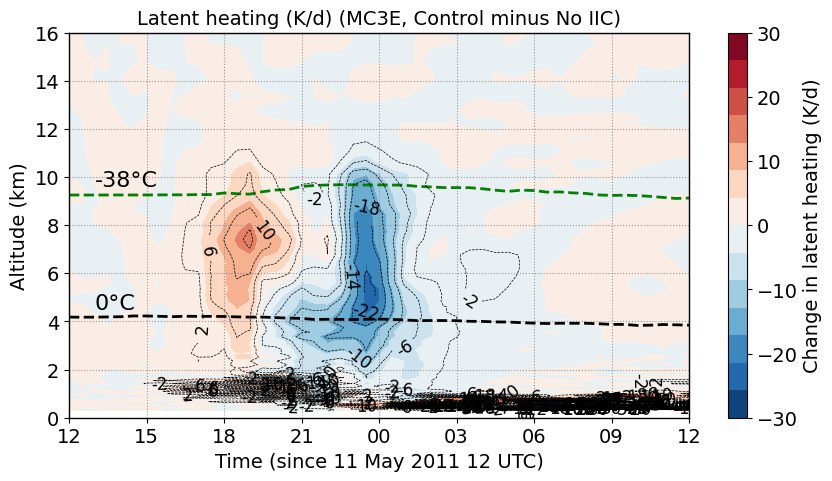

In [15]:
fnt=14;
ln=2;
lev = np.linspace(-30, 30, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Change in latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'k--', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, 'g--', linewidth=ln)

plt.text(ds_nobr.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control minus No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 30.5, 4)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

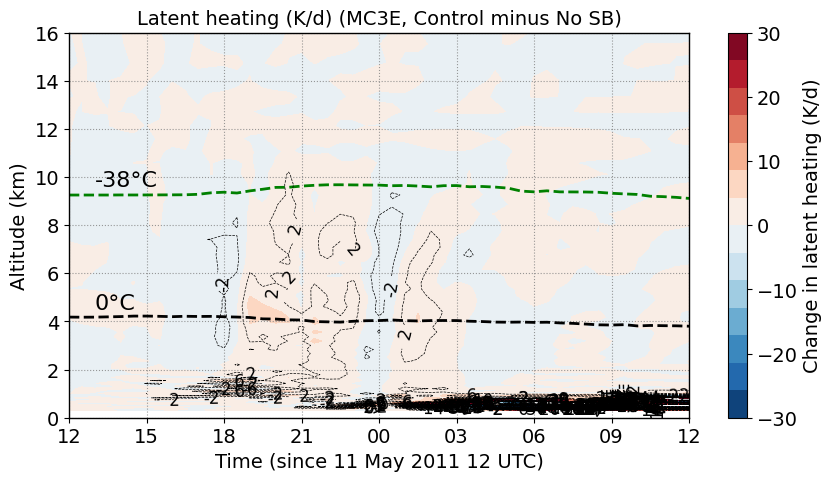

In [16]:
fnt=14;
ln=2;
lev = np.linspace(-30, 30, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Change in latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'k--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[2], 4.5, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[2], 9.6, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (MC3E, Control minus No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 30.5, 4)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

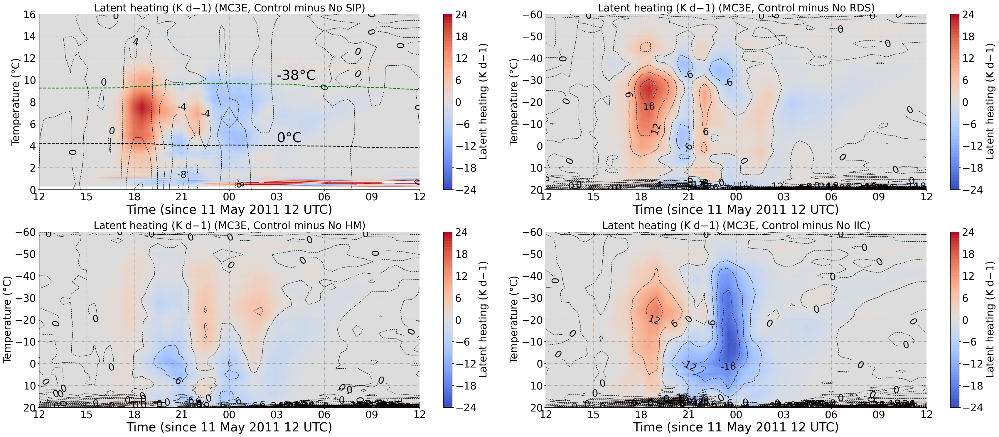

In [86]:

fnt=25
ln=2
lev = np.linspace(-24, 24, 60)

plt.figure(figsize=(35,15))
plt.style.use('default')

plt.subplot(2,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-24, -18, -12, -6, 0, 6, 12, 18, 24])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K d${-1}$)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k--', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'g--', linewidth=ln)

plt.text(ds_4sip.time[30], 4.3, '0°C', fontsize=fontsize+4)
plt.text(ds_4sip.time[30], 10., '-38°C', fontsize=fontsize+4)
plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Temperature (°C)', fontsize=fnt)
plt.title('Latent heating (K d${-1}$) (MC3E, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-24, 24.5, 4)
contours = plt.contour(ds_nosip.time, mean_tempc_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-1, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(2,2,2)
cnt=plt.contourf(ds_nosip.time, mean_tempc_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-24, -18, -12, -6, 0, 6, 12, 18, 24])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K d${-1}$)', size=fnt)


plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.ylim(20, -60)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Temperature (°C)', fontsize=fnt)
plt.title('Latent heating (K d${-1}$) (MC3E, Control minus No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-24, 24.5, 6)  
contours = plt.contour(ds_norf.time, mean_tempc_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=1)
# Add contour labels
plt.clabel(contours, inline=True, fontsize=fnt-1, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(2,2,3)
cnt=plt.contourf(ds_norf.time, mean_tempc_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-24, -18, -12, -6, 0, 6, 12, 18, 24])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K d${-1}$)', size=fnt)


plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.ylim(20, -60)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Temperature (°C)', fontsize=fnt)
plt.title('Latent heating (K d${-1}$) (MC3E, Control minus No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-24, 24.5, 6)  
contours = plt.contour(ds_nohm.time, mean_tempc_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=1)
# Add contour labels
plt.clabel(contours, inline=True, fontsize=fnt-1, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(2,2,4)
cnt=plt.contourf(ds_nobr.time, mean_tempc_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-24, -18, -12, -6, 0, 6, 12, 18, 24])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K d${-1}$)', size=fnt)


plt.xlabel('Time (since 11 May 2011 12 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2011, 5, 11, 12, 0) 
end_date = datetime(2011, 5, 12, 12, 0)

plt.ylim(20, -60)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Temperature (°C)', fontsize=fnt)
plt.title('Latent heating (K d${-1}$) (MC3E, Control minus No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-24, 24.5, 6)  
contours = plt.contour(ds_nobr.time, mean_tempc_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=1)
# Add contour labels
plt.clabel(contours, inline=True, fontsize=fnt-1, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')
   
plt.tight_layout()
plt.show()

## TOA Radiative Fluxes
#### Calculating CRE
##### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
##### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
##### Net CRE = SW_CRE + LW_CRE

In [6]:

#### SIP 
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0).mean('ncells') 

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_sw_dn_4sip-toa_lw_up_4sip) - (toa_sw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip


#### No SIP 
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn_clr[:,0,:]

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip
ds_nosip['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosip
ds_nosip['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosip
ds_nosip['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosip

#### No RF 
toa_sw_up_norf = ds_norf.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_norf = ds_norf.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_norf = ds_norf.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_norf = ds_norf.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_norf = ds_norf.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_norf = ds_norf.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_norf = ds_norf.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_norf = ds_norf.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_norf = (toa_sw_dn_norf-toa_sw_up_norf) - (toa_sw_dn_clr_norf-toa_sw_up_clr_norf)
toa_lw_cre_norf = (toa_sw_dn_norf-toa_lw_up_norf) - (toa_sw_dn_clr_norf-toa_lw_up_clr_norf)
toa_net_cre_norf = toa_sw_cre_norf+toa_lw_cre_norf

ds_norf['toa_sw_cre'] = toa_sw_cre_norf
ds_norf['toa_lw_cre'] = toa_lw_cre_norf
ds_norf['toa_net_cre'] = toa_net_cre_norf
ds_norf['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_norf
ds_norf['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_norf
ds_norf['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_norf

#### No HM 
toa_sw_up_nohm = ds_nohm.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nohm = ds_nohm.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nohm = ds_nohm.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nohm = ds_nohm.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nohm = ds_nohm.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nohm = ds_nohm.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nohm = ds_nohm.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nohm = ds_nohm.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nohm = (toa_sw_dn_nohm-toa_sw_up_nohm) - (toa_sw_dn_clr_nohm-toa_sw_up_clr_nohm)
toa_lw_cre_nohm = (toa_sw_dn_nohm-toa_lw_up_nohm) - (toa_sw_dn_clr_nohm-toa_lw_up_clr_nohm)
toa_net_cre_nohm = toa_sw_cre_nohm+toa_lw_cre_nohm

ds_nohm['toa_sw_cre'] = toa_sw_cre_nohm
ds_nohm['toa_lw_cre'] = toa_lw_cre_nohm
ds_nohm['toa_net_cre'] = toa_net_cre_nohm
ds_nohm['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nohm
ds_nohm['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nohm
ds_nohm['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nohm

#### No IIC 
toa_sw_up_nobr = ds_nobr.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nobr = ds_nobr.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nobr = ds_nobr.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nobr = ds_nobr.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nobr = ds_nobr.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nobr = ds_nobr.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nobr = ds_nobr.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nobr = ds_nobr.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nobr = (toa_sw_dn_nobr-toa_sw_up_nobr) - (toa_sw_dn_clr_nobr-toa_sw_up_clr_nobr)
toa_lw_cre_nobr = (toa_sw_dn_nobr-toa_lw_up_nobr) - (toa_sw_dn_clr_nobr-toa_lw_up_clr_nobr)
toa_net_cre_nobr = toa_sw_cre_nobr+toa_lw_cre_nobr

ds_nobr['toa_sw_cre'] = toa_sw_cre_nobr
ds_nobr['toa_lw_cre'] = toa_lw_cre_nobr
ds_nobr['toa_net_cre'] = toa_net_cre_nobr
ds_nobr['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nobr
ds_nobr['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nobr
ds_nobr['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nobr

#### No SB 
toa_sw_up_nosb = ds_nosb.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_nosb = ds_nosb.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_nosb = ds_nosb.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_nosb = ds_nosb.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_nosb = ds_nosb.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_nosb = ds_nosb.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_nosb = ds_nosb.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_nosb = ds_nosb.lwflx_dn_clr.isel(height_2=0).mean('ncells')

toa_sw_cre_nosb = (toa_sw_dn_nosb-toa_sw_up_nosb) - (toa_sw_dn_clr_nosb-toa_sw_up_clr_nosb)
toa_lw_cre_nosb = (toa_sw_dn_nosb-toa_lw_up_nosb) - (toa_sw_dn_clr_nosb-toa_lw_up_clr_nosb)
toa_net_cre_nosb = toa_sw_cre_nosb+toa_lw_cre_nosb

ds_nosb['toa_sw_cre'] = toa_sw_cre_nosb
ds_nosb['toa_lw_cre'] = toa_lw_cre_nosb
ds_nosb['toa_net_cre'] = toa_net_cre_nosb
ds_nosb['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosb
ds_nosb['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosb
ds_nosb['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosb


#### Change in CRE w.r.t. 4-SIP (control run)
del_toa_sw_cre_nosip = toa_sw_cre_4sip-toa_sw_cre_nosip
del_toa_sw_cre_norf = toa_sw_cre_4sip-toa_sw_cre_norf
del_toa_sw_cre_nohm = toa_sw_cre_4sip-toa_sw_cre_nohm 
del_toa_sw_cre_nobr = toa_sw_cre_4sip-toa_sw_cre_nobr 
del_toa_sw_cre_nosb = toa_sw_cre_4sip-toa_sw_cre_nosb 

del_toa_lw_cre_nosip = toa_lw_cre_4sip-toa_lw_cre_nosip
del_toa_lw_cre_norf = toa_lw_cre_4sip-toa_lw_cre_norf
del_toa_lw_cre_nohm = toa_lw_cre_4sip-toa_lw_cre_nohm 
del_toa_lw_cre_nobr = toa_lw_cre_4sip-toa_lw_cre_nobr 
del_toa_lw_cre_nosb = toa_lw_cre_4sip-toa_lw_cre_nosb 

del_toa_net_cre_nosip = toa_net_cre_4sip-toa_net_cre_nosip 
del_toa_net_cre_norf = toa_net_cre_4sip-toa_net_cre_norf 
del_toa_net_cre_nohm = toa_net_cre_4sip-toa_net_cre_nohm  
del_toa_net_cre_nobr = toa_net_cre_4sip-toa_net_cre_nobr 
del_toa_net_cre_nosb = toa_net_cre_4sip-toa_net_cre_nosb 

per_del_toa_sw_cre_nosip = 100*(del_toa_sw_cre_nosip)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_norf = 100*(del_toa_sw_cre_norf)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nohm = 100*(del_toa_sw_cre_nohm)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nobr = 100*(del_toa_sw_cre_nobr)/np.abs(toa_sw_cre_4sip)
per_del_toa_sw_cre_nosb = 100*(del_toa_sw_cre_nosb)/np.abs(toa_sw_cre_4sip)

per_del_toa_sw_cre_nosip = per_del_toa_sw_cre_nosip.fillna(0)
per_del_toa_sw_cre_norf = per_del_toa_sw_cre_norf.fillna(0)
per_del_toa_sw_cre_nohm = per_del_toa_sw_cre_nohm.fillna(0)
per_del_toa_sw_cre_nobr = per_del_toa_sw_cre_nobr.fillna(0)
per_del_toa_sw_cre_nosb = per_del_toa_sw_cre_nosb.fillna(0)

per_del_toa_lw_cre_nosip = 100*(del_toa_lw_cre_nosip)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_norf = 100*(del_toa_lw_cre_norf)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nohm = 100*(del_toa_lw_cre_nohm)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nobr = 100*(del_toa_lw_cre_nobr)/np.abs(toa_lw_cre_4sip)
per_del_toa_lw_cre_nosb = 100*(del_toa_lw_cre_nosb)/np.abs(toa_lw_cre_4sip)

per_del_toa_net_cre_nosip = 100*(del_toa_net_cre_nosip)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_norf = 100*(del_toa_net_cre_norf)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nohm = 100*(del_toa_net_cre_nohm)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nobr = 100*(del_toa_net_cre_nobr)/np.abs(toa_net_cre_4sip)
per_del_toa_net_cre_nosb = 100*(del_toa_net_cre_nosb)/np.abs(toa_net_cre_4sip)


## Box plot of TOA radiative fluxes

In [7]:

## 4 SIP
min_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.min().values; max_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.max().values
mean_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.mean().values

min_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.min().values; max_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.max().values
mean_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.mean().values

min_toa_net_cre_4sip = ds_4sip.toa_net_cre.min().values; max_toa_net_cre_4sip = ds_4sip.toa_net_cre.max().values
mean_toa_net_cre_4sip = ds_4sip.toa_net_cre.mean().values


## No SIP
min_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.min().values; max_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.max().values
mean_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.mean().values

min_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.min().values; max_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.max().values
mean_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.mean().values

min_toa_net_cre_nosip = ds_nosip.toa_net_cre.min().values; max_toa_net_cre_nosip = ds_nosip.toa_net_cre.max().values
mean_toa_net_cre_nosip = ds_nosip.toa_net_cre.mean().values

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 

## No RDS
min_toa_lw_cre_norf = ds_norf.toa_lw_cre.min().values; max_toa_lw_cre_norf = ds_norf.toa_lw_cre.max().values
mean_toa_lw_cre_norf = ds_norf.toa_lw_cre.mean().values

min_toa_sw_cre_norf = ds_norf.toa_sw_cre.min().values; max_toa_sw_cre_norf = ds_norf.toa_sw_cre.max().values
mean_toa_sw_cre_norf = ds_norf.toa_sw_cre.mean().values

min_toa_net_cre_norf = ds_norf.toa_net_cre.min().values; max_toa_net_cre_norf = ds_norf.toa_net_cre.max().values
mean_toa_net_cre_norf = ds_norf.toa_net_cre.mean().values

del_min_toa_lw_cre_norf = min_toa_lw_cre_4sip-min_toa_lw_cre_norf; del_max_toa_lw_cre_norf = max_toa_lw_cre_4sip-max_toa_lw_cre_norf;
del_mean_toa_lw_cre_norf = mean_toa_lw_cre_4sip-mean_toa_lw_cre_norf; 
del_min_toa_sw_cre_norf = min_toa_sw_cre_4sip-min_toa_sw_cre_norf; del_max_toa_sw_cre_norf = max_toa_sw_cre_4sip-max_toa_sw_cre_norf;
del_mean_toa_sw_cre_norf = mean_toa_sw_cre_4sip-mean_toa_sw_cre_norf; 
del_min_toa_net_cre_norf = min_toa_net_cre_4sip-min_toa_net_cre_norf; del_max_toa_net_cre_norf = max_toa_net_cre_4sip-max_toa_net_cre_norf;
del_mean_toa_net_cre_norf = mean_toa_net_cre_4sip-mean_toa_net_cre_norf;

## No HM
min_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.min().values; max_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.max().values
mean_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.mean().values

min_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.min().values; max_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.max().values
mean_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.mean().values

min_toa_net_cre_nohm = ds_nohm.toa_net_cre.min().values; max_toa_net_cre_nohm = ds_nohm.toa_net_cre.max().values
mean_toa_net_cre_nohm = ds_nohm.toa_net_cre.mean().values

del_min_toa_lw_cre_nohm = min_toa_lw_cre_4sip-min_toa_lw_cre_nohm; del_max_toa_lw_cre_nohm = max_toa_lw_cre_4sip-max_toa_lw_cre_nohm;
del_mean_toa_lw_cre_nohm = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nohm; 
del_min_toa_sw_cre_nohm = min_toa_sw_cre_4sip-min_toa_sw_cre_nohm; del_max_toa_sw_cre_nohm = max_toa_sw_cre_4sip-max_toa_sw_cre_nohm;
del_mean_toa_sw_cre_nohm = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nohm; 
del_min_toa_net_cre_nohm = min_toa_net_cre_4sip-min_toa_net_cre_nohm; del_max_toa_net_cre_nohm = max_toa_net_cre_4sip-max_toa_net_cre_nohm;
del_mean_toa_net_cre_nohm = mean_toa_net_cre_4sip-mean_toa_net_cre_nohm;

## No BR
min_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.min().values; max_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.max().values
mean_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.mean().values

min_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.min().values; max_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.max().values
mean_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.mean().values

min_toa_net_cre_nobr = ds_nobr.toa_net_cre.min().values; max_toa_net_cre_nobr = ds_nobr.toa_net_cre.max().values
mean_toa_net_cre_nobr = ds_nobr.toa_net_cre.mean().values

del_min_toa_lw_cre_nobr = min_toa_lw_cre_4sip-min_toa_lw_cre_nobr; del_max_toa_lw_cre_nobr = max_toa_lw_cre_4sip-max_toa_lw_cre_nobr;
del_mean_toa_lw_cre_nobr = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nobr; 
del_min_toa_sw_cre_nobr = min_toa_sw_cre_4sip-min_toa_sw_cre_nobr; del_max_toa_sw_cre_nobr = max_toa_sw_cre_4sip-max_toa_sw_cre_nobr;
del_mean_toa_sw_cre_nobr = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nobr; 
del_min_toa_net_cre_nobr = min_toa_net_cre_4sip-min_toa_net_cre_nobr; del_max_toa_net_cre_nobr = max_toa_net_cre_4sip-max_toa_net_cre_nobr;
del_mean_toa_net_cre_nobr = mean_toa_net_cre_4sip-mean_toa_net_cre_nobr;

## No SB
min_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.min().values; max_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.max().values
mean_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.mean().values

min_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.min().values; max_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.max().values
mean_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.mean().values

min_toa_net_cre_nosb = ds_nosb.toa_net_cre.min().values; max_toa_net_cre_nosb = ds_nosb.toa_net_cre.max().values
mean_toa_net_cre_nosb = ds_nosb.toa_net_cre.mean().values

del_min_toa_lw_cre_nosb = min_toa_lw_cre_4sip-min_toa_lw_cre_nosb; del_max_toa_lw_cre_nosb = max_toa_lw_cre_4sip-max_toa_lw_cre_nosb;
del_mean_toa_lw_cre_nosb = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosb; 
del_min_toa_sw_cre_nosb = min_toa_sw_cre_4sip-min_toa_sw_cre_nosb; del_max_toa_sw_cre_nosb = max_toa_sw_cre_4sip-max_toa_sw_cre_nosb;
del_mean_toa_sw_cre_nosb = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosb; 
del_min_toa_net_cre_nosb = min_toa_net_cre_4sip-min_toa_net_cre_nosb; del_max_toa_net_cre_nosb = max_toa_net_cre_4sip-max_toa_net_cre_nosb;
del_mean_toa_net_cre_nosb = mean_toa_net_cre_4sip-mean_toa_net_cre_nosb;


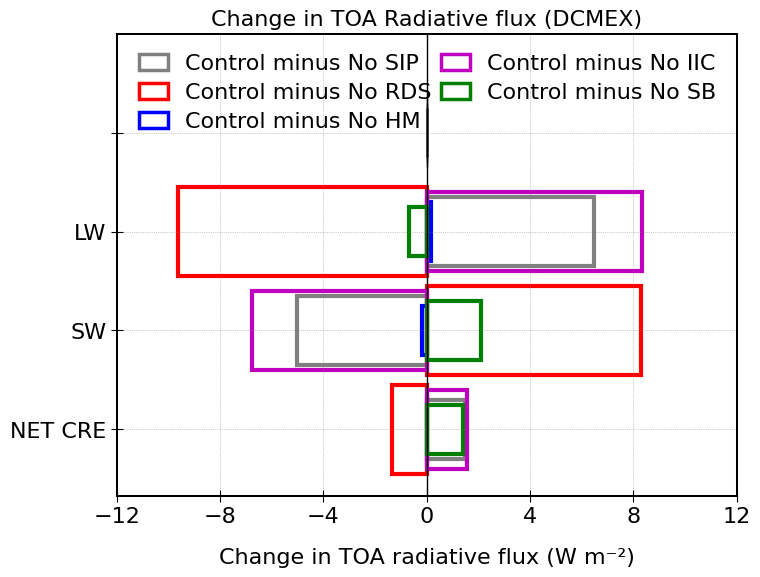

In [30]:
import matplotlib.pyplot as plt
import numpy as np

fnt = 16.0
ln=3;
x = np.array([1, 2, 3, 4])
#w1, w2, w3, w4, w5 = 0.9, 0.6, 0.7, 0.6, 0.5
w1, w2, w3, w4, w5 = 0.9, 0.8, 0.7, 0.6, 0.5

# Data for bars (assuming they are defined elsewhere in your code)
# Q_glc_lif_acm, Q_mix_lif_acm, Q_ice_lif_acm, etc.

#plt.figure('AIE CLOUDS', figsize=(12, 12))

# Plotting
#plt.figure('AIE CLOUDS')
plt.figure(figsize=(8,6))
plt.style.use('default')

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], del_mean_toa_lw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[1], del_mean_toa_lw_cre_norf, height=w1, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w4, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], del_mean_toa_sw_cre_nosip, height=w3, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[2], del_mean_toa_sw_cre_norf, height=w1, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w5, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w4, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], del_mean_toa_net_cre_nosip, height=w4, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[3], del_mean_toa_net_cre_norf, height=w1, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.xlim(-12.0, 12.0)
plt.xticks([-12, -8, -4, 0, 4, 8, 12])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['grey', 'r', 'b', 'm', 'g']
labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='best', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('Change in TOA Radiative flux (DCMEX)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.show()


## Web plot of TOA radiative fluxes

In [10]:
import xarray as xr
import numpy as np
import pandas as pd

# List of storm datasets and a standard prefix map
storm_datasets = {
    #'Control': ds_4sip,
    'No SIP': ds_nosip,
    'No RDS': ds_norf,
    'No HM': ds_nohm,
    'No IIC': ds_nobr,
    'No SB': ds_nosb
}

def extract_features(ds, prefix):
    def safe_stat(var, func):
        return func(ds[var].values[np.isfinite(ds[var].values)])
    
    return {
        'SW$_{min}$': safe_stat(f'del_toa_sw_cre', np.min),
        'SW$_{max}$': safe_stat(f'del_toa_sw_cre', np.max),
        'SW$_{mean}$': safe_stat(f'del_toa_sw_cre', np.mean),
        'LW$_{min}$': safe_stat(f'del_toa_lw_cre', np.min),
        'LW$_{max}$': safe_stat(f'del_toa_lw_cre', np.max),
        'LW$_{mean}$': safe_stat(f'del_toa_lw_cre', np.mean),
        'NET CRE$_{min}$': safe_stat(f'del_toa_net_cre', np.min),
        'NET CRE$_{mean}$': safe_stat(f'del_toa_net_cre', np.mean)#,
        #'PEAK_SW_time': np.nanargmin(ds[f'toa_sw_cre_4sip'].values),
        #'PEAK_LW_time': np.nanargmax(ds[f'toa_lw_cre_4sip'].values)
    }

features = []
labels = []

for name, ds in storm_datasets.items():
    feats = extract_features(ds, name)
    features.append(feats)
    labels.append(name.upper())

df = pd.DataFrame(features, index=labels)


In [11]:
df

,SW$_{min}$,SW$_{max}$,SW$_{mean}$,LW$_{min}$,LW$_{max}$,LW$_{mean}$,NET CRE$_{min}$,NET CRE$_{mean}$
NO SIP,-20.627808,5.612488,-5.012411,-0.255081,13.175949,6.485563,-11.488892,1.473152
NO RDS,-0.025032,38.472717,8.291872,-19.010345,0.610962,-9.632504,-19.010345,-1.340631
NO HM,-13.532593,6.530090,-0.177814,-4.592163,4.348877,0.173937,-10.240631,-0.003877
NO IIC,-24.297607,0.000000,-6.771580,-1.582153,19.131653,8.325068,-16.103516,1.553488
NO SB,-1.475403,16.193176,2.105690,-4.350616,0.792542,-0.681673,-1.585541,1.424017


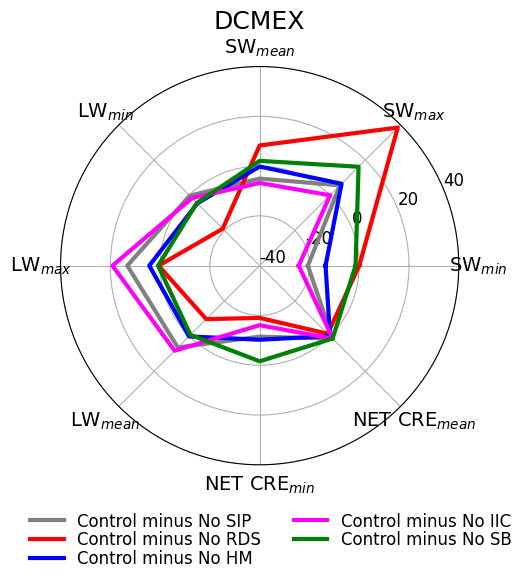

In [16]:
import matplotlib.pyplot as plt
import numpy as np
from math import pi

label_map = {
    "NO SIP": "Control minus No SIP",
    "NO RDS": "Control minus No RDS",
    "NO HM": "Control minus No HM",
    "NO IIC": "Control minus No IIC",
    "NO SB": "Control minus No SB"
}

fnt=14;
ln=3;
def multi_radar_plot(df):#, title="Storm Radiative properties"):
    labels = df.columns
    num_vars = len(labels)

    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += [angles[0]]  # to close the loop

    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(polar=True))
    plt.style.use('default')
    # Plot each storm
    #colors = plt.cm.tab10.colors  # 10 distinct colors
    custom_colors = {
    #"CONTROL": "black",
    "NO SIP": "grey",
    "NO RDS": "red",
    "NO HM": "blue",
    "NO IIC": "magenta",
    "NO SB": "green"
    }
    for i, (storm_name, row) in enumerate(df.iterrows()):
        values = row.values
        values = np.concatenate([values, [values[0]]])
        color = custom_colors.get(storm_name, "gray")
        #ax.plot(angles, values, label=storm_name, color=colors[i % len(colors)], linewidth=ln)
        #ax.fill(angles, values, alpha=0.0, color=colors[i % len(colors)])
        label = label_map.get(storm_name, storm_name)
        ax.plot(angles, values, label=label, color=color, linewidth=ln)
        ax.fill(angles, values, alpha=0.0, color=color)

    # Axis settings
    ax.set_xticks(angles[:-1])
    ax.tick_params(axis='y', labelsize=fnt)
    #ax.set_rgrids(fontsize=fnt)
    ax.set_xticklabels(labels, fontsize=fnt)
    ax.set_ylim(-40, 40)
    ax.set_yticks([-40, -20, 0, 20, 40])
    ax.set_yticklabels(['-40', '-20', '0', '20', '40'], fontsize=fnt-2)
    #ax.set_ylim(200, -800)
    #ax.set_yticks([200, 0, -200, -400, -600, -800])
    #ax.set_yticklabels(['-600', '-400', '-200', '0'], fontsize=fnt)
    ax.set_title('DCMEX', fontsize=fnt+4)
    ax.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt-2, bbox_to_anchor=(1.17, -0.08), ncols=2, loc='best')#frameon=False, loc='best', ncols=1, fontsize=fnt, bbox_to_anchor=(1.2, 1.05))
    plt.tight_layout()
    plt.show()


multi_radar_plot(df)

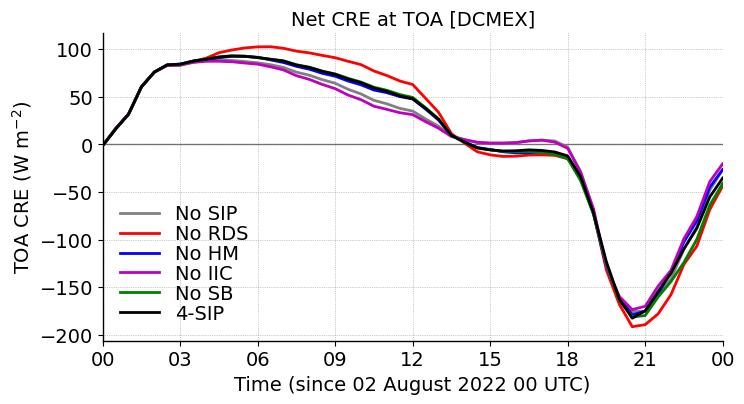

In [17]:
plt.figure(figsize=(8, 4))

lnwdth=2
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_net_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-100,100)
plt.yticks(fontsize=fontsize)
plt.ylabel('TOA CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Net CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


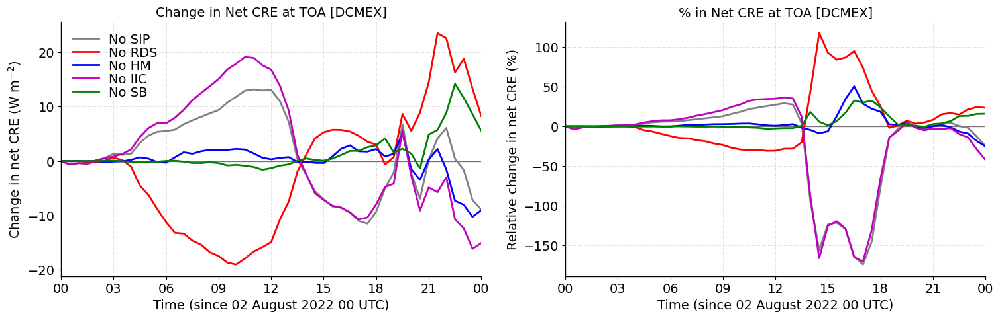

In [22]:
plt.figure(figsize=(18, 5))

lnwdth=2
fontsize=14

plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
#plt.ylim(-20,10)
#plt.yticks([-20, -10, 0, 10], fontsize=fontsize)
plt.ylabel('Change in net CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in Net CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
#plt.ylim(-40,140)
#plt.yticks([-40, -20, 0, 20, 40, 60, 80, 100, 120, 140], fontsize=fontsize)
plt.ylabel('Relative change in net CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% in Net CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.show()


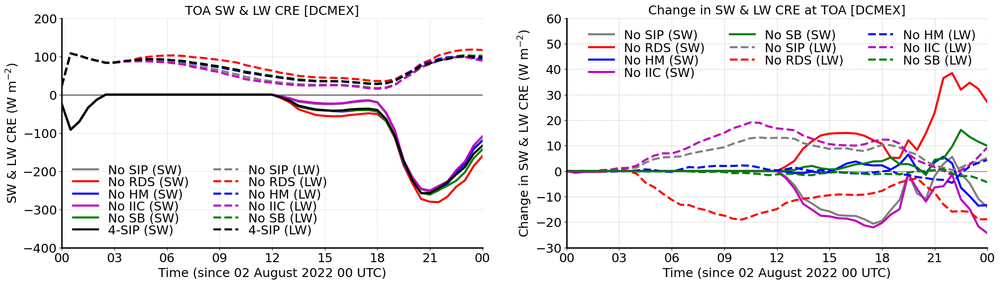

In [22]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP (SW)')

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k--', linewidth=lnwdth, label='4-SIP (LW)')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-400,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW & LW CRE [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.01, ncols=2, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-30, 60)
#plt.yticks([-8, -6, -4, -2, 0, 2, 4, 6, 8], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW & LW CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


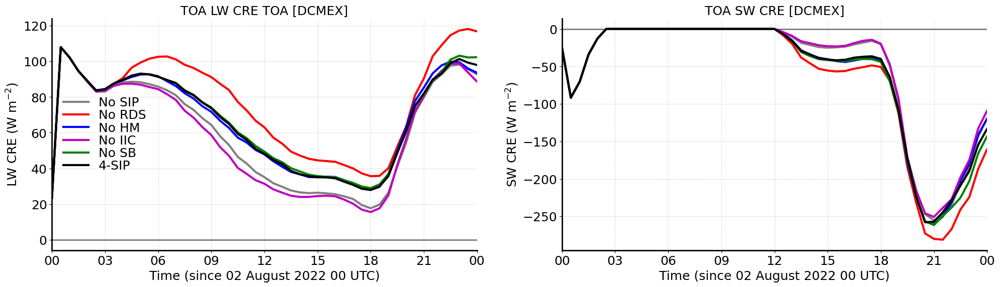

In [24]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,100)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-200,20)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE [DCMEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


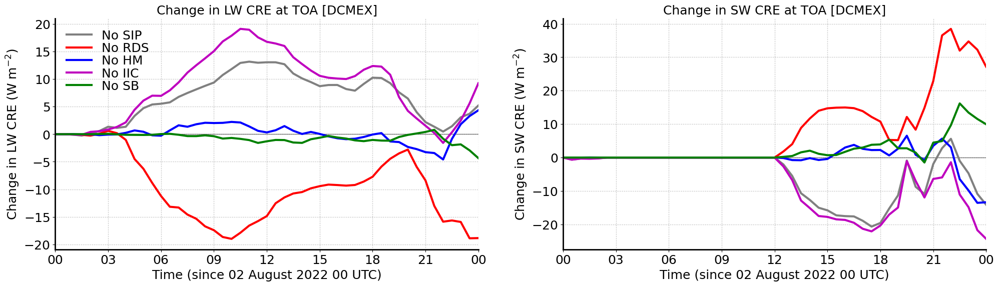

In [26]:

plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-14, 2)
#plt.yticks([-14, -12, -10, -8, -6, -4, -2, 0, 2], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-8, 20)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')

#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

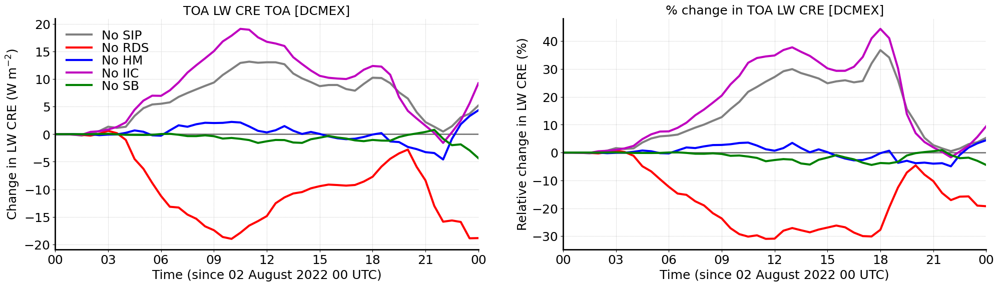

In [27]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-14, 2)
#plt.yticks([-14, -12, -10, -8, -6, -4, -2, 0, 2], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30,5)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in LW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA LW CRE [DCMEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


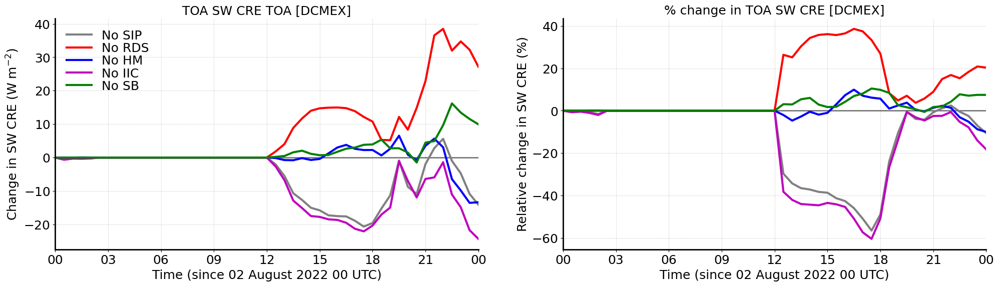

In [28]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-8, 20)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [DCMEX]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-5,35)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in SW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA SW CRE [DCMEX]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


## Radiative Heating Rates

In [29]:
# LW/SW heating rate with No SIP
mean_lwr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosip = mean_lwr_kperd_nosip + mean_swr_kperd_nosip

# LW/SW heating rate with 4 SIP
mean_lwr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_4sip = mean_lwr_kperd_4sip + mean_swr_kperd_4sip

# LW/SW heating rate with No RF
mean_lwr_kperd_norf = 86400.*ds_norf.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_norf = 86400.*ds_norf.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_norf = mean_lwr_kperd_norf + mean_swr_kperd_norf

# LW/SW heating rate with No HM
mean_lwr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nohm = mean_lwr_kperd_nohm + mean_swr_kperd_nohm

# LW/SW heating rate with No IIC
mean_lwr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nobr = mean_lwr_kperd_nobr + mean_swr_kperd_nobr

# LW/SW heating rate with No SB
mean_lwr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosb = mean_lwr_kperd_nosb + mean_swr_kperd_nosb

# Change in tot rad. heating w.r.t. control
del_tot_rad_kperd_norf = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_norf
del_tot_rad_kperd_nohm = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nohm
del_tot_rad_kperd_nobr = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nobr
del_tot_rad_kperd_nosb = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosb
del_tot_rad_kperd_nosip = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosip

# Change in LW rad. heating w.r.t. control
del_lwr_kperd_norf = mean_lwr_kperd_4sip-mean_lwr_kperd_norf
del_lwr_kperd_nohm = mean_lwr_kperd_4sip-mean_lwr_kperd_nohm
del_lwr_kperd_nobr = mean_lwr_kperd_4sip-mean_lwr_kperd_nobr
del_lwr_kperd_nosb = mean_lwr_kperd_4sip-mean_lwr_kperd_nosb
del_lwr_kperd_nosip = mean_lwr_kperd_4sip-mean_lwr_kperd_nosip

# Change in SW rad. heating w.r.t. control
del_swr_kperd_norf = mean_swr_kperd_4sip-mean_swr_kperd_norf
del_swr_kperd_nohm = mean_swr_kperd_4sip-mean_swr_kperd_nohm
del_swr_kperd_nobr = mean_swr_kperd_4sip-mean_swr_kperd_nobr
del_swr_kperd_nosb = mean_swr_kperd_4sip-mean_swr_kperd_nosb
del_swr_kperd_nosip = mean_swr_kperd_4sip-mean_swr_kperd_nosip

mean_tot_rad_kperd_nosip = mean_tot_rad_kperd_nosip.where(mean_tempc_nosip > -70)
mean_tot_rad_kperd_4sip = mean_tot_rad_kperd_4sip.where(mean_tempc_4sip > -70)
mean_tot_rad_kperd_norf = mean_tot_rad_kperd_norf.where(mean_tempc_norf > -70)
mean_tot_rad_kperd_nohm = mean_tot_rad_kperd_nohm.where(mean_tempc_nohm > -70)
mean_tot_rad_kperd_nobr = mean_tot_rad_kperd_nobr.where(mean_tempc_nobr > -70)
mean_tot_rad_kperd_nosb = mean_tot_rad_kperd_nosb.where(mean_tempc_nosb > -70)

In [30]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_rad_kperd_nosip, mean_tot_rad_kperd_4sip, mean_tot_rad_kperd_norf, mean_tot_rad_kperd_nohm, 
             mean_tot_rad_kperd_nobr, mean_tot_rad_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_rad_kperd_nosip = numpy_variables[0]
mean_tot_rad_kperd_4sip = numpy_variables[1]
mean_tot_rad_kperd_norf = numpy_variables[2]
mean_tot_rad_kperd_nohm = numpy_variables[3]
mean_tot_rad_kperd_nobr = numpy_variables[4]
mean_tot_rad_kperd_nosb = numpy_variables[5]


In [31]:
variables = [mean_lwr_kperd_nosip, mean_lwr_kperd_4sip, mean_lwr_kperd_norf, mean_lwr_kperd_nohm, 
             mean_lwr_kperd_nobr, mean_lwr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lwr_kperd_nosip = numpy_variables[0]
mean_lwr_kperd_4sip = numpy_variables[1]
mean_lwr_kperd_norf = numpy_variables[2]
mean_lwr_kperd_nohm = numpy_variables[3]
mean_lwr_kperd_nobr = numpy_variables[4]
mean_lwr_kperd_nosb = numpy_variables[5]

variables = [mean_swr_kperd_nosip, mean_swr_kperd_4sip, mean_swr_kperd_norf, mean_swr_kperd_nohm, 
             mean_swr_kperd_nobr, mean_swr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_swr_kperd_nosip = numpy_variables[0]
mean_swr_kperd_4sip = numpy_variables[1]
mean_swr_kperd_norf = numpy_variables[2]
mean_swr_kperd_nohm = numpy_variables[3]
mean_swr_kperd_nobr = numpy_variables[4]
mean_swr_kperd_nosb = numpy_variables[5]

In [32]:

mean_tot_rad_kperd_nosip[mean_tempc_nosip < -60] = np.nan
mean_tot_rad_kperd_4sip[mean_tempc_4sip < -60] = np.nan
mean_tot_rad_kperd_norf[mean_tempc_norf < -60] = np.nan
mean_tot_rad_kperd_nohm[mean_tempc_nohm < -60] = np.nan
mean_tot_rad_kperd_nobr[mean_tempc_nobr < -60] = np.nan
mean_tot_rad_kperd_nosb[mean_tempc_nosb < -60] = np.nan

mean_lwr_kperd_nosip[mean_tempc_nosip < -60] = np.nan
mean_lwr_kperd_4sip[mean_tempc_4sip < -60] = np.nan
mean_lwr_kperd_norf[mean_tempc_norf < -60] = np.nan
mean_lwr_kperd_nohm[mean_tempc_nohm < -60] = np.nan
mean_lwr_kperd_nobr[mean_tempc_nobr < -60] = np.nan
mean_lwr_kperd_nosb[mean_tempc_nosb < -60] = np.nan

mean_swr_kperd_nosip[mean_tempc_nosip < -60] = np.nan
mean_swr_kperd_4sip[mean_tempc_4sip < -60] = np.nan
mean_swr_kperd_norf[mean_tempc_norf < -60] = np.nan
mean_swr_kperd_nohm[mean_tempc_nohm < -60] = np.nan
mean_swr_kperd_nobr[mean_tempc_nobr < -60] = np.nan
mean_swr_kperd_nosb[mean_tempc_nosb < -60] = np.nan


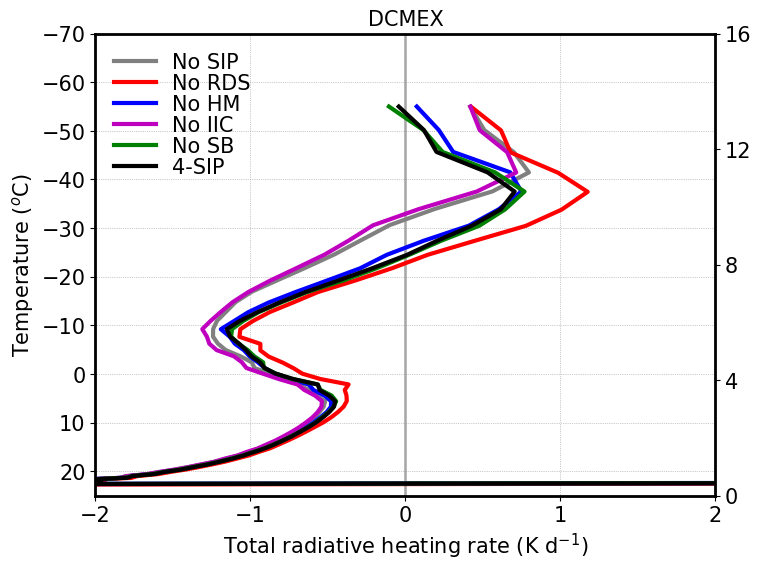

In [33]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')  
plt1.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-2, 2) 
plt1.set_ylim(25, -70) 
plt2.set_ylim(1.7, 16)

plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()


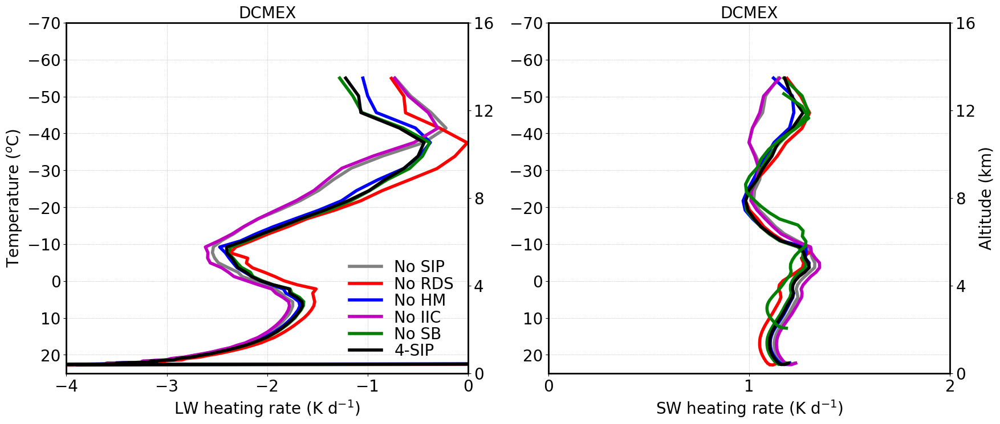

In [34]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lwr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lwr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lwr_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([-4, -3, -2, -1, 0])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt1.set_xlabel('LW heating rate (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_swr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_swr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_swr_kperd_nosb, mean_ht_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 2)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([0, 1, 2])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('SW heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


## Vertical velocity

In [20]:

thres_q = 0.;

#mean_tot_w_nosip = ds_nosip.w_vel.where(abs(ds_nosip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.where(abs(ds_4sip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.where(abs(ds_norf.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.where(abs(ds_nohm.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.where(abs(ds_nobr.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.where(abs(ds_nosb.w_vel) > 0.).mean(dim=('time','ncells'))

#mean_tot_w_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tot_w_nosip = xr.where(ds_nosip.tqi > thres_q, ds_nosip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_4sip = xr.where(ds_4sip.tqi > thres_q, ds_4sip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_norf = xr.where(ds_norf.tqi > thres_q, ds_norf.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nohm = xr.where(ds_nohm.tqi > thres_q, ds_nohm.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nobr = xr.where(ds_nobr.tqi > thres_q, ds_nobr.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nosb = xr.where(ds_nosb.tqi > thres_q, ds_nosb.w_vel, np.nan).mean(dim=('time','ncells'))

del_tot_w_nosip = mean_tot_w_4sip - mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip - mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip - mean_tot_w_nohm
del_tot_w_nobr = mean_tot_w_4sip - mean_tot_w_nobr
del_tot_w_nosb = mean_tot_w_4sip - mean_tot_w_nosb

#mean_tot_w_nosip = mean_tot_w_nosip.where(mean_tempc_nosip > -70)
#mean_tot_w_4sip = mean_tot_w_4sip.where(mean_tempc_4sip > -70)
#mean_tot_w_norf = mean_tot_w_norf.where(mean_tempc_norf > -70)
#mean_tot_w_nohm = mean_tot_w_nohm.where(mean_tempc_nohm > -70)
#mean_tot_w_nobr = mean_tot_w_nobr.where(mean_tempc_nobr > -70)
#mean_tot_w_nosb = mean_tot_w_nosb.where(mean_tempc_nosb > -70)

#del_tot_w_nosip = del_tot_w_nosip.where(mean_tempc_nosip > -70)
#del_tot_w_norf = del_tot_w_norf.where(mean_tempc_norf > -70)
#del_tot_w_nohm = del_tot_w_nohm.where(mean_tempc_nohm > -70)
#del_tot_w_nobr = del_tot_w_nobr.where(mean_tempc_nobr > -70)
#del_tot_w_nosb = del_tot_w_nosb.where(mean_tempc_nosb > -70)

In [21]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_w_nosip, mean_tot_w_4sip, mean_tot_w_norf, mean_tot_w_nohm, mean_tot_w_nobr, mean_tot_w_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_w_nosip = numpy_variables[0]
mean_tot_w_4sip = numpy_variables[1]
mean_tot_w_norf = numpy_variables[2]
mean_tot_w_nohm = numpy_variables[3]
mean_tot_w_nobr = numpy_variables[4]
mean_tot_w_nosb = numpy_variables[5]

In [24]:

del_tot_w_nosip = mean_tot_w_4sip-mean_tot_w_nosip 
del_tot_w_norf = mean_tot_w_4sip-mean_tot_w_norf 
del_tot_w_nohm = mean_tot_w_4sip-mean_tot_w_nohm 
del_tot_w_nobr = mean_tot_w_4sip-mean_tot_w_nobr 
del_tot_w_nosb = mean_tot_w_4sip-mean_tot_w_nosb 

per_del_tot_w_nosip = 100*del_tot_w_nosip/mean_tot_w_4sip
per_del_tot_w_norf = 100*del_tot_w_norf/mean_tot_w_4sip
per_del_tot_w_nohm = 100*del_tot_w_nohm/mean_tot_w_4sip
per_del_tot_w_nobr = 100*del_tot_w_nobr/mean_tot_w_4sip
per_del_tot_w_nosb = 100*del_tot_w_nosb/mean_tot_w_4sip


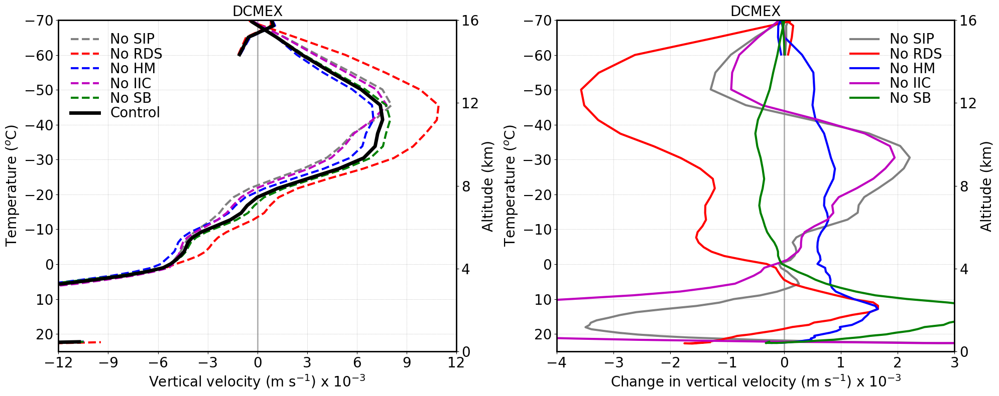

In [27]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-12, 12)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([-12, -9, -6, -3, 0, 3, 6, 9, 12])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4, 3)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([-2, -1, 0, 1, 2])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Change in vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


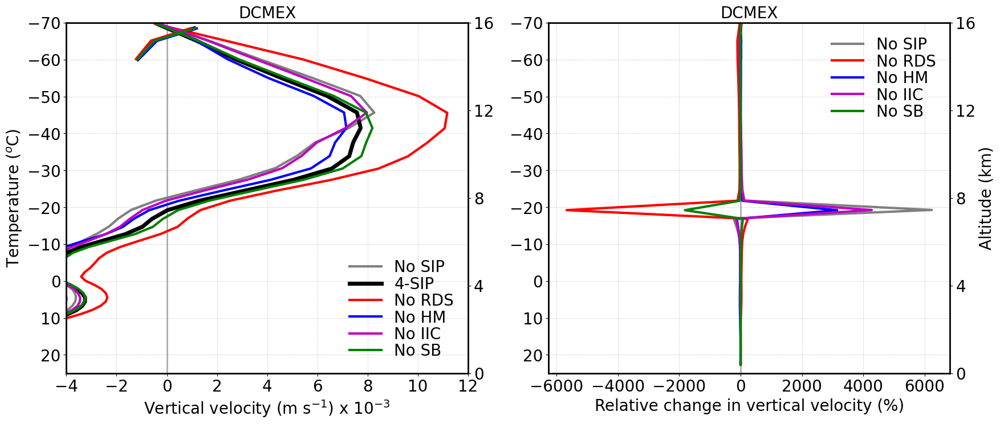

In [45]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4, 12)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([-4, -2, 0, 2, 4, 6, 8, 10, 12])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xlim(-40, 10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([-40, -30, -20, -10, 0, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in vertical velocity (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


## Cloud cover

In [41]:

mean_tot_cld_cover_nosip = ds_nosip.clc.where(ds_nosip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_4sip = ds_4sip.clc.where(ds_4sip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_norf = ds_norf.clc.where(ds_norf.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nohm = ds_nohm.clc.where(ds_nohm.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nobr = ds_nobr.clc.where(ds_nobr.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nosb = ds_nosb.clc.where(ds_nosb.tq > 0.).mean(dim=('time','ncells'))


In [42]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_cld_cover_nosip, mean_tot_cld_cover_4sip, mean_tot_cld_cover_norf, mean_tot_cld_cover_nohm, 
             mean_tot_cld_cover_nobr, mean_tot_cld_cover_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_cld_cover_nosip = numpy_variables[0]
mean_tot_cld_cover_4sip = numpy_variables[1]
mean_tot_cld_cover_norf = numpy_variables[2]
mean_tot_cld_cover_nohm = numpy_variables[3]
mean_tot_cld_cover_nobr = numpy_variables[4]
mean_tot_cld_cover_nosb = numpy_variables[5]


In [48]:

del_tot_cld_cover_nosip = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosip 
del_tot_cld_cover_norf = mean_tot_cld_cover_4sip-mean_tot_cld_cover_norf
del_tot_cld_cover_nohm = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nohm
del_tot_cld_cover_nobr = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nobr
del_tot_cld_cover_nosb = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosb

per_del_tot_cld_cover_nosip = 100*del_tot_cld_cover_nosip/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_norf = 100*del_tot_cld_cover_norf/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nohm = 100*del_tot_cld_cover_nohm/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nobr = 100*del_tot_cld_cover_nobr/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nosb = 100*del_tot_cld_cover_nosb/mean_tot_cld_cover_4sip


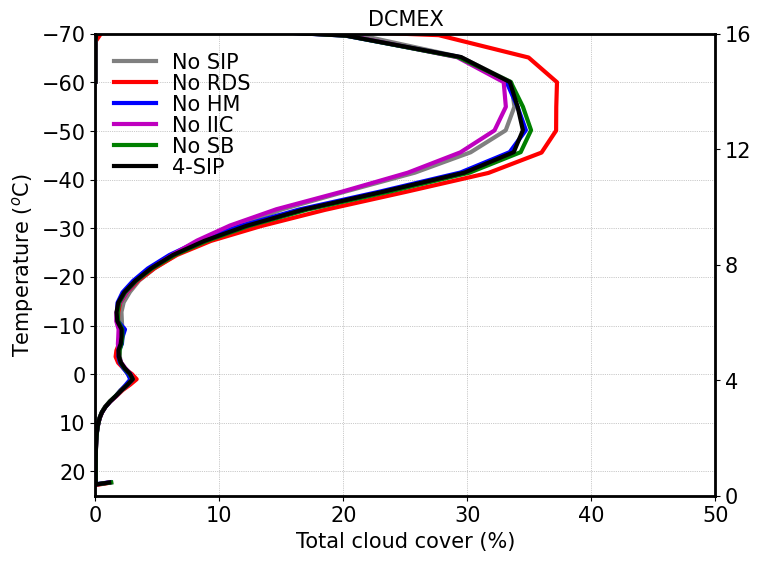

In [49]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_cld_cover_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP') 
plt1.plot(mean_tot_cld_cover_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_cld_cover_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_cld_cover_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_cld_cover_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP') 

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 50) 
plt1.set_ylim(25, -70) 
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70]) 
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()

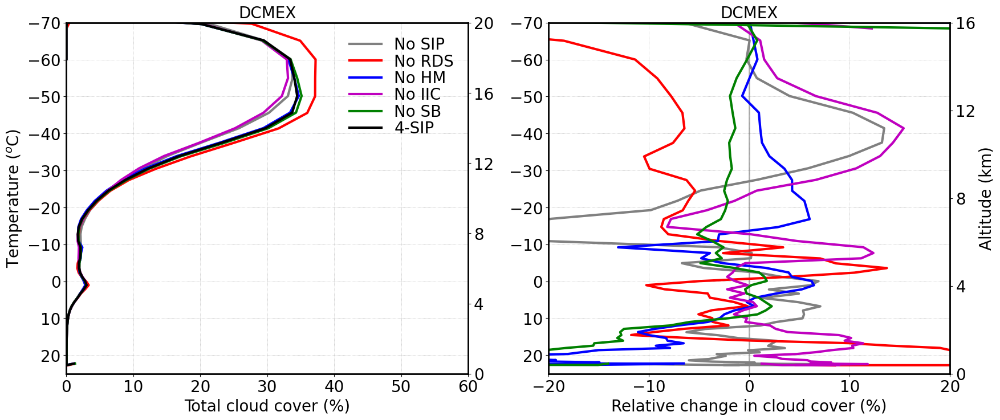

In [50]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_cld_cover_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 60)
plt1.set_ylim(25, -70)
plt2.set_ylim(0.5, 20)

plt1.set_xticks([0, 10, 20, 30, 40, 50 ,60])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16, 20])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_cld_cover_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20, 20)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([-20, -10, 0, 10, 20])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in cloud cover (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


## Surface rainfall

In [36]:
acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')
acc_precip_nohm = ds_nohm.tot_prec.mean('ncells')
acc_precip_nobr = ds_nobr.tot_prec.mean('ncells')
acc_precip_norf = ds_norf.tot_prec.mean('ncells')
acc_precip_nosb = ds_nosb.tot_prec.mean('ncells')

In [37]:
del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_norf = ds_norf.tot_prec.diff('time')
del_prec_nohm = ds_nohm.tot_prec.diff('time')
del_prec_nobr = ds_nobr.tot_prec.diff('time')
del_prec_nosb = ds_nosb.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/0.5
precip_rate_4sip = del_prec_4sip/0.5
precip_rate_norf = del_prec_norf/0.5            # output is over 30 min
precip_rate_nohm = del_prec_nohm/0.5
precip_rate_nobr = del_prec_nobr/0.5
precip_rate_nosb = del_prec_nosb/0.5

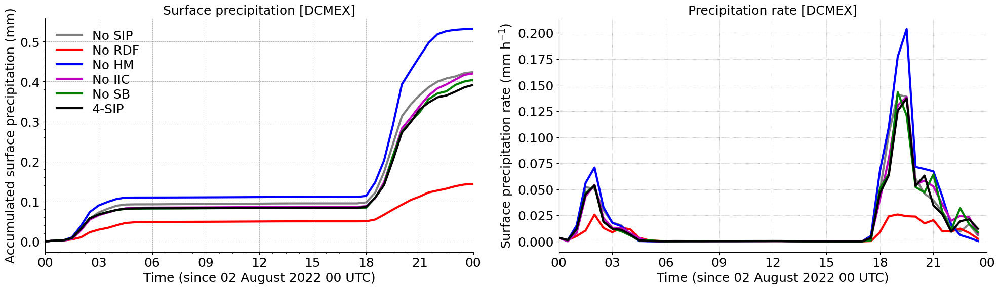

In [38]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
#plt.ylim(0, 0.2)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [DCMEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

#plt.ylim(0, 0.03)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [DCMEX]', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


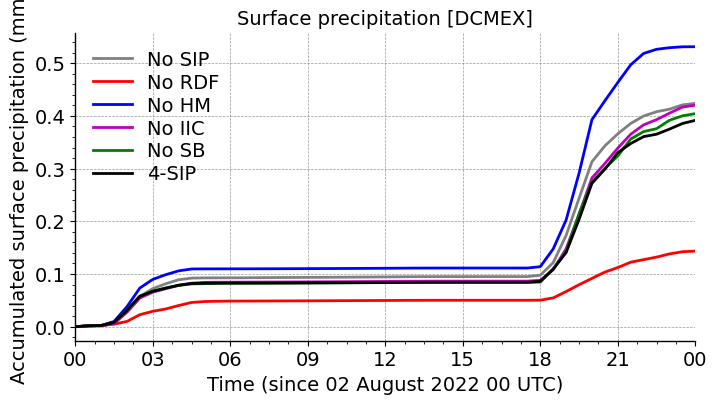

In [40]:


fontsize=14
linwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
#plt.ylim(0, 0.2)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [DCMEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


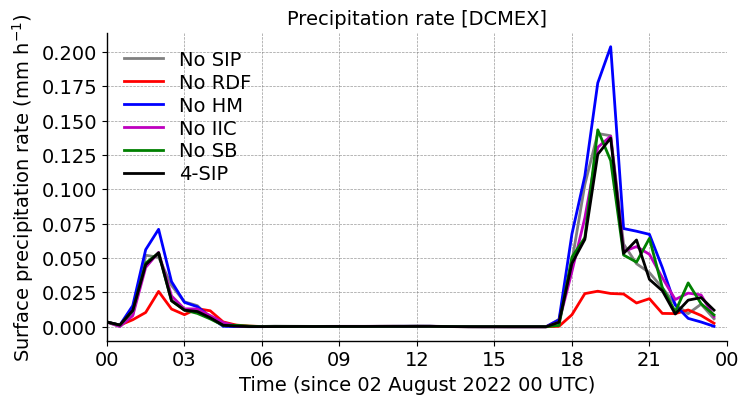

In [44]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
#plt.ylim(0, 0.03)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 02 August 2022 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2022, 8, 2, 0, 0) 
end_date = datetime(2022, 8, 3, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [DCMEX]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))


plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


## Ice number concentrations

In [55]:


thres_w = 2.
mean_tot_inc_up_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_norf = ds_norf.inc_perl.where(ds_norf.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel > thres_w).mean(dim=('time','ncells'))

mean_tot_inc_dn_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_norf = ds_norf.inc_perl.where(ds_norf.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel < -1*thres_w).mean(dim=('time','ncells'))



In [56]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_inc_up_nosip, mean_tot_inc_up_4sip, mean_tot_inc_up_norf, mean_tot_inc_up_nohm, 
             mean_tot_inc_up_nobr, mean_tot_inc_up_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_up_nosip = numpy_variables[0]
mean_tot_inc_up_4sip = numpy_variables[1]
mean_tot_inc_up_norf = numpy_variables[2]
mean_tot_inc_up_nohm = numpy_variables[3]
mean_tot_inc_up_nobr = numpy_variables[4]
mean_tot_inc_up_nosb = numpy_variables[5]


variables = [mean_tot_inc_dn_nosip, mean_tot_inc_dn_4sip, mean_tot_inc_dn_norf, mean_tot_inc_dn_nohm, 
             mean_tot_inc_dn_nobr, mean_tot_inc_dn_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_dn_nosip = numpy_variables[0]
mean_tot_inc_dn_4sip = numpy_variables[1]
mean_tot_inc_dn_norf = numpy_variables[2]
mean_tot_inc_dn_nohm = numpy_variables[3]
mean_tot_inc_dn_nobr = numpy_variables[4]
mean_tot_inc_dn_nosb = numpy_variables[5]


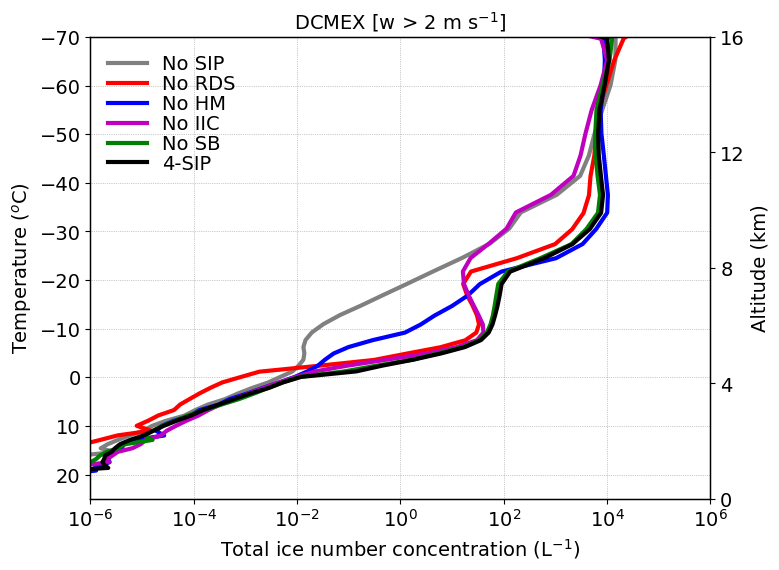

In [63]:
fontsize=14;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0.0, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-6, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [w > 2 m s$^{-1}$]', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

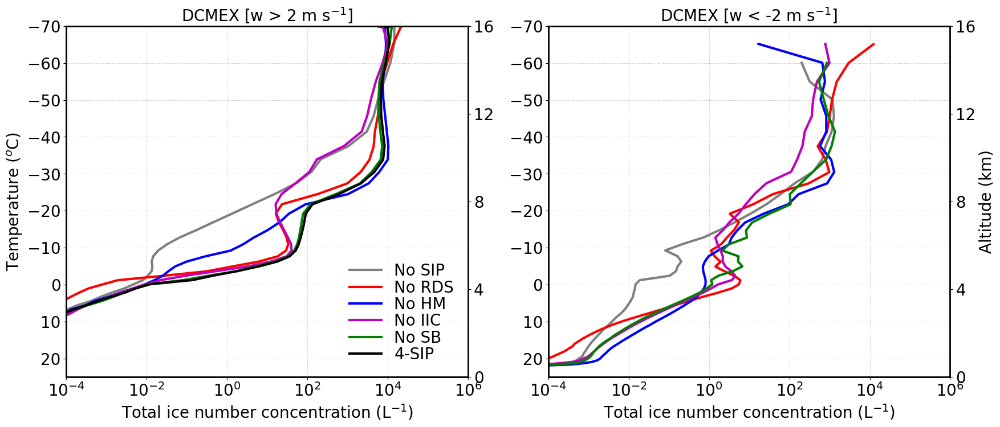

In [59]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('DCMEX [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_dn_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_dn_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_dn_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_dn_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_dn_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_inc_dn_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [w < -2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


### Mass and number mixing ratios of hydrometeors

In [45]:

thres_q = 1.e-12

mean_qc_4sip = ds_4sip.qc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_4sip = ds_4sip.qr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_4sip = ds_4sip.qi.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_4sip = ds_4sip.qs.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_4sip = ds_4sip.qg.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_4sip = ds_4sip.qh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_4sip, mean_qr_4sip, mean_qi_4sip, mean_qs_4sip, mean_qg_4sip, mean_qh_4sip]
numpy_variables = [var.values for var in variables]

mean_qc_4sip = numpy_variables[0]
mean_qr_4sip = numpy_variables[1]
mean_qi_4sip = numpy_variables[2]
mean_qs_4sip = numpy_variables[3]
mean_qg_4sip = numpy_variables[4]
mean_qh_4sip = numpy_variables[5]

mean_qnc_4sip = ds_4sip.qnc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_4sip = ds_4sip.qnr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_4sip = ds_4sip.qni.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_4sip = ds_4sip.qns.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_4sip = ds_4sip.qng.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_4sip = ds_4sip.qnh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_4sip, mean_qnr_4sip, mean_qni_4sip, mean_qns_4sip, mean_qng_4sip, mean_qnh_4sip]
numpy_variables = [var.values for var in variables]

mean_qnc_4sip = numpy_variables[0]
mean_qnr_4sip = numpy_variables[1]
mean_qni_4sip = numpy_variables[2]
mean_qns_4sip = numpy_variables[3]
mean_qng_4sip = numpy_variables[4]
mean_qnh_4sip = numpy_variables[5]


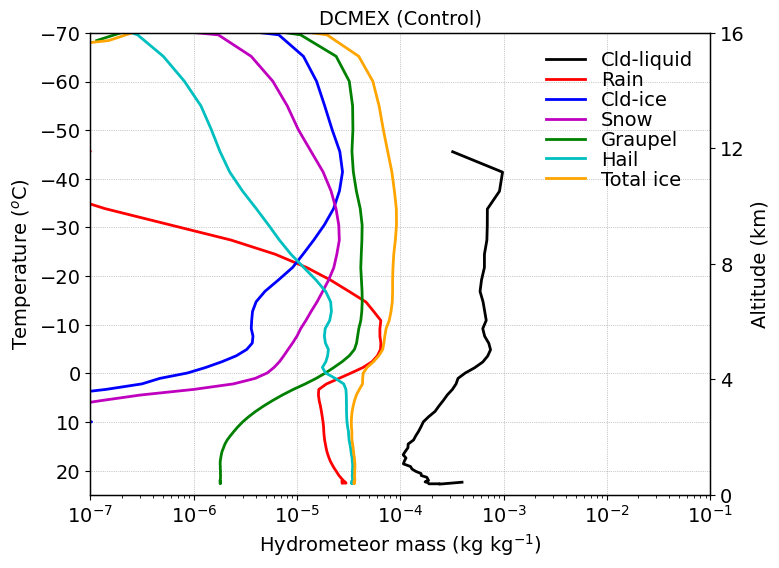

In [59]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


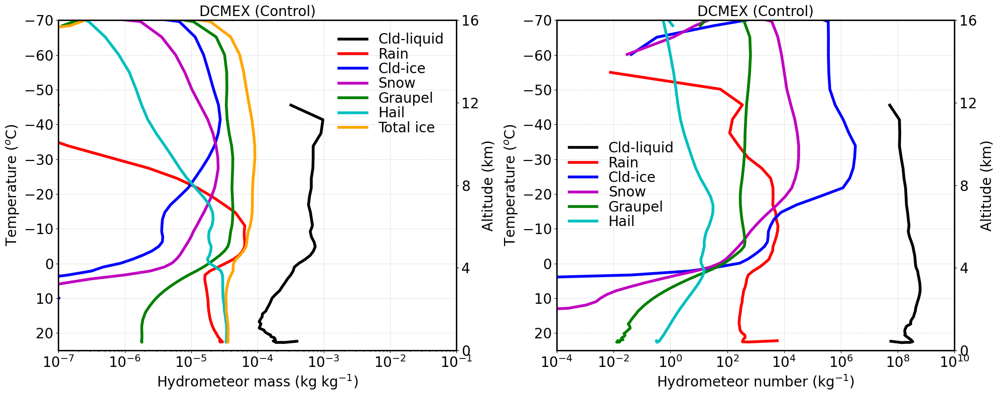

In [60]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [71]:

thres_q = 1.e-12

mean_qc_nosip = ds_nosip.qc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosip = ds_nosip.qr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosip = ds_nosip.qi.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosip = ds_nosip.qs.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosip = ds_nosip.qg.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosip = ds_nosip.qh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosip, mean_qr_nosip, mean_qi_nosip, mean_qs_nosip, mean_qg_nosip, mean_qh_nosip]
numpy_variables = [var.values for var in variables]

mean_qc_nosip = numpy_variables[0]
mean_qr_nosip = numpy_variables[1]
mean_qi_nosip = numpy_variables[2]
mean_qs_nosip = numpy_variables[3]
mean_qg_nosip = numpy_variables[4]
mean_qh_nosip = numpy_variables[5]

mean_qnc_nosip = ds_nosip.qnc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosip = ds_nosip.qnr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosip = ds_nosip.qni.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosip = ds_nosip.qns.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosip = ds_nosip.qng.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosip = ds_nosip.qnh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosip, mean_qnr_nosip, mean_qni_nosip, mean_qns_nosip, mean_qng_nosip, mean_qnh_nosip]
numpy_variables = [var.values for var in variables]

mean_qnc_nosip = numpy_variables[0]
mean_qnr_nosip = numpy_variables[1]
mean_qni_nosip = numpy_variables[2]
mean_qns_nosip = numpy_variables[3]
mean_qng_nosip = numpy_variables[4]
mean_qnh_nosip = numpy_variables[5]


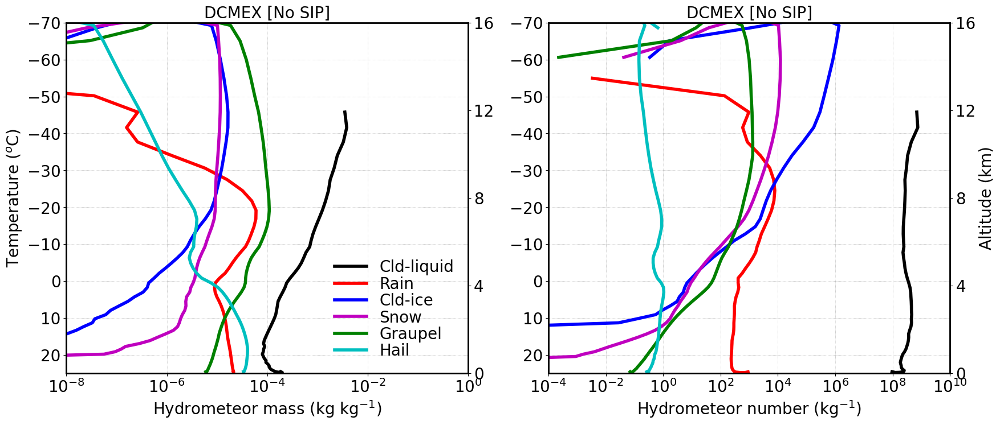

In [72]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [19]:
thres_q = 1.e-12

mean_qc_norf = ds_norf.qc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_norf = ds_norf.qr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_norf = ds_norf.qi.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_norf = ds_norf.qs.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_norf = ds_norf.qg.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_norf = ds_norf.qh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_norf, mean_qr_norf, mean_qi_norf, mean_qs_norf, mean_qg_norf, mean_qh_norf]
numpy_variables = [var.values for var in variables]

mean_qc_norf = numpy_variables[0]
mean_qr_norf = numpy_variables[1]
mean_qi_norf = numpy_variables[2]
mean_qs_norf = numpy_variables[3]
mean_qg_norf = numpy_variables[4]
mean_qh_norf = numpy_variables[5]

mean_qnc_norf = ds_norf.qnc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_norf = ds_norf.qnr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_norf = ds_norf.qni.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_norf = ds_norf.qns.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_norf = ds_norf.qng.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_norf = ds_norf.qnh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_norf, mean_qnr_norf, mean_qni_norf, mean_qns_norf, mean_qng_norf, mean_qnh_norf]
numpy_variables = [var.values for var in variables]

mean_qnc_norf = numpy_variables[0]
mean_qnr_norf = numpy_variables[1]
mean_qni_norf = numpy_variables[2]
mean_qns_norf = numpy_variables[3]
mean_qng_norf = numpy_variables[4]
mean_qnh_norf = numpy_variables[5]

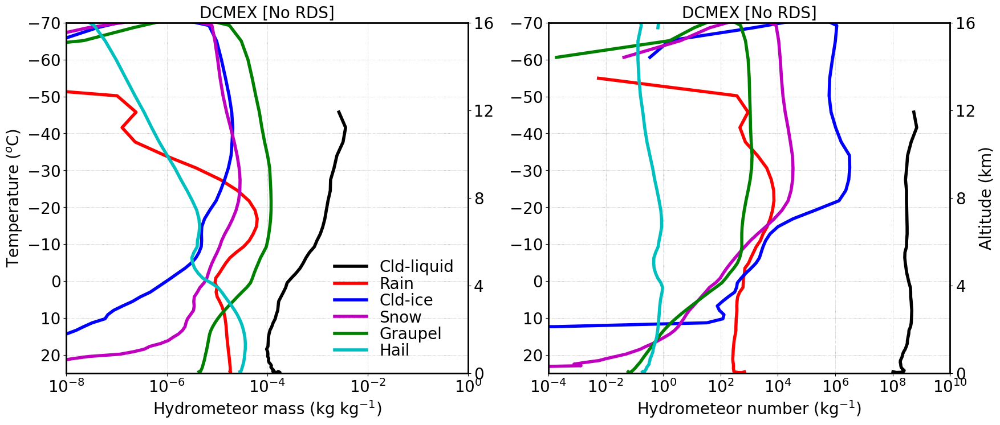

In [74]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [75]:
thres_q = 1.e-12

mean_qc_nohm = ds_nohm.qc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nohm = ds_nohm.qr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nohm = ds_nohm.qi.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nohm = ds_nohm.qs.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nohm = ds_nohm.qg.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nohm = ds_nohm.qh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nohm, mean_qr_nohm, mean_qi_nohm, mean_qs_nohm, mean_qg_nohm, mean_qh_nohm]
numpy_variables = [var.values for var in variables]

mean_qc_nohm = numpy_variables[0]
mean_qr_nohm = numpy_variables[1]
mean_qi_nohm = numpy_variables[2]
mean_qs_nohm = numpy_variables[3]
mean_qg_nohm = numpy_variables[4]
mean_qh_nohm = numpy_variables[5]

mean_qnc_nohm = ds_nohm.qnc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nohm = ds_nohm.qnr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nohm = ds_nohm.qni.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nohm = ds_nohm.qns.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nohm = ds_nohm.qng.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nohm = ds_nohm.qnh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nohm, mean_qnr_nohm, mean_qni_nohm, mean_qns_nohm, mean_qng_nohm, mean_qnh_nohm]
numpy_variables = [var.values for var in variables]

mean_qnc_nohm = numpy_variables[0]
mean_qnr_nohm = numpy_variables[1]
mean_qni_nohm = numpy_variables[2]
mean_qns_nohm = numpy_variables[3]
mean_qng_nohm = numpy_variables[4]
mean_qnh_nohm = numpy_variables[5]

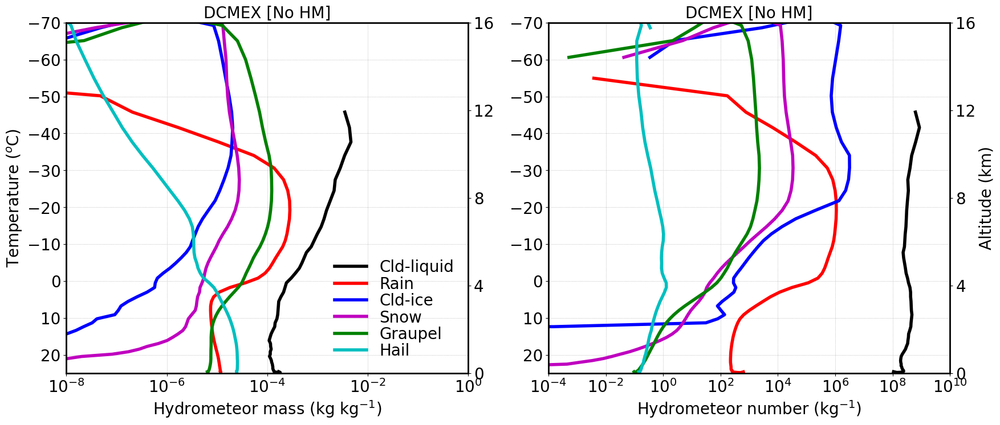

In [76]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [77]:
thres_q = 1.e-12

mean_qc_nobr = ds_nobr.qc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nobr = ds_nobr.qr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nobr = ds_nobr.qi.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nobr = ds_nobr.qs.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nobr = ds_nobr.qg.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nobr = ds_nobr.qh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nobr, mean_qr_nobr, mean_qi_nobr, mean_qs_nobr, mean_qg_nobr, mean_qh_nobr]
numpy_variables = [var.values for var in variables]

mean_qc_nobr = numpy_variables[0]
mean_qr_nobr = numpy_variables[1]
mean_qi_nobr = numpy_variables[2]
mean_qs_nobr = numpy_variables[3]
mean_qg_nobr = numpy_variables[4]
mean_qh_nobr = numpy_variables[5]

mean_qnc_nobr = ds_nobr.qnc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nobr = ds_nobr.qnr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nobr = ds_nobr.qni.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nobr = ds_nobr.qns.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nobr = ds_nobr.qng.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nobr = ds_nobr.qnh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nobr, mean_qnr_nobr, mean_qni_nobr, mean_qns_nobr, mean_qng_nobr, mean_qnh_nobr]
numpy_variables = [var.values for var in variables]

mean_qnc_nobr = numpy_variables[0]
mean_qnr_nobr = numpy_variables[1]
mean_qni_nobr = numpy_variables[2]
mean_qns_nobr = numpy_variables[3]
mean_qng_nobr = numpy_variables[4]
mean_qnh_nobr = numpy_variables[5]


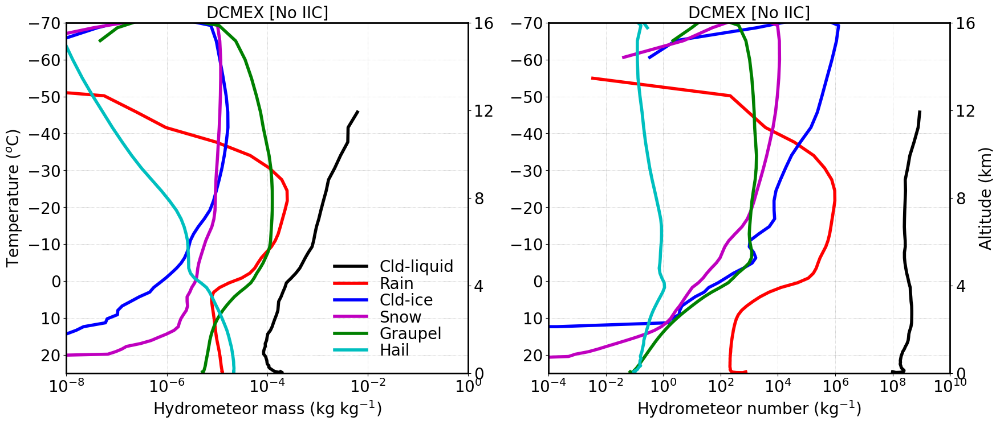

In [78]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [20]:
thres_q = 1.e-12

mean_qc_nosb = ds_nosb.qc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosb = ds_nosb.qr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosb = ds_nosb.qi.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosb = ds_nosb.qs.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosb = ds_nosb.qg.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosb = ds_nosb.qh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosb, mean_qr_nosb, mean_qi_nosb, mean_qs_nosb, mean_qg_nosb, mean_qh_nosb]
numpy_variables = [var.values for var in variables]

mean_qc_nosb = numpy_variables[0]
mean_qr_nosb = numpy_variables[1]
mean_qi_nosb = numpy_variables[2]
mean_qs_nosb = numpy_variables[3]
mean_qg_nosb = numpy_variables[4]
mean_qh_nosb = numpy_variables[5]

mean_qnc_nosb = ds_nosb.qnc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosb = ds_nosb.qnr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosb = ds_nosb.qni.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosb = ds_nosb.qns.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosb = ds_nosb.qng.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosb = ds_nosb.qnh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosb, mean_qnr_nosb, mean_qni_nosb, mean_qns_nosb, mean_qng_nosb, mean_qnh_nosb]
numpy_variables = [var.values for var in variables]

mean_qnc_nosb = numpy_variables[0]
mean_qnr_nosb = numpy_variables[1]
mean_qni_nosb = numpy_variables[2]
mean_qns_nosb = numpy_variables[3]
mean_qng_nosb = numpy_variables[4]
mean_qnh_nosb = numpy_variables[5]

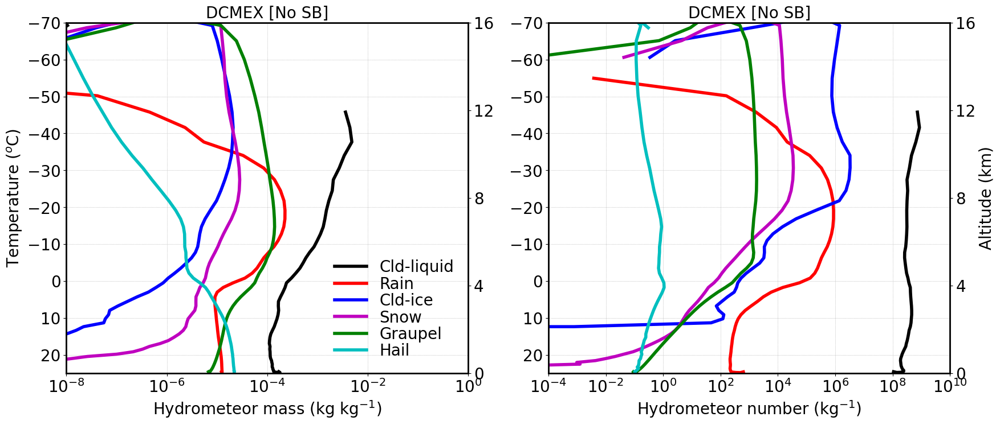

In [21]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [75]:
ds_4sip

<xarray.Dataset> Size: 85GB
Dimensions:            (time: 49, ncells: 66204, vertices: 3, height: 65,
                        bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time               (time) datetime64[ns] 392B 2022-08-02 ... 2022-08-03
    clon               (ncells) float64 530kB dask.array<chunksize=(66204,), meta=np.ndarray>
    clat               (ncells) float64 530kB dask.array<chunksize=(66204,), meta=np.ndarray>
  * height             (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2           (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev               (plev) float64 8B 800.0
  * plev_2             (plev_2) float64 8B 400.0
  * plev_3             (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/121)
    clon_bnds          (time, ncells, vertices) float64 78MB dask.array<chunksize=(1, 66204, 3), meta=np.ndarray>
    clat_bnds          (time, ncells, vertices) float64 78MB dask.array<chunksize=(1, 66204, 3), meta=np.ndarray>
    height_bnds        (time, height, bnds) float64 51kB dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds          (time, plev, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds        (time, plev_2, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds        (time, plev_3, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                 ...
    tqi                (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
    tq                 (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
    ciwc_gperm3        (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
    tiwc_gperm3        (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
    cdnc_percm3        (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
    inc_perl           (time, height, ncells) float32 843MB dask.array<chunksize=(1, 65, 66204), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          abe8179f-fe02-6b29-3f4c-0fbba1202ee0
    uuidOfVGrid:          6cfef922-1411-632f-5ac4-b8b019962b40
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: f3f9a5624ca4223a7fe2f0c...
    history:              /home/b/b382718/continental_cases/4sip/icon-oct2024...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l10747 (Linux 4.18.0-513....

(20.0, -80.0)

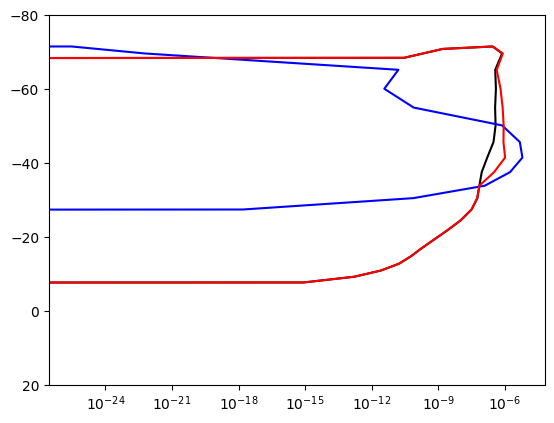

In [74]:

plt.plot(ds_4sip.d_qi_het.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-')
plt.plot(ds_4sip.d_qi_hom.mean(dim=('time','ncells')), mean_tempc_4sip, 'b-')
plt.plot(ds_4sip.d_qi_homhet.mean(dim=('time','ncells')), mean_tempc_4sip, 'r-')
plt.xscale('log')
plt.ylim(20,-80)

# Process rates
### 1. Process rates of SIPs
#### mass and number mixing ratio 

In [6]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = 1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel > thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')


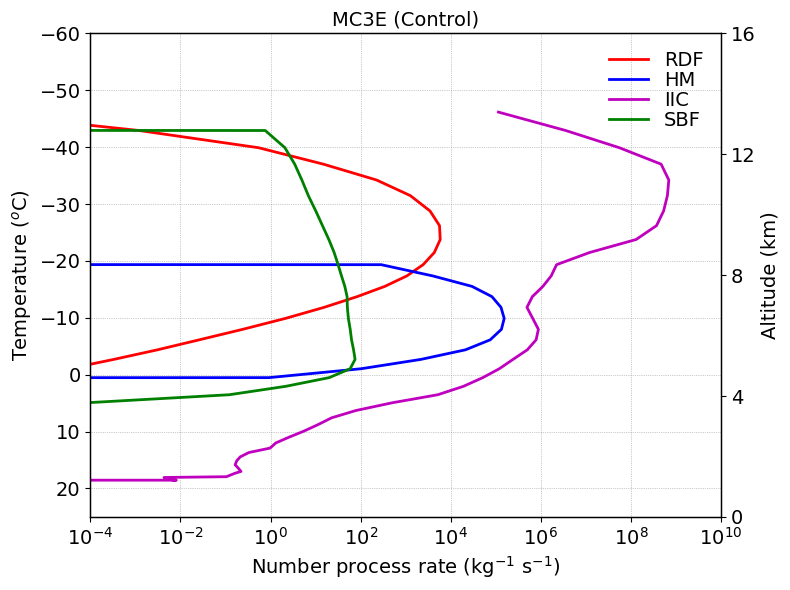

In [10]:

mean_qni_rf_4sip = mean_qni_rf_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_hm_4sip = mean_qni_hm_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_br_4sip = mean_qni_br_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_sb_4sip = mean_qni_sb_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip.where(mean_tempc_4sip > -50., np.nan)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
##plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('MC3E (Control)', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


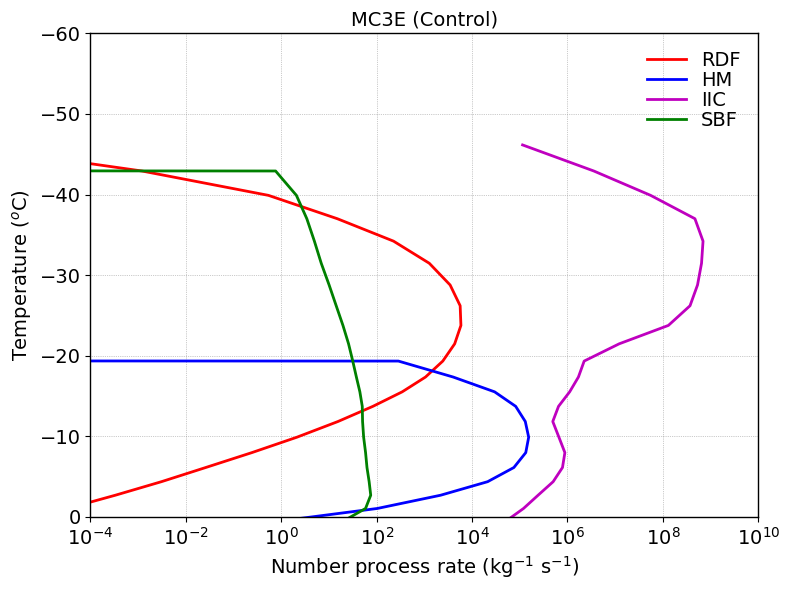

In [7]:

mean_qni_rf_4sip = mean_qni_rf_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_hm_4sip = mean_qni_hm_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_br_4sip = mean_qni_br_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_sb_4sip = mean_qni_sb_4sip.where(mean_tempc_4sip > -50., np.nan)
mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip.where(mean_tempc_4sip > -50., np.nan)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
#plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
##plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

#plt2.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -60)
#plt2.set_ylim(0.3, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([0, -10, -20, -30, -40, -50, -60])
#plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('MC3E (Control)', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [62]:

thres_q = 1.e-14

mean_qi_homhet_4sip = ds_4sip.d_qi_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_hom_4sip = ds_4sip.d_qi_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_het_4sip = ds_4sip.d_qi_het.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qi_homhet_4sip, mean_qi_hom_4sip, mean_qi_het_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_homhet_4sip = numpy_variables[0]
mean_qi_hom_4sip = numpy_variables[1]
mean_qi_het_4sip = numpy_variables[2]

mean_qi_tot_sec_4sip = ds_4sip.dqi_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_rf_4sip = ds_4sip.dqi_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_hm_4sip = ds_4sip.dqi_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_br_4sip = ds_4sip.dqi_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_snow_4sip = ds_4sip.dqi_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_graup_4sip = ds_4sip.dqi_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_4sip = mean_qi_sb_snow_4sip + mean_qi_sb_graup_4sip

mean_qni_tot_sec_4sip = ds_4sip.dqni_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_rf_4sip = ds_4sip.dqni_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_hm_4sip = ds_4sip.dqni_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_br_4sip = ds_4sip.dqni_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = ds_4sip.dqni_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = ds_4sip.dqni_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

variables = [mean_qi_tot_sec_4sip, mean_qi_rf_4sip, mean_qi_hm_4sip, mean_qi_br_4sip, mean_qi_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_tot_sec_4sip = numpy_variables[0]
mean_qi_rf_4sip = numpy_variables[1]
mean_qi_hm_4sip = numpy_variables[2]
mean_qi_br_4sip = numpy_variables[3]
mean_qi_sb_4sip = numpy_variables[4]

variables = [mean_qni_tot_sec_4sip, mean_qni_rf_4sip, mean_qni_hm_4sip, mean_qni_br_4sip, mean_qni_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qni_tot_sec_4sip = numpy_variables[0]
mean_qni_rf_4sip = numpy_variables[1]
mean_qni_hm_4sip = numpy_variables[2]
mean_qni_br_4sip = numpy_variables[3]
mean_qni_sb_4sip = numpy_variables[4]


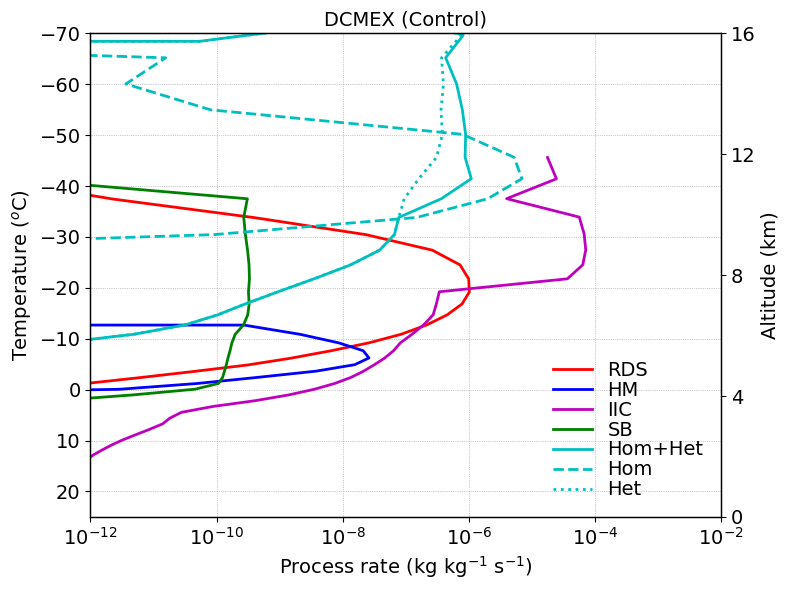

In [63]:
fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('DCMEX (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()

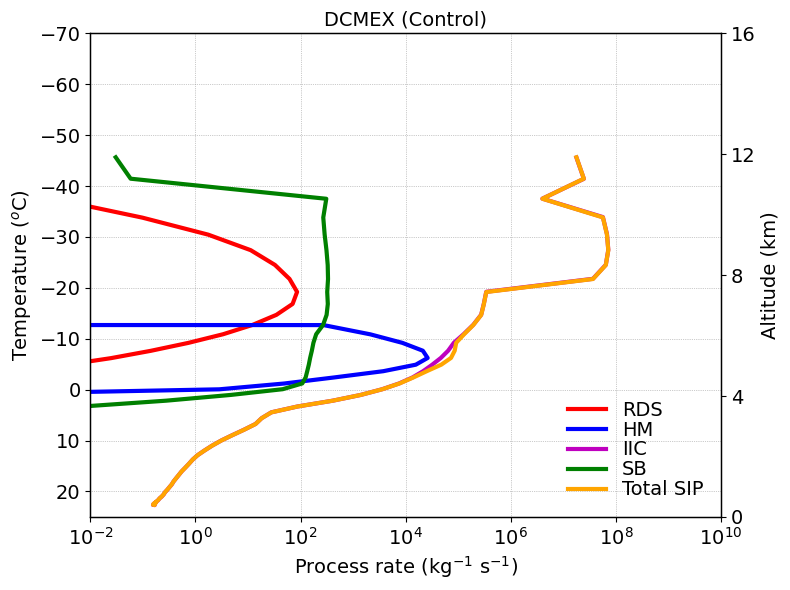

In [65]:


mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

fontsize=14;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total SIP')


#plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
#plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
#plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')

plt2.plot(mean_qni_rf_4sip*fact, mean_ht_norf, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-2, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('DCMEX (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()

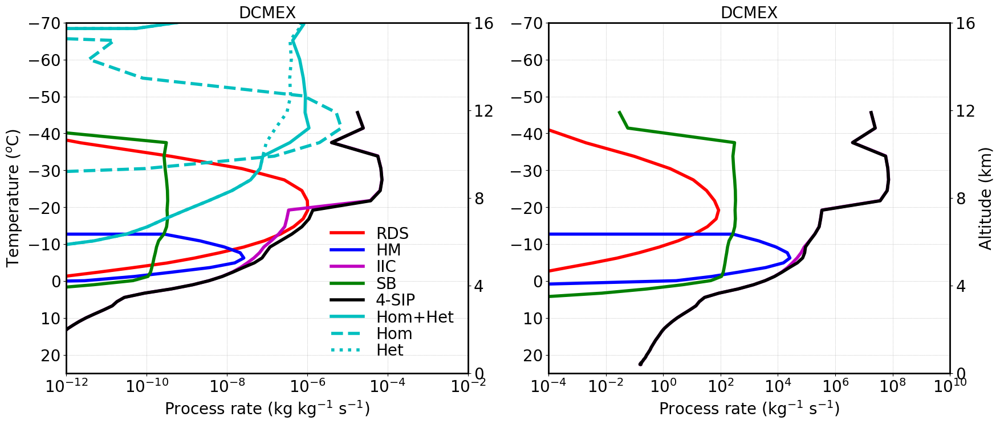

In [100]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


## Process rates of riming, deposition, nucleation, freezing

In [8]:

thres_q = 1.e-8

# Riming
mean_dq_tot_rime_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).mean(dim=('time','ncells'))

# Deposition
mean_dq_tot_dep_4sip = ds_4sip.d_qi_dep+ds_4sip.d_qs_dep+ds_4sip.d_qg_dep+ds_4sip.d_qh_dep
mean_dq_tot_dep_nosip = ds_nosip.d_qi_dep+ds_nosip.d_qs_dep+ds_nosip.d_qg_dep+ds_nosip.d_qh_dep
mean_dq_tot_dep_norf = ds_norf.d_qi_dep+ds_norf.d_qs_dep+ds_norf.d_qg_dep+ds_norf.d_qh_dep
mean_dq_tot_dep_nohm = ds_nohm.d_qi_dep+ds_nohm.d_qs_dep+ds_nohm.d_qg_dep+ds_nohm.d_qh_dep
mean_dq_tot_dep_nobr = ds_nobr.d_qi_dep+ds_nobr.d_qs_dep+ds_nobr.d_qg_dep+ds_nobr.d_qh_dep
mean_dq_tot_dep_nosb = ds_nosb.d_qi_dep+ds_nosb.d_qs_dep+ds_nosb.d_qg_dep+ds_nosb.d_qh_dep

mean_dq_tot_dep_4sip = xr.where(mean_dq_tot_dep_4sip > thres_q, mean_dq_tot_dep_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosip = xr.where(mean_dq_tot_dep_nosip > thres_q, mean_dq_tot_dep_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_norf = xr.where(mean_dq_tot_dep_norf > thres_q, mean_dq_tot_dep_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nohm = xr.where(mean_dq_tot_dep_nohm > thres_q, mean_dq_tot_dep_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nobr = xr.where(mean_dq_tot_dep_nobr > thres_q, mean_dq_tot_dep_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosb = xr.where(mean_dq_tot_dep_nosb > thres_q, mean_dq_tot_dep_nosb, np.nan).mean(dim=('time','ncells'))

# Saturation adjustment
mean_dq_satad1_4sip = xr.where(ds_4sip.d_satad > thres_q, ds_4sip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosip = xr.where(ds_nosip.d_satad > thres_q, ds_nosip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_norf = xr.where(ds_norf.d_satad > thres_q, ds_norf.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nohm = xr.where(ds_nohm.d_satad > thres_q, ds_nohm.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nobr = xr.where(ds_nobr.d_satad > thres_q, ds_nobr.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosb = xr.where(ds_nosb.d_satad > thres_q, ds_nosb.d_satad, np.nan).mean(dim=('time','ncells'))

mean_dq_satad2_4sip = xr.where(ds_4sip.d_satad2 > thres_q, ds_4sip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosip = xr.where(ds_nosip.d_satad2 > thres_q, ds_nosip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_norf = xr.where(ds_norf.d_satad2 > thres_q, ds_norf.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nohm = xr.where(ds_nohm.d_satad2 > thres_q, ds_nohm.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nobr = xr.where(ds_nobr.d_satad2 > thres_q, ds_nobr.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosb = xr.where(ds_nosb.d_satad2 > thres_q, ds_nosb.d_satad2, np.nan).mean(dim=('time','ncells'))

# Hom+het ice nucleation
mean_dq_homhet_4sip = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosip = xr.where(ds_nosip.d_qi_homhet > thres_q, ds_nosip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_norf = xr.where(ds_norf.d_qi_homhet > thres_q, ds_norf.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nohm = xr.where(ds_nohm.d_qi_homhet > thres_q, ds_nohm.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nobr = xr.where(ds_nobr.d_qi_homhet > thres_q, ds_nobr.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosb = xr.where(ds_nosb.d_qi_homhet > thres_q, ds_nosb.d_qi_homhet, np.nan).mean(dim=('time','ncells'))

# Hom ice nucleation
mean_dq_hom_4sip = xr.where(ds_4sip.d_qi_hom > thres_q, ds_4sip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosip = xr.where(ds_nosip.d_qi_hom > thres_q, ds_nosip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_norf = xr.where(ds_norf.d_qi_hom > thres_q, ds_norf.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nohm = xr.where(ds_nohm.d_qi_hom > thres_q, ds_nohm.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nobr = xr.where(ds_nobr.d_qi_hom > thres_q, ds_nobr.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosb = xr.where(ds_nosb.d_qi_hom > thres_q, ds_nosb.d_qi_hom, np.nan).mean(dim=('time','ncells'))

# het ice nucleation
mean_dq_het_4sip = xr.where(ds_4sip.d_qi_het > thres_q, ds_4sip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosip = xr.where(ds_nosip.d_qi_het > thres_q, ds_nosip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_norf = xr.where(ds_norf.d_qi_het > thres_q, ds_norf.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nohm = xr.where(ds_nohm.d_qi_het > thres_q, ds_nohm.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nobr = xr.where(ds_nobr.d_qi_het > thres_q, ds_nobr.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosb = xr.where(ds_nosb.d_qi_het > thres_q, ds_nosb.d_qi_het, np.nan).mean(dim=('time','ncells'))

# Rain freezing
mean_dq_rainfreez_4sip = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_nosip = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_norf = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_nohm = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_nobr = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_nosb = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf

mean_dq_rainfreez_4sip = xr.where(mean_dq_rainfreez_4sip > thres_q, mean_dq_rainfreez_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosip = xr.where(mean_dq_rainfreez_nosip > thres_q, mean_dq_rainfreez_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_norf = xr.where(mean_dq_rainfreez_norf > thres_q, mean_dq_rainfreez_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nohm = xr.where(mean_dq_rainfreez_nohm > thres_q, mean_dq_rainfreez_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nobr = xr.where(mean_dq_rainfreez_nobr > thres_q, mean_dq_rainfreez_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosb = xr.where(mean_dq_rainfreez_nosb > thres_q, mean_dq_rainfreez_nosb, np.nan).mean(dim=('time','ncells'))

# Evaporation
mean_dq_evap_4sip = ds_4sip.d_qr_evap+ds_4sip.d_qsgh_evap
mean_dq_evap_nosip = ds_nosip.d_qr_evap+ds_nosip.d_qsgh_evap
mean_dq_evap_norf = ds_norf.d_qr_evap+ds_norf.d_qsgh_evap
mean_dq_evap_nohm = ds_nohm.d_qr_evap+ds_nohm.d_qsgh_evap
mean_dq_evap_nobr = ds_nobr.d_qr_evap+ds_nobr.d_qsgh_evap
mean_dq_evap_nosb = ds_nosb.d_qr_evap+ds_nosb.d_qsgh_evap

mean_dq_evap_4sip = xr.where(mean_dq_evap_4sip > thres_q, mean_dq_evap_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosip = xr.where(mean_dq_evap_nosip > thres_q, mean_dq_evap_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_norf = xr.where(mean_dq_evap_norf > thres_q, mean_dq_evap_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nohm = xr.where(mean_dq_evap_nohm > thres_q, mean_dq_evap_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nobr = xr.where(mean_dq_evap_nobr > thres_q, mean_dq_evap_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosb = xr.where(mean_dq_evap_nosb > thres_q, mean_dq_evap_nosb, np.nan).mean(dim=('time','ncells'))

# Melting
mean_dq_melt_4sip = ds_4sip.d_qc_melt+ds_4sip.d_qr_melt
mean_dq_melt_nosip = ds_nosip.d_qc_melt+ds_nosip.d_qr_melt
mean_dq_melt_norf = ds_norf.d_qc_melt+ds_norf.d_qr_melt
mean_dq_melt_nohm = ds_nohm.d_qc_melt+ds_nohm.d_qr_melt
mean_dq_melt_nobr = ds_nobr.d_qc_melt+ds_nobr.d_qr_melt
mean_dq_melt_nosb = ds_nosb.d_qc_melt+ds_nosb.d_qr_melt

mean_dq_melt_4sip = xr.where(mean_dq_melt_4sip > thres_q, mean_dq_melt_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosip = xr.where(mean_dq_melt_nosip > thres_q, mean_dq_melt_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_norf = xr.where(mean_dq_melt_norf > thres_q, mean_dq_melt_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nohm = xr.where(mean_dq_melt_nohm > thres_q, mean_dq_melt_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nobr = xr.where(mean_dq_melt_nobr > thres_q, mean_dq_melt_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosb = xr.where(mean_dq_melt_nosb > thres_q, mean_dq_melt_nosb, np.nan).mean(dim=('time','ncells'))

# Nucleation

mean_dq_nuc_4sip = xr.where(ds_4sip.d_qc_nuc > thres_q, ds_4sip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosip = xr.where(ds_nosip.d_qc_nuc > thres_q, ds_nosip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_norf = xr.where(ds_norf.d_qc_nuc > thres_q, ds_norf.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nohm = xr.where(ds_nohm.d_qc_nuc > thres_q, ds_nohm.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nobr = xr.where(ds_nobr.d_qc_nuc > thres_q, ds_nobr.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosb = xr.where(ds_nosb.d_qc_nuc > thres_q, ds_nosb.d_qc_nuc, np.nan).mean(dim=('time','ncells'))


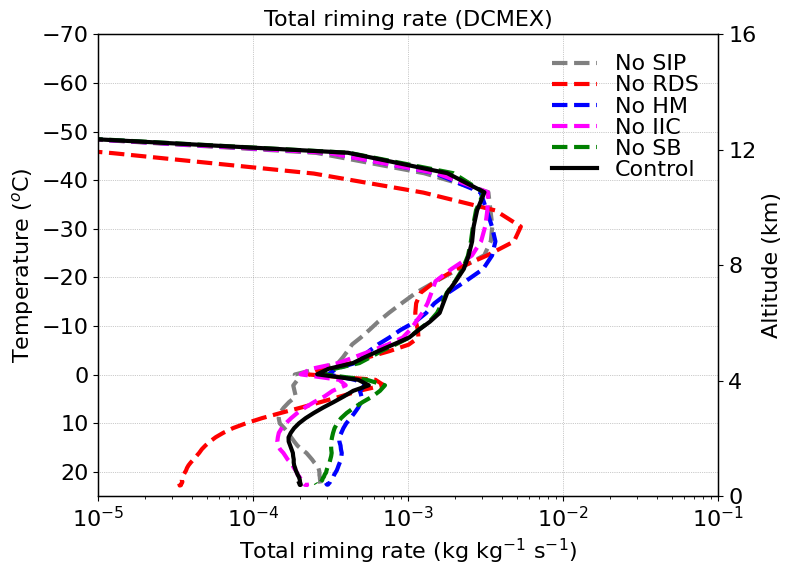

In [9]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_rime_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_rime_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_rime_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_rime_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_rime_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_rime_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_rime_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total riming rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total riming rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

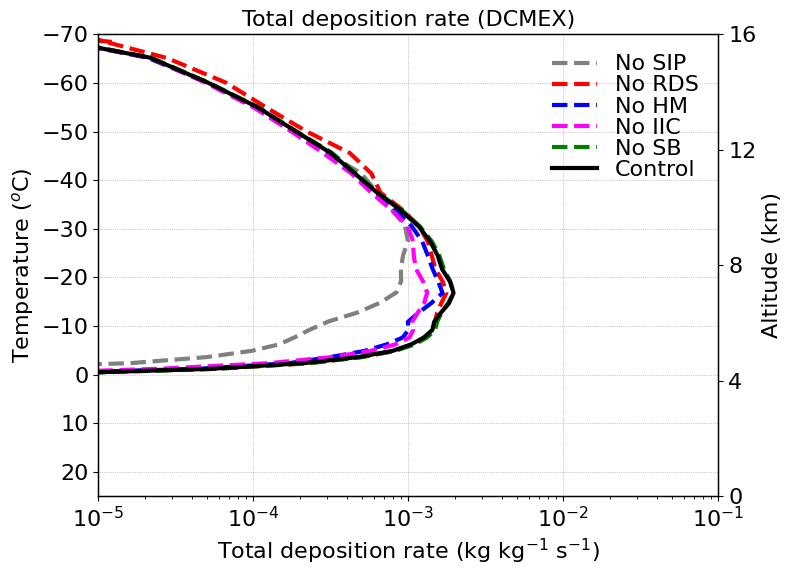

In [10]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_dep_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_dep_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_dep_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_dep_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_dep_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_dep_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_dep_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total deposition rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total deposition rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

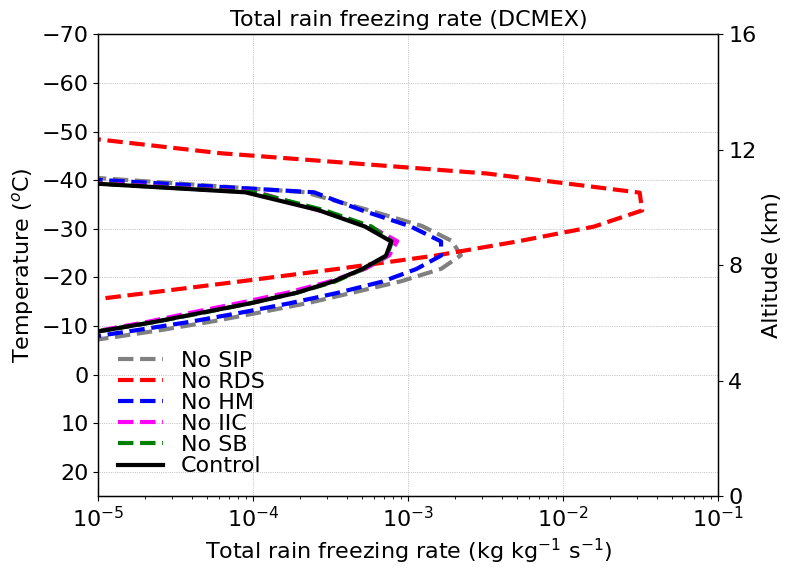

In [11]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_rainfreez_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_rainfreez_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_rainfreez_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_rainfreez_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_rainfreez_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_rainfreez_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_rainfreez_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total rain freezing rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total rain freezing rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

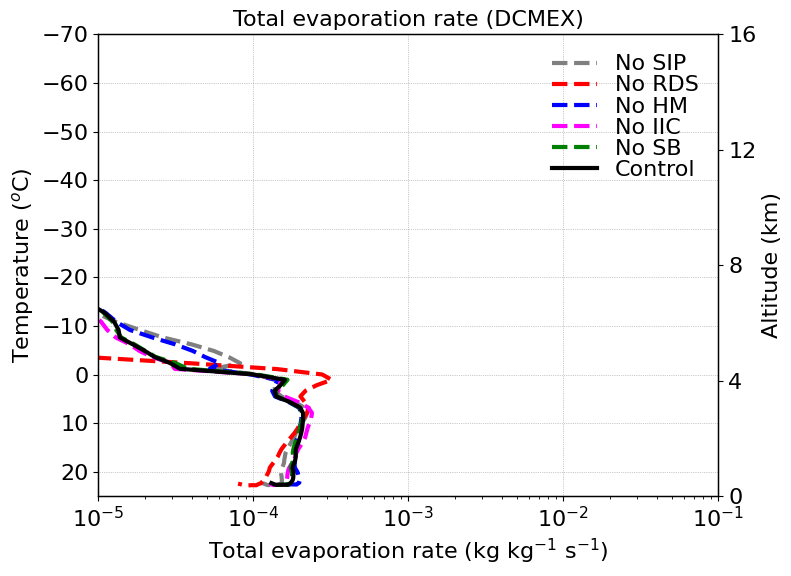

In [12]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_evap_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_evap_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_evap_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_evap_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_evap_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_evap_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_evap_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total evaporation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total evaporation rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

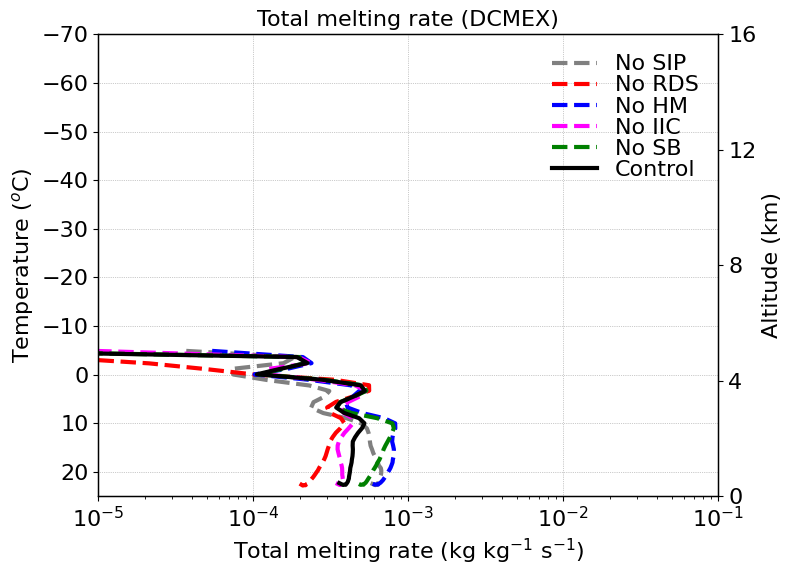

In [13]:

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_melt_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_melt_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_melt_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_melt_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_melt_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_melt_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_melt_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total melting rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total melting rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

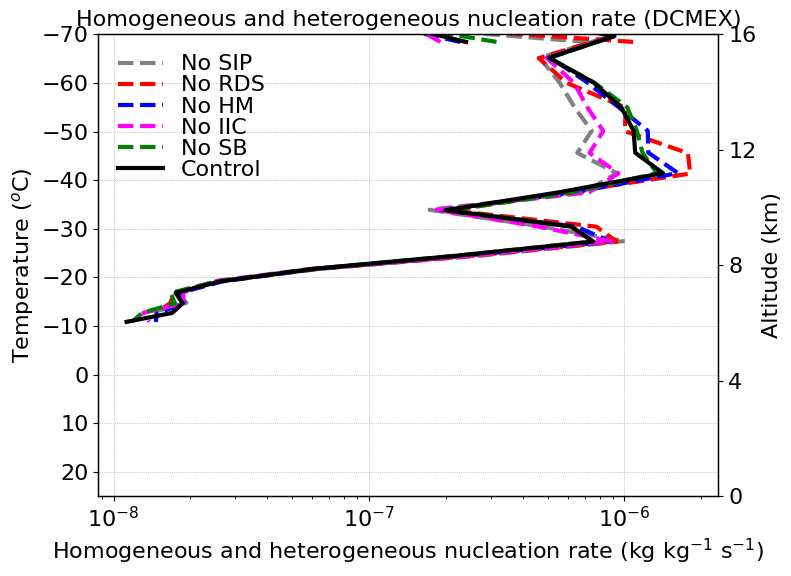

In [14]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_homhet_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_homhet_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_homhet_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_homhet_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_homhet_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_homhet_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_homhet_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control')

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
#plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(1.7, 16)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 4, 8, 12, 16])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Homogeneous and heterogeneous nucleation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Homogeneous and heterogeneous nucleation rate (DCMEX)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [126]:



w_thres = 2.
###### Without SIP
# lwc gperm3
#filt_lwc_up = xr.where((ds_nosip_new.lwc_gperm3 > 1.e-6) & (ds_nosip_new.w_vel > w_thres), ds_nosip_new.lwc_gperm3, np.nan)
#filt_lwc_dn = xr.where((ds_nosip_new.lwc_gperm3 > 1.e-6) & (ds_nosip_new.w_vel < -1.*w_thres), ds_nosip_new.lwc_gperm3, np.nan)
#filt_lwc_st = xr.where((ds_nosip_new.lwc_gperm3 > 1.e-6) & (np.abs(ds_nosip_new.w_vel) < w_thres), ds_nosip_new.lwc_gperm3, np.nan)

#lwc_up_nosip = filt_lwc_up.mean(dim=('time','ncells'))
#lwc_dn_nosip = filt_lwc_dn.mean(dim=('time','ncells'))
#lwc_st_nosip = filt_lwc_st.mean(dim=('time','ncells'))

#tempc_nosip = ds_nosip_new.tempc.mean(dim=('time','ncells'))

# iwc gperm3
#filt_tiwc_up = xr.where((ds_nosip_new.tiwc_gperm3 > 1.e-6) & (ds_nosip_new.w_vel > w_thres), ds_nosip_new.tiwc_gperm3, np.nan)
#filt_tiwc_dn = xr.where((ds_nosip_new.tiwc_gperm3 > 1.e-6) & (ds_nosip_new.w_vel < -1.*w_thres), ds_nosip_new.tiwc_gperm3, np.nan)
#filt_tiwc_st = xr.where((ds_nosip_new.tiwc_gperm3 > 1.e-6) & (np.abs(ds_nosip_new.w_vel) < w_thres), ds_nosip_new.tiwc_gperm3, np.nan)

#tiwc_up_nosip = filt_tiwc_up.mean(dim=('time','ncells'))
#tiwc_dn_nosip = filt_tiwc_dn.mean(dim=('time','ncells'))
#tiwc_st_nosip = filt_tiwc_st.mean(dim=('time','ncells'))

# CDNC percm3
#filt_cdnc_up = xr.where((ds_nosip_new.cdnc_percm3 > 1.e-6) & (ds_nosip_new.w_vel > w_thres), ds_nosip_new.cdnc_percm3, np.nan)
#filt_cdnc_dn = xr.where((ds_nosip_new.cdnc_percm3 > 1.e-6) & (ds_nosip_new.w_vel < -1.*w_thres), ds_nosip_new.cdnc_percm3, np.nan)
#filt_cdnc_st = xr.where((ds_nosip_new.cdnc_percm3 > 1.e-6) & (np.abs(ds_nosip_new.w_vel) < w_thres), ds_nosip_new.cdnc_percm3, np.nan)

#cdnc_up_nosip = filt_cdnc_up.mean(dim=('time','ncells'))
#cdnc_dn_nosip = filt_cdnc_dn.mean(dim=('time','ncells'))
#cdnc_st_nosip = filt_cdnc_st.mean(dim=('time','ncells'))

# inc gperm3
#filt_inc_up = xr.where((ds_nosip_new.inc_perl > 1.e-6) & (ds_nosip_new.w_vel > w_thres), ds_nosip_new.inc_perl, np.nan)
#filt_inc_dn = xr.where((ds_nosip_new.inc_perl > 1.e-6) & (ds_nosip_new.w_vel < -1.*w_thres), ds_nosip_new.inc_perl, np.nan)
#filt_inc_st = xr.where((ds_nosip_new.inc_perl > 1.e-6) & (np.abs(ds_nosip_new.w_vel) < w_thres), ds_nosip_new.inc_perl, np.nan)

#inc_up_nosip = filt_inc_up.mean(dim=('time','ncells'))
#inc_dn_nosip = filt_inc_dn.mean(dim=('time','ncells'))
#inc_st_nosip = filt_inc_st.mean(dim=('time','ncells'))


###### With SIP
# lwc gperm3
filt_lwc_up = xr.where((ds_4sip_new.lwc_gperm3 > 1.e-9) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.lwc_gperm3, np.nan)
filt_lwc_dn = xr.where((ds_4sip_new.lwc_gperm3 > 1.e-9) & (ds_4sip_new.w_vel < -1.*w_thres), ds_4sip_new.lwc_gperm3, np.nan)
filt_lwc_st = xr.where((ds_4sip_new.lwc_gperm3 > 1.e-9) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.lwc_gperm3, np.nan)

lwc_up_sip = filt_lwc_up.mean(dim=('time','ncells'))
lwc_dn_sip = filt_lwc_dn.mean(dim=('time','ncells'))
lwc_st_sip = filt_lwc_st.mean(dim=('time','ncells'))

tempc_sip = ds_4sip_new.tempc.mean(dim=('time','ncells'))

# iwc gperm3
filt_tiwc_up = xr.where((ds_4sip_new.tiwc_gperm3 > 1.e-6) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.tiwc_gperm3, np.nan)
filt_tiwc_dn = xr.where((ds_4sip_new.tiwc_gperm3 > 1.e-6) & (ds_4sip_new.w_vel < -1.*w_thres), ds_4sip_new.tiwc_gperm3, np.nan)
filt_tiwc_st = xr.where((ds_4sip_new.tiwc_gperm3 > 1.e-6) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.tiwc_gperm3, np.nan)

tiwc_up_sip = filt_tiwc_up.mean(dim=('time','ncells'))
tiwc_dn_sip = filt_tiwc_dn.mean(dim=('time','ncells'))
tiwc_st_sip = filt_tiwc_st.mean(dim=('time','ncells'))

# CDNC percm3
filt_cdnc_up = xr.where((ds_4sip_new.cdnc_percm3 > 1.e-6) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.cdnc_percm3, np.nan)
filt_cdnc_dn = xr.where((ds_4sip_new.cdnc_percm3 > 1.e-6) & (ds_4sip_new.w_vel < -1.*w_thres), ds_4sip_new.cdnc_percm3, np.nan)
filt_cdnc_st = xr.where((ds_4sip_new.cdnc_percm3 > 1.e-6) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.cdnc_percm3, np.nan)

cdnc_up_sip = filt_cdnc_up.mean(dim=('time','ncells'))
cdnc_dn_sip = filt_cdnc_dn.mean(dim=('time','ncells'))
cdnc_st_sip = filt_cdnc_st.mean(dim=('time','ncells'))


# inc gperm3
filt_inc_up = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.inc_perl, np.nan)
filt_inc_dn = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (ds_4sip_new.w_vel < -1.*w_thres), ds_4sip_new.inc_perl, np.nan)
filt_inc_st = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.inc_perl, np.nan)

inc_up_sip = filt_inc_up.mean(dim=('time','ncells'))
inc_dn_sip = filt_inc_dn.mean(dim=('time','ncells'))
inc_st_sip = filt_inc_st.mean(dim=('time','ncells'))


In [127]:

####================== Boxplot of ICON-LWC [4-SIP]
w_thres = 2.
thres_q = 1.e-6
###### Without SIP
# lwc gperm3
lwc_sip_up_gperm3 = xr.where((ds_4sip_new.qc > thres_q) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.lwc_gperm3, np.nan)
lwc_sip_dn_gperm3 = xr.where((ds_4sip_new.qc > thres_q) & (ds_4sip_new.w_vel > -1.*w_thres), ds_4sip_new.lwc_gperm3, np.nan)
lwc_sip_st_gperm3 = xr.where((ds_4sip_new.qc > thres_q) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.lwc_gperm3, np.nan)
tempc_sip = ds_4sip_new.tempc

lwc_sip_up_gperm3 = lwc_sip_up_gperm3.values.flatten()
lwc_sip_dn_gperm3 = lwc_sip_dn_gperm3.values.flatten()
lwc_sip_st_gperm3 = lwc_sip_st_gperm3.values.flatten()
tempc_sip = tempc_sip.values.flatten()

df_lwc_sip = pd.DataFrame({
    'lwc_up': lwc_sip_up_gperm3,
    'lwc_dn': lwc_sip_dn_gperm3,
    'lwc_st': lwc_sip_st_gperm3,
    'tempc': tempc_sip,
})

tempc_bin = np.arange(-50., 20., 5.)  # Temperature bins 
tempc_bin = np.sort(tempc_bin)

df_lwc_sip['temp_bin'] = np.digitize(df_lwc_sip['tempc'], bins=tempc_bin, right=False)

bin_edges = np.concatenate([tempc_bin - 2, [tempc_bin[-1] + 2]])  
df_lwc_sip['temp_bin'] = bin_edges[df_lwc_sip['temp_bin']]

df_lwc_up_sip = df_lwc_sip[['lwc_up', 'temp_bin']].dropna()
df_lwc_dn_sip = df_lwc_sip[['lwc_dn', 'temp_bin']].dropna()
df_lwc_st_sip = df_lwc_sip[['lwc_st', 'temp_bin']].dropna()

df_lwc_up_sip = df_lwc_up_sip.dropna(subset=['temp_bin'])
df_lwc_dn_sip = df_lwc_dn_sip.dropna(subset=['temp_bin'])
df_lwc_st_sip = df_lwc_st_sip.dropna(subset=['temp_bin'])

lwc_sip_up_by_bin = [df_lwc_up_sip[df_lwc_up_sip['temp_bin'] == temp]['lwc_up'].values for temp in bin_edges]
lwc_sip_dn_by_bin = [df_lwc_dn_sip[df_lwc_dn_sip['temp_bin'] == temp]['lwc_dn'].values for temp in bin_edges]
lwc_sip_st_by_bin = [df_lwc_st_sip[df_lwc_st_sip['temp_bin'] == temp]['lwc_st'].values for temp in bin_edges]


In [128]:

####================== Boxplot of ICON-CDNC [3-SIP]
w_thres = 2.
thres_q = 1.e-2
###### Without SIP
# lwc gperm3
cdnc_sip_up_percm3 = xr.where((ds_4sip_new.cdnc_percm3 > thres_q) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.cdnc_percm3, np.nan)
cdnc_sip_dn_percm3 = xr.where((ds_4sip_new.cdnc_percm3 > thres_q) & (ds_4sip_new.w_vel > -1.*w_thres), ds_4sip_new.cdnc_percm3, np.nan)
cdnc_sip_st_percm3 = xr.where((ds_4sip_new.cdnc_percm3 > thres_q) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.cdnc_percm3, np.nan)
tempc_sip = ds_4sip_new.tempc

cdnc_sip_up_percm3 = cdnc_sip_up_percm3.values.flatten()
cdnc_sip_dn_percm3 = cdnc_sip_dn_percm3.values.flatten()
cdnc_sip_st_percm3 = cdnc_sip_st_percm3.values.flatten()
tempc_sip = tempc_sip.values.flatten()

df_cdnc_sip = pd.DataFrame({
    'cdnc_up': cdnc_sip_up_percm3,
    'cdnc_dn': cdnc_sip_dn_percm3,
    'cdnc_st': cdnc_sip_st_percm3,
    'tempc': tempc_sip,
})

tempc_bin = np.arange(-50., 20., 5.)  # Temperature bins 
tempc_bin = np.sort(tempc_bin)

df_cdnc_sip['temp_bin'] = np.digitize(df_cdnc_sip['tempc'], bins=tempc_bin, right=False)

bin_edges = np.concatenate([tempc_bin - 2, [tempc_bin[-1] + 2]])  
df_cdnc_sip['temp_bin'] = bin_edges[df_cdnc_sip['temp_bin']]

df_cdnc_up_sip = df_cdnc_sip[['cdnc_up', 'temp_bin']].dropna()
df_cdnc_dn_sip = df_cdnc_sip[['cdnc_dn', 'temp_bin']].dropna()
df_cdnc_st_sip = df_cdnc_sip[['cdnc_st', 'temp_bin']].dropna()

df_cdnc_up_sip = df_cdnc_up_sip.dropna(subset=['temp_bin'])
df_cdnc_dn_sip = df_cdnc_dn_sip.dropna(subset=['temp_bin'])
df_cdnc_st_sip = df_cdnc_st_sip.dropna(subset=['temp_bin'])

cdnc_sip_up_by_bin = [df_cdnc_up_sip[df_cdnc_up_sip['temp_bin'] == temp]['cdnc_up'].values for temp in bin_edges]
cdnc_sip_dn_by_bin = [df_cdnc_dn_sip[df_cdnc_dn_sip['temp_bin'] == temp]['cdnc_dn'].values for temp in bin_edges]
cdnc_sip_st_by_bin = [df_cdnc_st_sip[df_cdnc_st_sip['temp_bin'] == temp]['cdnc_st'].values for temp in bin_edges]


In [129]:

####================== Boxplot of ICON-IWC [3-SIP]
w_thres = 2.
thres_q = 1.e-6
###### Without SIP
# lwc gperm3
iwc_sip_up_gperm3 = xr.where((ds_4sip_new.tqi > thres_q) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.tiwc_gperm3, np.nan)
iwc_sip_dn_gperm3 = xr.where((ds_4sip_new.tqi > thres_q) & (ds_4sip_new.w_vel > -1.*w_thres), ds_4sip_new.tiwc_gperm3, np.nan)
iwc_sip_st_gperm3 = xr.where((ds_4sip_new.tqi > thres_q) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.tiwc_gperm3, np.nan)
tempc_sip = ds_4sip_new.tempc

iwc_sip_up_gperm3 = iwc_sip_up_gperm3.values.flatten()
iwc_sip_dn_gperm3 = iwc_sip_dn_gperm3.values.flatten()
iwc_sip_st_gperm3 = iwc_sip_st_gperm3.values.flatten()
tempc_sip = tempc_sip.values.flatten()

df_iwc_sip = pd.DataFrame({
    'iwc_up': iwc_sip_up_gperm3,
    'iwc_dn': iwc_sip_dn_gperm3,
    'iwc_st': iwc_sip_st_gperm3,
    'tempc': tempc_sip,
})

tempc_bin = np.arange(-50., 20., 5.)  # Temperature bins 
tempc_bin = np.sort(tempc_bin)

df_iwc_sip['temp_bin'] = np.digitize(df_iwc_sip['tempc'], bins=tempc_bin, right=False)

bin_edges = np.concatenate([tempc_bin - 2, [tempc_bin[-1] + 2]])  
df_iwc_sip['temp_bin'] = bin_edges[df_iwc_sip['temp_bin']]

df_iwc_up_sip = df_iwc_sip[['iwc_up', 'temp_bin']].dropna()
df_iwc_dn_sip = df_iwc_sip[['iwc_dn', 'temp_bin']].dropna()
df_iwc_st_sip = df_iwc_sip[['iwc_st', 'temp_bin']].dropna()

df_iwc_up_sip = df_iwc_up_sip.dropna(subset=['temp_bin'])
df_iwc_dn_sip = df_iwc_dn_sip.dropna(subset=['temp_bin'])
df_iwc_st_sip = df_iwc_st_sip.dropna(subset=['temp_bin'])

iwc_sip_up_by_bin = [df_iwc_up_sip[df_iwc_up_sip['temp_bin'] == temp]['iwc_up'].values for temp in bin_edges]
iwc_sip_dn_by_bin = [df_iwc_dn_sip[df_iwc_dn_sip['temp_bin'] == temp]['iwc_dn'].values for temp in bin_edges]
iwc_sip_st_by_bin = [df_iwc_st_sip[df_iwc_st_sip['temp_bin'] == temp]['iwc_st'].values for temp in bin_edges]


In [130]:

####================== Boxplot of ICON-INC [3-SIP]
w_thres = 2.
thres_q = 1.e-4
###### Without SIP
# lwc gperm3
inc_sip_up_perl = xr.where((ds_4sip_new.inc_perl > thres_q) & (ds_4sip_new.w_vel > w_thres), ds_4sip_new.inc_perl, np.nan)
inc_sip_dn_perl = xr.where((ds_4sip_new.inc_perl > thres_q) & (ds_4sip_new.w_vel > -1.*w_thres), ds_4sip_new.inc_perl, np.nan)
inc_sip_st_perl = xr.where((ds_4sip_new.inc_perl > thres_q) & (np.abs(ds_4sip_new.w_vel) < w_thres), ds_4sip_new.inc_perl, np.nan)
tempc_sip = ds_4sip_new.tempc

inc_sip_up_perl = inc_sip_up_perl.values.flatten()
inc_sip_dn_perl = inc_sip_dn_perl.values.flatten()
inc_sip_st_perl = inc_sip_st_perl.values.flatten()
tempc_sip = tempc_sip.values.flatten()

df_inc_sip = pd.DataFrame({
    'inc_up': inc_sip_up_perl,
    'inc_dn': inc_sip_dn_perl,
    'inc_st': inc_sip_st_perl,
    'tempc': tempc_sip,
})

tempc_bin = np.arange(-50., 20., 5.)  # Temperature bins 
tempc_bin = np.sort(tempc_bin)

df_inc_sip['temp_bin'] = np.digitize(df_inc_sip['tempc'], bins=tempc_bin, right=False)

bin_edges = np.concatenate([tempc_bin - 2, [tempc_bin[-1] + 2]])  
df_inc_sip['temp_bin'] = bin_edges[df_inc_sip['temp_bin']]

df_inc_up_sip = df_inc_sip[['inc_up', 'temp_bin']].dropna()
df_inc_dn_sip = df_inc_sip[['inc_dn', 'temp_bin']].dropna()
df_inc_st_sip = df_inc_sip[['inc_st', 'temp_bin']].dropna()

df_inc_up_sip = df_inc_up_sip.dropna(subset=['temp_bin'])
df_inc_dn_sip = df_inc_dn_sip.dropna(subset=['temp_bin'])
df_inc_st_sip = df_inc_st_sip.dropna(subset=['temp_bin'])

inc_sip_up_by_bin = [df_inc_up_sip[df_inc_up_sip['temp_bin'] == temp]['inc_up'].values for temp in bin_edges]
inc_sip_dn_by_bin = [df_inc_dn_sip[df_inc_dn_sip['temp_bin'] == temp]['inc_dn'].values for temp in bin_edges]
inc_sip_st_by_bin = [df_inc_st_sip[df_inc_st_sip['temp_bin'] == temp]['inc_st'].values for temp in bin_edges]


In [131]:


file = open('/work/bb1163/b382718/output/dcmex/observations/airborne_inp/02_INP_data_teflon.csv'); 

data_teflon_inp = pd.read_csv('/work/bb1163/b382718/output/dcmex/observations/airborne_inp/02_INP_data_teflon.csv');
data_polycar_inp = pd.read_csv('/work/bb1163/b382718/output/dcmex/observations/airborne_inp/03_INP_data_polycarbonate.csv');

#print(data_teflon_inp)
sample_tef = data_teflon_inp['Sample'];
drop_freeze_tef_temp_degC = data_teflon_inp['Droplet freezing temp'];
fract_frozen = data_teflon_inp['Fraction frozen'];
teflon_inp_perl = data_teflon_inp['INP(L-1)'];
upper_error_inp = data_teflon_inp['INP upper error bar'];
lower_error_inp = data_teflon_inp['INP lower error bar'];

sample_polycar = data_polycar_inp['Sample'];
drop_freeze_polycar_temp_degC = data_polycar_inp['Droplet freezing temp'];
fract_frozen = data_polycar_inp['Fraction frozen'];
polycar_inp_perl = data_polycar_inp['INP(L-1)'];
polycar_upper_error_inp = data_polycar_inp['INP upper error bar'];
polycar_lower_error_inp = data_polycar_inp['INP lower error bar'];


In [132]:


temp_bin = [0., -2., -4., -6., -8., -10., -12., -14., -16., -18., -20., -22., -24., -26., -28., -30., -32., -34., -36.];

mean_tef_inp_perl = []; tef_inp_med = []; tef_inp_std_dev = [];
for i in range(len(temp_bin)-1):
    mask = (drop_freeze_tef_temp_degC >= temp_bin[i+1]) & (drop_freeze_tef_temp_degC < temp_bin[i])
    mean_tef_inp_perl.append(np.mean(teflon_inp_perl[mask]))
    tef_inp_med.append(np.nanmedian(mean_tef_inp_perl))
    tef_inp_std_dev.append(np.nanstd(mean_tef_inp_perl))


# Calculate statistics
tef_inp_std_err = tef_inp_std_dev/np.sqrt(len(mean_tef_inp_perl))

mean_polycar_inp_perl = []; polycar_inp_med = []; polycar_inp_std_dev = [];
for i in range(len(temp_bin)-1):
    mask = (drop_freeze_polycar_temp_degC >= temp_bin[i+1]) & (drop_freeze_polycar_temp_degC < temp_bin[i])
    mean_polycar_inp_perl.append(np.mean(polycar_inp_perl[mask]))
    polycar_inp_med.append(np.nanmedian(mean_polycar_inp_perl))
    polycar_inp_std_dev.append(np.nanstd(mean_polycar_inp_perl))


# Calculate statistics
tef_inp_std_err = tef_inp_std_dev/np.sqrt(len(mean_tef_inp_perl))


/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


In [133]:
import h5py

# Open the NetCDF file using h5py
with h5py.File('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core-cloud-phy_faam_20220802_v601_r0_c310.nc', 'r') as f:
    # Print all group names in the file
    print(f.visititems(lambda name, obj: print(name)))

aimms
aimms/aimms_altitude
aimms/aimms_angle_of_attack
aimms/aimms_angle_of_sideslip
aimms/aimms_course
aimms/aimms_flag
aimms/aimms_ground_speed
aimms/aimms_heading
aimms/aimms_latitude
aimms/aimms_longitude
aimms/aimms_pitch
aimms/aimms_pressure
aimms/aimms_roll
aimms/aimms_true_air_speed
aimms/aimms_u
aimms/aimms_v
aimms/aimms_velocity_east
aimms/aimms_velocity_north
aimms/aimms_vertical_velocity
aimms/aimms_w
aimms/aimms_wind_direction
aimms/aimms_wind_speed
aimms/sps20
altitude
cdp
cdp/cdp_bin_centre
cdp/cdp_bin_width
cdp/cdp_conc
cdp/cdp_conc_psd
cdp/cdp_flag
cdp/cdp_lwc
cdp/cdp_lwc_dbz
cdp/cdp_rain_rate
cip_100
cip_100/cip100_bin_centre
cip_100/cip100_bin_width
cip_100/cip100_flag
cip_100/cip100_ovld
cip_100/pads
cip_100/pads/cip100_conc_psd_pads
cip_100/pads/cip100_ed_pads
cip_100/pads/cip100_lwc_pads
cip_100/pads/cip100_mvd_pads
cip_100/processed
cip_100/processed/cip100_edge_psd
cip_100/processed/cip100_iwc_dbz
cip_100/processed/cip100_iwc_psd
cip_100/processed/cip100_lwc_dbz

In [134]:
####################### Aircraft observation analysis #######################
import netCDF4

data_faam_core_cld_phy_latlon = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core-cloud-phy_faam_20220802_v602_r1_c310.nc');
data_faam_core_cld_phy = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core-cloud-phy_faam_20220802_v503_r1_c310.nc')
#print(data_faam_core.time)

time_faam_core_cld_phy = data_faam_core_cld_phy['Time'];
lon_faam_core_cld_phy = data_faam_core_cld_phy_latlon['longitude'];
lat_faam_core_cld_phy = data_faam_core_cld_phy_latlon['latitude'];
alt_faam_core_cld_phy = data_faam_core_cld_phy_latlon['altitude'];
#cdp_conc_faam_core_cld_phy = data_faam_core_cld_phy['cdp_conc'];
#print(time_faam_core)
print('')
data_faam_hvps = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/man-hvps_faam_20220802_v001_r0_c310.nc');
data_faam_cpi  = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/man-cpi_faam_20220802_v001_c310.nc');
data_faam_2ds  = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/man-2ds_faam_20220802_v001_r0_c310.nc')
data_faam_core = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core_faam_20220802_v005_r0_c310.nc');

data_faam_nevrozov = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/metoffice-nevzorov_faam_20220802_r0_c310_1hz.nc');
data_faam_core_1hz = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core_faam_20220802_v005_r0_c310_1hz.nc');


time = pd.to_datetime(data_faam_cpi['time'].values)
new_time = time.map(lambda t: t.replace(year=2022,day=2))
data_faam_cpi['time'] = new_time

time_cpi = pd.to_datetime(data_faam_cpi['time'].values)

# Set the nanoseconds part to zero (resetting microseconds/nanoseconds to 0)
new_time = time_cpi.map(lambda t: t.replace(microsecond=0, nanosecond=0))

# Update the time coordinate in the DataArray
data_faam_cpi['time'] = new_time


/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/xarray/core/pdcompat.py:104: FutureWarning: Parsed string "2023/08/03 13:01:50.01S" included an un-recognized timezone "S". Dropping unrecognized timezones is deprecated; in a future version this will raise. Instead pass the string without the timezone, then use .tz_localize to convert to a recognized timezone.
  return pd.Timestamp(*args, **kwargs).as_unit("ns")
/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/xarray/core/pdcompat.py:104: FutureWarning: Parsed string "2023/08/03 13:01:50.01S" included an un-recognized timezone "S". Dropping unrecognized timezones is deprecated; in a future version this will raise. Instead pass the string without the timezone, then use .tz_localize to convert to a recognized timezone.
  return pd.Timestamp(*args, **kwargs).as_unit("ns")


In [135]:

import matplotlib.patches as mpatches

# Validating total ice number concentrations

file_cip = '/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/core-cloud-phy_faam_20220802_v602_r1_c310.nc'
ds_cip15 = xr.open_mfdataset(file_cip, group='cip_15/processed');
ds_cip100 = xr.open_mfdataset(file_cip, group='cip_100/processed');

ds_cip15['cip15_conc_bin_perl'] = ds_cip15['cip15_iwc_psd'].where(ds_cip15['cip15_iwc_psd'] != 0, np.nan)
ds_cip100['cip100_conc_bin_perl'] = ds_cip100['cip100_iwc_psd'].where(ds_cip100['cip100_iwc_psd'] != 0, np.nan)

# sum over all diameter bins
ds_cip15['tot_cip15_perl'] = ds_cip15.cip15_conc_bin_perl.sum(dim=('cip15_bin_centre'))
ds_cip100['tot_cip100_perl'] = ds_cip100.cip100_conc_bin_perl.sum(dim=('cip100_bin_centre'))

# merge cip100 and cip15
ds_cip_new = xr.merge([ds_cip15, ds_cip100])

# total cip concentrations
ds_cip_new['tot_inc_perl'] = ds_cip15['tot_cip15_perl']+ds_cip100['tot_cip100_perl']

# Need to extract temperature from core data
data_faam_core_1hz_new = data_faam_core_1hz

# ds_cip has 'time' and data_faam_core_1hz has 'Time', make it the same
data_faam_core_1hz_new = data_faam_core_1hz_new.rename({'Time': 'time'})

# CIP ice concentrations in updraft, downdraft and stratiform regions 
ds_cip_new['TAT_DI_R'] = data_faam_core_1hz_new['TAT_DI_R']
ds_cip_new['W_C'] = data_faam_core_1hz_new['W_C']
ds_cip_new['tempc'] = ds_cip_new['TAT_DI_R']-273.16

# create conditions
filt_cip15_up_cond = (ds_cip_new.tot_cip15_perl > 0.) & (ds_cip_new.W_C > 1.)
filt_cip15_dn_cond = (ds_cip_new.tot_cip15_perl > 0.) & (ds_cip_new.W_C < 1.)
filt_cip15_st_cond = (ds_cip_new.tot_cip15_perl > 0.) & (np.abs(ds_cip_new.W_C) < 1.)

filt_cip100_up_cond = (ds_cip_new.tot_cip100_perl > 0.) & (ds_cip_new.W_C > 1.)
filt_cip100_dn_cond = (ds_cip_new.tot_cip100_perl > 0.) & (ds_cip_new.W_C < 1.)
filt_cip100_st_cond = (ds_cip_new.tot_cip100_perl > 0.) & (np.abs(ds_cip_new.W_C) < 1.)

filt_totcip_up_cond = (ds_cip_new.tot_inc_perl > 0.) & (ds_cip_new.W_C > 1.)
filt_totcip_dn_cond = (ds_cip_new.tot_inc_perl > 0.) & (ds_cip_new.W_C < -1.)
filt_totcip_st_cond = (ds_cip_new.tot_inc_perl > 0.) & (np.abs(ds_cip_new.W_C) < 1.)

# store variables
ds_cip_new['tot_cip15_up_perl'] = xr.where(filt_cip15_up_cond, ds_cip_new.tot_cip15_perl, np.nan)
ds_cip_new['tot_cip15_dn_perl'] = xr.where(filt_cip15_dn_cond, ds_cip_new.tot_cip15_perl, np.nan)
ds_cip_new['tot_cip15_st_perl'] = xr.where(filt_cip15_st_cond, ds_cip_new.tot_cip15_perl, np.nan)

ds_cip_new['tot_cip100_up_perl'] = xr.where(filt_cip100_up_cond, ds_cip_new.tot_cip100_perl, np.nan)
ds_cip_new['tot_cip100_dn_perl'] = xr.where(filt_cip100_dn_cond, ds_cip_new.tot_cip100_perl, np.nan)
ds_cip_new['tot_cip100_st_perl'] = xr.where(filt_cip100_st_cond, ds_cip_new.tot_cip100_perl, np.nan)

ds_cip_new['tot_inc_up_perl'] = xr.where(filt_totcip_up_cond, ds_cip_new.tot_inc_perl, np.nan)
ds_cip_new['tot_inc_dn_perl'] = xr.where(filt_totcip_dn_cond, ds_cip_new.tot_inc_perl, np.nan)
ds_cip_new['tot_inc_st_perl'] = xr.where(filt_totcip_st_cond, ds_cip_new.tot_inc_perl, np.nan)

# Define temperature bins
#temp_cip_bin = np.array([0., -3., -6., -9., -12., -15., -18., -21., -24., -27., -30.])
temp_cip_bin = np.arange(-20, 20, 5)
temp_cip_bin = np.sort(temp_cip_bin)

tempc_values = ds_cip_new['tempc'].values
nan_mask = np.isnan(tempc_values)

valid_tempc_values = tempc_values[~nan_mask]

# which temperature bin each 'ds_cip_new.tempc' value belongs to?
temp_bins_indices = np.digitize(valid_tempc_values, bins=np.append(temp_cip_bin, np.inf)) - 1
temp_bins_indices = np.clip(temp_bins_indices, 0, len(temp_cip_bin) - 1)

# assign temp_bin to temp_bin_labels
temp_bin_labels = temp_cip_bin[temp_bins_indices]
temp_bin_labels_full = np.full_like(tempc_values, np.nan)
temp_bin_labels_full[~nan_mask] = temp_bin_labels

time_coord = ds_cip_new['tempc'].coords['time']
ds_cip_new['temp_cip_bin'] = xr.DataArray(temp_bin_labels_full, coords={'time': time_coord}, dims=['time'])

df_up_cip = ds_cip_new[['tot_inc_up_perl', 'temp_cip_bin']].to_dataframe().dropna()
df_dn_cip = ds_cip_new[['tot_inc_dn_perl', 'temp_cip_bin']].to_dataframe().dropna()
df_st_cip = ds_cip_new[['tot_inc_st_perl', 'temp_cip_bin']].to_dataframe().dropna()

df_up_cip = df_up_cip.dropna(subset=['temp_cip_bin'])
df_dn_cip = df_dn_cip.dropna(subset=['temp_cip_bin'])
df_st_cip = df_st_cip.dropna(subset=['temp_cip_bin'])

# Sort the data by bin
inc_cip_up_by_bin = [df_up_cip[df_up_cip['temp_cip_bin'] == temp]['tot_inc_up_perl'].values for temp in temp_cip_bin]
inc_cip_dn_by_bin = [df_dn_cip[df_dn_cip['temp_cip_bin'] == temp]['tot_inc_dn_perl'].values for temp in temp_cip_bin]
inc_cip_st_by_bin = [df_st_cip[df_st_cip['temp_cip_bin'] == temp]['tot_inc_st_perl'].values for temp in temp_cip_bin]


In [136]:

# for the operation below, see the ncdump -h mas-2ds_faam_20220802*.nc and emails by Blyth and Finney

twods = xr.Dataset({"time": ("time", pd.date_range("1970-01-01", periods=14604, freq="S"))})
attrs = {"description": "Adjusted time values", "source": "Generated by script"}

ts = xr.Dataset({"time": ("time", twods['time'].values + pd.Timedelta(1659454542.,unit='s'), attrs)})
twods['time'] = ts['time']

ds_2ds  = xr.open_mfdataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/man-2ds_faam_20220802_v001_r0_c310.nc', group='ch1')
ds_2ds['time'] = ts['time']

# Total ice concentrations
ds_2ds['tot_inc_perl'] = ds_2ds.total_number_concentration_of_ambient_MI_particles_in_air + ds_2ds.total_number_concentration_of_ambient_HI_particles_in_air


time_2ds = pd.to_datetime(ds_2ds['time'].values)
time_core = pd.to_datetime(data_faam_core_1hz_new['time'].values)

common_times = time_2ds[time_2ds.isin(time_core)]

# Now select data_faam_cpi where time is in common_times
ds_core_1hz_new = data_faam_core_1hz_new.sel(time=common_times)
ds_2ds_new = ds_2ds.sel(time=common_times)

#ds_2ds_new = xr.merge([ds_faam_1hz_2ds, ds_2ds])
ds_2ds_new['TAT_DI_R'] = ds_core_1hz_new['TAT_DI_R']
ds_2ds_new['W_C'] = ds_core_1hz_new['W_C']
ds_2ds_new['TAS'] = ds_core_1hz_new['TAS']
ds_2ds_new['tempc'] = ds_2ds_new['TAT_DI_R']-273.16

# As per Alan Blyth and Finney, UniLeeds (see emails)
ds_2ds_new['tot_inc_perl'] = ds_2ds_new['tot_inc_perl']*60./ds_2ds_new.TAS 

# Profiles for the updrafts, downdrafts and stratiform regions
filt_tot2ds_up_cond = (ds_2ds_new.tot_inc_perl > 0.) & (ds_2ds_new.W_C > 1.)
filt_tot2ds_dn_cond = (ds_2ds_new.tot_inc_perl > 0.) & (ds_2ds_new.W_C < -1.)
filt_tot2ds_st_cond = (ds_2ds_new.tot_inc_perl > 0.) & (np.abs(ds_2ds_new.W_C) < 1.)

# store variables
ds_2ds_new['tot_inc_up_perl'] = xr.where(filt_tot2ds_up_cond, ds_2ds_new.tot_inc_perl, np.nan)
ds_2ds_new['tot_inc_dn_perl'] = xr.where(filt_tot2ds_dn_cond, ds_2ds_new.tot_inc_perl, np.nan)
ds_2ds_new['tot_inc_st_perl'] = xr.where(filt_tot2ds_st_cond, ds_2ds_new.tot_inc_perl, np.nan)

# Define temperature bins
#temp_2ds_bin = np.array([0., -3., -6., -9., -12., -15., -18., -21., -24., -27., -30.])
temp_2ds_bin = np.arange(-20, 20, 5)
temp_2ds_bin = np.sort(temp_2ds_bin)

tempc_values = ds_2ds_new['tempc'].values
nan_mask = np.isnan(tempc_values)

valid_tempc_values = tempc_values[~nan_mask]

# which temperature bin each 'ds_cip_new.tempc' value belongs to?
temp_bins_indices = np.digitize(valid_tempc_values, bins=np.append(temp_2ds_bin, np.inf)) - 1
temp_bins_indices = np.clip(temp_bins_indices, 0, len(temp_2ds_bin) - 1)

# assign temp_bin to temp_bin_labels
temp_bin_labels = temp_2ds_bin[temp_bins_indices]
temp_bin_labels_full = np.full_like(tempc_values, np.nan)
temp_bin_labels_full[~nan_mask] = temp_bin_labels

time_coord = ds_2ds_new['tempc'].coords['time']
ds_2ds_new['temp_2ds_bin'] = xr.DataArray(temp_bin_labels_full, coords={'time': time_coord}, dims=['time'])

df_up_2ds = ds_2ds_new[['tot_inc_up_perl', 'temp_2ds_bin']].to_dataframe().dropna()
df_dn_2ds = ds_2ds_new[['tot_inc_dn_perl', 'temp_2ds_bin']].to_dataframe().dropna()
df_st_2ds = ds_2ds_new[['tot_inc_st_perl', 'temp_2ds_bin']].to_dataframe().dropna()

df_up_2ds = df_up_2ds.dropna(subset=['temp_2ds_bin'])
df_dn_2ds = df_dn_2ds.dropna(subset=['temp_2ds_bin'])
df_st_2ds = df_st_2ds.dropna(subset=['temp_2ds_bin'])

# Sort the data by bin
inc_2ds_up_by_bin = [df_up_2ds[df_up_2ds['temp_2ds_bin'] == temp]['tot_inc_up_perl'].values for temp in temp_2ds_bin]
inc_2ds_dn_by_bin = [df_dn_2ds[df_dn_2ds['temp_2ds_bin'] == temp]['tot_inc_dn_perl'].values for temp in temp_2ds_bin]
inc_2ds_st_by_bin = [df_st_2ds[df_st_2ds['temp_2ds_bin'] == temp]['tot_inc_st_perl'].values for temp in temp_2ds_bin]


/tmp/ipykernel_2642268/1572104635.py:3: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
  twods = xr.Dataset({"time": ("time", pd.date_range("1970-01-01", periods=14604, freq="S"))})


In [139]:

filt_inc_up_perl = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (ds_4sip_new.w_vel > 1.), ds_4sip_new.inc_perl, np.nan)
filt_inc_dn_perl = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (ds_4sip_new.w_vel < -1.), ds_4sip_new.inc_perl, np.nan)
filt_inc_st_perl = xr.where((ds_4sip_new.inc_perl > 1.e-6) & (np.abs(ds_4sip_new.w_vel) < 1.), ds_4sip_new.inc_perl, np.nan)

tinc_up_2mom = filt_inc_up_perl.mean(dim=('time','ncells'))
tinc_dn_2mom = filt_inc_dn_perl.mean(dim=('time','ncells'))
tinc_st_2mom = filt_inc_st_perl.mean(dim=('time','ncells'))

tempc_2mom = ds_4sip_new.tempc.mean(dim=('time','ncells'))


/tmp/ipykernel_2642268/1188729118.py:95: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6], fontsize=fontsize)
/tmp/ipykernel_2642268/1188729118.py:95: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6], fontsize=fontsize)
/tmp/ipykernel_2642268/1188729118.py:95: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6], fontsize=fontsize)


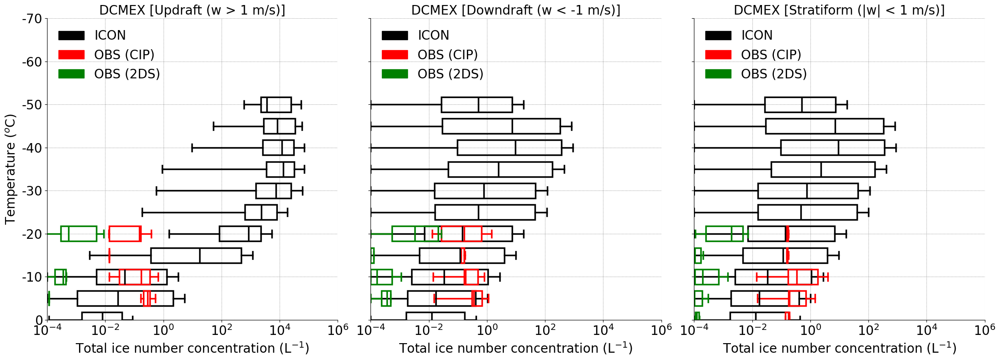

In [141]:


fontsize = 20;
linewidth = 2.5;
width=3.5;
alpha1=1;
alpha2=1.;

fig, axes = plt.subplots(1, 3, figsize=(22, 8), sharey=True)
plot_titles = ['DCMEX [Updraft (w > 1 m/s)]', 'DCMEX [Downdraft (w < -1 m/s)]', 'DCMEX [Stratiform (|w| < 1 m/s)]']

for i, ax in enumerate(axes):
    #temp_bins = temp_bins_list[i]
    #data_by_bin = data_list[i]

    # Plot ICON line if applicable (replace with actual values)
    if i == 0:
        #ax.plot(tinc_up_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        ax.boxplot(inc_sip_up_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(inc_cip_up_by_bin, positions=temp_cip_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
        ax.boxplot(inc_2ds_up_by_bin, positions=temp_2ds_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='green', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='green', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='green', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='green', alpha=alpha2),
                   showfliers=False)
        
    elif i == 1:
        #ax.plot(tinc_dn_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        ax.boxplot(inc_sip_dn_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(inc_cip_dn_by_bin, positions=temp_cip_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
        ax.boxplot(inc_2ds_dn_by_bin, positions=temp_2ds_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='green', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='green', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='green', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='green', alpha=alpha2),
                   showfliers=False)
        
    elif i == 2:
        #ax.plot(tinc_st_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        ax.boxplot(inc_sip_st_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(inc_cip_st_by_bin, positions=temp_cip_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
        ax.boxplot(inc_2ds_st_by_bin, positions=temp_2ds_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='green', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='green', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='green', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='green', alpha=alpha2),
                   showfliers=False)

    ax.set_xscale('log')
    ax.set_xlim(1.e-4, 1.e6)
    ax.set_xticklabels([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6], fontsize=fontsize)
    ax.set_ylim(0, -70)
    ax.set_title(plot_titles[i], fontsize=fontsize)
    ax.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
    ax.tick_params(axis='x', labelsize=fontsize)
    ax.grid(True, linestyle=':', color='grey',alpha=alpha1)

    # Combine both ICON line and boxplot legend
    handles, labels = ax.get_legend_handles_labels()

    obs_patch1 = mpatches.Patch(color='black', label='ICON')
    obs_patch2 = mpatches.Patch(color='red', label='OBS (CIP)')
    obs_patch3 = mpatches.Patch(color='green', label='OBS (2DS)')

    ax.legend(handles=handles + [obs_patch1, obs_patch2, obs_patch3], frameon=False, loc='upper left', fontsize=fontsize)
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axes[0].set_xscale('log')
axes[1].set_xscale('log')
axes[2].set_xscale('log')
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_yticks([0, -10, -20, -30, -40, -50, -60, -70])
axes[0].set_yticklabels(['0', '-10', '-20', '-30', '-40', '-50', '-60', '-70'], fontsize=fontsize)
#axes[0].set_yticks([0, -5, -10, -15, -20, -25, -30, -35, -40])
#axes[0].set_yticklabels(['0', '-5', '-10', '-15', '-20', '-25', '-30', '-35', '-40'], fontsize=fontsize)

plt.tight_layout()
plt.show()


In [142]:

time_nev = pd.to_datetime(data_faam_nevrozov['Time'].values)
time_core = pd.to_datetime(data_faam_core_1hz['Time'].values)

common_times = time_nev[time_nev.isin(time_core)]

# Now select data_faam_cpi where time is in common_times
#ds_core_1hz_new = data_faam_core_1hz_new.sel(time=common_times)

ds_faam_core_new = data_faam_core_1hz.sel(Time=common_times)
ds_nev_new = data_faam_nevrozov.sel(Time=common_times)

ds_nev_new = xr.merge([ds_faam_core_new, ds_nev_new])

ds_nev_new['tempc'] = ds_nev_new['TAT_DI_R']-273.16


filt_lwc_nev_up_cond = (ds_nev_new.LWC1 > 1.e-6) & (ds_nev_new.W_C > 1.)
filt_lwc_nev_dn_cond = (ds_nev_new.LWC1 > 1.e-6) & (ds_nev_new.W_C < -1.)
filt_lwc_nev_st_cond = (ds_nev_new.LWC1 > 1.e-6) & (np.abs(ds_nev_new.W_C) < 1.)

filt_iwc_nev_up_cond = (ds_nev_new.IWC1 > 1.e-6) & (ds_nev_new.W_C > 1.)
filt_iwc_nev_dn_cond = (ds_nev_new.IWC1 > 1.e-6) & (ds_nev_new.W_C < -1.)
filt_iwc_nev_st_cond = (ds_nev_new.IWC1 > 1.e-6) & (np.abs(ds_nev_new.W_C) < 1.)

# store variables
ds_nev_new['lwc_up_gperm3'] = xr.where(filt_lwc_nev_up_cond, ds_nev_new.LWC1, np.nan)
ds_nev_new['lwc_dn_gperm3'] = xr.where(filt_lwc_nev_dn_cond, ds_nev_new.LWC1, np.nan)
ds_nev_new['lwc_st_gperm3'] = xr.where(filt_lwc_nev_st_cond, ds_nev_new.LWC1, np.nan)

ds_nev_new['iwc_up_gperm3'] = xr.where(filt_iwc_nev_up_cond, ds_nev_new.IWC1, np.nan)
ds_nev_new['iwc_dn_gperm3'] = xr.where(filt_iwc_nev_dn_cond, ds_nev_new.IWC1, np.nan)
ds_nev_new['iwc_st_gperm3'] = xr.where(filt_iwc_nev_st_cond, ds_nev_new.IWC1, np.nan)

# Define temperature bins
#temp_nev_bin = np.array([30., 27., 24., 21., 18., 15., 12., 9., 6., 3., 0., -3., -6., -9., -12., -15., -18., -21., -24., -27., -30.])

temp_nev_bin = np.arange(-30, 30, 5)
temp_nev_bin = np.sort(temp_nev_bin)

tempc_values = ds_nev_new['tempc'].values
nan_mask = np.isnan(tempc_values)

valid_tempc_values = tempc_values[~nan_mask]

# which temperature bin each 'ds_cip_new.tempc' value belongs to?
temp_bins_indices = np.digitize(valid_tempc_values, bins=np.append(temp_nev_bin, np.inf)) - 1
temp_bins_indices = np.clip(temp_bins_indices, 0, len(temp_nev_bin) - 1)

# assign temp_bin to temp_bin_labels
temp_bin_labels = temp_nev_bin[temp_bins_indices]
temp_bin_labels_full = np.full_like(tempc_values, np.nan)
temp_bin_labels_full[~nan_mask] = temp_bin_labels

time_coord = ds_nev_new['tempc'].coords['Time']
ds_nev_new['temp_nev_bin'] = xr.DataArray(temp_bin_labels_full, coords={'Time': time_coord}, dims=['Time'])

df_up_lwc_nev = ds_nev_new[['lwc_up_gperm3', 'temp_nev_bin']].to_dataframe().dropna()
df_dn_lwc_nev = ds_nev_new[['lwc_dn_gperm3', 'temp_nev_bin']].to_dataframe().dropna()
df_st_lwc_nev = ds_nev_new[['lwc_st_gperm3', 'temp_nev_bin']].to_dataframe().dropna()

df_up_iwc_nev = ds_nev_new[['iwc_up_gperm3', 'temp_nev_bin']].to_dataframe().dropna()
df_dn_iwc_nev = ds_nev_new[['iwc_dn_gperm3', 'temp_nev_bin']].to_dataframe().dropna()
df_st_iwc_nev = ds_nev_new[['iwc_st_gperm3', 'temp_nev_bin']].to_dataframe().dropna()

df_up_lwc_nev = df_up_lwc_nev.dropna(subset=['temp_nev_bin'])
df_dn_lwc_nev = df_dn_lwc_nev.dropna(subset=['temp_nev_bin'])
df_st_lwc_nev = df_st_lwc_nev.dropna(subset=['temp_nev_bin'])

df_up_iwc_nev = df_up_iwc_nev.dropna(subset=['temp_nev_bin'])
df_dn_iwc_nev = df_dn_iwc_nev.dropna(subset=['temp_nev_bin'])
df_st_iwc_nev = df_st_iwc_nev.dropna(subset=['temp_nev_bin'])

# Sort the data by bin
lwc_nev_up_by_bin = [df_up_lwc_nev[df_up_lwc_nev['temp_nev_bin'] == temp]['lwc_up_gperm3'].values for temp in temp_nev_bin]
lwc_nev_dn_by_bin = [df_dn_lwc_nev[df_dn_lwc_nev['temp_nev_bin'] == temp]['lwc_dn_gperm3'].values for temp in temp_nev_bin]
lwc_nev_st_by_bin = [df_st_lwc_nev[df_st_lwc_nev['temp_nev_bin'] == temp]['lwc_st_gperm3'].values for temp in temp_nev_bin]

iwc_nev_up_by_bin = [df_up_iwc_nev[df_up_iwc_nev['temp_nev_bin'] == temp]['iwc_up_gperm3'].values for temp in temp_nev_bin]
iwc_nev_dn_by_bin = [df_dn_iwc_nev[df_dn_iwc_nev['temp_nev_bin'] == temp]['iwc_dn_gperm3'].values for temp in temp_nev_bin]
iwc_nev_st_by_bin = [df_st_iwc_nev[df_st_iwc_nev['temp_nev_bin'] == temp]['iwc_st_gperm3'].values for temp in temp_nev_bin]


/tmp/ipykernel_2642268/3817184020.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-6, 1.e-4, 1.e-2, 1.e0, 1.e2], fontsize=fontsize)
/tmp/ipykernel_2642268/3817184020.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-6, 1.e-4, 1.e-2, 1.e0, 1.e2], fontsize=fontsize)
/tmp/ipykernel_2642268/3817184020.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-6, 1.e-4, 1.e-2, 1.e0, 1.e2], fontsize=fontsize)


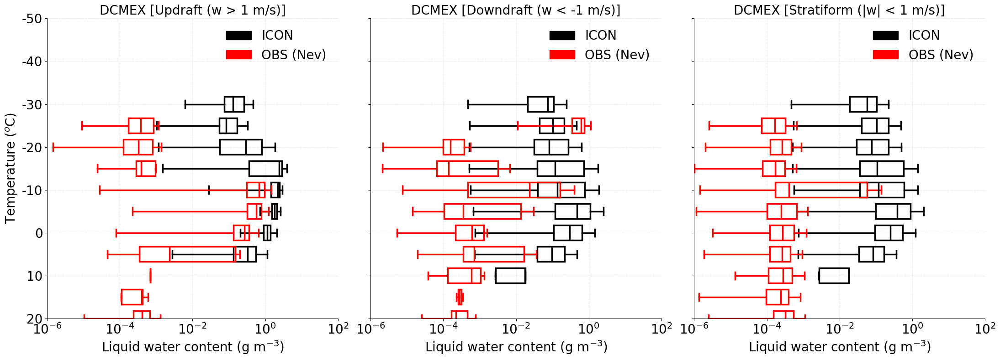

In [145]:


fontsize = 20;
linewidth = 2.5;
width=3.5;
alpha1=1;
alpha2=1.;

fig, axes = plt.subplots(1, 3, figsize=(22, 8), sharey=True)
plot_titles = ['DCMEX [Updraft (w > 1 m/s)]', 'DCMEX [Downdraft (w < -1 m/s)]', 'DCMEX [Stratiform (|w| < 1 m/s)]']

for i, ax in enumerate(axes):
    #temp_bins = temp_bins_list[i]
    #data_by_bin = data_list[i]

    # Plot ICON line if applicable (replace with actual values)
    if i == 0:
        #ax.plot(lwc_up_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(lwc_sip_up_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(lwc_nev_up_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 1:
        #ax.plot(lwc_dn_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(lwc_sip_dn_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(lwc_nev_dn_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 2:
        #ax.plot(lwc_st_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(lwc_sip_st_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(lwc_nev_st_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)

    ax.set_xscale('log')
    ax.set_xlim(1.e-6, 1.e2)
    ax.set_xticklabels([1.e-6, 1.e-4, 1.e-2, 1.e0, 1.e2], fontsize=fontsize)
    ax.set_ylim(20, -50)
    ax.set_title(plot_titles[i], fontsize=fontsize)
    ax.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fontsize)
    ax.tick_params(axis='x', labelsize=fontsize)
    ax.grid(True, linestyle=':', color='grey',alpha=alpha)

    # Combine both ICON line and boxplot legend
    handles, labels = ax.get_legend_handles_labels()

    obs_patch1 = mpatches.Patch(color='black', label='ICON')
    obs_patch2 = mpatches.Patch(color='red', label='OBS (Nev)')

    ax.legend(handles=handles + [obs_patch1, obs_patch2], frameon=False, loc='upper right', fontsize=fontsize)
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axes[0].set_xscale('log')
axes[1].set_xscale('log')
axes[2].set_xscale('log')
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_yticks([20, 10, 0, -10, -20, -30, -40, -50])
axes[0].set_yticklabels(['20', '10', '0', '-10', '-20', '-30', '-40', '-50'], fontsize=fontsize)
#axes[0].set_yticks([20, 10, 0, -10, -20, -30, -40])
#axes[0].set_yticklabels(['20', '10', '0', '-10', '-20', '-30', '-40'], fontsize=fontsize)

plt.tight_layout()
plt.show()


/tmp/ipykernel_2642268/361349197.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1], fontsize=fontsize)
/tmp/ipykernel_2642268/361349197.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1], fontsize=fontsize)
/tmp/ipykernel_2642268/361349197.py:74: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1], fontsize=fontsize)


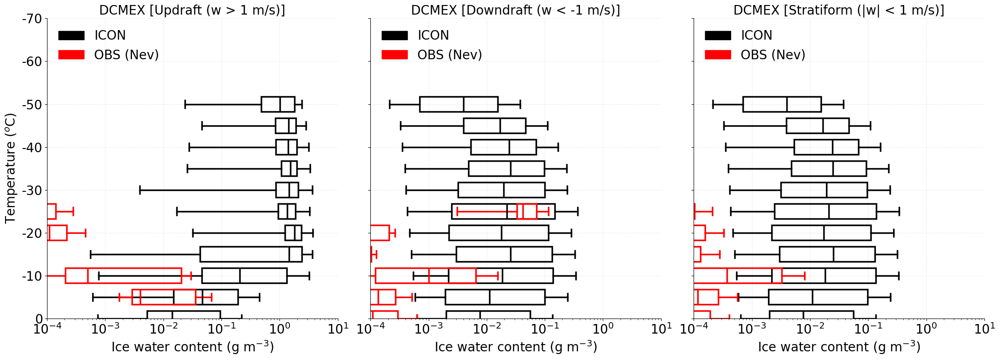

In [146]:


fontsize = 20;
linewidth = 2.5;
width=3.5;
alpha1=1;
alpha2=1.;

fig, axes = plt.subplots(1, 3, figsize=(22, 8), sharey=True)
plot_titles = ['DCMEX [Updraft (w > 1 m/s)]', 'DCMEX [Downdraft (w < -1 m/s)]', 'DCMEX [Stratiform (|w| < 1 m/s)]']

for i, ax in enumerate(axes):
    #temp_bins = temp_bins_list[i]
    #data_by_bin = data_list[i]

    # Plot ICON line if applicable (replace with actual values)
    if i == 0:
        #ax.plot(tiwc_up_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(iwc_sip_up_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(iwc_nev_up_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 1:
        #ax.plot(tiwc_dn_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(iwc_sip_dn_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(iwc_nev_dn_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 2:
        #ax.plot(tiwc_st_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(iwc_sip_st_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),  
                   medianprops=dict(color='black', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),  
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(iwc_nev_st_by_bin, positions=temp_nev_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)

    ax.set_xscale('log')
    ax.set_xlim(1.e-4, 1.e1)
    ax.set_xticklabels([1.e-4, 1.e-3, 1.e-2, 1.e-1, 1.e0, 1.e1], fontsize=fontsize)
    ax.set_ylim(0, -70)
    ax.set_title(plot_titles[i], fontsize=fontsize)
    ax.set_xlabel('Ice water content (g m$^{-3}$)', fontsize=fontsize)
    ax.tick_params(axis='x', labelsize=fontsize)
    ax.grid(True, linestyle=':', color='grey',alpha=alpha)

    # Combine both ICON line and boxplot legend
    handles, labels = ax.get_legend_handles_labels()

    
    obs_patch1 = mpatches.Patch(color='black', label='ICON')
    obs_patch2 = mpatches.Patch(color='red', label='OBS (Nev)')
    
    #obs_patch = mpatches.Patch(color='lightgrey', label='OBS (CIP)')

    ax.legend(handles=handles + [obs_patch1, obs_patch2], frameon=False, loc='upper left', fontsize=fontsize)
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axes[0].set_xscale('log')
axes[1].set_xscale('log')
axes[2].set_xscale('log')
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_yticks([0, -10, -20, -30, -40, -50, -60, -70])
axes[0].set_yticklabels(['0', '-10', '-20', '-30', '-40', '-50', '-60', '-70'], fontsize=fontsize)
#axes[0].set_yticks([0, -5, -10, -15, -20, -25, -30, -35, -40])
#axes[0].set_yticklabels(['0', '-5', '-10', '-15', '-20', '-25', '-30', '-35', '-40'], fontsize=fontsize)

plt.tight_layout()
plt.show()


In [147]:
ds_faam_cdp_phy = data_faam_core_cld_phy

ds_faam_cdp_phy['CDP_TSPM'] = ds_faam_cdp_phy['CDP_TSPM'].dt.floor('s')
ds_faam_cdp_phy['cdnc_percm3'] = ds_faam_cdp_phy['CDP_CONC'].rename({'CDP_TSPM': 'Time'})



ds_faam_cdp_phy['TAT_DI_R'] = data_faam_core_1hz['TAT_DI_R']
ds_faam_cdp_phy['W_C'] = data_faam_core_1hz['W_C']
ds_faam_cdp_phy['tempc'] = data_faam_core_1hz.TAT_DI_R-273.16

filt_cdnc_cdp_up_cond = (ds_faam_cdp_phy.cdnc_percm3 > 1.e-1) & (ds_faam_cdp_phy.W_C > 1.)
filt_cdnc_cdp_dn_cond = (ds_faam_cdp_phy.cdnc_percm3 > 1.e-1) & (ds_faam_cdp_phy.W_C < -1.) & (ds_faam_cdp_phy.W_C > -20.)
filt_cdnc_cdp_st_cond = (ds_faam_cdp_phy.cdnc_percm3 > 1.e-1) & (np.abs(ds_faam_cdp_phy.W_C) < 1.)

# store variables
ds_faam_cdp_phy['cdnc_up_percm3'] = xr.where(filt_cdnc_cdp_up_cond, ds_faam_cdp_phy.cdnc_percm3, np.nan)
ds_faam_cdp_phy['cdnc_dn_percm3'] = xr.where(filt_cdnc_cdp_dn_cond, ds_faam_cdp_phy.cdnc_percm3, np.nan)
ds_faam_cdp_phy['cdnc_st_percm3'] = xr.where(filt_cdnc_cdp_st_cond, ds_faam_cdp_phy.cdnc_percm3, np.nan)

print(ds_faam_cdp_phy.Time)
# Define temperature bins
#temp_cdp_bin = np.array([30., 27., 24., 21., 18., 15., 12., 9., 6., 3., 0., -3., -6., -9., -12., -15., -18., -21., -24., -27., -30.])
temp_cdp_bin = np.arange(-30, 30, 5)
temp_cdp_bin = np.sort(temp_cdp_bin)

tempc_values = ds_faam_cdp_phy['tempc'].values
nan_mask = np.isnan(tempc_values)

valid_tempc_values = tempc_values[~nan_mask]

# which temperature bin each 'ds_cip_new.tempc' value belongs to?
temp_bins_indices = np.digitize(valid_tempc_values, bins=np.append(temp_cdp_bin, np.inf)) - 1
temp_bins_indices = np.clip(temp_bins_indices, 0, len(temp_cdp_bin) - 1)

# assign temp_bin to temp_bin_labels
temp_bin_labels = temp_cdp_bin[temp_bins_indices]
temp_bin_labels_full = np.full_like(tempc_values, np.nan)
temp_bin_labels_full[~nan_mask] = temp_bin_labels

time_coord = ds_faam_cdp_phy['tempc'].coords['Time']
ds_faam_cdp_phy['temp_cdp_bin'] = xr.DataArray(temp_bin_labels_full, coords={'Time': time_coord}, dims=['Time'])

df_up_cdnc_cdp = ds_faam_cdp_phy[['cdnc_up_percm3', 'temp_cdp_bin']].to_dataframe().dropna()
df_dn_cdnc_cdp = ds_faam_cdp_phy[['cdnc_dn_percm3', 'temp_cdp_bin']].to_dataframe().dropna()
df_st_cdnc_cdp = ds_faam_cdp_phy[['cdnc_st_percm3', 'temp_cdp_bin']].to_dataframe().dropna()

df_up_cdnc_cdp = df_up_cdnc_cdp.dropna(subset=['temp_cdp_bin'])
df_dn_cdnc_cdp = df_dn_cdnc_cdp.dropna(subset=['temp_cdp_bin'])
df_st_cdnc_cdp = df_st_cdnc_cdp.dropna(subset=['temp_cdp_bin'])

# Sort the data by bin
cdnc_cdp_up_by_bin = [df_up_cdnc_cdp[df_up_cdnc_cdp['temp_cdp_bin'] == temp]['cdnc_up_percm3'].values for temp in temp_cdp_bin]
cdnc_cdp_dn_by_bin = [df_dn_cdnc_cdp[df_dn_cdnc_cdp['temp_cdp_bin'] == temp]['cdnc_dn_percm3'].values for temp in temp_cdp_bin]
cdnc_cdp_st_by_bin = [df_st_cdnc_cdp[df_st_cdnc_cdp['temp_cdp_bin'] == temp]['cdnc_st_percm3'].values for temp in temp_cdp_bin]

<xarray.DataArray 'Time' (Time: 24313)>
array(['2022-08-02T13:26:01.000000000', '2022-08-02T13:26:02.000000000',
       '2022-08-02T13:26:03.000000000', ..., '2022-08-02T20:11:11.000000000',
       '2022-08-02T20:11:12.000000000', '2022-08-02T20:11:13.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * Time     (Time) datetime64[ns] 2022-08-02T13:26:01 ... 2022-08-02T20:11:13
    LAT_GIN  (Time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    LON_GIN  (Time) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan


/tmp/ipykernel_2642268/1660512837.py:77: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4], fontsize=fontsize)
/tmp/ipykernel_2642268/1660512837.py:77: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4], fontsize=fontsize)
/tmp/ipykernel_2642268/1660512837.py:77: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4], fontsize=fontsize)


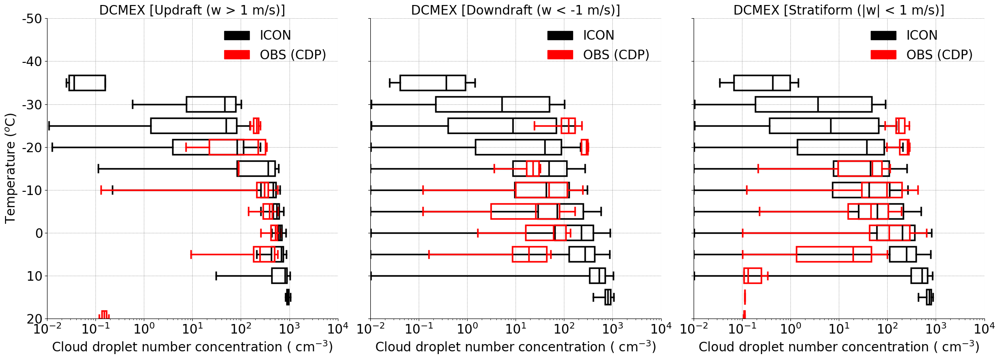

In [148]:


fontsize = 20;
linewidth = 3;
width=2;
alpha=1;

fig, axes = plt.subplots(1, 3, figsize=(22, 8), sharey=True)
plot_titles = ['DCMEX [Updraft (w > 1 m/s)]', 'DCMEX [Downdraft (w < -1 m/s)]', 'DCMEX [Stratiform (|w| < 1 m/s)]']

linewidth = 2.5;
width=3.5;
alpha1=1;
alpha2=1.;
for i, ax in enumerate(axes):
    #temp_bins = temp_bins_list[i]
    #data_by_bin = data_list[i]

    # Plot ICON line if applicable (replace with actual values)
    if i == 0:
        #ax.plot(cdnc_up_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(cdnc_sip_up_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(cdnc_cdp_up_by_bin, positions=temp_cdp_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 1:
        #ax.plot(cdnc_dn_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(cdnc_sip_dn_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(cdnc_cdp_dn_by_bin, positions=temp_cdp_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)
        
    elif i == 2:
        #ax.plot(cdnc_st_2mom, tempc_2mom, 'k-', linewidth=linewidth+2, label='ICON')
        
        ax.boxplot(cdnc_sip_st_by_bin[:-1], positions=tempc_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='black', linewidth=linewidth, alpha=alpha1),
                   medianprops=dict(color='black', linewidth=linewidth),
                   whiskerprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   capprops=dict(linewidth=linewidth, color='black', alpha=alpha1),
                   showfliers=False)
        
        ax.boxplot(cdnc_cdp_st_by_bin, positions=temp_cdp_bin, vert=False, patch_artist=True,
                   widths=width,
                   boxprops=dict(facecolor='none', edgecolor='red', linewidth=linewidth, alpha=alpha2),  
                   medianprops=dict(color='red', linewidth=linewidth),  
                   whiskerprops=dict(linewidth=linewidth, color='red', alpha=alpha2),  
                   capprops=dict(linewidth=linewidth, color='red', alpha=alpha2),
                   showfliers=False)

    ax.set_xscale('log')
    ax.set_xlim(1.e-2, 1.e4)
    ax.set_xticklabels([1.e-2, 1.e-1, 1.e0, 1.e1, 1.e2, 1.e3, 1.e4], fontsize=fontsize)
    ax.set_ylim(20, -50)
    #ax.set_yticklabels([20, 10, 0, -10, -20, -30, -40], fontsize=fontsize)
    ax.set_title(plot_titles[i], fontsize=fontsize)
    ax.set_xlabel('Cloud droplet number concentration ( cm$^{-3}$)', fontsize=fontsize)
    ax.tick_params(axis='x', labelsize=fontsize)
    ax.grid(True, linestyle=':', color='grey',alpha=1.0)

    # Combine both ICON line and boxplot legend
    handles, labels = ax.get_legend_handles_labels()

    obs_patch1 = mpatches.Patch(color='black', label='ICON')
    obs_patch2 = mpatches.Patch(color='red', label='OBS (CDP)')

    ax.legend(handles=handles + [obs_patch1, obs_patch2], frameon=False, loc='upper right', fontsize=fontsize)
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axes[0].set_xscale('log')
axes[1].set_xscale('log')
axes[2].set_xscale('log')
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_yticks([20, 10, 0, -10, -20, -30, -40, -50])
axes[0].set_yticklabels(['20', '10', '0', '-10', '-20', '-30', '-40', '-50'], fontsize=fontsize)
#axes[0].set_yticks([20, 10, 0, -10, -20, -30, -40])
#axes[0].set_yticklabels(['20', '10', '0', '-10', '-20', '-30', '-40'], fontsize=fontsize)

plt.tight_layout()
plt.show()


In [25]:

#######
min_tempc_sip = ds_4sip.tempc.min().values
max_tempc_sip = ds_4sip.tempc.max().values

min_wvel_sip = ds_4sip.w_vel.min().values
max_wvel_sip = ds_4sip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_bin = np.linspace(min_tempc_sip, max_tempc_sip, num_temp_bin+1)
wvel_bin = np.linspace(min_wvel_sip, max_wvel_sip, num_w_bin+1)
#######

#######
tempc_sip_flat = ds_4sip.tempc.values.flatten()
wvel_sip_flat = ds_4sip.w_vel.values.flatten()

qc_sip_flat = ds_4sip.qc.values.flatten()
qi_sip_flat = ds_4sip.qi.values.flatten()
qs_sip_flat = ds_4sip.qs.values.flatten()
qg_sip_flat = ds_4sip.qg.values.flatten()
qh_sip_flat = ds_4sip.qh.values.flatten()
tqi_sip_flat = ds_4sip.tqi.values.flatten()
#######

hist_sip, temp_edges_sip, wvel_edges_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin))

#######
qc_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qc_sip_flat)[0]
qi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qi_sip_flat)[0]
qs_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qs_sip_flat)[0]
qg_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qg_sip_flat)[0]
qh_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qh_sip_flat)[0]
tqi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = tqi_sip_flat)[0]
#######

#######
avg_qc_temp_w_sip = qc_sum_sip/hist_sip
avg_qc_temp_w_sip[avg_qc_temp_w_sip < 1.e-9] = np.nan

avg_qi_temp_w_sip = qi_sum_sip/hist_sip
avg_qi_temp_w_sip[avg_qi_temp_w_sip < 1.e-9] = np.nan

avg_qs_temp_w_sip = qs_sum_sip/hist_sip
avg_qs_temp_w_sip[avg_qs_temp_w_sip < 1.e-9] = np.nan

avg_qg_temp_w_sip = qg_sum_sip/hist_sip
avg_qg_temp_w_sip[avg_qg_temp_w_sip < 1.e-9] = np.nan

avg_qh_temp_w_sip = qh_sum_sip/hist_sip
avg_qh_temp_w_sip[avg_qh_temp_w_sip < 1.e-9] = np.nan

avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip
avg_tqi_temp_w_sip[avg_tqi_temp_w_sip < 1.e-9] = np.nan
#######


/tmp/ipykernel_1917976/3900975349.py:8: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_sip = qc_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:11: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_sip = qi_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:14: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_sip = qs_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:17: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_sip = qg_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:20: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_sip = qh_sum_sip/hist_sip
/tmp/ipykernel_1917976/3900975349.py:23: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip


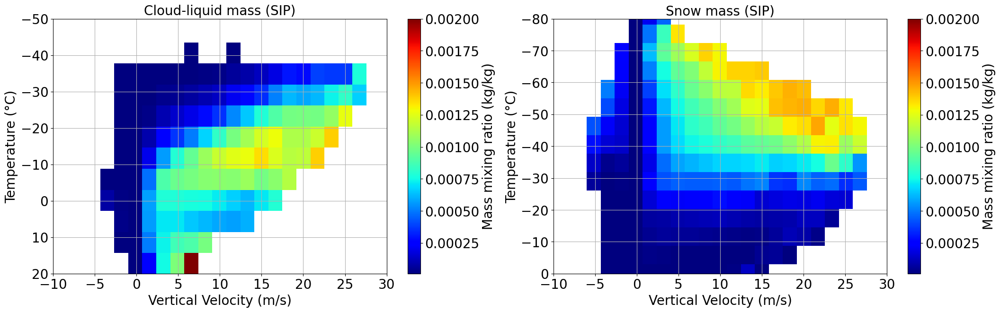

In [37]:

fontsize = 20;

plt.figure(figsize=(25, 7))
plt.subplot(1,2,1)
contour=plt.imshow(avg_qc_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(1,2,2)
contour=plt.imshow(avg_qi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Snow mass (SIP)', fontsize=fontsize)
plt.show()

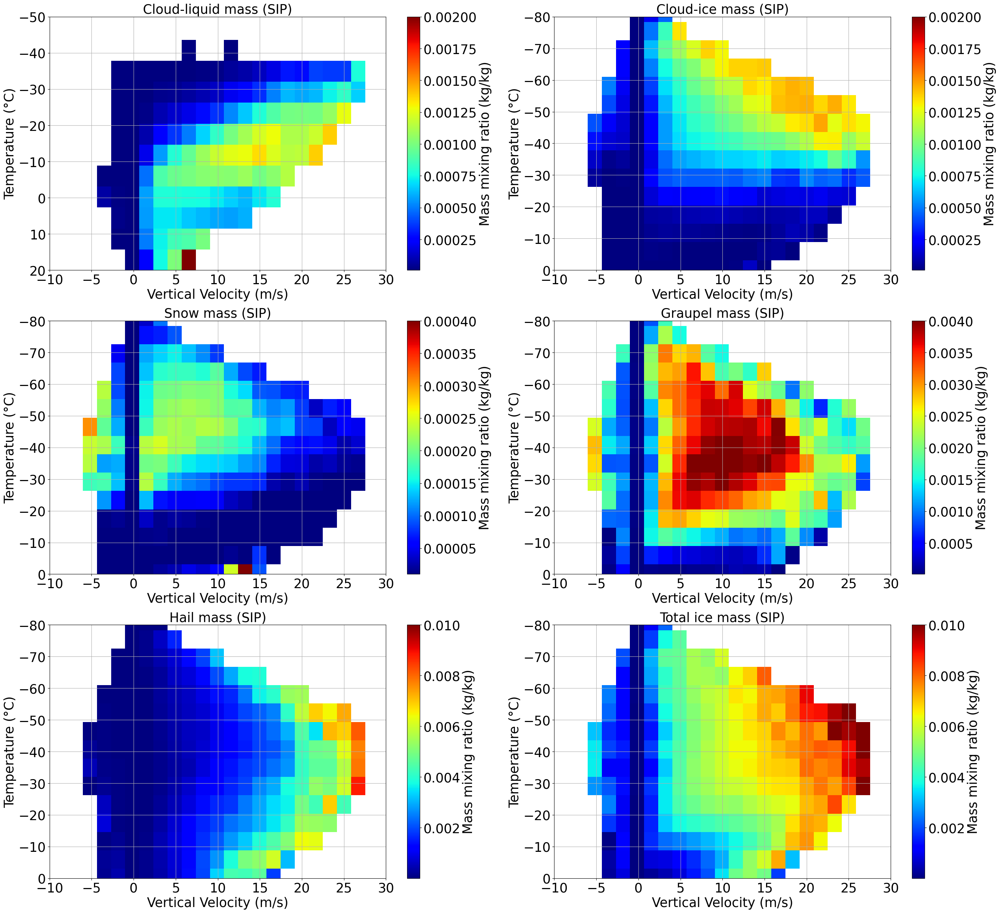

In [64]:


fontsize = 25;

plt.figure(figsize=(32, 30))
plt.subplot(3,2,1)
contour=plt.imshow(avg_qc_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(avg_qi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=2.e-3, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Cloud-ice mass (SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(avg_qs_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=4.e-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Snow mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(avg_qg_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=4.e-3, aspect='auto', origin='lower',cmap='jet')
plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Graupel mass (SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(avg_qh_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=1.e-2, aspect='auto', origin='lower',cmap='jet')

plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Hail mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(avg_tqi_temp_w_sip, extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=1.e-5, vmax=1.e-2, aspect='auto', origin='lower',cmap='jet')
plt.grid(True)
plt.xlim(-10, 30)
plt.xticks([-10, -5, 0, 5, 10, 15, 20, 25, 30], fontsize=fontsize)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Total ice mass (SIP)', fontsize=fontsize)

plt.show()


In [149]:
ds_4sip.time

<xarray.DataArray 'time' (time: 49)>
array(['2022-08-02T00:00:00.000000000', '2022-08-02T00:30:00.000000000',
       '2022-08-02T01:00:00.000000000', '2022-08-02T01:30:00.000000000',
       '2022-08-02T02:00:00.000000000', '2022-08-02T02:30:00.000000000',
       '2022-08-02T03:00:00.000000000', '2022-08-02T03:30:00.000000000',
       '2022-08-02T04:00:00.000000000', '2022-08-02T04:30:00.000000000',
       '2022-08-02T05:00:00.000000000', '2022-08-02T05:30:00.000000000',
       '2022-08-02T06:00:00.000000000', '2022-08-02T06:30:00.000000000',
       '2022-08-02T07:00:00.000000000', '2022-08-02T07:30:00.000000000',
       '2022-08-02T08:00:00.000000000', '2022-08-02T08:30:00.000000000',
       '2022-08-02T09:00:00.000000000', '2022-08-02T09:30:00.000000000',
       '2022-08-02T10:00:00.000000000', '2022-08-02T10:30:00.000000000',
       '2022-08-02T11:00:00.000000000', '2022-08-02T11:30:00.000000000',
       '2022-08-02T12:00:00.000000000', '2022-08-02T12:30:00.000000000',
       '2022-08-02T13:00:00.000000000', '2022-08-02T13:30:00.000000000',
       '2022-08-02T14:00:00.000000000', '2022-08-02T14:30:00.000000000',
       '2022-08-02T15:00:00.000000000', '2022-08-02T15:30:00.000000000',
       '2022-08-02T16:00:00.000000000', '2022-08-02T16:30:00.000000000',
       '2022-08-02T17:00:00.000000000', '2022-08-02T17:30:00.000000000',
       '2022-08-02T18:00:00.000000000', '2022-08-02T18:30:00.000000000',
       '2022-08-02T19:00:00.000000000', '2022-08-02T19:30:00.000000000',
       '2022-08-02T20:00:00.000000000', '2022-08-02T20:30:00.000000000',
       '2022-08-02T21:00:00.000000000', '2022-08-02T21:30:00.000000000',
       '2022-08-02T22:00:00.000000000', '2022-08-02T22:30:00.000000000',
       '2022-08-02T23:00:00.000000000', '2022-08-02T23:30:00.000000000',
       '2022-08-03T00:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2022-08-02 2022-08-02T00:30:00 ... 2022-08-03
Attributes:
    standard_name:  time
    axis:           T

In [11]:

def calc_dewpoint(tempc, rh):
    dewpoint = tempc - ((100. - rh)/5.)
    return dewpoint


def calc_tdew(t, rh):        # Magnus-Tetens approximation
    a = 17.27; b = 237.7;
    alpha = (a*t/(b+t)) + np.log(rh/100)
    td = b*alpha/(a-alpha)
    return td
    
def calc_vir_temp(tc, q):
    #virt_tempk_wk = t/(1. - (ev/p)*(1-0.622))
    temp = tc + (1-0.622*q)
    return temp
    
def calculate_lcl(pressure, temperature, dewpoint):
    l = np.argmin(np.abs(temperature - dewpoint))
    return pressure[l], temperature[l]

def calc_lcl(t, td):
    lcl = td + 125.*(t-td)
    return lcl
    
def e_sat_hpa(tc):
    e_sat_pa = 6.112*np.exp((17.67*tc)/(tc+243.5))
    return e_sat_pa

def calc_parcel_temp(pres, ht, q_sat, tk_lcl):
    grav = 9.8  # acceleration due to gravity [m/s^2]
    eps = 0.622  # ratio of the gas constants for water vapor and dry air
    Rd = 287.  # specific gas constant for dry air [J/(kg*K)]
    cp = 1005.  # specific heat capacity at constant pressure for dry air [J/(kg*K)]
    lv = 2.5e6  # latent heat of vaporization [J/kg]
    Rv = 461.  # specific gas constant for water vapor [J/(kg*K)]

    tk_parcel = np.zeros(len(ht))  
    del_t_par = np.zeros(len(ht))  

    tk_parcel[0] = tk_lcl + 273.15 
    
    for i in range(1, len(ht)):
        dht = ht[i] - ht[i - 1]  
        qs = q_sat[i]  
        term_a = 1. + lv * qs / (Rd * tk_parcel[i - 1])
        term_b = (lv ** 2.) * eps * qs
        term_c = Rd * (tk_parcel[i - 1]) ** 2.
        
        del_t_par[i] = grav * term_a / (cp + (term_b / term_c))

        tk_parcel[i] = tk_parcel[i - 1] - del_t_par[i] * dht
        
    tempc = tk_parcel - 273.15
    return tempc

import numpy as np



def calc_cape(pres, t_env, t_par, tv_env, tv_par):
    """
    Calculate Convective Available Potential Energy (CAPE).
    
    Parameters:
        pres (array): Pressure levels (hPa or Pa).
        t_env (array): Environmental temperature (°C).
        t_par (array): Parcel temperature (°C).
        tv_env (array): Environmental virtual temperature (°C).
        tv_par (array): Parcel virtual temperature (°C).
    
    Returns:
        cape (float): CAPE value (J/kg).
    """
    Rd = 287.0  # gas constant for dry air (J/kg/K)
    
    # Convert temperatures to Kelvin
    tk_env = t_env + 273.15
    tk_v_env = tv_env + 273.15
    tk_par = t_par + 273.15
    tk_v_par = tv_par + 273.15
    
    cape = 0.0
    
    # Loop through pressure levels
    for i in range(1, len(pres)):
        # Check if parcel is warmer than the environment
        if tk_v_par[i] > tk_v_env[i]:
            # Calculate logarithmic pressure difference
            dlnp = np.log(pres[i-1] / pres[i])
            cape = cape + Rd * (tk_v_par[i] - tk_v_env[i]) * dlnp
    return cape
        

In [12]:
ds_4sip.time[26]

<xarray.DataArray 'time' ()>
array('2022-08-02T13:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2022-08-02T13:00:00
Attributes:
    standard_name:  time
    axis:           T

In [13]:
print(lcl_temp)

NameError: name 'lcl_temp' is not defined

CAPE ::  1021.1269912698493


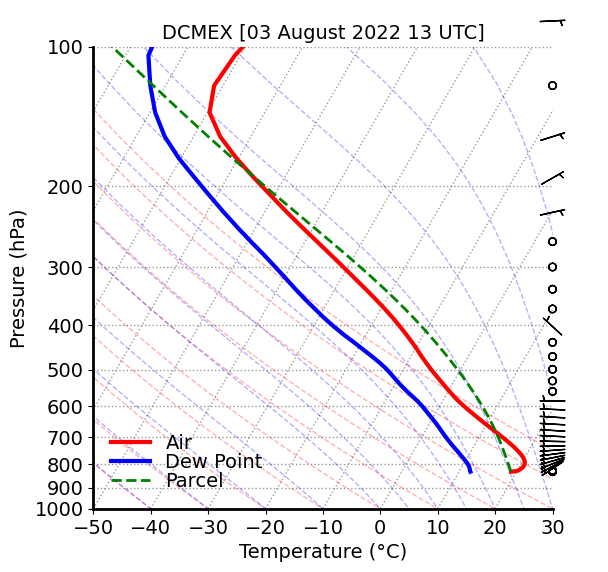

In [14]:

ds_skewt = ds_4sip.sel(time=ds_4sip.time[26])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

#----- Calculate parcel properties
e_sat = e_sat_hpa(avg_tempc)
q_sat = 0.622*e_sat/(avg_pres-e_sat)

lcl_pressure, lcl_temp = calculate_lcl(avg_pres, avg_tempc, avg_dewtempc)
#lcl_temp = calc_lcl(avg_tempc[0], avg_dewtempc)
parcel_temp = calc_parcel_temp(avg_pres, avg_ht, q_sat, lcl_temp)
Tv_env = calc_vir_temp(avg_tempc, avg_qv)
Tv_parcel = calc_vir_temp(parcel_temp, q_sat)
parcel_cape = calc_cape(avg_pres, avg_tempc, parcel_temp, Tv_env, Tv_parcel)
print('CAPE :: ',parcel_cape)
#------

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(8, 6))
skew = SkewT(fig)

# Plot temperature and dew point on the Skew-T
skew.plot(avg_pres, avg_tempc, 'r-', label='Air', linewidth=lnwdth)
#skew.plot(avg_pres, calc_dewpoint(avg_tempc, avg_rh), 'b-.', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, parcel_temp, 'g--', label='Parcel', linewidth=lnwdth-1)
# Add wind barbs 
if 'u' in ds_skewt and 'v' in ds_skewt:
    u_wind = avg_u  # Zonal wind component
    v_wind = avg_v  # Meridional wind component
    skew.plot_barbs(avg_pres[::2], u_wind[::2], v_wind[::2], length=6, color='black', pivot='middle')

# Add the dry and moist adiabats to the plot
skew.plot_dry_adiabats(linewidth=1, alpha=alpha)
skew.plot_moist_adiabats(linewidth=1, alpha=alpha)

ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-50, 30)
ax.set_ylim(1000., 100)
ax.tick_params(axis='x', labelsize=fontsize)
ax.tick_params(axis='y', labelsize=fontsize)
plt.title('DCMEX [03 August 2022 13 UTC]', fontsize=fontsize)

plt.legend(frameon=False, handlelength=2, labelspacing=0.01, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=1., color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

In [33]:
ds_sonde

<xarray.Dataset>
Dimensions:         (time: 1621, obs: 1)
Coordinates:
  * time            (time) datetime64[ns] 2022-08-02T15:59:46.390014648 ... 2...
    lat             (time) float32 ...
    lon             (time) float32 ...
    gpsalt          (time) float32 ...
Dimensions without coordinates: obs
Data variables: (12/27)
    trajectory      |S1 ...
    launch_time     datetime64[ns] ...
    pres            (time) float32 746.5 746.2 nan 746.3 nan ... nan nan nan nan
    tdry            (time) float32 nan nan nan nan nan ... nan nan nan nan nan
    dp              (time) float32 nan nan nan nan nan ... nan nan nan nan nan
    rh              (time) float32 nan nan nan nan nan ... nan nan nan nan nan
    ...              ...
    reference_rh    (obs) float32 ...
    reference_wspd  (obs) float32 ...
    reference_wdir  (obs) float32 ...
    reference_lat   (obs) float32 ...
    reference_lon   (obs) float32 ...
    reference_alt   (obs) float32 ...
Attributes: (12/93)
    Conventions:            CF-1.6
    RepoRevision:           V3.4.6
    RepoLastChangedDate:    Fri Apr 30 16:17:27 2021 -0600
    RepoId:                 163b1128fa837a96c93dfe8a59c915ff3185b748
    RepoBranch:             HEAD
    featureType:            trajectory
    ...                     ...
    WindQCDev:              999
    WindQCWL:               30
    WindSats:               6
    WindSmoothWL:           10
    WindVVPresWL:           5
    WindVVdelta:            2.5

CAPE ::  0.0


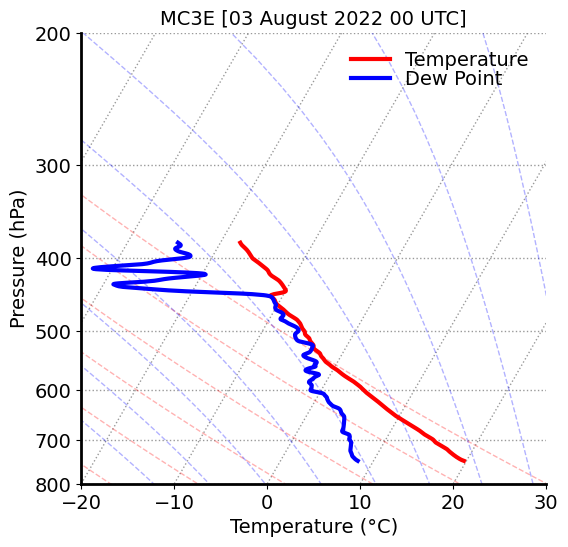

In [57]:

ds_sonde = xr.open_dataset('/work/bb1163/b382718/output/dcmex/observations/aircraft_data/20220802/faam-dropsonde_faam_20220802155302_r0_c310_proc.nc');

pres_sonde = ds_sonde.pres.values
tdry_sonde = ds_sonde.tdry.values
tdew_sonde = ds_sonde.dp.values
rh_sonde   = ds_sonde.rh.values
th_e_sonde = ds_sonde.theta_e.values
th_v_sonde = ds_sonde.theta_v.values
qv_sonde = ds_sonde.mr.values
ht_sonde = ds_sonde.alt.values

valid_indices = ~np.isnan(tdry_sonde) & ~np.isnan(ht_sonde) & ~np.isnan(qv_sonde) & ~np.isnan(rh_sonde) & ~np.isnan(tdew_sonde) & ~np.isnan(pres_sonde)

# Filter the data to remove NaN values
pres_sonde = pres_sonde[valid_indices]
tdry_sonde = tdry_sonde[valid_indices]
tdew_sonde = tdew_sonde[valid_indices]
rh_sonde = rh_sonde[valid_indices]
qv_sonde = qv_sonde[valid_indices]
ht_sonde = ht_sonde[valid_indices]

#qv_sonde = 1.e-3*qv_sonde # g kg-1 to kg kg-1
#----- Calculate parcel properties
e_sat = e_sat_hpa(tdry_sonde)
q_sat = 0.622*e_sat/(pres_sonde-e_sat)
qv_sonde = rh_sonde*q_sat

lcl_pressure, lcl_temp = calculate_lcl(pres_sonde, tdry_sonde, tdew_sonde)
parcel_temp = calc_parcel_temp(pres_sonde, ht_sonde, q_sat, lcl_temp)
Tv_env = calc_vir_temp(tdry_sonde, qv_sonde)
Tv_parcel = calc_vir_temp(parcel_temp, q_sat)
parcel_cape = calc_cape(pres_sonde, tdry_sonde, parcel_temp, Tv_env, Tv_parcel)
print('CAPE :: ',parcel_cape)
#------

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(6, 8))
skew = SkewT(fig)

# Plot temperature and dew point on the Skew-T
skew.plot(pres_sonde, tdry_sonde, 'r-', label='Temperature', linewidth=lnwdth)
skew.plot(pres_sonde, tdew_sonde, 'b-', label='Dew Point', linewidth=lnwdth)
#skew.plot(pres_sonde, qv_sonde, 'g-', label='Dew Point', linewidth=lnwdth)
#skew.plot(pres_sonde, parcel_temp, 'g--', label='Parcel', linewidth=lnwdth-1)
# Add wind barbs 
#if 'u' in ds_skewt and 'v' in ds_skewt:
#    u_wind = avg_u  # Zonal wind component
#    v_wind = avg_v  # Meridional wind component
#    skew.plot_barbs(avg_pres, u_wind, v_wind, length=6, color='black')

# Add the dry and moist adiabats to the plot
skew.plot_dry_adiabats(linewidth=1, alpha=alpha)
skew.plot_moist_adiabats(linewidth=1, alpha=alpha)

ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-20, 30)
ax.set_ylim(800., 200)
ax.tick_params(axis='x', labelsize=fontsize)
ax.tick_params(axis='y', labelsize=fontsize)
plt.title('MC3E [03 August 2022 00 UTC]', fontsize=fontsize)

plt.legend(frameon=False, handlelength=2, labelspacing=0.01, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=1., color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

In [28]:
print(ds_4sip.time[24])

<xarray.DataArray 'time' ()>
array('2022-08-02T12:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2022-08-02T12:00:00
Attributes:
    standard_name:  time
    axis:           T


In [29]:

ds_skewt = ds_4sip.sel(time=ds_4sip.time[24])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

#----- Calculate parcel properties
e_sat = e_sat_hpa(avg_tempc)
q_sat = 0.622*e_sat/(avg_pres-e_sat)

lcl_pressure, lcl_temp = calculate_lcl(avg_pres, avg_tempc, avg_dewtempc)
#lcl_temp = calc_lcl(avg_tempc[0], avg_dewtempc)
parcel_temp = calc_parcel_temp(avg_pres, avg_ht, q_sat, lcl_temp)
Tv_env = calc_vir_temp(avg_tempc, avg_qv)
Tv_parcel = calc_vir_temp(parcel_temp, q_sat)
parcel_cape = calc_cape(avg_pres, avg_tempc, parcel_temp, Tv_env, Tv_parcel)
print('CAPE :: ',parcel_cape)
#------

CAPE ::  0.0


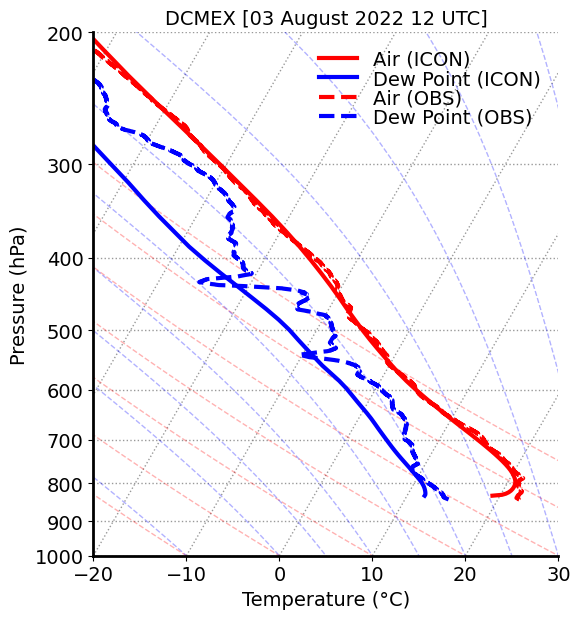

In [32]:

file_path = '/work/bk1415/b382718/output/dcmex/observations/wyoming_sonde/sonde_dcmex_20220802_1200UTC'
column_names = ['pres', 'height', 'temp', 'Tdew', 'relhum', 'qv', 'w_dir', 'w_wind', 'theta', 'theta_e', 'theta_v']


# Specify invalid values (strings or other markers for missing data)
invalid_values = ['-----------------------------------------------------------------------------', '9999.0', '999.0']

# Read the data and replace invalid values with NaN
ds_sonde = pd.read_csv(file_path, sep='\s+', skiprows=6, names=column_names, na_values=invalid_values)

# Now you can drop rows with NaN values if needed
ds_sonde.dropna(inplace=True)


# Read the data with column names
#ds_sonde = pd.read_csv(file_path, sep='\s+', skiprows=5, names=column_names)

#ds_sonde = ds_sonde[(ds_sonde['temp'] != 999.0) & (ds_sonde['pres'] != 9999.0) & 
#           (ds_sonde['Tdew'] != 999.0) & (ds_sonde['relhum'] != 999.0) & (ds_sonde['u_wind'] != 999.0) &
#           (ds_sonde['v_wind'] != 999.0)& (ds_sonde['w_wind'] != 999.0)& (ds_sonde['altitude'] != 99999.0)] 

temp_sonde = ds_sonde.temp.values
pres_sonde = ds_sonde.pres.values
tdew_sonde = ds_sonde.Tdew.values
rh_sonde = ds_sonde.relhum.values
qv_sonde = ds_sonde.qv.values
w_sonde = ds_sonde.w_wind.values
ht_sonde = ds_sonde.height.values


#----- Calculate parcel properties
#e_sat = e_sat_hpa(temp_sonde)
#q_sat = 0.622*e_sat/(pres_sonde-e_sat)
#qv_sonde = rh_sonde*q_sat

#lcl_pressure, lcl_temp = calculate_lcl(pres_sonde, temp_sonde, tdew_sonde)
#parcel_temp = calc_parcel_temp(pres_sonde, ht_sonde, q_sat, lcl_temp)
#Tv_env = calc_vir_temp(tdry_sonde, qv_sonde)
#Tv_parcel = calc_vir_temp(parcel_temp, q_sat)
#parcel_cape = calc_cape(pres_sonde, temp_sonde, parcel_temp, Tv_env, Tv_parcel)
#print('CAPE :: ',parcel_cape)
#------

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(6, 8))
skew = SkewT(fig)

# Plot temperature and dew point on the Skew-T

skew.plot(avg_pres, avg_tempc, 'r-', label='Air (ICON)', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point (ICON)', linewidth=lnwdth)

skew.plot(pres_sonde* units.hPa, temp_sonde* units.degC, 'r--', label='Air (OBS)', linewidth=lnwdth)
skew.plot(pres_sonde* units.hPa, tdew_sonde* units.degC, 'b--', label='Dew Point (OBS)', linewidth=lnwdth)
#skew.plot(pres_sonde, qv_sonde, 'g-', label='Dew Point', linewidth=lnwdth)
#skew.plot(pres_sonde, parcel_temp, 'g--', label='Parcel', linewidth=lnwdth-1)
# Add wind barbs 
#if 'u' in ds_skewt and 'v' in ds_skewt:
#    u_wind = avg_u  # Zonal wind component
#    v_wind = avg_v  # Meridional wind component
#    skew.plot_barbs(avg_pres, u_wind, v_wind, length=6, color='black')

# Add the dry and moist adiabats to the plot
skew.plot_dry_adiabats(linewidth=1, alpha=alpha)
skew.plot_moist_adiabats(linewidth=1, alpha=alpha)

ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-20, 30)
ax.set_ylim(1000., 200)
ax.tick_params(axis='x', labelsize=fontsize)
ax.tick_params(axis='y', labelsize=fontsize)
plt.title('DCMEX [03 August 2022 12 UTC]', fontsize=fontsize)

plt.legend(frameon=False, handlelength=2, labelspacing=0.01, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=1., color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

In [48]:


ds_sr = xr.open_mfdataset('/work/bk1415/b382718/output/dcmex/observations/radar_sr1/DCMEX/SR1/data/20220802/cfrad.20220802*RHI.nc')



/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/xarray/core/concat.py:546: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  common_dims = tuple(pd.unique([d for v in vars for d in v.dims]))


In [52]:
ds_sr


<xarray.Dataset>
Dimensions:                           (time: 2502, frequency: 1, sweep: 1,
                                       r_calib: 1, range: 1001)
Coordinates:
  * frequency                         (frequency) float32 5.593e+09
  * time                              (time) datetime64[ns] 2022-08-02T19:13:...
  * range                             (range) float32 0.0 150.0 ... 1.5e+05
Dimensions without coordinates: sweep, r_calib
Data variables: (12/135)
    volume_number                     (time) float64 4.0 4.0 4.0 ... 17.0 17.0
    platform_type                     (time) |S32 b'fixed' b'fixed' ... b'fixed'
    primary_axis                      (time) |S32 b'axis_z' ... b'axis_z'
    status_xml                        (time) |S1 b'' b'' b'' b'' ... b'' b'' b''
    instrument_type                   (time) |S32 b'radar' b'radar' ... b'radar'
    radar_antenna_gain_h              (time) float64 nan nan nan ... nan nan nan
    ...                                ...
    ZDR                               (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
    KDP                               (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
    PHIDP                             (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
    SQI                               (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
    RHOHV                             (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
    DBZV                              (time, range) float32 dask.array<chunksize=(40, 1001), meta=np.ndarray>
Attributes: (12/25)
    Conventions:          CF-1.7
    Sub_conventions:      CF-Radial instrument_parameters radar_parameters ra...
    version:              CF-Radial-1.4
    title:                RHI_DCM
    institution:          
    references:           Conversi
    ...                   ...
    site_name:            SR1
    scan_name:            
    scan_id:              0
    platform_is_mobile:   false
    n_gates_vary:         false
    ray_times_increase:   true

In [45]:
print(ds_sr.pressure_altitude_correction.max().values)

0.0


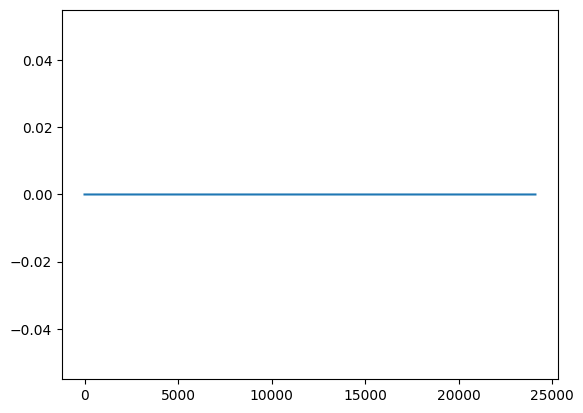

In [43]:
plt.plot(ds_sr.pressure_altitude_correction)

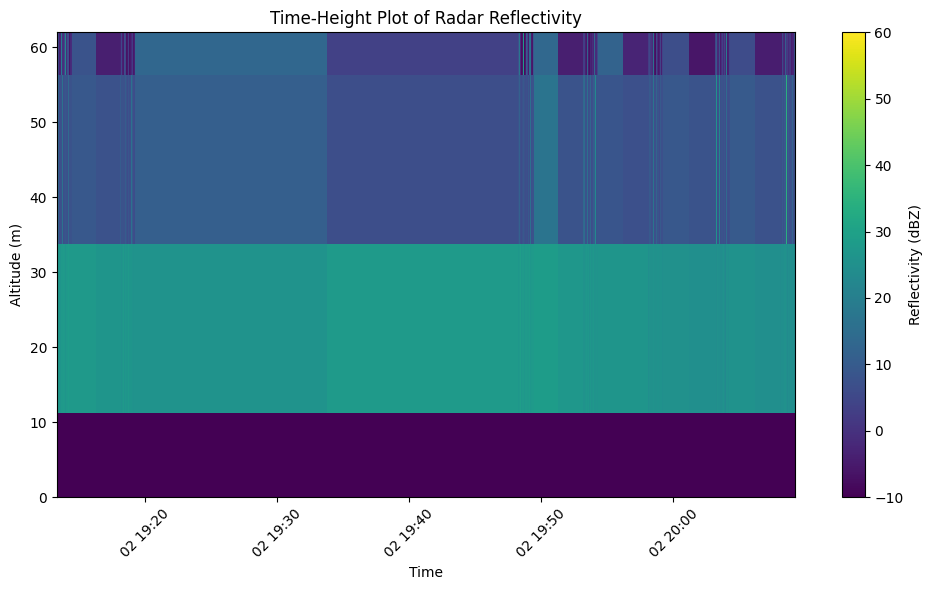

In [53]:


time = ds_sr['time']
altitude = 1.e-3*150.*ds_sr['range'] # range resolution for SMART (SR1) radar is 150 m Finney et al. (2024, Table 2)
dbz = ds_sr['DBZV']
lon = ds_sr['longitude']
lat = ds_sr['latitude']


# Create the plot
plt.figure(figsize=(10, 6))
plt.pcolormesh(time, altitude, dbz.T, shading='auto', cmap='viridis', vmin=-10, vmax=60)

# Add colorbar
cbar = plt.colorbar(label='Reflectivity (dBZ)')

plt.ylim(0, 62.)
# Labels and title
plt.xlabel('Time')
plt.ylabel('Altitude (m)')
plt.title('Time-Height Plot of Radar Reflectivity')

# Format x-axis for better time representation
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

In [ ]:


mean_ht_nosip = ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

mean_ht_nosb = ds_nosb.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

w_thres = 2.
# Latent heating rate with No SIP
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))

# Latent heating rate with 4-SIP
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))

# Latent heating rate with No Raindrop Shattering (RF)
filt_lhr = xr.where((ds_norf.tq > 1.e-6) & (ds_norf.w_vel > w_thres), ds_norf.d_lhr, np.nan)
lhr_kpers_norf = (1./1800.) * np.gradient(ds_norf.d_lhr, axis=0) # w.r.t. time
lhr_kperd_norf = lhr_kpers_norf * 86400.
mean_lhr_kperd_norf = np.mean(lhr_kperd_norf, axis=(0,2))

# Latent heating rate with No Hallett-Mossop (HM)
filt_lhr = xr.where((ds_nohm.tq > 1.e-6) & (ds_nohm.w_vel > w_thres), ds_nohm.d_lhr, np.nan)
lhr_kpers_nohm = (1./1800.) * np.gradient(ds_nohm.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nohm = lhr_kpers_nohm * 86400.
mean_lhr_kperd_nohm = np.mean(lhr_kperd_nohm, axis=(0,2))

# Latent heating rate with No ice-ice collision breakup (BR)
filt_lhr = xr.where((ds_nobr.tq > 1.e-6) & (ds_nobr.w_vel > w_thres), ds_nobr.d_lhr, np.nan)
lhr_kpers_nobr = (1./1800.) * np.gradient(ds_nobr.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nobr = lhr_kpers_nobr * 86400.
mean_lhr_kperd_nobr = np.mean(lhr_kperd_nobr, axis=(0,2))

# Latent heating rate with No Sublimation (SB)
filt_lhr = xr.where((ds_nosb.tq > 1.e-6) & (ds_nosb.w_vel > w_thres), ds_nosb.d_lhr, np.nan)
lhr_kpers_nosb = (1./1800.) * np.gradient(ds_nosb.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosb = lhr_kpers_nosb * 86400.
mean_lhr_kperd_nosb = np.mean(lhr_kperd_nosb, axis=(0,2))


# Change in lhr w.r.t. control
del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip


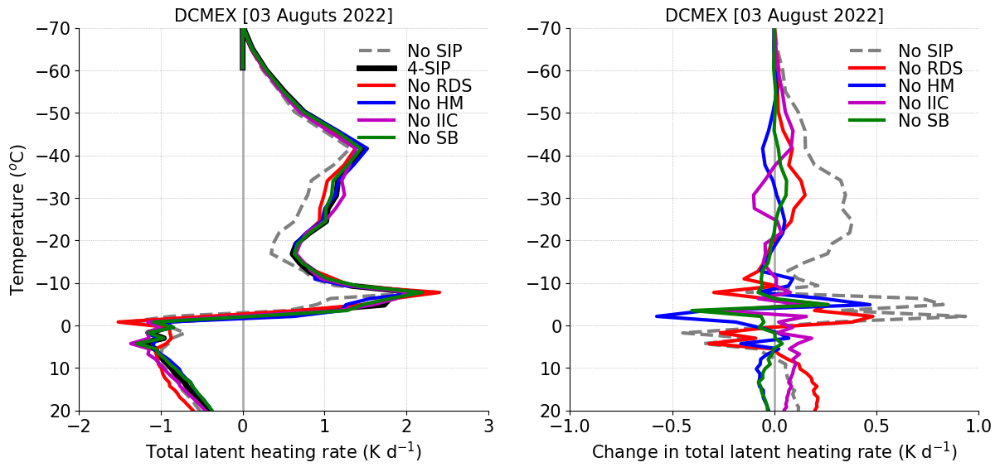

In [10]:


fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))
plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-2, 3)
plt.ylim(20, -70)
plt.xticks([-2, -1, 0, 1, 2, 3], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 Auguts 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-1, 1)
plt.ylim(20, -70)
plt.xticks([-1, -0.5, 0, 0.5, 1], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


In [7]:


mean_ht_nosip = ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

mean_ht_nosb = ds_nosb.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

w_thres = 2.
# LW/SW heating rate with No SIP
mean_lwr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosip = mean_lwr_kperd_nosip + mean_swr_kperd_nosip

# LW/SW heating rate with No SIP
mean_lwr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_4sip = mean_lwr_kperd_4sip + mean_swr_kperd_4sip

# LW/SW heating rate with No SIP
mean_lwr_kperd_norf = 86400.*ds_norf.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_norf = 86400.*ds_norf.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_norf = mean_lwr_kperd_norf + mean_swr_kperd_norf

# LW/SW heating rate with No SIP
mean_lwr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nohm = mean_lwr_kperd_nohm + mean_swr_kperd_nohm

# LW/SW heating rate with No SIP
mean_lwr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nobr = mean_lwr_kperd_nobr + mean_swr_kperd_nobr

# LW/SW heating rate with No SIP
mean_lwr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosb = mean_lwr_kperd_nosb + mean_swr_kperd_nosb

# Change in tot rad. heating w.r.t. control
del_tot_rad_kperd_norf = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_norf
del_tot_rad_kperd_nohm = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nohm
del_tot_rad_kperd_nobr = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nobr
del_tot_rad_kperd_nosb = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosb
del_tot_rad_kperd_nosip = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosip

# Change in LW rad. heating w.r.t. control
del_lwr_kperd_norf = mean_lwr_kperd_4sip-mean_lwr_kperd_norf
del_lwr_kperd_nohm = mean_lwr_kperd_4sip-mean_lwr_kperd_nohm
del_lwr_kperd_nobr = mean_lwr_kperd_4sip-mean_lwr_kperd_nobr
del_lwr_kperd_nosb = mean_lwr_kperd_4sip-mean_lwr_kperd_nosb
del_lwr_kperd_nosip = mean_lwr_kperd_4sip-mean_lwr_kperd_nosip

# Change in SW rad. heating w.r.t. control
del_swr_kperd_norf = mean_swr_kperd_4sip-mean_swr_kperd_norf
del_swr_kperd_nohm = mean_swr_kperd_4sip-mean_swr_kperd_nohm
del_swr_kperd_nobr = mean_swr_kperd_4sip-mean_swr_kperd_nobr
del_swr_kperd_nosb = mean_swr_kperd_4sip-mean_swr_kperd_nosb
del_swr_kperd_nosip = mean_swr_kperd_4sip-mean_swr_kperd_nosip


(20.0, -60.0)

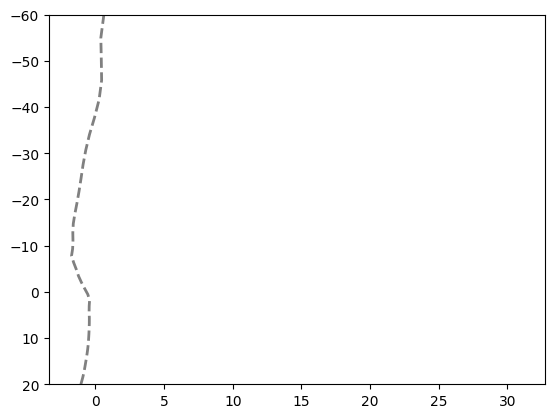

In [9]:
plt.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=2, label='No SIP')
plt.ylim(20,-60)

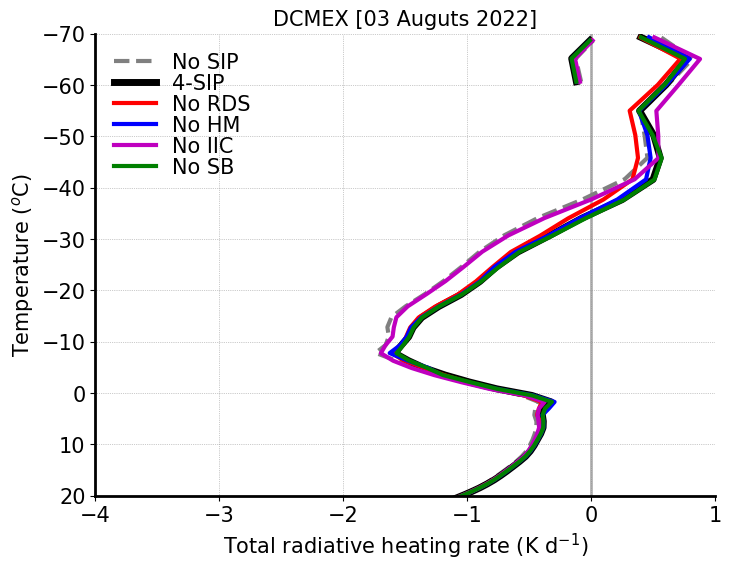

In [10]:
fontsize=15;
lnwdth=3;
alpha=0.6;

mean_tot_rad_kperd_nosip = mean_tot_rad_kperd_nosip.where(mean_tempc_nosip > -70)
mean_tot_rad_kperd_4sip = mean_tot_rad_kperd_4sip.where(mean_tempc_4sip > -70)
mean_tot_rad_kperd_norf = mean_tot_rad_kperd_norf.where(mean_tempc_norf > -70)
mean_tot_rad_kperd_nohm = mean_tot_rad_kperd_nohm.where(mean_tempc_nohm > -70)
mean_tot_rad_kperd_nobr = mean_tot_rad_kperd_nobr.where(mean_tempc_nobr > -70)
mean_tot_rad_kperd_nosb = mean_tot_rad_kperd_nosb.where(mean_tempc_nosb > -70)

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-4, 1)
plt.ylim(20, -70)
plt.xticks([-4, -3, -2, -1, 0, 1], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 Auguts 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


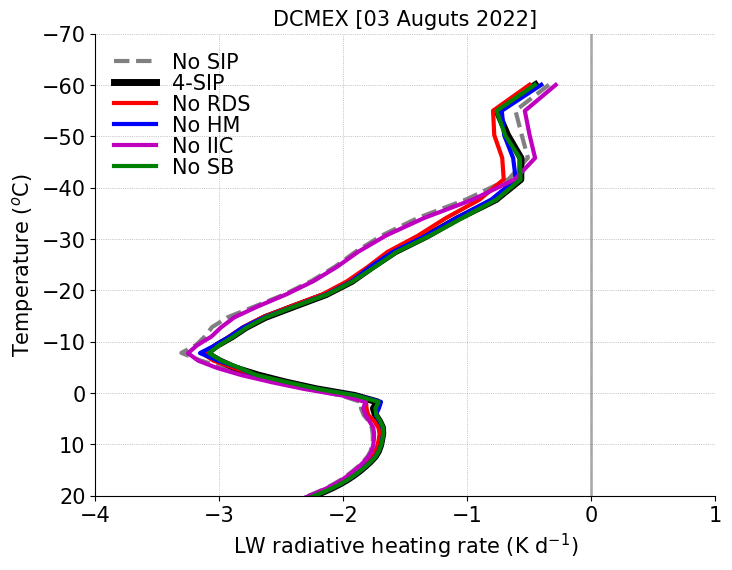

In [25]:
fontsize=15;
lnwdth=3;
alpha=0.6;

mean_lwr_kperd_nosip = mean_lwr_kperd_nosip.where(mean_tempc_nosip > -70)
mean_lwr_kperd_4sip = mean_lwr_kperd_4sip.where(mean_tempc_4sip > -70)
mean_lwr_kperd_norf = mean_lwr_kperd_norf.where(mean_tempc_norf > -70)
mean_lwr_kperd_nohm = mean_lwr_kperd_nohm.where(mean_tempc_nohm > -70)
mean_lwr_kperd_nobr = mean_lwr_kperd_nobr.where(mean_tempc_nobr > -70)
mean_lwr_kperd_nosb = mean_lwr_kperd_nosb.where(mean_tempc_nosb > -70)

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_lwr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_lwr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-4, 1)
plt.ylim(20, -70)
plt.xticks([-4, -3, -2, -1, 0, 1], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('LW radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 Auguts 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


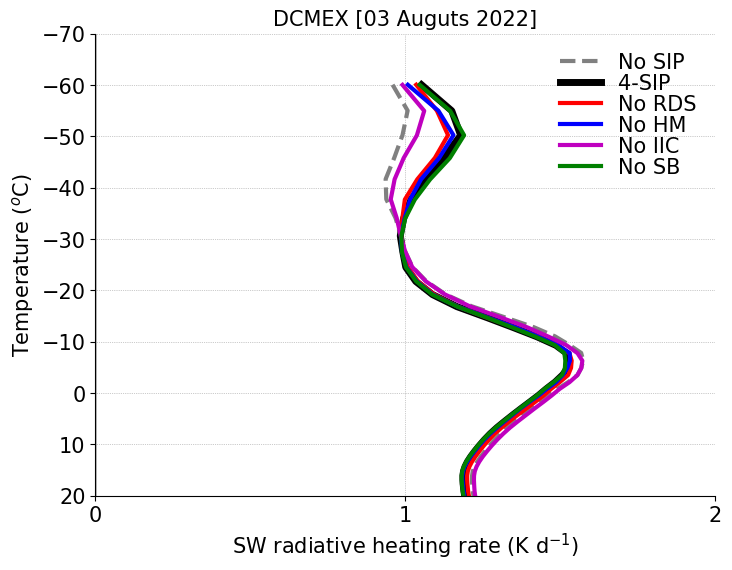

In [28]:
fontsize=15;
lnwdth=3;
alpha=0.6;

mean_swr_kperd_nosip = mean_swr_kperd_nosip.where(mean_tempc_nosip > -70)
mean_swr_kperd_4sip = mean_swr_kperd_4sip.where(mean_tempc_4sip > -70)
mean_swr_kperd_norf = mean_swr_kperd_norf.where(mean_tempc_norf > -70)
mean_swr_kperd_nohm = mean_swr_kperd_nohm.where(mean_tempc_nohm > -70)
mean_swr_kperd_nobr = mean_swr_kperd_nobr.where(mean_tempc_nobr > -70)
mean_swr_kperd_nosb = mean_swr_kperd_nosb.where(mean_tempc_nosb > -70)

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_swr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_swr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(0, 2)
plt.ylim(20, -70)
plt.xticks([0, 1, 2], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('SW radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 Auguts 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


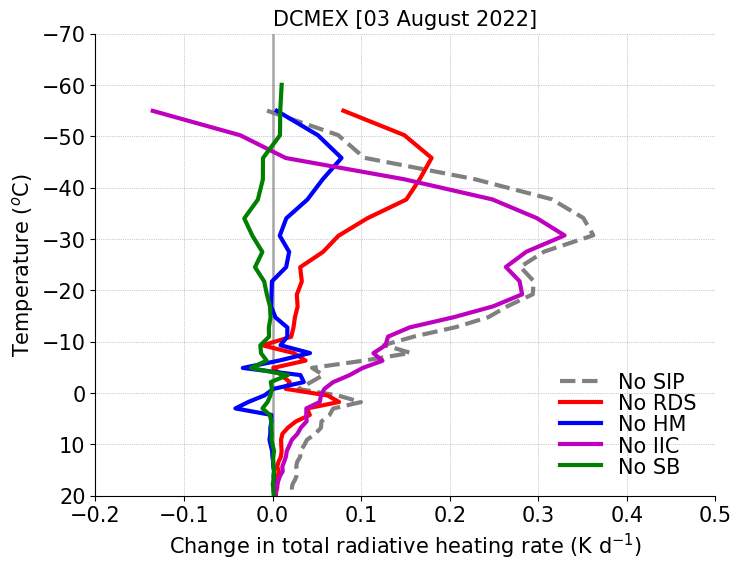

In [9]:


del_tot_rad_kperd_nosip = del_tot_rad_kperd_nosip.where(mean_tempc_nosip > -60)
del_tot_rad_kperd_norf = del_tot_rad_kperd_norf.where(mean_tempc_4sip > -60)
del_tot_rad_kperd_nohm = del_tot_rad_kperd_nohm.where(mean_tempc_norf > -60)
del_tot_rad_kperd_nobr = del_tot_rad_kperd_nobr.where(mean_tempc_nohm > -60)
del_tot_rad_kperd_nosb = del_tot_rad_kperd_nosb.where(mean_tempc_nobr > -60)

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_tot_rad_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-0.2, 0.5)
plt.ylim(20, -70)
plt.xticks([-0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in total radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



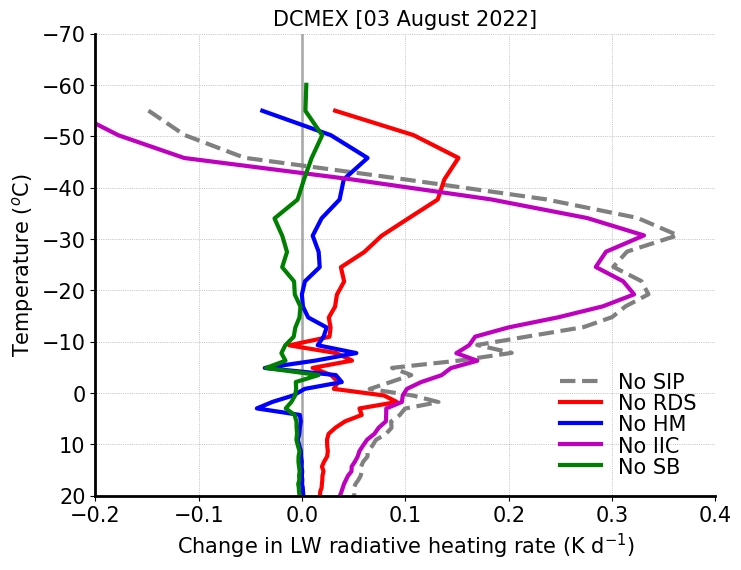

In [12]:


del_lwr_kperd_nosip = del_lwr_kperd_nosip.where(mean_tempc_nosip > -60)
del_lwr_kperd_norf = del_lwr_kperd_norf.where(mean_tempc_4sip > -60)
del_lwr_kperd_nohm = del_lwr_kperd_nohm.where(mean_tempc_norf > -60)
del_lwr_kperd_nobr = del_lwr_kperd_nobr.where(mean_tempc_nohm > -60)
del_lwr_kperd_nosb = del_lwr_kperd_nosb.where(mean_tempc_nobr > -60)

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
#plt.style.use('seaborn-white')

plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_lwr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-0.2, 0.4)
plt.ylim(20, -70)
plt.xticks([-0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in LW radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



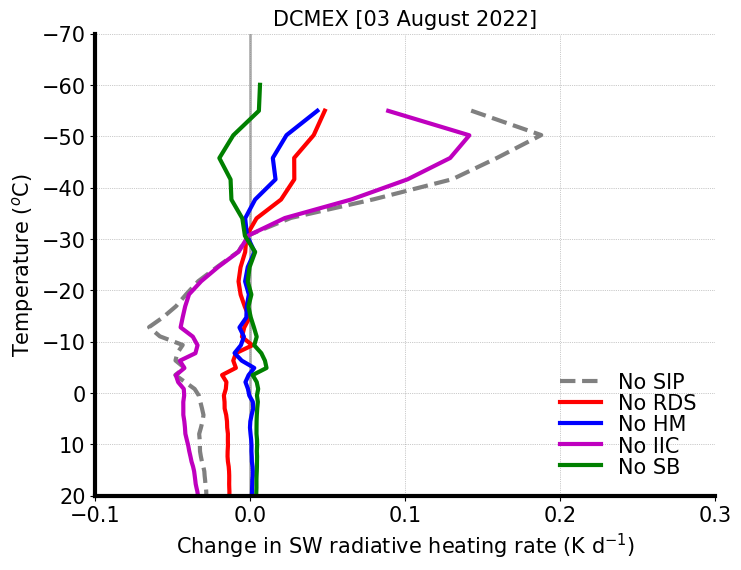

In [11]:


del_swr_kperd_nosip = del_swr_kperd_nosip.where(mean_tempc_nosip > -60)
del_swr_kperd_norf = del_swr_kperd_norf.where(mean_tempc_4sip > -60)
del_swr_kperd_nohm = del_swr_kperd_nohm.where(mean_tempc_norf > -60)
del_swr_kperd_nobr = del_swr_kperd_nobr.where(mean_tempc_nohm > -60)
del_swr_kperd_nosb = del_swr_kperd_nosb.where(mean_tempc_nobr > -60)

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_swr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-0.1, 0.3)
plt.ylim(20, -70)
plt.xticks([-0.1, 0, 0.1, 0.2, 0.3], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in SW radiative heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



In [14]:


filt_w = xr.where((ds_nosip.omega > 0.) & (ds_nosip.tq > 1.e-9), ds_nosip.omega, np.nan)
mean_omega_dn_nosip = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_4sip.omega > 0.) & (ds_4sip.tq > 1.e-9), ds_4sip.omega, np.nan)
mean_omega_dn_4sip = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_norf.omega > 0.) & (ds_norf.tq > 1.e-9), ds_norf.omega, np.nan)
mean_omega_dn_norf = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nohm.omega > 0.) & (ds_nohm.tq > 1.e-9), ds_nohm.omega, np.nan)
mean_omega_dn_nohm = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nobr.omega > 0.) & (ds_nobr.tq > 1.e-9), ds_nobr.omega, np.nan)
mean_omega_dn_nobr = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nobr.omega > 0.) & (ds_nosb.tq > 1.e-9), ds_nosb.omega, np.nan)
mean_omega_dn_nosb = filt_w.mean(dim=('time','ncells'))


In [15]:

filt_w = xr.where((ds_nosip.omega < 0.) & (ds_nosip.tq > 1.e-9), ds_nosip.omega, np.nan)
mean_omega_up_nosip = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_4sip.omega < 0.) & (ds_4sip.tq > 1.e-9), ds_4sip.omega, np.nan)
mean_omega_up_4sip = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_norf.omega < 0.) & (ds_norf.tq > 1.e-9), ds_norf.omega, np.nan)
mean_omega_up_norf = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nohm.omega < 0.) & (ds_nohm.tq > 1.e-9), ds_nohm.omega, np.nan)
mean_omega_up_nohm = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nobr.omega < 0.) & (ds_nobr.tq > 1.e-9), ds_nobr.omega, np.nan)
mean_omega_up_nobr = filt_w.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nobr.omega < 0.) & (ds_nosb.tq > 1.e-9), ds_nosb.omega, np.nan)
mean_omega_up_nosb = filt_w.mean(dim=('time','ncells'))


In [34]:

filt_w = xr.where((ds_nosip.tq > 1.e-12), ds_nosip.omega, np.nan)
mean_omega_net_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))

filt_w = xr.where((ds_4sip.tq > 1.e-12), ds_4sip.omega, np.nan)
mean_omega_net_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))

filt_w = xr.where((ds_norf.tq > 1.e-12), ds_norf.omega, np.nan)
mean_omega_net_norf = ds_norf.w_vel.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nohm.tq > 1.e-12), ds_nohm.omega, np.nan)
mean_omega_net_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nobr.tq > 1.e-12), ds_nobr.omega, np.nan)
mean_omega_net_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))

filt_w = xr.where((ds_nosb.tq > 1.e-12), ds_nosb.omega, np.nan)
mean_omega_net_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))


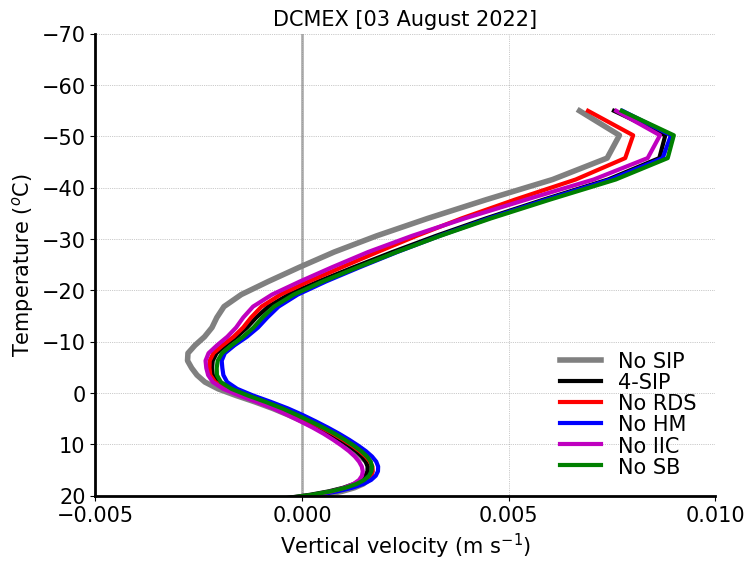

In [12]:

mean_w_up_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_norf = ds_norf.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))

mean_w_dn_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_norf = ds_norf.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))

mean_w_net_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
mean_w_net_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
mean_w_net_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
mean_w_net_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
mean_w_net_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
mean_w_net_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_w_net_nosip = mean_w_net_nosip.where(mean_tempc > -60)
mean_w_net_4sip = mean_w_net_4sip.where(mean_tempc > -60)
mean_w_net_norf = mean_w_net_norf.where(mean_tempc > -60)
mean_w_net_nohm = mean_w_net_nohm.where(mean_tempc > -60)
mean_w_net_nobr = mean_w_net_nobr.where(mean_tempc > -60)
mean_w_net_nosb = mean_w_net_nosb.where(mean_tempc > -60)

mean_w_up_nosip = mean_w_up_nosip.where(mean_tempc > -60)
mean_w_up_4sip = mean_w_up_4sip.where(mean_tempc > -60)
mean_w_up_norf = mean_w_up_norf.where(mean_tempc > -60)
mean_w_up_nohm = mean_w_up_nohm.where(mean_tempc > -60)
mean_w_up_nobr = mean_w_up_nobr.where(mean_tempc > -60)
mean_w_up_nosb = mean_w_up_nosb.where(mean_tempc > -60)

mean_w_dn_nosip = mean_w_dn_nosip.where(mean_tempc > -60)
mean_w_dn_4sip = mean_w_dn_4sip.where(mean_tempc > -60)
mean_w_dn_norf = mean_w_dn_norf.where(mean_tempc > -60)
mean_w_dn_nohm = mean_w_dn_nohm.where(mean_tempc > -60)
mean_w_dn_nobr = mean_w_dn_nobr.where(mean_tempc > -60)
mean_w_dn_nosb = mean_w_dn_nosb.where(mean_tempc > -60)

mean_w_net_nosip = mean_w_net_nosip.values
mean_w_net_4sip = mean_w_net_4sip.values
mean_w_net_norf = mean_w_net_norf.values
mean_w_net_nohm = mean_w_net_nohm.values
mean_w_net_nobr = mean_w_net_nobr.values
mean_w_net_nosb = mean_w_net_nosb.values

mean_w_up_nosip = mean_w_up_nosip.values
mean_w_up_4sip = mean_w_up_4sip.values
mean_w_up_norf = mean_w_up_norf.values
mean_w_up_nohm = mean_w_up_nohm.values
mean_w_up_nobr = mean_w_up_nobr.values
mean_w_up_nosb = mean_w_up_nosb.values

mean_w_dn_nosip = mean_w_dn_nosip.values
mean_w_dn_4sip = mean_w_dn_4sip.values
mean_w_dn_norf = mean_w_dn_norf.values
mean_w_dn_nohm = mean_w_dn_nohm.values
mean_w_dn_nobr = mean_w_dn_nobr.values
mean_w_dn_nosb = mean_w_dn_nosb.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(16, 5))
#plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt.plot(mean_w_net_nosip*1.e2, mean_tempc, '-', color='grey', linewidth=lnwdth+1, label='No SIP')
plt.plot(mean_w_net_4sip*1.e2, mean_tempc, 'k-', linewidth=lnwdth, label='4-SIP')
plt.plot(mean_w_net_norf*1.e2, mean_tempc, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_w_net_nohm*1.e2, mean_tempc, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_w_net_nobr*1.e2, mean_tempc, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_w_net_nosb*1.e2, mean_tempc, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-0.5, 1)
plt.ylim(20, -70)
plt.xticks(fontsize=fontsize)
#plt.xticks([-0.005, 0., 0.005, 0.01], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [02 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



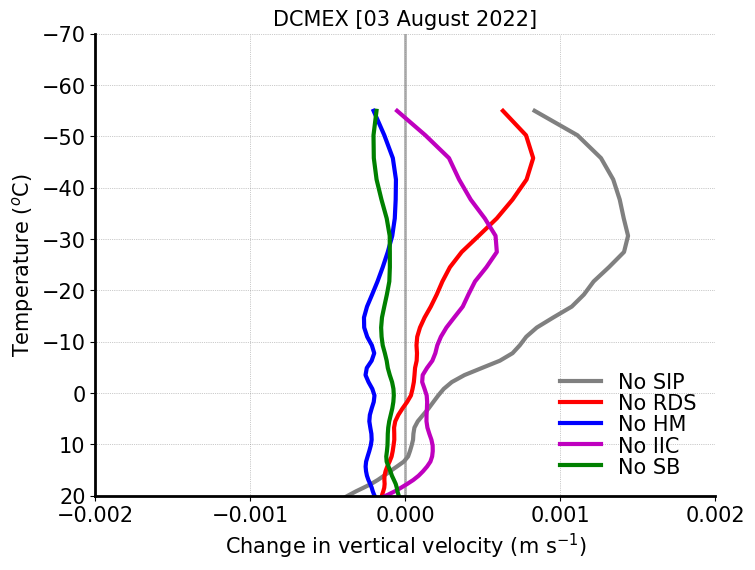

In [47]:


mean_w_net_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
mean_w_net_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
mean_w_net_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
mean_w_net_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
mean_w_net_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
mean_w_net_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_w_net_nosip = mean_omega_net_nosip.where(mean_tempc > -60)
mean_w_net_4sip = mean_omega_net_4sip.where(mean_tempc > -60)
mean_w_net_norf = mean_omega_net_norf.where(mean_tempc > -60)
mean_w_net_nohm = mean_omega_net_nohm.where(mean_tempc > -60)
mean_w_net_nobr = mean_omega_net_nobr.where(mean_tempc > -60)
mean_w_net_nosb = mean_omega_net_nosb.where(mean_tempc > -60)

del_w_nosip = mean_w_net_4sip - mean_w_net_nosip
del_w_norf = mean_w_net_4sip - mean_w_net_norf
del_w_nohm = mean_w_net_4sip - mean_w_net_nohm
del_w_nobr = mean_w_net_4sip - mean_w_net_nobr
del_w_nosb = mean_w_net_4sip - mean_w_net_nosb

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_w_nosip, mean_tempc, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_w_norf, mean_tempc, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_w_nohm, mean_tempc, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_w_nobr, mean_tempc, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(del_w_nosb, mean_tempc, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-0.002, 0.002)
plt.ylim(20, -70)
plt.xticks([-0.002, -0.001, 0., 0.001, 0.002], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [03 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



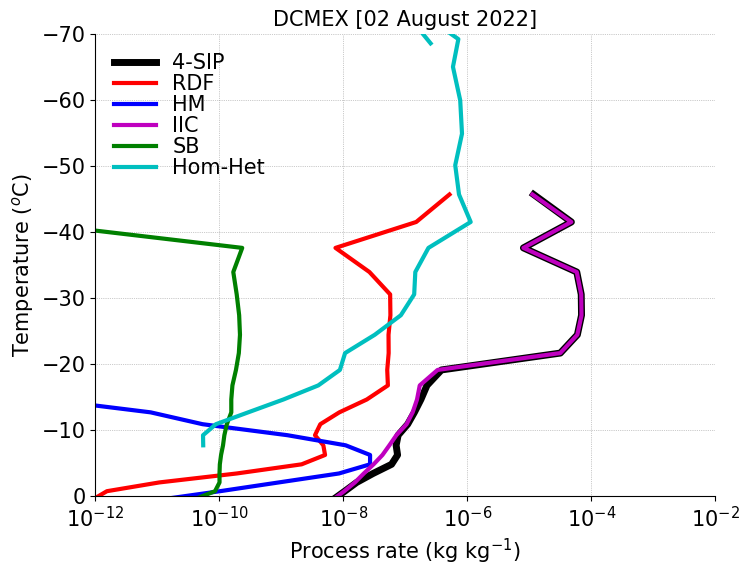

In [14]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqi_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-12, 1.e-2)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [02 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


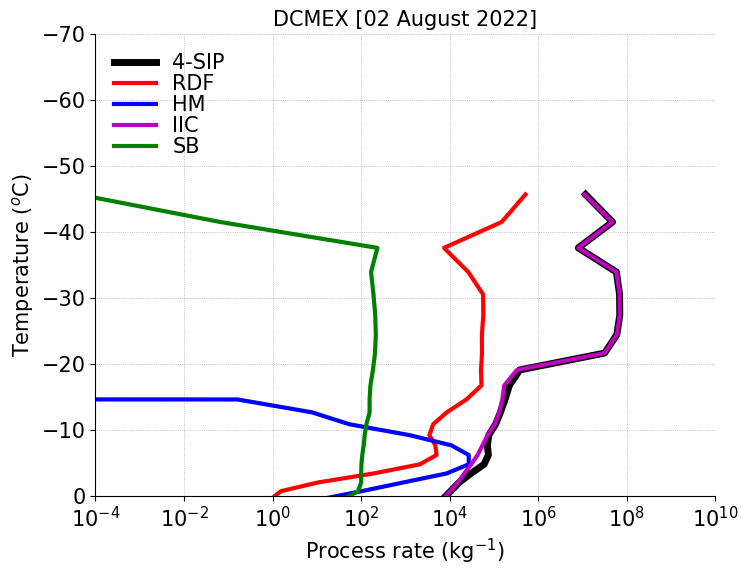

In [27]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;
st = 3
plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [02 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


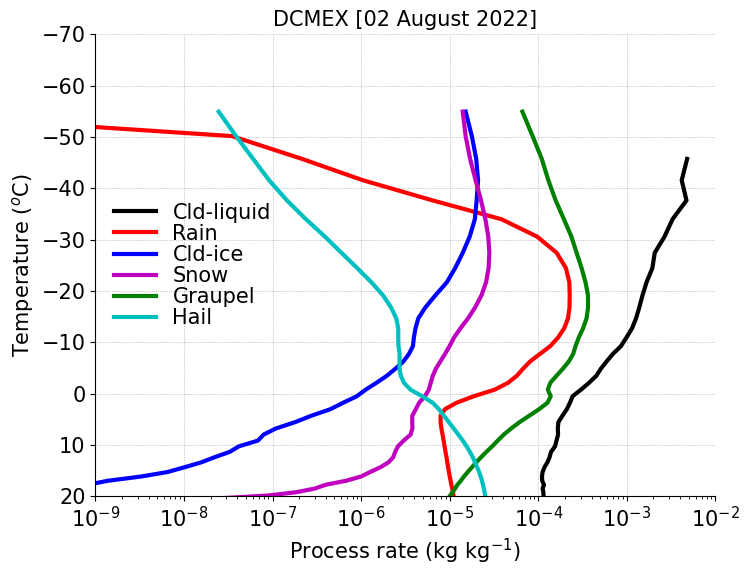

In [21]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qr, np.nan)
avg_qr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qc, np.nan)
avg_qc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qi, np.nan)
avg_qi = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qs, np.nan)
avg_qs = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qg, np.nan)
avg_qg = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qh, np.nan)
avg_qh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qr = avg_qr.where(avg_tempc > -60)
avg_qc = avg_qc.where(avg_tempc > -60)
avg_qi = avg_qi.where(avg_tempc > -60)
avg_qs = avg_qs.where(avg_tempc > -60)
avg_qg = avg_qg.where(avg_tempc > -60)
avg_qh = avg_qh.where(avg_tempc > -60)

avg_qr = avg_qr.values
avg_qc = avg_qc.values
avg_qi = avg_qi.values
avg_qs = avg_qs.values
avg_qg = avg_qg.values
avg_qh = avg_qh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qi, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qs, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qg, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-9, 1.e-2)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [02 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()

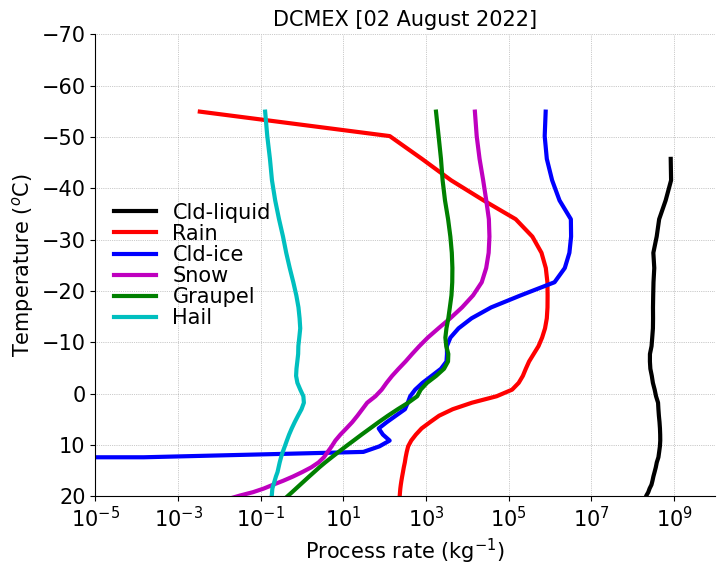

In [23]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qnr, np.nan)
avg_qnr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qnc, np.nan)
avg_qnc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qni, np.nan)
avg_qni = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qns, np.nan)
avg_qns = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qng, np.nan)
avg_qng = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qnh, np.nan)
avg_qnh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qnr = avg_qnr.where(avg_tempc > -60)
avg_qnc = avg_qnc.where(avg_tempc > -60)
avg_qni = avg_qni.where(avg_tempc > -60)
avg_qns = avg_qns.where(avg_tempc > -60)
avg_qng = avg_qng.where(avg_tempc > -60)
avg_qnh = avg_qnh.where(avg_tempc > -60)

avg_qnr = avg_qnr.values
avg_qnc = avg_qnc.values
avg_qni = avg_qni.values
avg_qns = avg_qns.values
avg_qng = avg_qng.values
avg_qnh = avg_qnh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qnc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qnr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qni, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qns, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qng, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qnh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-5, 1.e10)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('DCMEX [02 August 2022]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()
